# GAN example

In [2]:
# import necessary packages

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.layers import LeakyReLU, Reshape, Conv2DTranspose, UpSampling2D, Embedding, Concatenate

import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import random
import sklearn
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, cohen_kappa_score

In [3]:
noise_dim = 100 

In [20]:
import cv2
import os
import numpy as np
def load_img(indir):
    samples = []
    labels = []
    for class_dir in os.listdir(indir):
        the_class = class_dir
        print(the_class)
        for file in os.listdir(indir+'/'+class_dir):
            #print(file)
            #print("{}/{}/{}".format(indir,class_dir,file))
            if file.endswith('ppm'):
                image = cv2.imread("{}/{}/{}".format(indir,class_dir,file))
                image = cv2.resize(image, (64,64))
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                #image = np.expand_dims(image,axis=2)
                samples.append(image)
                labels.append(the_class)
    samples = np.array(samples)
    labels = np.array(labels)
    return samples,labels

In [21]:
#from helper import load_img
samples, labels = load_img('signs')
print('loaded',len(samples),' samples')
print('classes',set(labels))
samples = samples/255
print(samples.shape)
encoder = sklearn.preprocessing.LabelEncoder() # encoder
labels = encoder.fit_transform(labels)
print(labels[:10])
#print(intlabels[:10])

00001
00007
00014
00016
loaded 3300  samples
classes {'00001', '00014', '00007', '00016'}
(3300, 64, 64, 3)
[0 0 0 0 0 0 0 0 0 0]


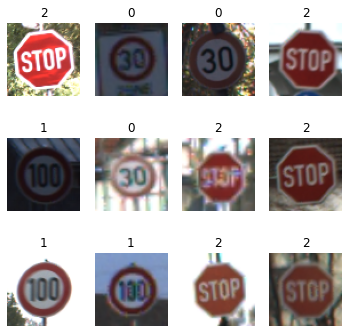

In [23]:
import random
plt.figure(figsize=(6, 6))
for i in range(12):
    ax = plt.subplot(3, 4, i + 1)
    r = random.randint(0,samples.shape[0])
    plt.imshow(samples[r][:,:,:])
    plt.title(labels[r])
    plt.axis("off")

In [54]:
# Generator gets a noise vector of size noise_dim and generates an image of size (32 x 32 x 1)
# Our aim: we want the image to be as similar to real images (generated above) as possible
def make_generator_model():
    
    
    input_layer = tf.keras.layers.Input(shape=(noise_dim,))
    x = Dense(8*8*64, use_bias=False)(input_layer)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    x = Reshape((8, 8, 64))(x)

    
    # tu wpiąć generację z klasy = input, embedding(50), reshape 8x8x1 i na koniec concatenate
    input_label = tf.keras.layers.Input(shape=(1,))
    # embedding for categorical input
    y = Embedding(4, 50)(input_label)
    # scale up to image dimensions with linear activation
    y = Dense(8*8)(y)
    y = Reshape((8, 8, 1))(y)
    
    merged = Concatenate()([x, y])
 #   merged = y
    
    x = Conv2D(64, (3, 3), strides=(1, 1), padding='same', use_bias=False)(merged)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)
    # output: 8 x 8 x 128

    x = UpSampling2D(size=(2, 2), data_format=None, interpolation="nearest")(x)
    x = Conv2D(64, (3, 3), strides=(1, 1), padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)
                    
    # output: 16 x 16 x 64

    x = UpSampling2D(size=(2, 2), data_format=None, interpolation="nearest")(x)
    x = Conv2D(32, (3, 3), strides=(1, 1), padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)

    # output: 32 x 32 x 32

    x = UpSampling2D(size=(2, 2), data_format=None, interpolation="nearest")(x)
    output_layer = Conv2D(3, (3, 3), strides=(1, 1), padding='same', use_bias=False, activation='sigmoid')(x)
    # output: 64 x 64 x 3
    model = tf.keras.models.Model(inputs=[input_layer,input_label], outputs=output_layer)
    model.summary()
    return model



generator = make_generator_model()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 100)]        0                                            
__________________________________________________________________________________________________
dense_18 (Dense)                (None, 4096)         409600      input_19[0][0]                   
__________________________________________________________________________________________________
input_20 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
batch_normalization_13 (BatchNo (None, 4096)         16384       dense_18[0][0]                   
____________________________________________________________________________________________

In [55]:
# Discriminator gets image of size (32 x 32 x 1) and decides if it is real or fake
# The result of the discriminator is used by generator to improve 'faking'

def make_discriminator_model():
    
    
    # zacząć od generację z klasy = input, embedding(50), reshape 32x32x1 i na koniec concatenate
    input_label = tf.keras.layers.Input(shape=(1,))
    # embedding for categorical input
    y = Embedding(4, 50)(input_label)
    # scale up to image dimensions with linear activation
    y = Dense(64*64*1)(y)
    y = Reshape((64, 64, 1))(y)
 
    
    
    input_layer = tf.keras.layers.Input(shape=(64, 64, 3))
    
    merged = Concatenate()([input_layer, y])
    x = Conv2D(64, (8, 8), strides=(2, 2), padding='same', input_shape=[64, 64, 4])(merged)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)

    x = Conv2D(128, (8, 8), strides=(2, 2), padding='same')(x)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)

    x = Flatten()(x)
    output_layer = Dense(1,activation='sigmoid')(x)
    model = tf.keras.models.Model(inputs=[input_layer,input_label], outputs=output_layer)
    #model.add(Dense(1))
    # output: one number 0-fake, 1-real
    model.summary()

    return model

discriminator = make_discriminator_model()

Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
embedding_10 (Embedding)        (None, 1, 50)        200         input_21[0][0]                   
__________________________________________________________________________________________________
dense_20 (Dense)                (None, 1, 4096)      208896      embedding_10[0][0]               
__________________________________________________________________________________________________
input_22 (InputLayer)           [(None, 64, 64, 3)]  0                                            
___________________________________________________________________________________________

In [49]:
# returns randomly choosen n samples

def sample_from_dataset(n,samples):
    prev_numbers = []
    new_samples = []
    new_labels = []
    while len(new_samples)<n:
        number = random.randrange(len(samples))
        if number in prev_numbers: continue
        prev_numbers.append(number)
        new_samples.append(samples[number])
        new_labels.append(labels[number])
    new_samples = np.array(new_samples,dtype=float)    
    new_labels = np.array(new_labels)    
    return new_samples,new_labels

In [50]:
# training parameters
generator_optimizer = tf.keras.optimizers.Adam(1e-5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5)
#cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
cross_entropy = tf.keras.losses.BinaryCrossentropy()


In [58]:
from numpy.random import randn

def calc_ok(vct):
    ok = 0
    for x in vct: 
        if x>=0.5: 
            ok+=1 
    return ok

# The training step

history = []
##@tf.function
def do_step(images, labels):
    batch_size = len(images)
    images = np.array(images)
    labels = np.expand_dims(labels,axis=1)
    # create random noise for generator
    input_noise = randn(batch_size * noise_dim)
    input_noise = input_noise.reshape(batch_size, noise_dim)
    input_noise = tf.convert_to_tensor(input_noise)
    #noise = tf.random.normal([batch_size, noise_dim])

    random_labels = np.random.randint(4, size=batch_size)
    random_labels = np.expand_dims(random_labels,axis=1)
  #  print(input_noise.shape)
  #  print(random_labels.shape)
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # generate fake image using noise
        generated_images = generator([input_noise,random_labels], training=True)
        # evaluate fake images
        fake_output = discriminator([generated_images,random_labels], training=True)
        fake_acc = (batch_size-calc_ok(fake_output))/batch_size
        # generator want all images to be accepted (output=1)!
        gen_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
        
        # evaluate real images
        real_output = discriminator([images,labels], training=True)
        real_acc = calc_ok(real_output)/batch_size
        # discriminator wants to classify all real images as 1 and fake images as 0
        real_loss = cross_entropy(tf.ones_like(real_output), real_output)
        fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        disc_loss = (real_loss + fake_loss)/2 # sum up both losses

    # calculate how to change generator to minimze its loss
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables) # step 4. calculate the gradient of the losses
    # calculate how to change discriminator to minimze its loss
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # update weights for both networks
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables)) # step 5. Apply the optimizers and update weights
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    if epoch % 10 == 0:
        print("Epoch",epoch,'g_loss=',gen_loss.numpy(),'d_loss=',disc_loss.numpy(),"real_acc=",real_acc,"fake_acc=",fake_acc)
    history.append([gen_loss.numpy(),disc_loss.numpy(),real_acc,fake_acc])
    

Epoch 0 g_loss= 0.7589968 d_loss= 0.6889539 real_acc= 0.12 fake_acc= 0.88


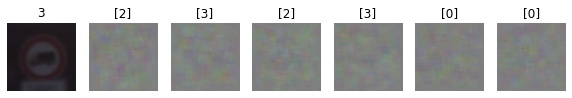

Epoch 10 g_loss= 0.795989 d_loss= 0.6756174 real_acc= 0.06 fake_acc= 1.0
Epoch 20 g_loss= 0.80740273 d_loss= 0.66469663 real_acc= 0.1 fake_acc= 1.0
Epoch 30 g_loss= 0.83006006 d_loss= 0.65353656 real_acc= 0.2 fake_acc= 1.0
Epoch 40 g_loss= 0.8401239 d_loss= 0.64665896 real_acc= 0.18 fake_acc= 1.0
Epoch 50 g_loss= 0.8404354 d_loss= 0.6430375 real_acc= 0.34 fake_acc= 0.98
Epoch 60 g_loss= 0.8414825 d_loss= 0.640916 real_acc= 0.36 fake_acc= 1.0
Epoch 70 g_loss= 0.8792261 d_loss= 0.61378574 real_acc= 0.56 fake_acc= 1.0
Epoch 80 g_loss= 0.8654501 d_loss= 0.6183871 real_acc= 0.5 fake_acc= 1.0
Epoch 90 g_loss= 0.8630451 d_loss= 0.61891377 real_acc= 0.6 fake_acc= 1.0
Epoch 100 g_loss= 0.91877955 d_loss= 0.5938782 real_acc= 0.62 fake_acc= 1.0


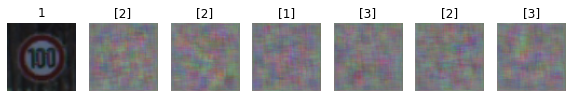

Epoch 110 g_loss= 0.9151838 d_loss= 0.5911188 real_acc= 0.58 fake_acc= 1.0
Epoch 120 g_loss= 0.93977815 d_loss= 0.60622895 real_acc= 0.52 fake_acc= 0.96
Epoch 130 g_loss= 0.8980313 d_loss= 0.57649565 real_acc= 0.72 fake_acc= 0.96
Epoch 140 g_loss= 0.99378896 d_loss= 0.5507429 real_acc= 0.72 fake_acc= 1.0
Epoch 150 g_loss= 0.925429 d_loss= 0.5784143 real_acc= 0.68 fake_acc= 1.0
Epoch 160 g_loss= 1.0238811 d_loss= 0.5642619 real_acc= 0.64 fake_acc= 1.0
Epoch 170 g_loss= 0.92484754 d_loss= 0.5470686 real_acc= 0.8 fake_acc= 0.98
Epoch 180 g_loss= 1.020781 d_loss= 0.5295743 real_acc= 0.8 fake_acc= 1.0
Epoch 190 g_loss= 1.0012119 d_loss= 0.5338685 real_acc= 0.76 fake_acc= 1.0
Epoch 200 g_loss= 1.0841178 d_loss= 0.5348268 real_acc= 0.7 fake_acc= 1.0


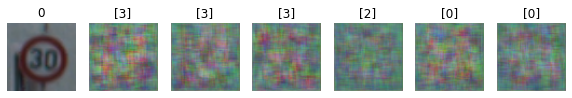

Epoch 210 g_loss= 1.0188832 d_loss= 0.47921225 real_acc= 0.96 fake_acc= 1.0
Epoch 220 g_loss= 1.0593034 d_loss= 0.48135707 real_acc= 0.92 fake_acc= 1.0
Epoch 230 g_loss= 1.1178143 d_loss= 0.47443584 real_acc= 0.88 fake_acc= 1.0
Epoch 240 g_loss= 1.1427419 d_loss= 0.45412594 real_acc= 0.9 fake_acc= 1.0
Epoch 250 g_loss= 1.1316915 d_loss= 0.46625715 real_acc= 0.82 fake_acc= 1.0
Epoch 260 g_loss= 1.1658733 d_loss= 0.46529347 real_acc= 0.82 fake_acc= 1.0
Epoch 270 g_loss= 1.1881692 d_loss= 0.42496872 real_acc= 0.84 fake_acc= 1.0
Epoch 280 g_loss= 1.2445436 d_loss= 0.4307318 real_acc= 0.82 fake_acc= 1.0
Epoch 290 g_loss= 1.257173 d_loss= 0.38844842 real_acc= 0.98 fake_acc= 1.0
Epoch 300 g_loss= 1.2360653 d_loss= 0.4074114 real_acc= 0.92 fake_acc= 0.98


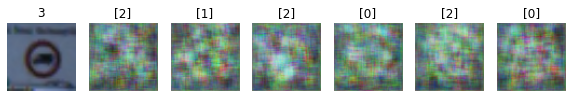

Epoch 310 g_loss= 1.2741861 d_loss= 0.419613 real_acc= 0.88 fake_acc= 0.98
Epoch 320 g_loss= 1.3298801 d_loss= 0.3727005 real_acc= 0.92 fake_acc= 1.0
Epoch 330 g_loss= 1.4223503 d_loss= 0.37249142 real_acc= 0.88 fake_acc= 0.98
Epoch 340 g_loss= 1.4992856 d_loss= 0.3297255 real_acc= 0.96 fake_acc= 1.0
Epoch 350 g_loss= 1.4891837 d_loss= 0.35505033 real_acc= 0.88 fake_acc= 1.0
Epoch 360 g_loss= 1.486525 d_loss= 0.33400935 real_acc= 0.88 fake_acc= 1.0
Epoch 370 g_loss= 1.6056093 d_loss= 0.32146972 real_acc= 0.92 fake_acc= 1.0
Epoch 380 g_loss= 1.5892062 d_loss= 0.27928513 real_acc= 0.96 fake_acc= 1.0
Epoch 390 g_loss= 1.4351044 d_loss= 0.28508887 real_acc= 0.92 fake_acc= 1.0
Epoch 400 g_loss= 1.4390701 d_loss= 0.29569665 real_acc= 0.96 fake_acc= 1.0


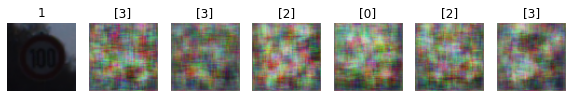

Epoch 410 g_loss= 1.6529953 d_loss= 0.28210413 real_acc= 0.94 fake_acc= 1.0
Epoch 420 g_loss= 1.6255695 d_loss= 0.26899007 real_acc= 0.92 fake_acc= 1.0
Epoch 430 g_loss= 1.6062311 d_loss= 0.2873091 real_acc= 0.92 fake_acc= 1.0
Epoch 440 g_loss= 1.551953 d_loss= 0.3023237 real_acc= 0.88 fake_acc= 1.0
Epoch 450 g_loss= 1.6887125 d_loss= 0.25485206 real_acc= 0.96 fake_acc= 1.0
Epoch 460 g_loss= 1.5671442 d_loss= 0.24103895 real_acc= 0.98 fake_acc= 1.0
Epoch 470 g_loss= 1.5528135 d_loss= 0.259682 real_acc= 0.94 fake_acc= 1.0
Epoch 480 g_loss= 1.8134089 d_loss= 0.23219812 real_acc= 0.96 fake_acc= 1.0
Epoch 490 g_loss= 1.8610198 d_loss= 0.24023068 real_acc= 0.94 fake_acc= 1.0
Epoch 500 g_loss= 1.7186878 d_loss= 0.20426908 real_acc= 0.98 fake_acc= 1.0


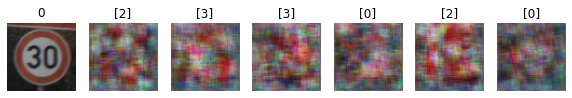

Epoch 510 g_loss= 1.7696435 d_loss= 0.23685299 real_acc= 0.98 fake_acc= 1.0
Epoch 520 g_loss= 1.5794017 d_loss= 0.24937636 real_acc= 0.94 fake_acc= 0.96
Epoch 530 g_loss= 1.824058 d_loss= 0.22995934 real_acc= 0.94 fake_acc= 1.0
Epoch 540 g_loss= 1.8071731 d_loss= 0.20373845 real_acc= 0.96 fake_acc= 1.0
Epoch 550 g_loss= 1.869655 d_loss= 0.20473051 real_acc= 0.94 fake_acc= 1.0
Epoch 560 g_loss= 1.8288273 d_loss= 0.22089335 real_acc= 0.94 fake_acc= 1.0
Epoch 570 g_loss= 1.8459052 d_loss= 0.18375091 real_acc= 0.98 fake_acc= 1.0
Epoch 580 g_loss= 1.8876991 d_loss= 0.2138187 real_acc= 0.92 fake_acc= 1.0
Epoch 590 g_loss= 1.7355745 d_loss= 0.18733169 real_acc= 0.98 fake_acc= 1.0
Epoch 600 g_loss= 1.9308914 d_loss= 0.19543673 real_acc= 0.94 fake_acc= 1.0


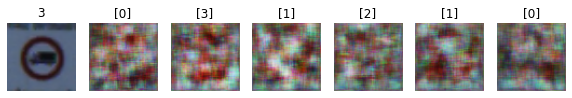

Epoch 610 g_loss= 2.1853273 d_loss= 0.17156798 real_acc= 0.96 fake_acc= 1.0
Epoch 620 g_loss= 2.337844 d_loss= 0.16164754 real_acc= 0.98 fake_acc= 1.0
Epoch 630 g_loss= 2.2508018 d_loss= 0.17847253 real_acc= 0.94 fake_acc= 1.0
Epoch 640 g_loss= 2.1057937 d_loss= 0.18731157 real_acc= 0.94 fake_acc= 1.0
Epoch 650 g_loss= 2.0570912 d_loss= 0.16491234 real_acc= 0.98 fake_acc= 1.0
Epoch 660 g_loss= 2.0328019 d_loss= 0.16671091 real_acc= 0.96 fake_acc= 1.0
Epoch 670 g_loss= 2.2136958 d_loss= 0.16303623 real_acc= 0.94 fake_acc= 1.0
Epoch 680 g_loss= 1.997171 d_loss= 0.18366522 real_acc= 0.96 fake_acc= 1.0
Epoch 690 g_loss= 1.9466577 d_loss= 0.18441676 real_acc= 0.94 fake_acc= 1.0
Epoch 700 g_loss= 1.7553008 d_loss= 0.20255601 real_acc= 0.98 fake_acc= 0.98


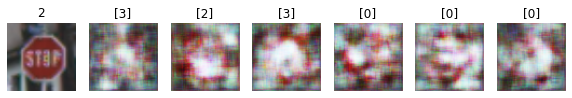

Epoch 710 g_loss= 2.0218499 d_loss= 0.15902978 real_acc= 0.98 fake_acc= 1.0
Epoch 720 g_loss= 2.3527906 d_loss= 0.22492641 real_acc= 0.84 fake_acc= 1.0
Epoch 730 g_loss= 2.0365882 d_loss= 0.18947704 real_acc= 0.94 fake_acc= 1.0
Epoch 740 g_loss= 1.8831244 d_loss= 0.16549718 real_acc= 0.98 fake_acc= 1.0
Epoch 750 g_loss= 2.1773298 d_loss= 0.19198547 real_acc= 0.9 fake_acc= 1.0
Epoch 760 g_loss= 2.0144699 d_loss= 0.20163181 real_acc= 0.94 fake_acc= 0.98
Epoch 770 g_loss= 1.8106964 d_loss= 0.19544151 real_acc= 0.94 fake_acc= 0.98
Epoch 780 g_loss= 1.871891 d_loss= 0.22459504 real_acc= 0.88 fake_acc= 1.0
Epoch 790 g_loss= 1.8537406 d_loss= 0.19891371 real_acc= 0.96 fake_acc= 1.0
Epoch 800 g_loss= 1.6134552 d_loss= 0.21581629 real_acc= 0.96 fake_acc= 1.0


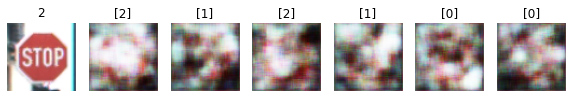

Epoch 810 g_loss= 2.3467572 d_loss= 0.20219213 real_acc= 0.86 fake_acc= 1.0
Epoch 820 g_loss= 2.3556287 d_loss= 0.21027136 real_acc= 0.92 fake_acc= 1.0
Epoch 830 g_loss= 1.8732135 d_loss= 0.17447492 real_acc= 0.98 fake_acc= 0.98
Epoch 840 g_loss= 1.8845307 d_loss= 0.20275018 real_acc= 0.92 fake_acc= 1.0
Epoch 850 g_loss= 1.6378201 d_loss= 0.24014977 real_acc= 0.94 fake_acc= 0.96
Epoch 860 g_loss= 2.016482 d_loss= 0.17651033 real_acc= 0.98 fake_acc= 1.0
Epoch 870 g_loss= 2.0760703 d_loss= 0.2505903 real_acc= 0.82 fake_acc= 1.0
Epoch 880 g_loss= 1.839502 d_loss= 0.23116267 real_acc= 0.92 fake_acc= 0.98
Epoch 890 g_loss= 1.899702 d_loss= 0.18213233 real_acc= 0.96 fake_acc= 1.0
Epoch 900 g_loss= 1.9543835 d_loss= 0.22804484 real_acc= 0.86 fake_acc= 1.0


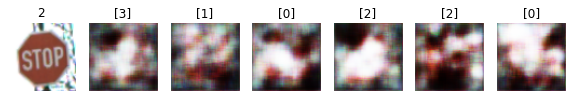

Epoch 910 g_loss= 1.8170459 d_loss= 0.2564635 real_acc= 0.88 fake_acc= 0.94
Epoch 920 g_loss= 1.7957171 d_loss= 0.25810194 real_acc= 0.92 fake_acc= 1.0
Epoch 930 g_loss= 1.9039755 d_loss= 0.29718894 real_acc= 0.84 fake_acc= 0.98
Epoch 940 g_loss= 1.5405961 d_loss= 0.25371546 real_acc= 0.94 fake_acc= 0.96
Epoch 950 g_loss= 1.6306555 d_loss= 0.3343938 real_acc= 0.82 fake_acc= 0.98
Epoch 960 g_loss= 1.9095546 d_loss= 0.2650055 real_acc= 0.88 fake_acc= 0.98
Epoch 970 g_loss= 1.6040188 d_loss= 0.23747876 real_acc= 0.96 fake_acc= 0.92
Epoch 980 g_loss= 1.655088 d_loss= 0.26255825 real_acc= 0.92 fake_acc= 0.96
Epoch 990 g_loss= 1.809143 d_loss= 0.31060427 real_acc= 0.88 fake_acc= 1.0
Epoch 1000 g_loss= 1.6157293 d_loss= 0.27043667 real_acc= 0.96 fake_acc= 0.9


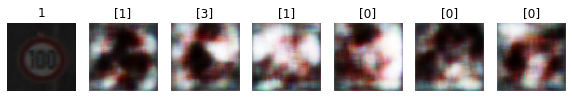

Epoch 1010 g_loss= 1.3488256 d_loss= 0.32517976 real_acc= 0.94 fake_acc= 0.8
Epoch 1020 g_loss= 1.7487968 d_loss= 0.28930467 real_acc= 0.88 fake_acc= 0.98
Epoch 1030 g_loss= 1.7202603 d_loss= 0.28930226 real_acc= 0.86 fake_acc= 1.0
Epoch 1040 g_loss= 1.6568173 d_loss= 0.3428197 real_acc= 0.78 fake_acc= 0.96
Epoch 1050 g_loss= 1.8930178 d_loss= 0.30702236 real_acc= 0.82 fake_acc= 0.98
Epoch 1060 g_loss= 1.5133115 d_loss= 0.30540657 real_acc= 0.92 fake_acc= 0.92
Epoch 1070 g_loss= 1.2870477 d_loss= 0.2972918 real_acc= 0.94 fake_acc= 0.92
Epoch 1080 g_loss= 1.4124129 d_loss= 0.30332476 real_acc= 0.9 fake_acc= 0.94
Epoch 1090 g_loss= 1.7562996 d_loss= 0.29600286 real_acc= 0.92 fake_acc= 0.96
Epoch 1100 g_loss= 1.6654158 d_loss= 0.27686974 real_acc= 0.94 fake_acc= 1.0


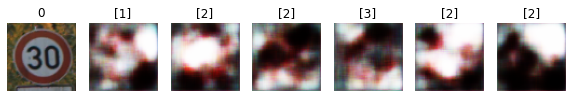

Epoch 1110 g_loss= 1.8356175 d_loss= 0.33730805 real_acc= 0.84 fake_acc= 0.92
Epoch 1120 g_loss= 1.7946547 d_loss= 0.39673454 real_acc= 0.76 fake_acc= 0.98
Epoch 1130 g_loss= 1.4830024 d_loss= 0.2947231 real_acc= 0.9 fake_acc= 0.94
Epoch 1140 g_loss= 1.4405311 d_loss= 0.32556129 real_acc= 0.92 fake_acc= 0.86
Epoch 1150 g_loss= 1.1210996 d_loss= 0.36639938 real_acc= 0.92 fake_acc= 0.8
Epoch 1160 g_loss= 1.6172448 d_loss= 0.31205636 real_acc= 0.9 fake_acc= 0.96
Epoch 1170 g_loss= 1.3869598 d_loss= 0.34999824 real_acc= 0.92 fake_acc= 0.94
Epoch 1180 g_loss= 1.2633814 d_loss= 0.45796508 real_acc= 0.86 fake_acc= 0.8
Epoch 1190 g_loss= 1.4917059 d_loss= 0.30318117 real_acc= 0.88 fake_acc= 0.94
Epoch 1200 g_loss= 1.6844394 d_loss= 0.3042779 real_acc= 0.88 fake_acc= 0.98


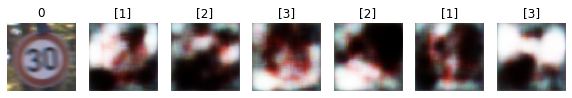

Epoch 1210 g_loss= 1.5415546 d_loss= 0.27979553 real_acc= 0.94 fake_acc= 0.9
Epoch 1220 g_loss= 1.5459384 d_loss= 0.31111044 real_acc= 0.88 fake_acc= 0.9
Epoch 1230 g_loss= 1.6470112 d_loss= 0.47430968 real_acc= 0.7 fake_acc= 0.9
Epoch 1240 g_loss= 1.538033 d_loss= 0.31016904 real_acc= 0.92 fake_acc= 0.94
Epoch 1250 g_loss= 1.1495534 d_loss= 0.3806445 real_acc= 0.9 fake_acc= 0.76
Epoch 1260 g_loss= 1.1200763 d_loss= 0.3788442 real_acc= 0.9 fake_acc= 0.8
Epoch 1270 g_loss= 1.2336318 d_loss= 0.39140415 real_acc= 0.88 fake_acc= 0.82
Epoch 1280 g_loss= 1.391174 d_loss= 0.34961033 real_acc= 0.92 fake_acc= 0.92
Epoch 1290 g_loss= 1.5025481 d_loss= 0.32090238 real_acc= 0.92 fake_acc= 0.88
Epoch 1300 g_loss= 1.600582 d_loss= 0.34710234 real_acc= 0.84 fake_acc= 0.96


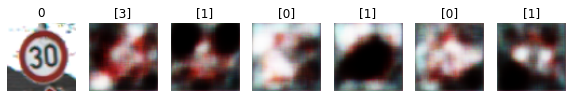

Epoch 1310 g_loss= 1.5827303 d_loss= 0.30078745 real_acc= 0.88 fake_acc= 0.96
Epoch 1320 g_loss= 1.4662176 d_loss= 0.3878239 real_acc= 0.86 fake_acc= 0.9
Epoch 1330 g_loss= 1.4522482 d_loss= 0.4289683 real_acc= 0.8 fake_acc= 0.86
Epoch 1340 g_loss= 1.6521881 d_loss= 0.34643427 real_acc= 0.86 fake_acc= 0.94
Epoch 1350 g_loss= 1.5873325 d_loss= 0.3570729 real_acc= 0.78 fake_acc= 0.96
Epoch 1360 g_loss= 1.5927324 d_loss= 0.38122332 real_acc= 0.78 fake_acc= 0.96
Epoch 1370 g_loss= 1.6757917 d_loss= 0.3546222 real_acc= 0.84 fake_acc= 0.96
Epoch 1380 g_loss= 1.4455147 d_loss= 0.40080976 real_acc= 0.8 fake_acc= 0.88
Epoch 1390 g_loss= 1.4348694 d_loss= 0.413915 real_acc= 0.84 fake_acc= 0.92
Epoch 1400 g_loss= 1.5301948 d_loss= 0.39258987 real_acc= 0.88 fake_acc= 0.84


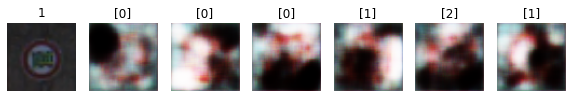

Epoch 1410 g_loss= 1.5386071 d_loss= 0.35476702 real_acc= 0.88 fake_acc= 0.98
Epoch 1420 g_loss= 1.5544258 d_loss= 0.38436896 real_acc= 0.82 fake_acc= 0.98
Epoch 1430 g_loss= 1.6393406 d_loss= 0.25717306 real_acc= 0.92 fake_acc= 0.96
Epoch 1440 g_loss= 1.3030002 d_loss= 0.36609203 real_acc= 0.92 fake_acc= 0.84
Epoch 1450 g_loss= 1.388043 d_loss= 0.37229276 real_acc= 0.86 fake_acc= 0.82
Epoch 1460 g_loss= 1.3113928 d_loss= 0.37237483 real_acc= 0.84 fake_acc= 0.84
Epoch 1470 g_loss= 1.5351892 d_loss= 0.30507404 real_acc= 0.92 fake_acc= 0.82
Epoch 1480 g_loss= 1.5495083 d_loss= 0.40151656 real_acc= 0.82 fake_acc= 0.9
Epoch 1490 g_loss= 1.3798393 d_loss= 0.42756987 real_acc= 0.84 fake_acc= 0.8
Epoch 1500 g_loss= 1.5179169 d_loss= 0.39829186 real_acc= 0.76 fake_acc= 0.88


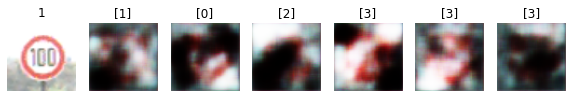

Epoch 1510 g_loss= 1.3527662 d_loss= 0.36063868 real_acc= 0.88 fake_acc= 0.84
Epoch 1520 g_loss= 1.345898 d_loss= 0.3874842 real_acc= 0.88 fake_acc= 0.92
Epoch 1530 g_loss= 1.3805486 d_loss= 0.41219026 real_acc= 0.86 fake_acc= 0.8
Epoch 1540 g_loss= 1.2454823 d_loss= 0.37950745 real_acc= 0.88 fake_acc= 0.82
Epoch 1550 g_loss= 1.6998992 d_loss= 0.49841988 real_acc= 0.72 fake_acc= 0.96
Epoch 1560 g_loss= 1.3410896 d_loss= 0.44496354 real_acc= 0.82 fake_acc= 0.92
Epoch 1570 g_loss= 1.2517653 d_loss= 0.33582634 real_acc= 0.9 fake_acc= 0.78
Epoch 1580 g_loss= 1.4049389 d_loss= 0.36558408 real_acc= 0.84 fake_acc= 0.86
Epoch 1590 g_loss= 1.3971345 d_loss= 0.3107746 real_acc= 0.96 fake_acc= 0.88
Epoch 1600 g_loss= 1.3199358 d_loss= 0.42877364 real_acc= 0.82 fake_acc= 0.82


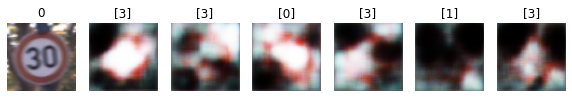

Epoch 1610 g_loss= 1.5745953 d_loss= 0.4074533 real_acc= 0.84 fake_acc= 0.94
Epoch 1620 g_loss= 1.56858 d_loss= 0.3115089 real_acc= 0.86 fake_acc= 0.94
Epoch 1630 g_loss= 1.6992989 d_loss= 0.33925053 real_acc= 0.84 fake_acc= 1.0
Epoch 1640 g_loss= 1.4333366 d_loss= 0.37902558 real_acc= 0.82 fake_acc= 0.84
Epoch 1650 g_loss= 1.5184085 d_loss= 0.3819916 real_acc= 0.78 fake_acc= 0.98
Epoch 1660 g_loss= 1.3580862 d_loss= 0.4033453 real_acc= 0.78 fake_acc= 0.82
Epoch 1670 g_loss= 1.3138865 d_loss= 0.45000115 real_acc= 0.78 fake_acc= 0.86
Epoch 1680 g_loss= 1.5482161 d_loss= 0.400545 real_acc= 0.8 fake_acc= 0.94
Epoch 1690 g_loss= 1.7136863 d_loss= 0.38617152 real_acc= 0.82 fake_acc= 0.9
Epoch 1700 g_loss= 1.6039182 d_loss= 0.380475 real_acc= 0.8 fake_acc= 0.96


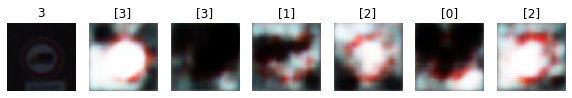

Epoch 1710 g_loss= 1.6521194 d_loss= 0.4004604 real_acc= 0.78 fake_acc= 0.96
Epoch 1720 g_loss= 1.5019413 d_loss= 0.44562638 real_acc= 0.78 fake_acc= 0.94
Epoch 1730 g_loss= 1.7346604 d_loss= 0.33013403 real_acc= 0.9 fake_acc= 0.96
Epoch 1740 g_loss= 1.334619 d_loss= 0.4672962 real_acc= 0.78 fake_acc= 0.88
Epoch 1750 g_loss= 1.4033128 d_loss= 0.41266245 real_acc= 0.8 fake_acc= 0.88
Epoch 1760 g_loss= 1.3578421 d_loss= 0.42124477 real_acc= 0.82 fake_acc= 0.84
Epoch 1770 g_loss= 1.6950868 d_loss= 0.46001118 real_acc= 0.7 fake_acc= 0.96
Epoch 1780 g_loss= 1.3384994 d_loss= 0.45642442 real_acc= 0.8 fake_acc= 0.82
Epoch 1790 g_loss= 1.6444474 d_loss= 0.39557514 real_acc= 0.8 fake_acc= 0.96
Epoch 1800 g_loss= 1.5973942 d_loss= 0.36620748 real_acc= 0.86 fake_acc= 0.86


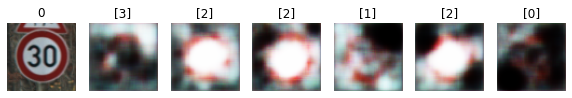

Epoch 1810 g_loss= 1.3396419 d_loss= 0.43239778 real_acc= 0.78 fake_acc= 0.94
Epoch 1820 g_loss= 1.4972986 d_loss= 0.41726154 real_acc= 0.82 fake_acc= 0.86
Epoch 1830 g_loss= 1.2733806 d_loss= 0.4221199 real_acc= 0.8 fake_acc= 0.82
Epoch 1840 g_loss= 1.6518189 d_loss= 0.38680282 real_acc= 0.8 fake_acc= 1.0
Epoch 1850 g_loss= 1.4380118 d_loss= 0.4190809 real_acc= 0.82 fake_acc= 0.9
Epoch 1860 g_loss= 1.4486791 d_loss= 0.42441967 real_acc= 0.76 fake_acc= 0.9
Epoch 1870 g_loss= 1.3515353 d_loss= 0.407617 real_acc= 0.86 fake_acc= 0.94
Epoch 1880 g_loss= 1.2133679 d_loss= 0.41637313 real_acc= 0.84 fake_acc= 0.76
Epoch 1890 g_loss= 1.2489033 d_loss= 0.4594689 real_acc= 0.76 fake_acc= 0.94
Epoch 1900 g_loss= 1.0871682 d_loss= 0.4373396 real_acc= 0.86 fake_acc= 0.78


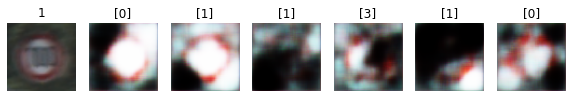

Epoch 1910 g_loss= 1.2686917 d_loss= 0.41746038 real_acc= 0.78 fake_acc= 0.8
Epoch 1920 g_loss= 1.3252846 d_loss= 0.4957186 real_acc= 0.82 fake_acc= 0.8
Epoch 1930 g_loss= 1.4223727 d_loss= 0.32529628 real_acc= 0.9 fake_acc= 0.9
Epoch 1940 g_loss= 1.2568101 d_loss= 0.40330395 real_acc= 0.88 fake_acc= 0.82
Epoch 1950 g_loss= 1.4549333 d_loss= 0.4011838 real_acc= 0.82 fake_acc= 0.86
Epoch 1960 g_loss= 1.568795 d_loss= 0.40405717 real_acc= 0.82 fake_acc= 0.94
Epoch 1970 g_loss= 1.3243463 d_loss= 0.5399994 real_acc= 0.74 fake_acc= 0.8
Epoch 1980 g_loss= 1.3687967 d_loss= 0.49072075 real_acc= 0.7 fake_acc= 0.94
Epoch 1990 g_loss= 1.3132913 d_loss= 0.4134716 real_acc= 0.8 fake_acc= 0.9
Epoch 2000 g_loss= 1.3026628 d_loss= 0.3807453 real_acc= 0.88 fake_acc= 0.84


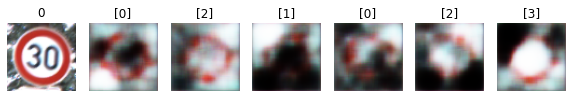

Epoch 2010 g_loss= 1.3411744 d_loss= 0.3919211 real_acc= 0.88 fake_acc= 0.86
Epoch 2020 g_loss= 1.3821646 d_loss= 0.36527056 real_acc= 0.9 fake_acc= 0.88
Epoch 2030 g_loss= 1.2404819 d_loss= 0.35790128 real_acc= 0.98 fake_acc= 0.88
Epoch 2040 g_loss= 1.2400001 d_loss= 0.4232021 real_acc= 0.88 fake_acc= 0.78
Epoch 2050 g_loss= 1.2476443 d_loss= 0.43434674 real_acc= 0.84 fake_acc= 0.88
Epoch 2060 g_loss= 1.2835072 d_loss= 0.38768834 real_acc= 0.9 fake_acc= 0.82
Epoch 2070 g_loss= 1.0712773 d_loss= 0.5032292 real_acc= 0.82 fake_acc= 0.78
Epoch 2080 g_loss= 1.0825231 d_loss= 0.49144065 real_acc= 0.82 fake_acc= 0.72
Epoch 2090 g_loss= 1.1493979 d_loss= 0.4443084 real_acc= 0.86 fake_acc= 0.8
Epoch 2100 g_loss= 1.437251 d_loss= 0.41586423 real_acc= 0.82 fake_acc= 0.92


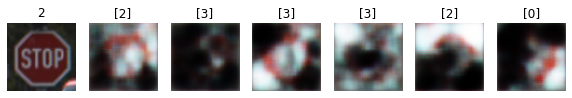

Epoch 2110 g_loss= 1.2017295 d_loss= 0.38927543 real_acc= 0.92 fake_acc= 0.8
Epoch 2120 g_loss= 1.1831573 d_loss= 0.37941986 real_acc= 0.9 fake_acc= 0.88
Epoch 2130 g_loss= 1.1572942 d_loss= 0.4464022 real_acc= 0.84 fake_acc= 0.72
Epoch 2140 g_loss= 1.3082428 d_loss= 0.37779626 real_acc= 0.86 fake_acc= 0.88
Epoch 2150 g_loss= 1.6117526 d_loss= 0.44926274 real_acc= 0.74 fake_acc= 0.98
Epoch 2160 g_loss= 1.8609465 d_loss= 0.4104505 real_acc= 0.76 fake_acc= 0.98
Epoch 2170 g_loss= 1.4593745 d_loss= 0.43172342 real_acc= 0.78 fake_acc= 0.94
Epoch 2180 g_loss= 1.3392246 d_loss= 0.38988942 real_acc= 0.86 fake_acc= 0.94
Epoch 2190 g_loss= 1.590133 d_loss= 0.47471678 real_acc= 0.76 fake_acc= 0.96
Epoch 2200 g_loss= 1.444119 d_loss= 0.4355309 real_acc= 0.78 fake_acc= 0.98


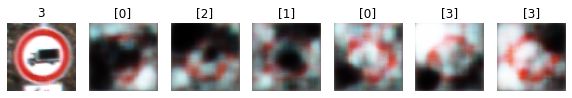

Epoch 2210 g_loss= 1.2661431 d_loss= 0.45835412 real_acc= 0.82 fake_acc= 0.84
Epoch 2220 g_loss= 1.2212987 d_loss= 0.38965726 real_acc= 0.88 fake_acc= 0.86
Epoch 2230 g_loss= 1.2961075 d_loss= 0.3678426 real_acc= 0.92 fake_acc= 0.82
Epoch 2240 g_loss= 1.2278152 d_loss= 0.44095752 real_acc= 0.82 fake_acc= 0.86
Epoch 2250 g_loss= 1.1908646 d_loss= 0.41875893 real_acc= 0.84 fake_acc= 0.84
Epoch 2260 g_loss= 1.175621 d_loss= 0.44263673 real_acc= 0.84 fake_acc= 0.88
Epoch 2270 g_loss= 1.2882183 d_loss= 0.39706224 real_acc= 0.84 fake_acc= 0.92
Epoch 2280 g_loss= 1.4863392 d_loss= 0.38315862 real_acc= 0.84 fake_acc= 0.88
Epoch 2290 g_loss= 1.4892168 d_loss= 0.40922445 real_acc= 0.82 fake_acc= 0.92
Epoch 2300 g_loss= 1.3825244 d_loss= 0.3792436 real_acc= 0.84 fake_acc= 0.9


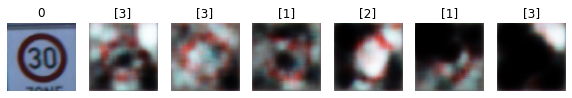

Epoch 2310 g_loss= 1.2126069 d_loss= 0.4237991 real_acc= 0.82 fake_acc= 0.88
Epoch 2320 g_loss= 1.44422 d_loss= 0.46524936 real_acc= 0.8 fake_acc= 0.82
Epoch 2330 g_loss= 1.131773 d_loss= 0.4305843 real_acc= 0.9 fake_acc= 0.7
Epoch 2340 g_loss= 1.1588707 d_loss= 0.46712506 real_acc= 0.78 fake_acc= 0.84
Epoch 2350 g_loss= 1.2405238 d_loss= 0.36660975 real_acc= 0.94 fake_acc= 0.84
Epoch 2360 g_loss= 1.4817578 d_loss= 0.33238903 real_acc= 0.88 fake_acc= 0.94
Epoch 2370 g_loss= 1.5695583 d_loss= 0.45052588 real_acc= 0.7 fake_acc= 0.9
Epoch 2380 g_loss= 1.5178914 d_loss= 0.42003733 real_acc= 0.76 fake_acc= 0.92
Epoch 2390 g_loss= 1.3088715 d_loss= 0.40527004 real_acc= 0.86 fake_acc= 0.98
Epoch 2400 g_loss= 1.1916416 d_loss= 0.40346375 real_acc= 0.88 fake_acc= 0.86


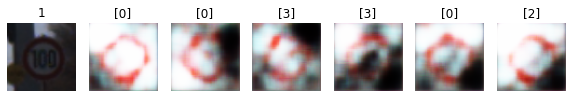

Epoch 2410 g_loss= 1.3593466 d_loss= 0.33848894 real_acc= 0.9 fake_acc= 0.9
Epoch 2420 g_loss= 1.6707399 d_loss= 0.37920284 real_acc= 0.78 fake_acc= 0.96
Epoch 2430 g_loss= 1.2592052 d_loss= 0.47580764 real_acc= 0.82 fake_acc= 0.78
Epoch 2440 g_loss= 1.3292574 d_loss= 0.36709186 real_acc= 0.92 fake_acc= 0.8
Epoch 2450 g_loss= 1.425543 d_loss= 0.44960374 real_acc= 0.72 fake_acc= 0.92
Epoch 2460 g_loss= 1.514849 d_loss= 0.38174316 real_acc= 0.88 fake_acc= 0.98
Epoch 2470 g_loss= 1.5058184 d_loss= 0.42485252 real_acc= 0.86 fake_acc= 0.92
Epoch 2480 g_loss= 1.7546217 d_loss= 0.39592198 real_acc= 0.7 fake_acc= 1.0
Epoch 2490 g_loss= 1.5828607 d_loss= 0.38946104 real_acc= 0.8 fake_acc= 0.96
Epoch 2500 g_loss= 1.7056161 d_loss= 0.38685507 real_acc= 0.76 fake_acc= 0.94


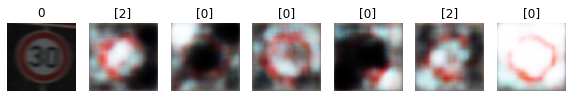

Epoch 2510 g_loss= 1.7849627 d_loss= 0.33273274 real_acc= 0.8 fake_acc= 0.98
Epoch 2520 g_loss= 1.5898085 d_loss= 0.36239457 real_acc= 0.86 fake_acc= 0.92
Epoch 2530 g_loss= 1.5661815 d_loss= 0.46644032 real_acc= 0.76 fake_acc= 0.92
Epoch 2540 g_loss= 1.3852957 d_loss= 0.37418735 real_acc= 0.88 fake_acc= 0.88
Epoch 2550 g_loss= 1.3345559 d_loss= 0.4000709 real_acc= 0.86 fake_acc= 0.9
Epoch 2560 g_loss= 1.3449591 d_loss= 0.40906858 real_acc= 0.84 fake_acc= 0.82
Epoch 2570 g_loss= 1.3002739 d_loss= 0.3821506 real_acc= 0.9 fake_acc= 0.9
Epoch 2580 g_loss= 1.427778 d_loss= 0.386915 real_acc= 0.86 fake_acc= 0.92
Epoch 2590 g_loss= 1.4861581 d_loss= 0.35712618 real_acc= 0.88 fake_acc= 0.94
Epoch 2600 g_loss= 1.3825862 d_loss= 0.3927257 real_acc= 0.88 fake_acc= 0.9


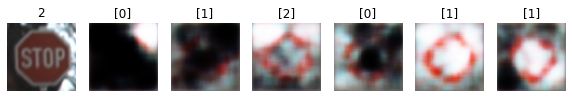

Epoch 2610 g_loss= 1.1875725 d_loss= 0.3805856 real_acc= 0.9 fake_acc= 0.82
Epoch 2620 g_loss= 1.4404788 d_loss= 0.39367476 real_acc= 0.86 fake_acc= 0.92
Epoch 2630 g_loss= 1.3076569 d_loss= 0.4107329 real_acc= 0.82 fake_acc= 0.88
Epoch 2640 g_loss= 1.3748151 d_loss= 0.39247996 real_acc= 0.82 fake_acc= 0.88
Epoch 2650 g_loss= 1.2533344 d_loss= 0.4141218 real_acc= 0.9 fake_acc= 0.8
Epoch 2660 g_loss= 1.1342442 d_loss= 0.4108328 real_acc= 0.9 fake_acc= 0.8
Epoch 2670 g_loss= 1.3934965 d_loss= 0.43731335 real_acc= 0.78 fake_acc= 0.9
Epoch 2680 g_loss= 1.3327415 d_loss= 0.37356478 real_acc= 0.88 fake_acc= 0.88
Epoch 2690 g_loss= 1.3231001 d_loss= 0.41016793 real_acc= 0.82 fake_acc= 0.88
Epoch 2700 g_loss= 1.4473342 d_loss= 0.3650278 real_acc= 0.88 fake_acc= 0.94


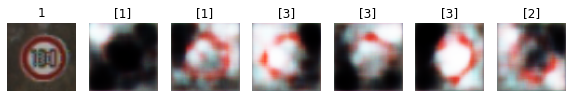

Epoch 2710 g_loss= 1.3320205 d_loss= 0.37445927 real_acc= 0.9 fake_acc= 0.9
Epoch 2720 g_loss= 1.3947204 d_loss= 0.38870218 real_acc= 0.82 fake_acc= 0.9
Epoch 2730 g_loss= 1.2962921 d_loss= 0.5108407 real_acc= 0.78 fake_acc= 0.84
Epoch 2740 g_loss= 1.8045353 d_loss= 0.32975447 real_acc= 0.86 fake_acc= 0.98
Epoch 2750 g_loss= 1.2233096 d_loss= 0.40400016 real_acc= 0.86 fake_acc= 0.74
Epoch 2760 g_loss= 1.3889319 d_loss= 0.30971625 real_acc= 0.94 fake_acc= 0.92
Epoch 2770 g_loss= 1.1882416 d_loss= 0.3615308 real_acc= 0.96 fake_acc= 0.84
Epoch 2780 g_loss= 1.5358331 d_loss= 0.37574968 real_acc= 0.82 fake_acc= 0.94
Epoch 2790 g_loss= 1.2848425 d_loss= 0.36647892 real_acc= 0.88 fake_acc= 0.92
Epoch 2800 g_loss= 1.4590737 d_loss= 0.397974 real_acc= 0.82 fake_acc= 0.92


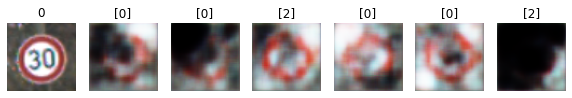

Epoch 2810 g_loss= 1.485922 d_loss= 0.3916129 real_acc= 0.78 fake_acc= 0.98
Epoch 2820 g_loss= 1.1850107 d_loss= 0.37658167 real_acc= 0.9 fake_acc= 0.9
Epoch 2830 g_loss= 1.2730786 d_loss= 0.36605784 real_acc= 0.9 fake_acc= 0.84
Epoch 2840 g_loss= 1.1998061 d_loss= 0.39820868 real_acc= 0.86 fake_acc= 0.84
Epoch 2850 g_loss= 1.2102914 d_loss= 0.3531858 real_acc= 0.96 fake_acc= 0.8
Epoch 2860 g_loss= 1.5818802 d_loss= 0.37360054 real_acc= 0.76 fake_acc= 0.96
Epoch 2870 g_loss= 1.7181355 d_loss= 0.39973694 real_acc= 0.78 fake_acc= 0.96
Epoch 2880 g_loss= 1.4665794 d_loss= 0.3834089 real_acc= 0.86 fake_acc= 0.88
Epoch 2890 g_loss= 1.510098 d_loss= 0.38351452 real_acc= 0.82 fake_acc= 0.88
Epoch 2900 g_loss= 1.4942781 d_loss= 0.43539524 real_acc= 0.82 fake_acc= 0.9


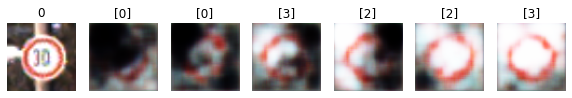

Epoch 2910 g_loss= 1.585877 d_loss= 0.35965684 real_acc= 0.84 fake_acc= 0.96
Epoch 2920 g_loss= 1.3980362 d_loss= 0.39747185 real_acc= 0.84 fake_acc= 0.96
Epoch 2930 g_loss= 1.1017562 d_loss= 0.41094923 real_acc= 0.88 fake_acc= 0.82
Epoch 2940 g_loss= 1.0211756 d_loss= 0.4380439 real_acc= 0.86 fake_acc= 0.76
Epoch 2950 g_loss= 1.3351641 d_loss= 0.3949746 real_acc= 0.84 fake_acc= 0.88
Epoch 2960 g_loss= 1.388214 d_loss= 0.42645773 real_acc= 0.82 fake_acc= 0.9
Epoch 2970 g_loss= 1.5733532 d_loss= 0.3659276 real_acc= 0.88 fake_acc= 0.9
Epoch 2980 g_loss= 1.4687613 d_loss= 0.318721 real_acc= 0.92 fake_acc= 0.92
Epoch 2990 g_loss= 1.5549961 d_loss= 0.41667235 real_acc= 0.82 fake_acc= 0.96
Epoch 3000 g_loss= 1.7355146 d_loss= 0.37663305 real_acc= 0.74 fake_acc= 0.96


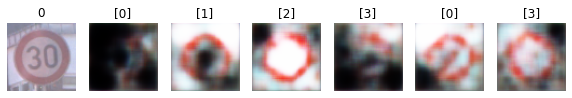

Epoch 3010 g_loss= 1.4784943 d_loss= 0.40412536 real_acc= 0.84 fake_acc= 0.94
Epoch 3020 g_loss= 1.5217896 d_loss= 0.3800766 real_acc= 0.84 fake_acc= 0.9
Epoch 3030 g_loss= 1.5317825 d_loss= 0.3543936 real_acc= 0.82 fake_acc= 0.92
Epoch 3040 g_loss= 1.359399 d_loss= 0.35981104 real_acc= 0.94 fake_acc= 0.84
Epoch 3050 g_loss= 1.5456334 d_loss= 0.3187604 real_acc= 0.94 fake_acc= 0.86
Epoch 3060 g_loss= 1.3598193 d_loss= 0.33231977 real_acc= 0.9 fake_acc= 0.86
Epoch 3070 g_loss= 1.1052991 d_loss= 0.42663717 real_acc= 0.84 fake_acc= 0.76
Epoch 3080 g_loss= 0.9927151 d_loss= 0.40515995 real_acc= 0.94 fake_acc= 0.72
Epoch 3090 g_loss= 1.3265402 d_loss= 0.35661238 real_acc= 0.9 fake_acc= 0.86
Epoch 3100 g_loss= 1.4006687 d_loss= 0.40564874 real_acc= 0.86 fake_acc= 0.94


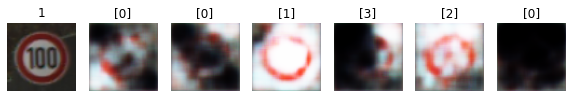

Epoch 3110 g_loss= 1.5185618 d_loss= 0.41966307 real_acc= 0.76 fake_acc= 0.94
Epoch 3120 g_loss= 1.0553734 d_loss= 0.408851 real_acc= 0.86 fake_acc= 0.72
Epoch 3130 g_loss= 1.4389458 d_loss= 0.3677885 real_acc= 0.86 fake_acc= 0.88
Epoch 3140 g_loss= 1.2716011 d_loss= 0.46244216 real_acc= 0.74 fake_acc= 0.88
Epoch 3150 g_loss= 1.3872976 d_loss= 0.36906138 real_acc= 0.92 fake_acc= 0.88
Epoch 3160 g_loss= 1.6020426 d_loss= 0.37395245 real_acc= 0.82 fake_acc= 0.9
Epoch 3170 g_loss= 1.7356874 d_loss= 0.37268907 real_acc= 0.86 fake_acc= 0.98
Epoch 3180 g_loss= 1.6086764 d_loss= 0.34191075 real_acc= 0.86 fake_acc= 0.98
Epoch 3190 g_loss= 1.4018147 d_loss= 0.3424242 real_acc= 0.92 fake_acc= 0.88
Epoch 3200 g_loss= 1.6334052 d_loss= 0.36539882 real_acc= 0.78 fake_acc= 0.94


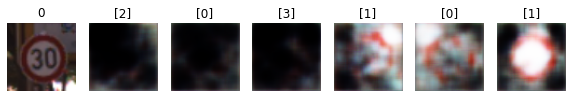

Epoch 3210 g_loss= 1.5692227 d_loss= 0.34790993 real_acc= 0.86 fake_acc= 0.92
Epoch 3220 g_loss= 1.9737961 d_loss= 0.46578604 real_acc= 0.72 fake_acc= 0.92
Epoch 3230 g_loss= 1.7265065 d_loss= 0.327035 real_acc= 0.8 fake_acc= 0.96
Epoch 3240 g_loss= 1.4564776 d_loss= 0.32171404 real_acc= 0.88 fake_acc= 0.94
Epoch 3250 g_loss= 1.3044156 d_loss= 0.36257073 real_acc= 0.84 fake_acc= 0.9
Epoch 3260 g_loss= 1.2990286 d_loss= 0.39669186 real_acc= 0.86 fake_acc= 0.9
Epoch 3270 g_loss= 1.8354988 d_loss= 0.38677543 real_acc= 0.74 fake_acc= 0.98
Epoch 3280 g_loss= 1.5348177 d_loss= 0.40494436 real_acc= 0.76 fake_acc= 0.98
Epoch 3290 g_loss= 1.3267281 d_loss= 0.3844737 real_acc= 0.9 fake_acc= 0.82
Epoch 3300 g_loss= 1.4738624 d_loss= 0.354751 real_acc= 0.84 fake_acc= 0.92


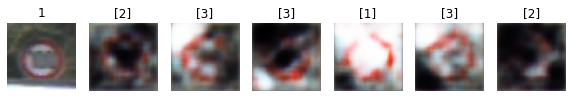

Epoch 3310 g_loss= 1.6276726 d_loss= 0.33624026 real_acc= 0.84 fake_acc= 0.96
Epoch 3320 g_loss= 1.5353038 d_loss= 0.3930462 real_acc= 0.84 fake_acc= 0.88
Epoch 3330 g_loss= 1.4517723 d_loss= 0.3073753 real_acc= 0.9 fake_acc= 0.9
Epoch 3340 g_loss= 1.3045611 d_loss= 0.35154718 real_acc= 0.92 fake_acc= 0.84
Epoch 3350 g_loss= 1.6148689 d_loss= 0.3903776 real_acc= 0.82 fake_acc= 0.94
Epoch 3360 g_loss= 1.2747333 d_loss= 0.35961306 real_acc= 0.92 fake_acc= 0.86
Epoch 3370 g_loss= 1.40036 d_loss= 0.37869346 real_acc= 0.86 fake_acc= 0.92
Epoch 3380 g_loss= 1.571556 d_loss= 0.4151547 real_acc= 0.74 fake_acc= 0.96
Epoch 3390 g_loss= 1.5080402 d_loss= 0.3620596 real_acc= 0.9 fake_acc= 0.86
Epoch 3400 g_loss= 1.3782669 d_loss= 0.41361618 real_acc= 0.82 fake_acc= 0.9


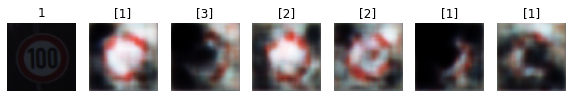

Epoch 3410 g_loss= 1.287624 d_loss= 0.37838233 real_acc= 0.86 fake_acc= 0.88
Epoch 3420 g_loss= 1.1740104 d_loss= 0.39085966 real_acc= 0.86 fake_acc= 0.82
Epoch 3430 g_loss= 1.3202744 d_loss= 0.37119558 real_acc= 0.86 fake_acc= 0.88
Epoch 3440 g_loss= 1.7192928 d_loss= 0.44560456 real_acc= 0.74 fake_acc= 0.94
Epoch 3450 g_loss= 1.652564 d_loss= 0.3904694 real_acc= 0.8 fake_acc= 0.96
Epoch 3460 g_loss= 1.4944011 d_loss= 0.3678126 real_acc= 0.82 fake_acc= 0.92
Epoch 3470 g_loss= 1.3139523 d_loss= 0.4053021 real_acc= 0.82 fake_acc= 0.92
Epoch 3480 g_loss= 1.3728372 d_loss= 0.36819676 real_acc= 0.86 fake_acc= 0.96
Epoch 3490 g_loss= 1.3764377 d_loss= 0.35482126 real_acc= 0.9 fake_acc= 0.88
Epoch 3500 g_loss= 1.7987132 d_loss= 0.38011312 real_acc= 0.78 fake_acc= 0.96


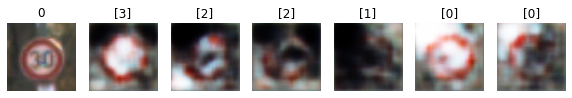

Epoch 3510 g_loss= 1.4968153 d_loss= 0.36349732 real_acc= 0.86 fake_acc= 0.92
Epoch 3520 g_loss= 1.3649971 d_loss= 0.3611732 real_acc= 0.92 fake_acc= 0.86
Epoch 3530 g_loss= 1.3528392 d_loss= 0.34055582 real_acc= 0.92 fake_acc= 0.92
Epoch 3540 g_loss= 1.3215162 d_loss= 0.39935106 real_acc= 0.86 fake_acc= 0.84
Epoch 3550 g_loss= 1.859752 d_loss= 0.3394007 real_acc= 0.86 fake_acc= 1.0
Epoch 3560 g_loss= 1.7223544 d_loss= 0.413158 real_acc= 0.76 fake_acc= 0.96
Epoch 3570 g_loss= 1.5181128 d_loss= 0.38134015 real_acc= 0.84 fake_acc= 0.9
Epoch 3580 g_loss= 1.2716761 d_loss= 0.33656806 real_acc= 0.96 fake_acc= 0.8
Epoch 3590 g_loss= 1.4488807 d_loss= 0.35778922 real_acc= 0.9 fake_acc= 0.86
Epoch 3600 g_loss= 1.5517651 d_loss= 0.4267898 real_acc= 0.76 fake_acc= 0.92


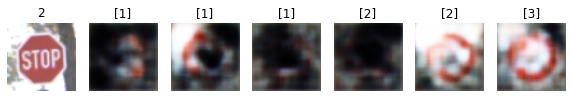

Epoch 3610 g_loss= 1.7572192 d_loss= 0.40642816 real_acc= 0.76 fake_acc= 0.92
Epoch 3620 g_loss= 1.520657 d_loss= 0.37360233 real_acc= 0.8 fake_acc= 0.88
Epoch 3630 g_loss= 1.2501913 d_loss= 0.42504108 real_acc= 0.84 fake_acc= 0.8
Epoch 3640 g_loss= 1.6037139 d_loss= 0.34518677 real_acc= 0.86 fake_acc= 0.94
Epoch 3650 g_loss= 1.3145795 d_loss= 0.36334753 real_acc= 0.84 fake_acc= 0.88
Epoch 3660 g_loss= 1.7924484 d_loss= 0.37953067 real_acc= 0.8 fake_acc= 0.94
Epoch 3670 g_loss= 1.3310963 d_loss= 0.40095592 real_acc= 0.8 fake_acc= 0.9
Epoch 3680 g_loss= 1.2318408 d_loss= 0.3815796 real_acc= 0.96 fake_acc= 0.86
Epoch 3690 g_loss= 1.5666791 d_loss= 0.39769402 real_acc= 0.78 fake_acc= 0.88
Epoch 3700 g_loss= 1.5474734 d_loss= 0.35687757 real_acc= 0.84 fake_acc= 0.96


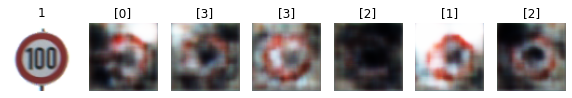

Epoch 3710 g_loss= 1.6952168 d_loss= 0.4178606 real_acc= 0.74 fake_acc= 0.96
Epoch 3720 g_loss= 1.3479793 d_loss= 0.32584292 real_acc= 0.88 fake_acc= 0.88
Epoch 3730 g_loss= 1.4786754 d_loss= 0.3786155 real_acc= 0.8 fake_acc= 0.94
Epoch 3740 g_loss= 1.2338582 d_loss= 0.4144137 real_acc= 0.86 fake_acc= 0.86
Epoch 3750 g_loss= 1.3616035 d_loss= 0.44215292 real_acc= 0.7 fake_acc= 0.86
Epoch 3760 g_loss= 1.4500558 d_loss= 0.33174282 real_acc= 0.86 fake_acc= 0.9
Epoch 3770 g_loss= 1.5913281 d_loss= 0.38389054 real_acc= 0.78 fake_acc= 0.92
Epoch 3780 g_loss= 1.4786313 d_loss= 0.34232453 real_acc= 0.9 fake_acc= 0.86
Epoch 3790 g_loss= 1.364885 d_loss= 0.35114348 real_acc= 0.92 fake_acc= 0.82
Epoch 3800 g_loss= 1.4691275 d_loss= 0.3480152 real_acc= 0.88 fake_acc= 0.96


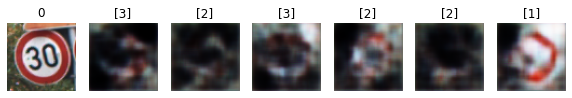

Epoch 3810 g_loss= 1.6219286 d_loss= 0.34716225 real_acc= 0.88 fake_acc= 0.9
Epoch 3820 g_loss= 1.7222981 d_loss= 0.36414695 real_acc= 0.72 fake_acc= 0.98
Epoch 3830 g_loss= 1.3048822 d_loss= 0.4492526 real_acc= 0.82 fake_acc= 0.78
Epoch 3840 g_loss= 1.2051224 d_loss= 0.35827392 real_acc= 0.96 fake_acc= 0.8
Epoch 3850 g_loss= 1.5398483 d_loss= 0.35885638 real_acc= 0.86 fake_acc= 0.9
Epoch 3860 g_loss= 1.783212 d_loss= 0.44705808 real_acc= 0.66 fake_acc= 0.94
Epoch 3870 g_loss= 1.421698 d_loss= 0.36318922 real_acc= 0.86 fake_acc= 0.94
Epoch 3880 g_loss= 1.1003654 d_loss= 0.38434106 real_acc= 0.92 fake_acc= 0.72
Epoch 3890 g_loss= 1.4517517 d_loss= 0.32682604 real_acc= 0.92 fake_acc= 0.92
Epoch 3900 g_loss= 1.6645147 d_loss= 0.34143764 real_acc= 0.88 fake_acc= 0.96


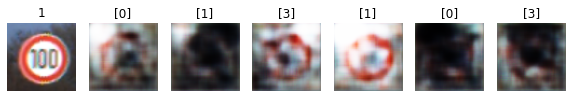

Epoch 3910 g_loss= 1.513011 d_loss= 0.3177356 real_acc= 0.9 fake_acc= 0.96
Epoch 3920 g_loss= 1.4221202 d_loss= 0.31354108 real_acc= 0.9 fake_acc= 0.9
Epoch 3930 g_loss= 1.4962735 d_loss= 0.34042805 real_acc= 0.84 fake_acc= 0.94
Epoch 3940 g_loss= 1.3938491 d_loss= 0.37360278 real_acc= 0.92 fake_acc= 0.84
Epoch 3950 g_loss= 1.5832818 d_loss= 0.34447998 real_acc= 0.9 fake_acc= 0.96
Epoch 3960 g_loss= 1.6462085 d_loss= 0.34399113 real_acc= 0.86 fake_acc= 0.92
Epoch 3970 g_loss= 1.4129128 d_loss= 0.35981578 real_acc= 0.88 fake_acc= 0.82
Epoch 3980 g_loss= 1.4764007 d_loss= 0.34370887 real_acc= 0.88 fake_acc= 0.9
Epoch 3990 g_loss= 1.365889 d_loss= 0.35129803 real_acc= 0.9 fake_acc= 0.86
Epoch 4000 g_loss= 1.2920814 d_loss= 0.34345633 real_acc= 0.94 fake_acc= 0.86


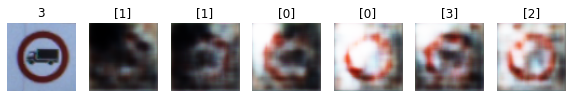

Epoch 4010 g_loss= 1.513413 d_loss= 0.30443504 real_acc= 0.9 fake_acc= 0.96
Epoch 4020 g_loss= 1.4894774 d_loss= 0.34769985 real_acc= 0.86 fake_acc= 0.94
Epoch 4030 g_loss= 1.2772807 d_loss= 0.4015448 real_acc= 0.84 fake_acc= 0.92
Epoch 4040 g_loss= 1.4856367 d_loss= 0.356855 real_acc= 0.82 fake_acc= 0.92
Epoch 4050 g_loss= 1.5301524 d_loss= 0.37481245 real_acc= 0.8 fake_acc= 0.82
Epoch 4060 g_loss= 1.3802408 d_loss= 0.40443286 real_acc= 0.86 fake_acc= 0.84
Epoch 4070 g_loss= 1.3154781 d_loss= 0.41121566 real_acc= 0.8 fake_acc= 0.8
Epoch 4080 g_loss= 1.7737491 d_loss= 0.34392262 real_acc= 0.78 fake_acc= 0.96
Epoch 4090 g_loss= 1.7706292 d_loss= 0.34347495 real_acc= 0.84 fake_acc= 0.94
Epoch 4100 g_loss= 1.4261832 d_loss= 0.33893588 real_acc= 0.9 fake_acc= 0.9


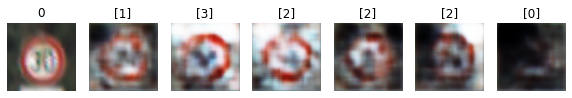

Epoch 4110 g_loss= 1.6606392 d_loss= 0.41320318 real_acc= 0.78 fake_acc= 0.92
Epoch 4120 g_loss= 1.5318136 d_loss= 0.34610677 real_acc= 0.9 fake_acc= 0.9
Epoch 4130 g_loss= 1.6857873 d_loss= 0.37533522 real_acc= 0.8 fake_acc= 0.94
Epoch 4140 g_loss= 1.2964574 d_loss= 0.36104542 real_acc= 0.94 fake_acc= 0.8
Epoch 4150 g_loss= 1.3623887 d_loss= 0.36623132 real_acc= 0.86 fake_acc= 0.88
Epoch 4160 g_loss= 1.5535345 d_loss= 0.3445474 real_acc= 0.88 fake_acc= 0.96
Epoch 4170 g_loss= 1.8464907 d_loss= 0.29389042 real_acc= 0.86 fake_acc= 0.98
Epoch 4180 g_loss= 1.4071635 d_loss= 0.3711745 real_acc= 0.88 fake_acc= 0.88
Epoch 4190 g_loss= 1.6486324 d_loss= 0.3391133 real_acc= 0.9 fake_acc= 0.96
Epoch 4200 g_loss= 1.7525221 d_loss= 0.3971544 real_acc= 0.72 fake_acc= 0.96


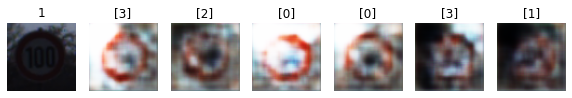

Epoch 4210 g_loss= 1.3526964 d_loss= 0.36829144 real_acc= 0.88 fake_acc= 0.94
Epoch 4220 g_loss= 1.4376743 d_loss= 0.35580564 real_acc= 0.82 fake_acc= 0.9
Epoch 4230 g_loss= 1.4035553 d_loss= 0.34465963 real_acc= 0.92 fake_acc= 0.88
Epoch 4240 g_loss= 1.4153533 d_loss= 0.40963823 real_acc= 0.82 fake_acc= 0.88
Epoch 4250 g_loss= 1.3806889 d_loss= 0.367091 real_acc= 0.84 fake_acc= 0.92
Epoch 4260 g_loss= 1.171237 d_loss= 0.3957239 real_acc= 0.9 fake_acc= 0.72
Epoch 4270 g_loss= 1.4298772 d_loss= 0.35180718 real_acc= 0.9 fake_acc= 0.92
Epoch 4280 g_loss= 1.7221378 d_loss= 0.47645727 real_acc= 0.7 fake_acc= 0.92
Epoch 4290 g_loss= 1.2357682 d_loss= 0.41788608 real_acc= 0.76 fake_acc= 0.84
Epoch 4300 g_loss= 1.4256133 d_loss= 0.3651896 real_acc= 0.88 fake_acc= 0.86


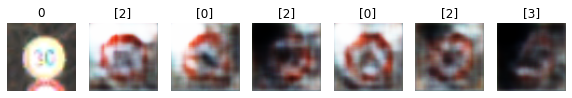

Epoch 4310 g_loss= 1.8158095 d_loss= 0.4327128 real_acc= 0.68 fake_acc= 0.98
Epoch 4320 g_loss= 1.682356 d_loss= 0.3542927 real_acc= 0.82 fake_acc= 0.96
Epoch 4330 g_loss= 1.2961344 d_loss= 0.3580187 real_acc= 0.86 fake_acc= 0.92
Epoch 4340 g_loss= 1.467771 d_loss= 0.33829403 real_acc= 0.88 fake_acc= 0.88
Epoch 4350 g_loss= 1.6150486 d_loss= 0.34855223 real_acc= 0.8 fake_acc= 0.96
Epoch 4360 g_loss= 1.4108353 d_loss= 0.3491773 real_acc= 0.9 fake_acc= 0.9
Epoch 4370 g_loss= 1.7680876 d_loss= 0.3643189 real_acc= 0.82 fake_acc= 0.96
Epoch 4380 g_loss= 1.6030084 d_loss= 0.33202475 real_acc= 0.9 fake_acc= 0.9
Epoch 4390 g_loss= 1.7744952 d_loss= 0.33306313 real_acc= 0.86 fake_acc= 0.98
Epoch 4400 g_loss= 1.6021005 d_loss= 0.35063434 real_acc= 0.82 fake_acc= 0.94


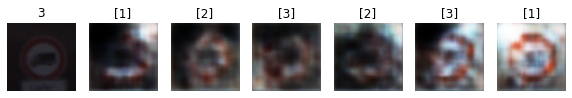

Epoch 4410 g_loss= 1.1259854 d_loss= 0.3914404 real_acc= 0.94 fake_acc= 0.8
Epoch 4420 g_loss= 1.1264625 d_loss= 0.39884555 real_acc= 0.9 fake_acc= 0.82
Epoch 4430 g_loss= 1.7740235 d_loss= 0.3291968 real_acc= 0.86 fake_acc= 0.96
Epoch 4440 g_loss= 1.5043247 d_loss= 0.4301015 real_acc= 0.7 fake_acc= 0.94
Epoch 4450 g_loss= 1.3750957 d_loss= 0.3514536 real_acc= 0.88 fake_acc= 0.88
Epoch 4460 g_loss= 1.2761421 d_loss= 0.3877332 real_acc= 0.86 fake_acc= 0.86
Epoch 4470 g_loss= 1.460854 d_loss= 0.3574704 real_acc= 0.86 fake_acc= 0.88
Epoch 4480 g_loss= 1.2715 d_loss= 0.37087452 real_acc= 0.94 fake_acc= 0.78
Epoch 4490 g_loss= 1.3927798 d_loss= 0.42711407 real_acc= 0.88 fake_acc= 0.82
Epoch 4500 g_loss= 1.8045897 d_loss= 0.4078518 real_acc= 0.64 fake_acc= 0.94


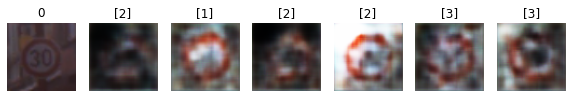

Epoch 4510 g_loss= 1.46711 d_loss= 0.39276057 real_acc= 0.76 fake_acc= 0.92
Epoch 4520 g_loss= 1.891085 d_loss= 0.34077257 real_acc= 0.82 fake_acc= 0.92
Epoch 4530 g_loss= 1.2287596 d_loss= 0.39120406 real_acc= 0.84 fake_acc= 0.88
Epoch 4540 g_loss= 1.3975829 d_loss= 0.33490884 real_acc= 0.92 fake_acc= 0.86
Epoch 4550 g_loss= 1.3488849 d_loss= 0.39062518 real_acc= 0.86 fake_acc= 0.84
Epoch 4560 g_loss= 2.0034828 d_loss= 0.42750373 real_acc= 0.66 fake_acc= 0.98
Epoch 4570 g_loss= 1.3316499 d_loss= 0.345675 real_acc= 0.88 fake_acc= 0.88
Epoch 4580 g_loss= 1.2676998 d_loss= 0.40276068 real_acc= 0.86 fake_acc= 0.82
Epoch 4590 g_loss= 1.7178793 d_loss= 0.39459932 real_acc= 0.74 fake_acc= 0.98
Epoch 4600 g_loss= 1.4621872 d_loss= 0.39889872 real_acc= 0.84 fake_acc= 0.84


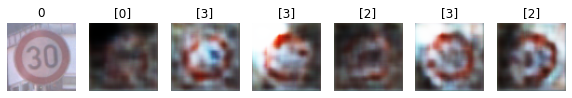

Epoch 4610 g_loss= 1.2549702 d_loss= 0.35190108 real_acc= 0.94 fake_acc= 0.86
Epoch 4620 g_loss= 1.2904855 d_loss= 0.37727615 real_acc= 0.92 fake_acc= 0.84
Epoch 4630 g_loss= 1.6285529 d_loss= 0.45557833 real_acc= 0.74 fake_acc= 0.94
Epoch 4640 g_loss= 1.6000551 d_loss= 0.40877432 real_acc= 0.78 fake_acc= 0.9
Epoch 4650 g_loss= 1.4339397 d_loss= 0.32513398 real_acc= 0.9 fake_acc= 0.94
Epoch 4660 g_loss= 1.3743702 d_loss= 0.43289685 real_acc= 0.68 fake_acc= 0.92
Epoch 4670 g_loss= 1.6876924 d_loss= 0.43708175 real_acc= 0.76 fake_acc= 0.92
Epoch 4680 g_loss= 1.7529904 d_loss= 0.43073583 real_acc= 0.66 fake_acc= 0.96
Epoch 4690 g_loss= 1.2035822 d_loss= 0.4055946 real_acc= 0.9 fake_acc= 0.76
Epoch 4700 g_loss= 1.2039603 d_loss= 0.3581012 real_acc= 0.96 fake_acc= 0.78


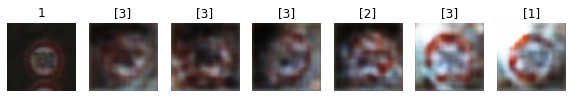

Epoch 4710 g_loss= 1.756948 d_loss= 0.36627197 real_acc= 0.8 fake_acc= 0.96
Epoch 4720 g_loss= 1.4117721 d_loss= 0.450037 real_acc= 0.74 fake_acc= 0.9
Epoch 4730 g_loss= 1.205475 d_loss= 0.37492356 real_acc= 0.9 fake_acc= 0.82
Epoch 4740 g_loss= 1.586073 d_loss= 0.48433083 real_acc= 0.62 fake_acc= 0.9
Epoch 4750 g_loss= 1.515748 d_loss= 0.36297637 real_acc= 0.82 fake_acc= 0.94
Epoch 4760 g_loss= 1.3343523 d_loss= 0.35642415 real_acc= 0.94 fake_acc= 0.8
Epoch 4770 g_loss= 1.3470608 d_loss= 0.3998989 real_acc= 0.88 fake_acc= 0.88
Epoch 4780 g_loss= 1.4031525 d_loss= 0.3670529 real_acc= 0.9 fake_acc= 0.9
Epoch 4790 g_loss= 1.5108835 d_loss= 0.35594743 real_acc= 0.88 fake_acc= 0.88
Epoch 4800 g_loss= 1.4723506 d_loss= 0.40050036 real_acc= 0.86 fake_acc= 0.94


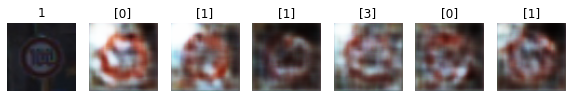

Epoch 4810 g_loss= 1.67061 d_loss= 0.3701324 real_acc= 0.82 fake_acc= 0.96
Epoch 4820 g_loss= 1.3043146 d_loss= 0.43049502 real_acc= 0.84 fake_acc= 0.8
Epoch 4830 g_loss= 1.5363905 d_loss= 0.34365937 real_acc= 0.88 fake_acc= 0.96
Epoch 4840 g_loss= 1.1274753 d_loss= 0.47999674 real_acc= 0.86 fake_acc= 0.68
Epoch 4850 g_loss= 1.2095996 d_loss= 0.46513563 real_acc= 0.78 fake_acc= 0.88
Epoch 4860 g_loss= 1.6925849 d_loss= 0.3691395 real_acc= 0.76 fake_acc= 0.92
Epoch 4870 g_loss= 1.598798 d_loss= 0.43329698 real_acc= 0.68 fake_acc= 0.86
Epoch 4880 g_loss= 1.3222611 d_loss= 0.39508718 real_acc= 0.86 fake_acc= 0.86
Epoch 4890 g_loss= 1.3810691 d_loss= 0.4066193 real_acc= 0.82 fake_acc= 0.84
Epoch 4900 g_loss= 1.2790526 d_loss= 0.3862836 real_acc= 0.92 fake_acc= 0.82


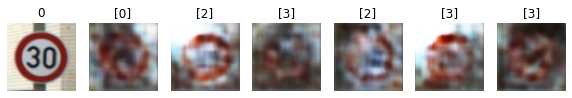

Epoch 4910 g_loss= 1.814555 d_loss= 0.38566983 real_acc= 0.76 fake_acc= 0.96
Epoch 4920 g_loss= 1.1666414 d_loss= 0.46674794 real_acc= 0.8 fake_acc= 0.76
Epoch 4930 g_loss= 1.1331631 d_loss= 0.45151043 real_acc= 0.86 fake_acc= 0.82
Epoch 4940 g_loss= 1.5341493 d_loss= 0.36278668 real_acc= 0.84 fake_acc= 0.94
Epoch 4950 g_loss= 1.799933 d_loss= 0.41326028 real_acc= 0.72 fake_acc= 0.96
Epoch 4960 g_loss= 1.2737105 d_loss= 0.38572943 real_acc= 0.88 fake_acc= 0.82
Epoch 4970 g_loss= 1.3373244 d_loss= 0.37159395 real_acc= 0.8 fake_acc= 0.86
Epoch 4980 g_loss= 1.1736169 d_loss= 0.41474742 real_acc= 0.88 fake_acc= 0.8
Epoch 4990 g_loss= 1.1362288 d_loss= 0.46702135 real_acc= 0.82 fake_acc= 0.76
Epoch 5000 g_loss= 1.521851 d_loss= 0.41447094 real_acc= 0.86 fake_acc= 0.86


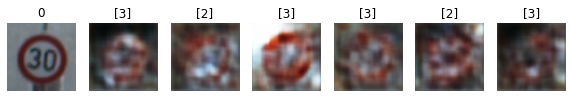

Epoch 5010 g_loss= 1.2250407 d_loss= 0.4508618 real_acc= 0.86 fake_acc= 0.84
Epoch 5020 g_loss= 1.217912 d_loss= 0.40785563 real_acc= 0.88 fake_acc= 0.82
Epoch 5030 g_loss= 1.4157557 d_loss= 0.4562497 real_acc= 0.8 fake_acc= 0.84
Epoch 5040 g_loss= 1.5153443 d_loss= 0.46173483 real_acc= 0.68 fake_acc= 0.94
Epoch 5050 g_loss= 1.3021736 d_loss= 0.46582794 real_acc= 0.82 fake_acc= 0.76
Epoch 5060 g_loss= 1.3217874 d_loss= 0.42175215 real_acc= 0.84 fake_acc= 0.82
Epoch 5070 g_loss= 1.3840644 d_loss= 0.4389226 real_acc= 0.78 fake_acc= 0.86
Epoch 5080 g_loss= 1.5717461 d_loss= 0.4694159 real_acc= 0.74 fake_acc= 0.82
Epoch 5090 g_loss= 1.3406409 d_loss= 0.4109402 real_acc= 0.84 fake_acc= 0.82
Epoch 5100 g_loss= 1.1366589 d_loss= 0.39873737 real_acc= 0.82 fake_acc= 0.86


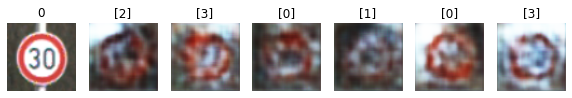

Epoch 5110 g_loss= 1.0946136 d_loss= 0.44268408 real_acc= 0.88 fake_acc= 0.72
Epoch 5120 g_loss= 1.383412 d_loss= 0.49872756 real_acc= 0.7 fake_acc= 0.84
Epoch 5130 g_loss= 1.1148876 d_loss= 0.43919498 real_acc= 0.82 fake_acc= 0.8
Epoch 5140 g_loss= 1.4511194 d_loss= 0.36447316 real_acc= 0.9 fake_acc= 0.9
Epoch 5150 g_loss= 1.6887321 d_loss= 0.47217703 real_acc= 0.72 fake_acc= 0.96
Epoch 5160 g_loss= 1.1901398 d_loss= 0.45270383 real_acc= 0.82 fake_acc= 0.76
Epoch 5170 g_loss= 1.4962834 d_loss= 0.4652039 real_acc= 0.74 fake_acc= 0.84
Epoch 5180 g_loss= 1.2835046 d_loss= 0.41243297 real_acc= 0.86 fake_acc= 0.84
Epoch 5190 g_loss= 1.8007511 d_loss= 0.43911237 real_acc= 0.68 fake_acc= 0.98
Epoch 5200 g_loss= 1.6128604 d_loss= 0.4133219 real_acc= 0.76 fake_acc= 0.98


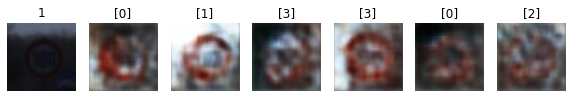

Epoch 5210 g_loss= 1.4059572 d_loss= 0.42217183 real_acc= 0.78 fake_acc= 0.86
Epoch 5220 g_loss= 1.0636479 d_loss= 0.4422344 real_acc= 0.92 fake_acc= 0.68
Epoch 5230 g_loss= 0.9740969 d_loss= 0.4444885 real_acc= 0.92 fake_acc= 0.68
Epoch 5240 g_loss= 1.2949948 d_loss= 0.34225565 real_acc= 0.98 fake_acc= 0.82
Epoch 5250 g_loss= 1.408534 d_loss= 0.4543726 real_acc= 0.82 fake_acc= 0.86
Epoch 5260 g_loss= 1.2898358 d_loss= 0.4136637 real_acc= 0.92 fake_acc= 0.86
Epoch 5270 g_loss= 1.4185011 d_loss= 0.44251117 real_acc= 0.76 fake_acc= 0.88
Epoch 5280 g_loss= 1.243351 d_loss= 0.4763171 real_acc= 0.76 fake_acc= 0.78
Epoch 5290 g_loss= 1.1508019 d_loss= 0.41278982 real_acc= 0.92 fake_acc= 0.74
Epoch 5300 g_loss= 1.3509239 d_loss= 0.42218873 real_acc= 0.72 fake_acc= 0.78


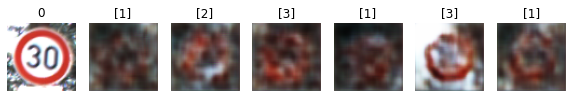

Epoch 5310 g_loss= 1.3443978 d_loss= 0.44854876 real_acc= 0.8 fake_acc= 0.82
Epoch 5320 g_loss= 1.1327516 d_loss= 0.4651985 real_acc= 0.84 fake_acc= 0.72
Epoch 5330 g_loss= 1.3431643 d_loss= 0.42405748 real_acc= 0.8 fake_acc= 0.9
Epoch 5340 g_loss= 1.5594077 d_loss= 0.45957816 real_acc= 0.7 fake_acc= 0.92
Epoch 5350 g_loss= 1.2537075 d_loss= 0.47067153 real_acc= 0.74 fake_acc= 0.88
Epoch 5360 g_loss= 1.0545332 d_loss= 0.48954904 real_acc= 0.78 fake_acc= 0.72
Epoch 5370 g_loss= 1.5089769 d_loss= 0.36347467 real_acc= 0.9 fake_acc= 0.88
Epoch 5380 g_loss= 1.4802328 d_loss= 0.35929674 real_acc= 0.88 fake_acc= 0.9
Epoch 5390 g_loss= 1.3932741 d_loss= 0.4818523 real_acc= 0.7 fake_acc= 0.82
Epoch 5400 g_loss= 1.2621107 d_loss= 0.52741367 real_acc= 0.64 fake_acc= 0.86


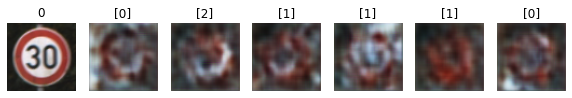

Epoch 5410 g_loss= 1.1731942 d_loss= 0.44959742 real_acc= 0.86 fake_acc= 0.72
Epoch 5420 g_loss= 1.0362806 d_loss= 0.47154048 real_acc= 0.92 fake_acc= 0.62
Epoch 5430 g_loss= 1.2174549 d_loss= 0.44727156 real_acc= 0.88 fake_acc= 0.84
Epoch 5440 g_loss= 1.443488 d_loss= 0.52926457 real_acc= 0.56 fake_acc= 0.88
Epoch 5450 g_loss= 1.548117 d_loss= 0.42964083 real_acc= 0.82 fake_acc= 0.88
Epoch 5460 g_loss= 1.2184484 d_loss= 0.45347738 real_acc= 0.82 fake_acc= 0.76
Epoch 5470 g_loss= 0.95308197 d_loss= 0.50070417 real_acc= 0.88 fake_acc= 0.62
Epoch 5480 g_loss= 1.213469 d_loss= 0.5002213 real_acc= 0.78 fake_acc= 0.72
Epoch 5490 g_loss= 1.3784047 d_loss= 0.40679705 real_acc= 0.86 fake_acc= 0.84
Epoch 5500 g_loss= 1.2623491 d_loss= 0.48080856 real_acc= 0.8 fake_acc= 0.84


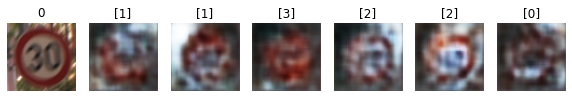

Epoch 5510 g_loss= 1.5966928 d_loss= 0.38973564 real_acc= 0.78 fake_acc= 0.94
Epoch 5520 g_loss= 1.3031234 d_loss= 0.43089098 real_acc= 0.78 fake_acc= 0.84
Epoch 5530 g_loss= 1.0517889 d_loss= 0.48414654 real_acc= 0.88 fake_acc= 0.66
Epoch 5540 g_loss= 1.4016011 d_loss= 0.36446398 real_acc= 0.9 fake_acc= 0.9
Epoch 5550 g_loss= 1.366178 d_loss= 0.4446488 real_acc= 0.78 fake_acc= 0.88
Epoch 5560 g_loss= 1.4720666 d_loss= 0.4391926 real_acc= 0.76 fake_acc= 0.94
Epoch 5570 g_loss= 1.1613812 d_loss= 0.42401192 real_acc= 0.9 fake_acc= 0.8
Epoch 5580 g_loss= 1.1411532 d_loss= 0.5120786 real_acc= 0.76 fake_acc= 0.8
Epoch 5590 g_loss= 1.6166818 d_loss= 0.4629947 real_acc= 0.64 fake_acc= 0.96
Epoch 5600 g_loss= 0.8317904 d_loss= 0.54310775 real_acc= 0.82 fake_acc= 0.62


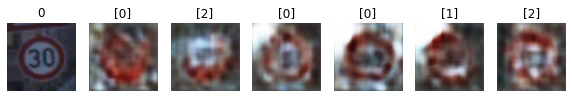

Epoch 5610 g_loss= 0.8645063 d_loss= 0.49671763 real_acc= 0.88 fake_acc= 0.66
Epoch 5620 g_loss= 1.1486214 d_loss= 0.47040844 real_acc= 0.82 fake_acc= 0.78
Epoch 5630 g_loss= 1.3230797 d_loss= 0.5022297 real_acc= 0.64 fake_acc= 0.86
Epoch 5640 g_loss= 1.3288574 d_loss= 0.4553898 real_acc= 0.8 fake_acc= 0.82
Epoch 5650 g_loss= 1.2780373 d_loss= 0.5427326 real_acc= 0.76 fake_acc= 0.86
Epoch 5660 g_loss= 1.0941648 d_loss= 0.4426377 real_acc= 0.88 fake_acc= 0.8
Epoch 5670 g_loss= 1.4920813 d_loss= 0.39842924 real_acc= 0.78 fake_acc= 0.9
Epoch 5680 g_loss= 1.1037637 d_loss= 0.41836706 real_acc= 0.96 fake_acc= 0.7
Epoch 5690 g_loss= 1.0445375 d_loss= 0.43541333 real_acc= 0.84 fake_acc= 0.7
Epoch 5700 g_loss= 1.3683494 d_loss= 0.45895177 real_acc= 0.82 fake_acc= 0.82


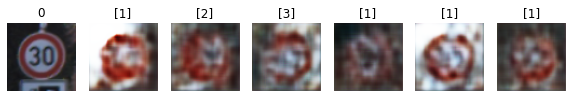

Epoch 5710 g_loss= 1.600734 d_loss= 0.6243467 real_acc= 0.48 fake_acc= 0.94
Epoch 5720 g_loss= 1.3427337 d_loss= 0.4899846 real_acc= 0.74 fake_acc= 0.8
Epoch 5730 g_loss= 1.5265381 d_loss= 0.5328357 real_acc= 0.66 fake_acc= 0.88
Epoch 5740 g_loss= 1.1503203 d_loss= 0.45086688 real_acc= 0.82 fake_acc= 0.72
Epoch 5750 g_loss= 1.4809934 d_loss= 0.41625935 real_acc= 0.78 fake_acc= 0.92
Epoch 5760 g_loss= 1.3871853 d_loss= 0.40264362 real_acc= 0.9 fake_acc= 0.86
Epoch 5770 g_loss= 1.4706628 d_loss= 0.43081483 real_acc= 0.8 fake_acc= 0.9
Epoch 5780 g_loss= 1.4284171 d_loss= 0.46151915 real_acc= 0.76 fake_acc= 0.82
Epoch 5790 g_loss= 1.467695 d_loss= 0.4188114 real_acc= 0.76 fake_acc= 0.82
Epoch 5800 g_loss= 1.066559 d_loss= 0.51657856 real_acc= 0.8 fake_acc= 0.76


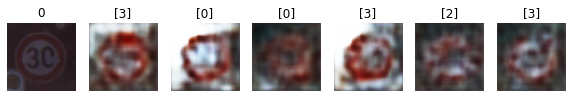

Epoch 5810 g_loss= 1.1574788 d_loss= 0.4190428 real_acc= 0.84 fake_acc= 0.84
Epoch 5820 g_loss= 1.3397391 d_loss= 0.4312551 real_acc= 0.78 fake_acc= 0.88
Epoch 5830 g_loss= 1.495941 d_loss= 0.41353416 real_acc= 0.78 fake_acc= 0.92
Epoch 5840 g_loss= 1.5335671 d_loss= 0.45048046 real_acc= 0.78 fake_acc= 0.92
Epoch 5850 g_loss= 1.5916268 d_loss= 0.47183 real_acc= 0.7 fake_acc= 0.9
Epoch 5860 g_loss= 1.2062829 d_loss= 0.43808287 real_acc= 0.8 fake_acc= 0.8
Epoch 5870 g_loss= 1.037208 d_loss= 0.4432414 real_acc= 0.84 fake_acc= 0.68
Epoch 5880 g_loss= 1.3354324 d_loss= 0.5009222 real_acc= 0.7 fake_acc= 0.88
Epoch 5890 g_loss= 1.412244 d_loss= 0.48974663 real_acc= 0.74 fake_acc= 0.84
Epoch 5900 g_loss= 1.0564958 d_loss= 0.45392627 real_acc= 0.86 fake_acc= 0.76


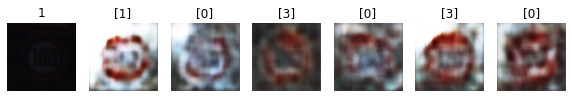

Epoch 5910 g_loss= 1.0755732 d_loss= 0.448129 real_acc= 0.9 fake_acc= 0.68
Epoch 5920 g_loss= 1.329412 d_loss= 0.43160456 real_acc= 0.86 fake_acc= 0.84
Epoch 5930 g_loss= 1.2228304 d_loss= 0.48584324 real_acc= 0.76 fake_acc= 0.86
Epoch 5940 g_loss= 1.3106369 d_loss= 0.4103122 real_acc= 0.92 fake_acc= 0.84
Epoch 5950 g_loss= 1.318478 d_loss= 0.47287616 real_acc= 0.78 fake_acc= 0.82
Epoch 5960 g_loss= 1.0797508 d_loss= 0.45045623 real_acc= 0.88 fake_acc= 0.72
Epoch 5970 g_loss= 1.2906392 d_loss= 0.45702162 real_acc= 0.8 fake_acc= 0.76
Epoch 5980 g_loss= 1.5141312 d_loss= 0.3749463 real_acc= 0.84 fake_acc= 0.88
Epoch 5990 g_loss= 1.304737 d_loss= 0.44412398 real_acc= 0.82 fake_acc= 0.78
Epoch 6000 g_loss= 0.9564515 d_loss= 0.5354932 real_acc= 0.88 fake_acc= 0.62


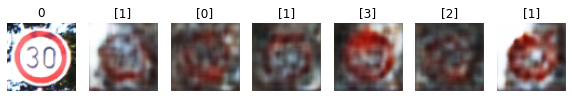

Epoch 6010 g_loss= 1.4633943 d_loss= 0.3962704 real_acc= 0.84 fake_acc= 0.86
Epoch 6020 g_loss= 1.4507717 d_loss= 0.46282876 real_acc= 0.74 fake_acc= 0.88
Epoch 6030 g_loss= 1.162894 d_loss= 0.46928385 real_acc= 0.84 fake_acc= 0.74
Epoch 6040 g_loss= 1.4385788 d_loss= 0.47215018 real_acc= 0.64 fake_acc= 0.84
Epoch 6050 g_loss= 1.3466518 d_loss= 0.44970292 real_acc= 0.74 fake_acc= 0.92
Epoch 6060 g_loss= 1.1858946 d_loss= 0.4534982 real_acc= 0.86 fake_acc= 0.8
Epoch 6070 g_loss= 1.1184924 d_loss= 0.43559015 real_acc= 0.86 fake_acc= 0.74
Epoch 6080 g_loss= 1.1552196 d_loss= 0.50053686 real_acc= 0.74 fake_acc= 0.76
Epoch 6090 g_loss= 1.306083 d_loss= 0.44191504 real_acc= 0.76 fake_acc= 0.84
Epoch 6100 g_loss= 1.4369465 d_loss= 0.39496768 real_acc= 0.84 fake_acc= 0.88


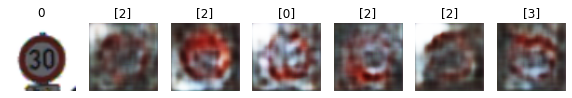

Epoch 6110 g_loss= 1.5652217 d_loss= 0.5078935 real_acc= 0.62 fake_acc= 0.92
Epoch 6120 g_loss= 0.8961296 d_loss= 0.47656006 real_acc= 0.94 fake_acc= 0.58
Epoch 6130 g_loss= 1.4267528 d_loss= 0.43212184 real_acc= 0.8 fake_acc= 0.88
Epoch 6140 g_loss= 1.5642838 d_loss= 0.44727045 real_acc= 0.74 fake_acc= 0.92
Epoch 6150 g_loss= 1.2441819 d_loss= 0.4130181 real_acc= 0.82 fake_acc= 0.88
Epoch 6160 g_loss= 1.4640656 d_loss= 0.43280894 real_acc= 0.76 fake_acc= 0.82
Epoch 6170 g_loss= 1.3361908 d_loss= 0.500807 real_acc= 0.7 fake_acc= 0.9
Epoch 6180 g_loss= 1.4133071 d_loss= 0.43556526 real_acc= 0.82 fake_acc= 0.84
Epoch 6190 g_loss= 1.1542993 d_loss= 0.54190993 real_acc= 0.68 fake_acc= 0.72
Epoch 6200 g_loss= 0.9236507 d_loss= 0.58201784 real_acc= 0.76 fake_acc= 0.6


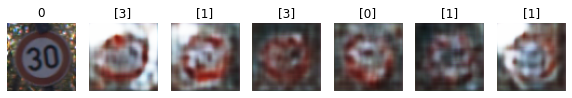

Epoch 6210 g_loss= 1.4068168 d_loss= 0.48666444 real_acc= 0.68 fake_acc= 0.76
Epoch 6220 g_loss= 1.3656592 d_loss= 0.50742894 real_acc= 0.74 fake_acc= 0.9
Epoch 6230 g_loss= 1.1054773 d_loss= 0.51117694 real_acc= 0.78 fake_acc= 0.78
Epoch 6240 g_loss= 1.3192389 d_loss= 0.46480387 real_acc= 0.78 fake_acc= 0.78
Epoch 6250 g_loss= 1.5821784 d_loss= 0.4275978 real_acc= 0.78 fake_acc= 0.9
Epoch 6260 g_loss= 1.2350233 d_loss= 0.41121578 real_acc= 0.9 fake_acc= 0.86
Epoch 6270 g_loss= 1.3497324 d_loss= 0.4107681 real_acc= 0.84 fake_acc= 0.76
Epoch 6280 g_loss= 1.3919263 d_loss= 0.4267 real_acc= 0.82 fake_acc= 0.84
Epoch 6290 g_loss= 1.2349297 d_loss= 0.5442032 real_acc= 0.82 fake_acc= 0.76
Epoch 6300 g_loss= 1.2522031 d_loss= 0.4902398 real_acc= 0.72 fake_acc= 0.84


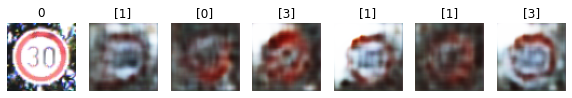

Epoch 6310 g_loss= 1.1546534 d_loss= 0.45557702 real_acc= 0.82 fake_acc= 0.82
Epoch 6320 g_loss= 1.2308007 d_loss= 0.46206123 real_acc= 0.78 fake_acc= 0.8
Epoch 6330 g_loss= 1.1935676 d_loss= 0.42395324 real_acc= 0.9 fake_acc= 0.8
Epoch 6340 g_loss= 1.1721445 d_loss= 0.479114 real_acc= 0.8 fake_acc= 0.84
Epoch 6350 g_loss= 1.4706693 d_loss= 0.4632419 real_acc= 0.74 fake_acc= 0.82
Epoch 6360 g_loss= 1.4890945 d_loss= 0.45108896 real_acc= 0.74 fake_acc= 0.92
Epoch 6370 g_loss= 1.626181 d_loss= 0.46033144 real_acc= 0.62 fake_acc= 0.96
Epoch 6380 g_loss= 1.3215579 d_loss= 0.41783273 real_acc= 0.84 fake_acc= 0.84
Epoch 6390 g_loss= 1.2195743 d_loss= 0.41318417 real_acc= 0.84 fake_acc= 0.84
Epoch 6400 g_loss= 1.3993659 d_loss= 0.40728194 real_acc= 0.8 fake_acc= 0.86


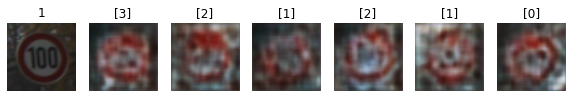

Epoch 6410 g_loss= 1.3941399 d_loss= 0.46442154 real_acc= 0.76 fake_acc= 0.82
Epoch 6420 g_loss= 1.262616 d_loss= 0.40742338 real_acc= 0.8 fake_acc= 0.84
Epoch 6430 g_loss= 1.3125378 d_loss= 0.46349835 real_acc= 0.72 fake_acc= 0.8
Epoch 6440 g_loss= 1.3390753 d_loss= 0.45585284 real_acc= 0.8 fake_acc= 0.78
Epoch 6450 g_loss= 1.308324 d_loss= 0.42771515 real_acc= 0.84 fake_acc= 0.8
Epoch 6460 g_loss= 1.2148237 d_loss= 0.42593986 real_acc= 0.88 fake_acc= 0.8
Epoch 6470 g_loss= 1.4842263 d_loss= 0.45205057 real_acc= 0.74 fake_acc= 0.88
Epoch 6480 g_loss= 1.1635618 d_loss= 0.5117598 real_acc= 0.76 fake_acc= 0.72
Epoch 6490 g_loss= 1.1762277 d_loss= 0.4239589 real_acc= 0.9 fake_acc= 0.76
Epoch 6500 g_loss= 1.3164895 d_loss= 0.3899445 real_acc= 0.88 fake_acc= 0.8


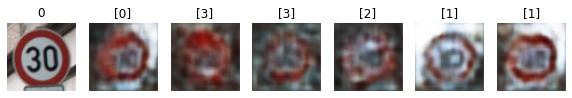

Epoch 6510 g_loss= 1.2768532 d_loss= 0.46370664 real_acc= 0.8 fake_acc= 0.8
Epoch 6520 g_loss= 1.083031 d_loss= 0.4741441 real_acc= 0.82 fake_acc= 0.76
Epoch 6530 g_loss= 1.8166014 d_loss= 0.37972593 real_acc= 0.7 fake_acc= 0.98
Epoch 6540 g_loss= 1.5741484 d_loss= 0.4574324 real_acc= 0.78 fake_acc= 0.9
Epoch 6550 g_loss= 1.4122679 d_loss= 0.4036554 real_acc= 0.84 fake_acc= 0.86
Epoch 6560 g_loss= 1.2352849 d_loss= 0.518278 real_acc= 0.7 fake_acc= 0.84
Epoch 6570 g_loss= 1.8382506 d_loss= 0.47881633 real_acc= 0.66 fake_acc= 0.94
Epoch 6580 g_loss= 1.1674587 d_loss= 0.5000318 real_acc= 0.82 fake_acc= 0.74
Epoch 6590 g_loss= 1.000126 d_loss= 0.4289728 real_acc= 0.92 fake_acc= 0.74
Epoch 6600 g_loss= 1.0571637 d_loss= 0.43260217 real_acc= 0.94 fake_acc= 0.7


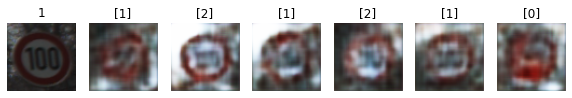

Epoch 6610 g_loss= 0.9149234 d_loss= 0.49151742 real_acc= 0.88 fake_acc= 0.6
Epoch 6620 g_loss= 1.3193917 d_loss= 0.41073713 real_acc= 0.86 fake_acc= 0.82
Epoch 6630 g_loss= 1.458501 d_loss= 0.4373076 real_acc= 0.86 fake_acc= 0.82
Epoch 6640 g_loss= 1.53881 d_loss= 0.50481 real_acc= 0.7 fake_acc= 0.88
Epoch 6650 g_loss= 1.0438151 d_loss= 0.44214952 real_acc= 0.9 fake_acc= 0.72
Epoch 6660 g_loss= 1.1018239 d_loss= 0.50717664 real_acc= 0.78 fake_acc= 0.76
Epoch 6670 g_loss= 1.2027646 d_loss= 0.3722656 real_acc= 0.86 fake_acc= 0.86
Epoch 6680 g_loss= 1.1921614 d_loss= 0.5210865 real_acc= 0.68 fake_acc= 0.76
Epoch 6690 g_loss= 1.3435507 d_loss= 0.38314646 real_acc= 0.84 fake_acc= 0.84
Epoch 6700 g_loss= 1.3856457 d_loss= 0.41205037 real_acc= 0.82 fake_acc= 0.88


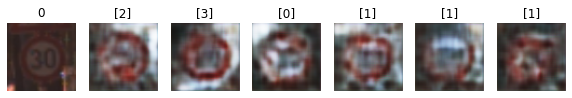

Epoch 6710 g_loss= 1.2547867 d_loss= 0.4227516 real_acc= 0.88 fake_acc= 0.74
Epoch 6720 g_loss= 1.3775929 d_loss= 0.48308775 real_acc= 0.78 fake_acc= 0.8
Epoch 6730 g_loss= 1.5055788 d_loss= 0.38958 real_acc= 0.82 fake_acc= 0.9
Epoch 6740 g_loss= 1.6012787 d_loss= 0.3553852 real_acc= 0.82 fake_acc= 0.94
Epoch 6750 g_loss= 1.3226999 d_loss= 0.44969916 real_acc= 0.78 fake_acc= 0.86
Epoch 6760 g_loss= 1.203914 d_loss= 0.46411636 real_acc= 0.8 fake_acc= 0.8
Epoch 6770 g_loss= 1.1197724 d_loss= 0.44209015 real_acc= 0.9 fake_acc= 0.7
Epoch 6780 g_loss= 1.145666 d_loss= 0.43435794 real_acc= 0.88 fake_acc= 0.62
Epoch 6790 g_loss= 1.251598 d_loss= 0.48205477 real_acc= 0.76 fake_acc= 0.7
Epoch 6800 g_loss= 1.403445 d_loss= 0.42945397 real_acc= 0.84 fake_acc= 0.8


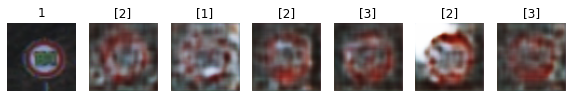

Epoch 6810 g_loss= 1.266299 d_loss= 0.39244384 real_acc= 0.88 fake_acc= 0.82
Epoch 6820 g_loss= 1.3842221 d_loss= 0.50619555 real_acc= 0.72 fake_acc= 0.84
Epoch 6830 g_loss= 1.3116417 d_loss= 0.46284035 real_acc= 0.78 fake_acc= 0.84
Epoch 6840 g_loss= 1.3568829 d_loss= 0.4258508 real_acc= 0.86 fake_acc= 0.82
Epoch 6850 g_loss= 1.0933841 d_loss= 0.41709998 real_acc= 0.92 fake_acc= 0.68
Epoch 6860 g_loss= 1.5084543 d_loss= 0.48095506 real_acc= 0.6 fake_acc= 0.9
Epoch 6870 g_loss= 1.1993723 d_loss= 0.50710094 real_acc= 0.74 fake_acc= 0.78
Epoch 6880 g_loss= 1.751508 d_loss= 0.44924593 real_acc= 0.72 fake_acc= 0.9
Epoch 6890 g_loss= 1.2471083 d_loss= 0.45211667 real_acc= 0.82 fake_acc= 0.72
Epoch 6900 g_loss= 1.5429991 d_loss= 0.34494823 real_acc= 0.88 fake_acc= 0.94


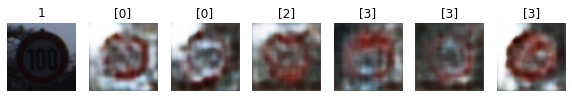

Epoch 6910 g_loss= 1.3996477 d_loss= 0.41007596 real_acc= 0.82 fake_acc= 0.84
Epoch 6920 g_loss= 1.6077174 d_loss= 0.35425258 real_acc= 0.86 fake_acc= 0.94
Epoch 6930 g_loss= 1.3159965 d_loss= 0.40857118 real_acc= 0.8 fake_acc= 0.9
Epoch 6940 g_loss= 1.212754 d_loss= 0.47233504 real_acc= 0.78 fake_acc= 0.78
Epoch 6950 g_loss= 1.279771 d_loss= 0.44600874 real_acc= 0.82 fake_acc= 0.74
Epoch 6960 g_loss= 1.099406 d_loss= 0.41059238 real_acc= 0.96 fake_acc= 0.76
Epoch 6970 g_loss= 1.3489311 d_loss= 0.5263746 real_acc= 0.72 fake_acc= 0.82
Epoch 6980 g_loss= 1.565258 d_loss= 0.43198597 real_acc= 0.72 fake_acc= 0.96
Epoch 6990 g_loss= 1.473233 d_loss= 0.45245582 real_acc= 0.76 fake_acc= 0.84
Epoch 7000 g_loss= 1.1859691 d_loss= 0.4201313 real_acc= 0.9 fake_acc= 0.68


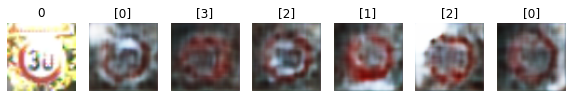

Epoch 7010 g_loss= 0.84674865 d_loss= 0.49775442 real_acc= 0.94 fake_acc= 0.56
Epoch 7020 g_loss= 1.1316576 d_loss= 0.47591352 real_acc= 0.84 fake_acc= 0.7
Epoch 7030 g_loss= 1.065905 d_loss= 0.46001846 real_acc= 0.88 fake_acc= 0.72
Epoch 7040 g_loss= 1.3993 d_loss= 0.39734584 real_acc= 0.86 fake_acc= 0.84
Epoch 7050 g_loss= 1.4169192 d_loss= 0.41588584 real_acc= 0.84 fake_acc= 0.84
Epoch 7060 g_loss= 1.387982 d_loss= 0.43918628 real_acc= 0.82 fake_acc= 0.84
Epoch 7070 g_loss= 1.6084889 d_loss= 0.43773437 real_acc= 0.7 fake_acc= 0.86
Epoch 7080 g_loss= 1.719132 d_loss= 0.55011994 real_acc= 0.58 fake_acc= 0.94
Epoch 7090 g_loss= 1.0808799 d_loss= 0.4548488 real_acc= 0.86 fake_acc= 0.68
Epoch 7100 g_loss= 1.2639455 d_loss= 0.44293612 real_acc= 0.88 fake_acc= 0.84


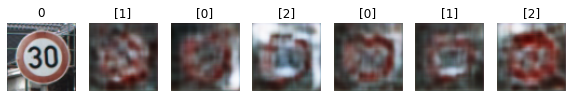

Epoch 7110 g_loss= 1.395904 d_loss= 0.3668608 real_acc= 0.94 fake_acc= 0.8
Epoch 7120 g_loss= 1.5812004 d_loss= 0.40187466 real_acc= 0.78 fake_acc= 0.92
Epoch 7130 g_loss= 1.0234722 d_loss= 0.45808882 real_acc= 0.92 fake_acc= 0.68
Epoch 7140 g_loss= 1.2105609 d_loss= 0.43410832 real_acc= 0.8 fake_acc= 0.82
Epoch 7150 g_loss= 1.4448885 d_loss= 0.3767151 real_acc= 0.84 fake_acc= 0.8
Epoch 7160 g_loss= 1.2253247 d_loss= 0.42150706 real_acc= 0.9 fake_acc= 0.82
Epoch 7170 g_loss= 1.5270774 d_loss= 0.39110857 real_acc= 0.78 fake_acc= 0.92
Epoch 7180 g_loss= 1.1802689 d_loss= 0.49655643 real_acc= 0.82 fake_acc= 0.74
Epoch 7190 g_loss= 1.2871758 d_loss= 0.4779293 real_acc= 0.7 fake_acc= 0.8
Epoch 7200 g_loss= 1.2046069 d_loss= 0.3993281 real_acc= 0.88 fake_acc= 0.78


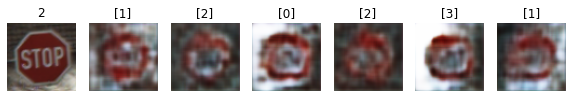

Epoch 7210 g_loss= 1.3147794 d_loss= 0.390789 real_acc= 0.94 fake_acc= 0.78
Epoch 7220 g_loss= 1.2178539 d_loss= 0.43039376 real_acc= 0.86 fake_acc= 0.78
Epoch 7230 g_loss= 1.7413173 d_loss= 0.506865 real_acc= 0.64 fake_acc= 0.9
Epoch 7240 g_loss= 1.4204937 d_loss= 0.4324453 real_acc= 0.8 fake_acc= 0.86
Epoch 7250 g_loss= 1.5286171 d_loss= 0.36527234 real_acc= 0.88 fake_acc= 0.86
Epoch 7260 g_loss= 1.5773673 d_loss= 0.47565198 real_acc= 0.62 fake_acc= 0.92
Epoch 7270 g_loss= 1.4636314 d_loss= 0.3706386 real_acc= 0.84 fake_acc= 0.88
Epoch 7280 g_loss= 1.1873735 d_loss= 0.46659893 real_acc= 0.84 fake_acc= 0.72
Epoch 7290 g_loss= 1.161707 d_loss= 0.41440678 real_acc= 0.88 fake_acc= 0.72
Epoch 7300 g_loss= 1.1499404 d_loss= 0.44521755 real_acc= 0.78 fake_acc= 0.7


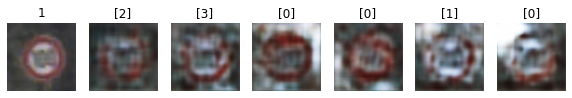

Epoch 7310 g_loss= 1.1438823 d_loss= 0.451787 real_acc= 0.84 fake_acc= 0.78
Epoch 7320 g_loss= 1.6561676 d_loss= 0.4057219 real_acc= 0.74 fake_acc= 0.94
Epoch 7330 g_loss= 1.2908586 d_loss= 0.43904114 real_acc= 0.76 fake_acc= 0.8
Epoch 7340 g_loss= 1.4583528 d_loss= 0.5096252 real_acc= 0.74 fake_acc= 0.84
Epoch 7350 g_loss= 1.3892227 d_loss= 0.40269285 real_acc= 0.88 fake_acc= 0.86
Epoch 7360 g_loss= 1.3591937 d_loss= 0.45705545 real_acc= 0.74 fake_acc= 0.82
Epoch 7370 g_loss= 1.840174 d_loss= 0.38967246 real_acc= 0.72 fake_acc= 0.86
Epoch 7380 g_loss= 1.5901395 d_loss= 0.39466178 real_acc= 0.76 fake_acc= 0.9
Epoch 7390 g_loss= 1.5077001 d_loss= 0.43695533 real_acc= 0.72 fake_acc= 0.84
Epoch 7400 g_loss= 1.06543 d_loss= 0.4582726 real_acc= 0.86 fake_acc= 0.7


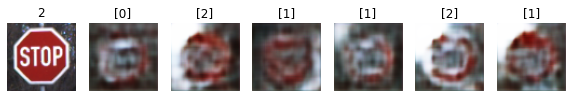

Epoch 7410 g_loss= 0.9784653 d_loss= 0.5040962 real_acc= 0.88 fake_acc= 0.6
Epoch 7420 g_loss= 1.251207 d_loss= 0.40593082 real_acc= 0.88 fake_acc= 0.78
Epoch 7430 g_loss= 1.5975848 d_loss= 0.3796088 real_acc= 0.9 fake_acc= 0.84
Epoch 7440 g_loss= 1.710223 d_loss= 0.5645605 real_acc= 0.58 fake_acc= 0.92
Epoch 7450 g_loss= 1.2619812 d_loss= 0.44088387 real_acc= 0.86 fake_acc= 0.78
Epoch 7460 g_loss= 1.2471412 d_loss= 0.38340926 real_acc= 0.86 fake_acc= 0.88
Epoch 7470 g_loss= 1.2227526 d_loss= 0.45549545 real_acc= 0.8 fake_acc= 0.76
Epoch 7480 g_loss= 1.6700014 d_loss= 0.3635742 real_acc= 0.78 fake_acc= 0.94
Epoch 7490 g_loss= 1.8466928 d_loss= 0.3871489 real_acc= 0.74 fake_acc= 0.98
Epoch 7500 g_loss= 2.0131807 d_loss= 0.3431315 real_acc= 0.82 fake_acc= 0.96


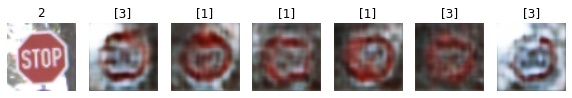

Epoch 7510 g_loss= 1.4767888 d_loss= 0.37540638 real_acc= 0.84 fake_acc= 0.84
Epoch 7520 g_loss= 1.1557491 d_loss= 0.41461194 real_acc= 0.9 fake_acc= 0.78
Epoch 7530 g_loss= 0.9969179 d_loss= 0.45868897 real_acc= 0.92 fake_acc= 0.64
Epoch 7540 g_loss= 1.4043366 d_loss= 0.39496216 real_acc= 0.88 fake_acc= 0.78
Epoch 7550 g_loss= 1.612461 d_loss= 0.35461026 real_acc= 0.88 fake_acc= 0.9
Epoch 7560 g_loss= 1.3186197 d_loss= 0.43320715 real_acc= 0.8 fake_acc= 0.74
Epoch 7570 g_loss= 1.4095474 d_loss= 0.39575207 real_acc= 0.84 fake_acc= 0.8
Epoch 7580 g_loss= 1.4785511 d_loss= 0.418098 real_acc= 0.84 fake_acc= 0.84
Epoch 7590 g_loss= 1.6110175 d_loss= 0.3877953 real_acc= 0.8 fake_acc= 0.92
Epoch 7600 g_loss= 1.2257477 d_loss= 0.4848655 real_acc= 0.8 fake_acc= 0.74


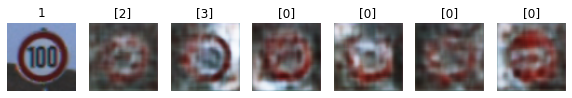

Epoch 7610 g_loss= 1.4702357 d_loss= 0.38766667 real_acc= 0.88 fake_acc= 0.8
Epoch 7620 g_loss= 1.4842465 d_loss= 0.46046585 real_acc= 0.76 fake_acc= 0.82
Epoch 7630 g_loss= 1.4132895 d_loss= 0.40888202 real_acc= 0.78 fake_acc= 0.8
Epoch 7640 g_loss= 1.3780788 d_loss= 0.47314334 real_acc= 0.8 fake_acc= 0.82
Epoch 7650 g_loss= 1.6723841 d_loss= 0.35446918 real_acc= 0.86 fake_acc= 0.9
Epoch 7660 g_loss= 1.3838774 d_loss= 0.4575488 real_acc= 0.72 fake_acc= 0.86
Epoch 7670 g_loss= 1.2416264 d_loss= 0.41902444 real_acc= 0.88 fake_acc= 0.82
Epoch 7680 g_loss= 1.1235274 d_loss= 0.46929193 real_acc= 0.88 fake_acc= 0.66
Epoch 7690 g_loss= 1.3201728 d_loss= 0.4059227 real_acc= 0.86 fake_acc= 0.84
Epoch 7700 g_loss= 1.2821579 d_loss= 0.44177788 real_acc= 0.82 fake_acc= 0.78


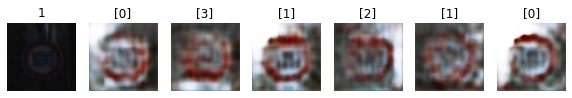

Epoch 7710 g_loss= 1.2593933 d_loss= 0.41523013 real_acc= 0.86 fake_acc= 0.82
Epoch 7720 g_loss= 1.2406514 d_loss= 0.41668704 real_acc= 0.92 fake_acc= 0.74
Epoch 7730 g_loss= 1.4608301 d_loss= 0.4568909 real_acc= 0.72 fake_acc= 0.8
Epoch 7740 g_loss= 1.4191694 d_loss= 0.41918138 real_acc= 0.82 fake_acc= 0.78
Epoch 7750 g_loss= 1.605056 d_loss= 0.40109605 real_acc= 0.76 fake_acc= 0.9
Epoch 7760 g_loss= 1.5702486 d_loss= 0.36505598 real_acc= 0.88 fake_acc= 0.88
Epoch 7770 g_loss= 1.2749017 d_loss= 0.4195555 real_acc= 0.82 fake_acc= 0.84
Epoch 7780 g_loss= 1.3974371 d_loss= 0.42812276 real_acc= 0.8 fake_acc= 0.78
Epoch 7790 g_loss= 1.3869853 d_loss= 0.50614756 real_acc= 0.62 fake_acc= 0.8
Epoch 7800 g_loss= 1.502432 d_loss= 0.35549635 real_acc= 0.9 fake_acc= 0.88


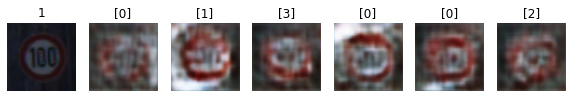

Epoch 7810 g_loss= 1.4625793 d_loss= 0.39361364 real_acc= 0.9 fake_acc= 0.8
Epoch 7820 g_loss= 1.3910306 d_loss= 0.4052661 real_acc= 0.9 fake_acc= 0.86
Epoch 7830 g_loss= 1.4038475 d_loss= 0.42302206 real_acc= 0.78 fake_acc= 0.82
Epoch 7840 g_loss= 1.3774763 d_loss= 0.36102867 real_acc= 0.9 fake_acc= 0.9
Epoch 7850 g_loss= 2.0369227 d_loss= 0.45954585 real_acc= 0.54 fake_acc= 0.98
Epoch 7860 g_loss= 1.5772663 d_loss= 0.47590595 real_acc= 0.54 fake_acc= 0.86
Epoch 7870 g_loss= 1.2135801 d_loss= 0.46520883 real_acc= 0.82 fake_acc= 0.7
Epoch 7880 g_loss= 1.273286 d_loss= 0.4075271 real_acc= 0.86 fake_acc= 0.8
Epoch 7890 g_loss= 0.9576515 d_loss= 0.4841435 real_acc= 0.92 fake_acc= 0.6
Epoch 7900 g_loss= 1.2659343 d_loss= 0.44110638 real_acc= 0.9 fake_acc= 0.66


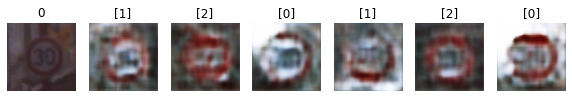

Epoch 7910 g_loss= 1.5072637 d_loss= 0.3625781 real_acc= 0.84 fake_acc= 0.88
Epoch 7920 g_loss= 1.6530075 d_loss= 0.39910042 real_acc= 0.76 fake_acc= 0.84
Epoch 7930 g_loss= 1.363787 d_loss= 0.46178797 real_acc= 0.78 fake_acc= 0.82
Epoch 7940 g_loss= 1.3374957 d_loss= 0.43132216 real_acc= 0.88 fake_acc= 0.76
Epoch 7950 g_loss= 1.0016627 d_loss= 0.4503646 real_acc= 0.94 fake_acc= 0.66
Epoch 7960 g_loss= 1.5348516 d_loss= 0.3764903 real_acc= 0.88 fake_acc= 0.78
Epoch 7970 g_loss= 1.4389976 d_loss= 0.4828099 real_acc= 0.68 fake_acc= 0.78
Epoch 7980 g_loss= 1.7497882 d_loss= 0.47636747 real_acc= 0.7 fake_acc= 0.9
Epoch 7990 g_loss= 1.8386092 d_loss= 0.36000374 real_acc= 0.78 fake_acc= 0.96
Epoch 8000 g_loss= 1.2033494 d_loss= 0.47608787 real_acc= 0.78 fake_acc= 0.72


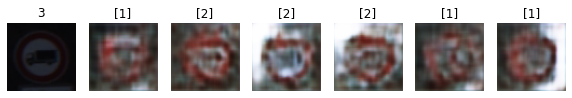

Epoch 8010 g_loss= 1.4333687 d_loss= 0.43234354 real_acc= 0.78 fake_acc= 0.84
Epoch 8020 g_loss= 2.036471 d_loss= 0.36073834 real_acc= 0.82 fake_acc= 0.96
Epoch 8030 g_loss= 1.9064516 d_loss= 0.43862265 real_acc= 0.72 fake_acc= 0.92
Epoch 8040 g_loss= 1.3892517 d_loss= 0.41613626 real_acc= 0.86 fake_acc= 0.74
Epoch 8050 g_loss= 1.277081 d_loss= 0.4431036 real_acc= 0.86 fake_acc= 0.66
Epoch 8060 g_loss= 1.2642033 d_loss= 0.39015955 real_acc= 0.96 fake_acc= 0.76
Epoch 8070 g_loss= 1.365909 d_loss= 0.40559107 real_acc= 0.86 fake_acc= 0.8
Epoch 8080 g_loss= 1.8596731 d_loss= 0.41976196 real_acc= 0.7 fake_acc= 0.88
Epoch 8090 g_loss= 1.5956427 d_loss= 0.3907677 real_acc= 0.88 fake_acc= 0.84
Epoch 8100 g_loss= 1.4412657 d_loss= 0.41877115 real_acc= 0.8 fake_acc= 0.84


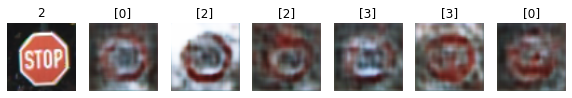

Epoch 8110 g_loss= 1.3321502 d_loss= 0.46814537 real_acc= 0.8 fake_acc= 0.74
Epoch 8120 g_loss= 1.2881054 d_loss= 0.4361288 real_acc= 0.84 fake_acc= 0.76
Epoch 8130 g_loss= 1.6036477 d_loss= 0.51704603 real_acc= 0.7 fake_acc= 0.84
Epoch 8140 g_loss= 1.8257108 d_loss= 0.39909726 real_acc= 0.76 fake_acc= 0.92
Epoch 8150 g_loss= 1.5946808 d_loss= 0.4456038 real_acc= 0.76 fake_acc= 0.88
Epoch 8160 g_loss= 1.4953988 d_loss= 0.420609 real_acc= 0.82 fake_acc= 0.8
Epoch 8170 g_loss= 1.1073974 d_loss= 0.46796694 real_acc= 0.84 fake_acc= 0.66
Epoch 8180 g_loss= 1.2077351 d_loss= 0.41620636 real_acc= 0.92 fake_acc= 0.66
Epoch 8190 g_loss= 1.4881538 d_loss= 0.3683822 real_acc= 0.88 fake_acc= 0.78
Epoch 8200 g_loss= 1.6262356 d_loss= 0.41330236 real_acc= 0.76 fake_acc= 0.92


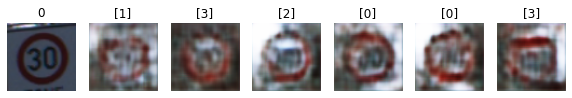

Epoch 8210 g_loss= 1.3998054 d_loss= 0.46461493 real_acc= 0.82 fake_acc= 0.84
Epoch 8220 g_loss= 1.4688832 d_loss= 0.4218289 real_acc= 0.82 fake_acc= 0.84
Epoch 8230 g_loss= 1.441827 d_loss= 0.37149334 real_acc= 0.9 fake_acc= 0.88
Epoch 8240 g_loss= 1.635186 d_loss= 0.39986202 real_acc= 0.84 fake_acc= 0.8
Epoch 8250 g_loss= 1.0924507 d_loss= 0.4850359 real_acc= 0.88 fake_acc= 0.66
Epoch 8260 g_loss= 1.3373306 d_loss= 0.4529863 real_acc= 0.86 fake_acc= 0.76
Epoch 8270 g_loss= 1.679974 d_loss= 0.33029774 real_acc= 0.9 fake_acc= 0.88
Epoch 8280 g_loss= 1.270278 d_loss= 0.46670836 real_acc= 0.84 fake_acc= 0.76
Epoch 8290 g_loss= 1.551771 d_loss= 0.38375515 real_acc= 0.86 fake_acc= 0.86
Epoch 8300 g_loss= 1.6641852 d_loss= 0.42464632 real_acc= 0.72 fake_acc= 0.92


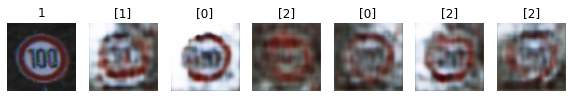

Epoch 8310 g_loss= 1.506899 d_loss= 0.4149118 real_acc= 0.86 fake_acc= 0.82
Epoch 8320 g_loss= 1.7816784 d_loss= 0.36326653 real_acc= 0.8 fake_acc= 0.9
Epoch 8330 g_loss= 1.7066512 d_loss= 0.41702247 real_acc= 0.76 fake_acc= 0.92
Epoch 8340 g_loss= 1.605617 d_loss= 0.42877173 real_acc= 0.8 fake_acc= 0.76
Epoch 8350 g_loss= 1.483145 d_loss= 0.3632564 real_acc= 0.88 fake_acc= 0.92
Epoch 8360 g_loss= 1.3906865 d_loss= 0.40736204 real_acc= 0.86 fake_acc= 0.8
Epoch 8370 g_loss= 1.0459833 d_loss= 0.4800272 real_acc= 0.92 fake_acc= 0.56
Epoch 8380 g_loss= 1.4470712 d_loss= 0.4153416 real_acc= 0.88 fake_acc= 0.74
Epoch 8390 g_loss= 1.489613 d_loss= 0.50516015 real_acc= 0.74 fake_acc= 0.8
Epoch 8400 g_loss= 1.5672789 d_loss= 0.45096138 real_acc= 0.8 fake_acc= 0.78


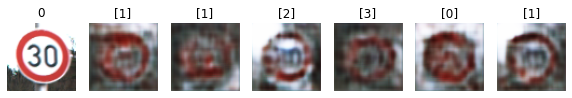

Epoch 8410 g_loss= 1.5075412 d_loss= 0.3613903 real_acc= 0.88 fake_acc= 0.86
Epoch 8420 g_loss= 1.4152433 d_loss= 0.41496778 real_acc= 0.9 fake_acc= 0.82
Epoch 8430 g_loss= 1.5309501 d_loss= 0.37860578 real_acc= 0.88 fake_acc= 0.82
Epoch 8440 g_loss= 1.4205698 d_loss= 0.3756634 real_acc= 0.9 fake_acc= 0.84
Epoch 8450 g_loss= 1.3056682 d_loss= 0.42083246 real_acc= 0.84 fake_acc= 0.76
Epoch 8460 g_loss= 1.5269928 d_loss= 0.41736865 real_acc= 0.82 fake_acc= 0.86
Epoch 8470 g_loss= 1.5180917 d_loss= 0.39401996 real_acc= 0.9 fake_acc= 0.84
Epoch 8480 g_loss= 1.9986005 d_loss= 0.37101877 real_acc= 0.74 fake_acc= 0.9
Epoch 8490 g_loss= 1.5367115 d_loss= 0.40386087 real_acc= 0.76 fake_acc= 0.8
Epoch 8500 g_loss= 1.5275744 d_loss= 0.41728348 real_acc= 0.8 fake_acc= 0.88


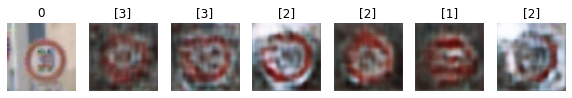

Epoch 8510 g_loss= 1.5310348 d_loss= 0.38075444 real_acc= 0.82 fake_acc= 0.86
Epoch 8520 g_loss= 1.6083059 d_loss= 0.3670557 real_acc= 0.88 fake_acc= 0.92
Epoch 8530 g_loss= 1.6707091 d_loss= 0.44615507 real_acc= 0.74 fake_acc= 0.9
Epoch 8540 g_loss= 1.5430045 d_loss= 0.34752566 real_acc= 0.86 fake_acc= 0.88
Epoch 8550 g_loss= 1.5842632 d_loss= 0.4178325 real_acc= 0.76 fake_acc= 0.84
Epoch 8560 g_loss= 1.7953144 d_loss= 0.39619327 real_acc= 0.86 fake_acc= 0.84
Epoch 8570 g_loss= 1.5011157 d_loss= 0.43747312 real_acc= 0.72 fake_acc= 0.84
Epoch 8580 g_loss= 1.2993987 d_loss= 0.3700835 real_acc= 0.96 fake_acc= 0.72
Epoch 8590 g_loss= 1.1577175 d_loss= 0.4692648 real_acc= 0.9 fake_acc= 0.62
Epoch 8600 g_loss= 1.6150436 d_loss= 0.43912756 real_acc= 0.8 fake_acc= 0.82


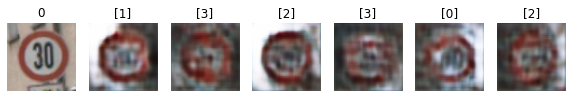

Epoch 8610 g_loss= 1.8853395 d_loss= 0.4072412 real_acc= 0.78 fake_acc= 0.94
Epoch 8620 g_loss= 1.8727182 d_loss= 0.35866302 real_acc= 0.78 fake_acc= 0.94
Epoch 8630 g_loss= 1.2548639 d_loss= 0.41007102 real_acc= 0.9 fake_acc= 0.76
Epoch 8640 g_loss= 1.524218 d_loss= 0.3453552 real_acc= 0.9 fake_acc= 0.88
Epoch 8650 g_loss= 1.7125789 d_loss= 0.40000486 real_acc= 0.84 fake_acc= 0.9
Epoch 8660 g_loss= 1.6793362 d_loss= 0.43009275 real_acc= 0.74 fake_acc= 0.88
Epoch 8670 g_loss= 2.0205958 d_loss= 0.38165987 real_acc= 0.76 fake_acc= 0.98
Epoch 8680 g_loss= 1.5575957 d_loss= 0.40962833 real_acc= 0.78 fake_acc= 0.92
Epoch 8690 g_loss= 1.48797 d_loss= 0.3885059 real_acc= 0.86 fake_acc= 0.9
Epoch 8700 g_loss= 1.4850523 d_loss= 0.40096822 real_acc= 0.88 fake_acc= 0.72


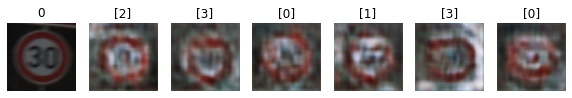

Epoch 8710 g_loss= 1.2316233 d_loss= 0.3874537 real_acc= 0.92 fake_acc= 0.74
Epoch 8720 g_loss= 1.6142633 d_loss= 0.39718583 real_acc= 0.86 fake_acc= 0.82
Epoch 8730 g_loss= 1.6400871 d_loss= 0.43241552 real_acc= 0.76 fake_acc= 0.86
Epoch 8740 g_loss= 1.6474336 d_loss= 0.40541172 real_acc= 0.76 fake_acc= 0.88
Epoch 8750 g_loss= 1.6555477 d_loss= 0.3996057 real_acc= 0.86 fake_acc= 0.86
Epoch 8760 g_loss= 1.2686101 d_loss= 0.43060714 real_acc= 0.94 fake_acc= 0.76
Epoch 8770 g_loss= 1.5327622 d_loss= 0.4162215 real_acc= 0.88 fake_acc= 0.76
Epoch 8780 g_loss= 1.2142911 d_loss= 0.4628399 real_acc= 0.86 fake_acc= 0.76
Epoch 8790 g_loss= 1.3707633 d_loss= 0.41449857 real_acc= 0.84 fake_acc= 0.76
Epoch 8800 g_loss= 1.7188355 d_loss= 0.43464807 real_acc= 0.86 fake_acc= 0.84


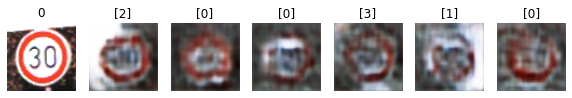

Epoch 8810 g_loss= 1.7444931 d_loss= 0.358478 real_acc= 0.84 fake_acc= 0.94
Epoch 8820 g_loss= 1.2995895 d_loss= 0.45732808 real_acc= 0.92 fake_acc= 0.72
Epoch 8830 g_loss= 1.5099362 d_loss= 0.37157953 real_acc= 0.86 fake_acc= 0.78
Epoch 8840 g_loss= 1.543052 d_loss= 0.37367022 real_acc= 0.86 fake_acc= 0.82
Epoch 8850 g_loss= 1.57005 d_loss= 0.36651006 real_acc= 0.86 fake_acc= 0.86
Epoch 8860 g_loss= 1.3742707 d_loss= 0.44711232 real_acc= 0.78 fake_acc= 0.78
Epoch 8870 g_loss= 1.8657056 d_loss= 0.4721464 real_acc= 0.62 fake_acc= 0.96
Epoch 8880 g_loss= 1.8006269 d_loss= 0.3602989 real_acc= 0.78 fake_acc= 0.96
Epoch 8890 g_loss= 1.7110078 d_loss= 0.3596493 real_acc= 0.88 fake_acc= 0.86
Epoch 8900 g_loss= 1.4355919 d_loss= 0.4173268 real_acc= 0.82 fake_acc= 0.88


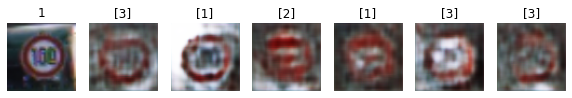

Epoch 8910 g_loss= 1.6588675 d_loss= 0.3577489 real_acc= 0.9 fake_acc= 0.9
Epoch 8920 g_loss= 1.5924872 d_loss= 0.39696604 real_acc= 0.8 fake_acc= 0.92
Epoch 8930 g_loss= 1.817484 d_loss= 0.29087853 real_acc= 0.96 fake_acc= 0.92
Epoch 8940 g_loss= 1.2835709 d_loss= 0.36670643 real_acc= 0.98 fake_acc= 0.74
Epoch 8950 g_loss= 1.5767074 d_loss= 0.4056814 real_acc= 0.86 fake_acc= 0.78
Epoch 8960 g_loss= 1.519595 d_loss= 0.4227502 real_acc= 0.86 fake_acc= 0.82
Epoch 8970 g_loss= 1.7722162 d_loss= 0.3644753 real_acc= 0.86 fake_acc= 0.86
Epoch 8980 g_loss= 1.7123779 d_loss= 0.4310071 real_acc= 0.76 fake_acc= 0.84
Epoch 8990 g_loss= 1.5975288 d_loss= 0.42707092 real_acc= 0.78 fake_acc= 0.88
Epoch 9000 g_loss= 1.4222302 d_loss= 0.37898728 real_acc= 0.88 fake_acc= 0.76


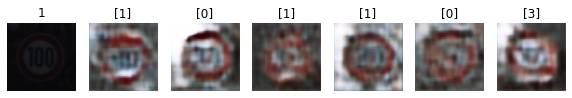

Epoch 9010 g_loss= 1.5848213 d_loss= 0.39722848 real_acc= 0.82 fake_acc= 0.84
Epoch 9020 g_loss= 1.3439695 d_loss= 0.46245217 real_acc= 0.84 fake_acc= 0.78
Epoch 9030 g_loss= 1.6255009 d_loss= 0.33894435 real_acc= 0.94 fake_acc= 0.84
Epoch 9040 g_loss= 1.5660996 d_loss= 0.44118282 real_acc= 0.78 fake_acc= 0.8
Epoch 9050 g_loss= 1.4288242 d_loss= 0.47052497 real_acc= 0.76 fake_acc= 0.82
Epoch 9060 g_loss= 1.5559218 d_loss= 0.3984554 real_acc= 0.82 fake_acc= 0.92
Epoch 9070 g_loss= 1.6277739 d_loss= 0.33229035 real_acc= 0.9 fake_acc= 0.88
Epoch 9080 g_loss= 1.8569037 d_loss= 0.37967193 real_acc= 0.76 fake_acc= 0.9
Epoch 9090 g_loss= 1.9835763 d_loss= 0.4326578 real_acc= 0.74 fake_acc= 0.96
Epoch 9100 g_loss= 1.4476846 d_loss= 0.4148106 real_acc= 0.9 fake_acc= 0.72


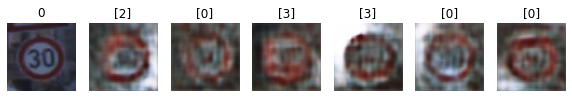

Epoch 9110 g_loss= 1.2531066 d_loss= 0.44270888 real_acc= 0.92 fake_acc= 0.68
Epoch 9120 g_loss= 1.1828502 d_loss= 0.4509083 real_acc= 0.88 fake_acc= 0.66
Epoch 9130 g_loss= 1.4126669 d_loss= 0.42596853 real_acc= 0.88 fake_acc= 0.72
Epoch 9140 g_loss= 1.8868793 d_loss= 0.37767008 real_acc= 0.84 fake_acc= 0.84
Epoch 9150 g_loss= 1.9830213 d_loss= 0.46167365 real_acc= 0.64 fake_acc= 0.96
Epoch 9160 g_loss= 2.040291 d_loss= 0.4255128 real_acc= 0.62 fake_acc= 0.94
Epoch 9170 g_loss= 1.763994 d_loss= 0.4222129 real_acc= 0.78 fake_acc= 0.86
Epoch 9180 g_loss= 1.849382 d_loss= 0.3552149 real_acc= 0.88 fake_acc= 0.84
Epoch 9190 g_loss= 1.693421 d_loss= 0.33104044 real_acc= 0.9 fake_acc= 0.82
Epoch 9200 g_loss= 1.6386021 d_loss= 0.35262793 real_acc= 0.9 fake_acc= 0.84


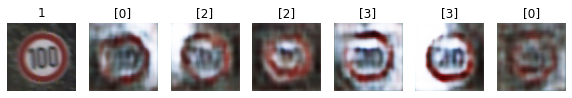

Epoch 9210 g_loss= 1.4623234 d_loss= 0.44719204 real_acc= 0.82 fake_acc= 0.8
Epoch 9220 g_loss= 1.5384531 d_loss= 0.39762986 real_acc= 0.82 fake_acc= 0.84
Epoch 9230 g_loss= 1.3968036 d_loss= 0.40548235 real_acc= 0.88 fake_acc= 0.74
Epoch 9240 g_loss= 1.3461261 d_loss= 0.4031548 real_acc= 0.94 fake_acc= 0.7
Epoch 9250 g_loss= 1.4396312 d_loss= 0.45019495 real_acc= 0.78 fake_acc= 0.78
Epoch 9260 g_loss= 1.8135207 d_loss= 0.3368315 real_acc= 0.8 fake_acc= 0.9
Epoch 9270 g_loss= 1.682712 d_loss= 0.4508338 real_acc= 0.8 fake_acc= 0.8
Epoch 9280 g_loss= 1.6779841 d_loss= 0.39767355 real_acc= 0.86 fake_acc= 0.78
Epoch 9290 g_loss= 1.7902951 d_loss= 0.5049592 real_acc= 0.72 fake_acc= 0.84
Epoch 9300 g_loss= 1.2894092 d_loss= 0.47676954 real_acc= 0.86 fake_acc= 0.7


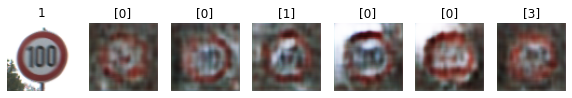

Epoch 9310 g_loss= 1.2876456 d_loss= 0.40501285 real_acc= 0.92 fake_acc= 0.72
Epoch 9320 g_loss= 1.3589984 d_loss= 0.34116518 real_acc= 0.96 fake_acc= 0.9
Epoch 9330 g_loss= 1.8786125 d_loss= 0.37835425 real_acc= 0.8 fake_acc= 0.94
Epoch 9340 g_loss= 1.7745367 d_loss= 0.3825733 real_acc= 0.82 fake_acc= 0.88
Epoch 9350 g_loss= 1.6289318 d_loss= 0.39311343 real_acc= 0.82 fake_acc= 0.9
Epoch 9360 g_loss= 1.5473616 d_loss= 0.3185938 real_acc= 0.96 fake_acc= 0.8
Epoch 9370 g_loss= 1.5727463 d_loss= 0.41591653 real_acc= 0.8 fake_acc= 0.8
Epoch 9380 g_loss= 1.6129019 d_loss= 0.4161437 real_acc= 0.84 fake_acc= 0.82
Epoch 9390 g_loss= 1.5628172 d_loss= 0.39321584 real_acc= 0.84 fake_acc= 0.82
Epoch 9400 g_loss= 1.6136078 d_loss= 0.3758999 real_acc= 0.88 fake_acc= 0.8


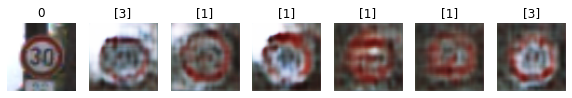

Epoch 9410 g_loss= 1.6215768 d_loss= 0.4120208 real_acc= 0.84 fake_acc= 0.82
Epoch 9420 g_loss= 1.9742825 d_loss= 0.29728824 real_acc= 0.92 fake_acc= 0.94
Epoch 9430 g_loss= 1.4810017 d_loss= 0.49667364 real_acc= 0.72 fake_acc= 0.78
Epoch 9440 g_loss= 1.9258617 d_loss= 0.3731117 real_acc= 0.8 fake_acc= 0.84
Epoch 9450 g_loss= 1.6770977 d_loss= 0.41166073 real_acc= 0.8 fake_acc= 0.82
Epoch 9460 g_loss= 1.8943275 d_loss= 0.35584772 real_acc= 0.84 fake_acc= 0.9
Epoch 9470 g_loss= 1.4465156 d_loss= 0.37231725 real_acc= 0.92 fake_acc= 0.8
Epoch 9480 g_loss= 1.5141339 d_loss= 0.35088807 real_acc= 0.92 fake_acc= 0.84
Epoch 9490 g_loss= 1.5536165 d_loss= 0.38286775 real_acc= 0.92 fake_acc= 0.8
Epoch 9500 g_loss= 2.0094814 d_loss= 0.3613342 real_acc= 0.86 fake_acc= 0.84


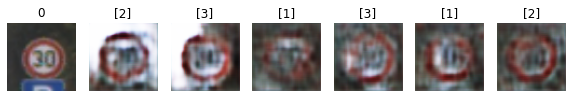

Epoch 9510 g_loss= 1.5271139 d_loss= 0.3753128 real_acc= 0.9 fake_acc= 0.76
Epoch 9520 g_loss= 1.947387 d_loss= 0.3892632 real_acc= 0.82 fake_acc= 0.92
Epoch 9530 g_loss= 2.0327854 d_loss= 0.3150716 real_acc= 0.88 fake_acc= 0.88
Epoch 9540 g_loss= 1.6072446 d_loss= 0.39160076 real_acc= 0.86 fake_acc= 0.8
Epoch 9550 g_loss= 1.2544303 d_loss= 0.36500555 real_acc= 0.98 fake_acc= 0.8
Epoch 9560 g_loss= 1.617577 d_loss= 0.3475845 real_acc= 0.92 fake_acc= 0.88
Epoch 9570 g_loss= 1.5347975 d_loss= 0.3931915 real_acc= 0.88 fake_acc= 0.82
Epoch 9580 g_loss= 1.7634372 d_loss= 0.3140514 real_acc= 0.9 fake_acc= 0.94
Epoch 9590 g_loss= 1.8118259 d_loss= 0.4269746 real_acc= 0.72 fake_acc= 0.86
Epoch 9600 g_loss= 1.4196608 d_loss= 0.3617288 real_acc= 0.86 fake_acc= 0.86


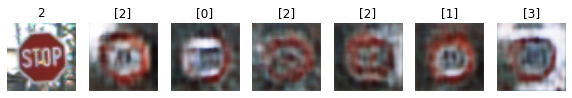

Epoch 9610 g_loss= 1.3944046 d_loss= 0.34125847 real_acc= 0.96 fake_acc= 0.78
Epoch 9620 g_loss= 1.2282742 d_loss= 0.39011097 real_acc= 0.96 fake_acc= 0.68
Epoch 9630 g_loss= 1.1644902 d_loss= 0.4490592 real_acc= 0.94 fake_acc= 0.64
Epoch 9640 g_loss= 1.1506168 d_loss= 0.4122888 real_acc= 0.94 fake_acc= 0.64
Epoch 9650 g_loss= 1.2275159 d_loss= 0.44608122 real_acc= 1.0 fake_acc= 0.64
Epoch 9660 g_loss= 1.6008502 d_loss= 0.32844144 real_acc= 0.94 fake_acc= 0.8
Epoch 9670 g_loss= 1.8387729 d_loss= 0.31517017 real_acc= 0.88 fake_acc= 0.86
Epoch 9680 g_loss= 1.8556153 d_loss= 0.37721792 real_acc= 0.84 fake_acc= 0.86
Epoch 9690 g_loss= 1.8739433 d_loss= 0.3410402 real_acc= 0.88 fake_acc= 0.84
Epoch 9700 g_loss= 1.6473271 d_loss= 0.39794195 real_acc= 0.86 fake_acc= 0.9


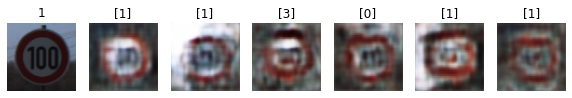

Epoch 9710 g_loss= 1.5059369 d_loss= 0.38848788 real_acc= 0.88 fake_acc= 0.76
Epoch 9720 g_loss= 1.6662468 d_loss= 0.3841339 real_acc= 0.88 fake_acc= 0.82
Epoch 9730 g_loss= 1.3132448 d_loss= 0.43101442 real_acc= 0.9 fake_acc= 0.7
Epoch 9740 g_loss= 1.7316332 d_loss= 0.36561105 real_acc= 0.86 fake_acc= 0.88
Epoch 9750 g_loss= 1.6276606 d_loss= 0.3401033 real_acc= 0.92 fake_acc= 0.82
Epoch 9760 g_loss= 1.8592529 d_loss= 0.3673064 real_acc= 0.88 fake_acc= 0.82
Epoch 9770 g_loss= 1.9828439 d_loss= 0.3166048 real_acc= 0.88 fake_acc= 0.94
Epoch 9780 g_loss= 1.8587945 d_loss= 0.36002246 real_acc= 0.76 fake_acc= 0.86
Epoch 9790 g_loss= 1.6324543 d_loss= 0.34673613 real_acc= 0.9 fake_acc= 0.86
Epoch 9800 g_loss= 1.8363805 d_loss= 0.3951699 real_acc= 0.8 fake_acc= 0.84


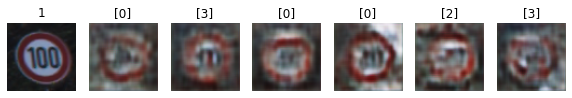

Epoch 9810 g_loss= 1.5377305 d_loss= 0.37191343 real_acc= 0.94 fake_acc= 0.72
Epoch 9820 g_loss= 1.9230857 d_loss= 0.36067587 real_acc= 0.82 fake_acc= 0.86
Epoch 9830 g_loss= 1.6490386 d_loss= 0.38894236 real_acc= 0.76 fake_acc= 0.88
Epoch 9840 g_loss= 1.8151058 d_loss= 0.3806365 real_acc= 0.78 fake_acc= 0.82
Epoch 9850 g_loss= 1.5504975 d_loss= 0.41777432 real_acc= 0.82 fake_acc= 0.8
Epoch 9860 g_loss= 2.1071236 d_loss= 0.36570224 real_acc= 0.86 fake_acc= 0.94
Epoch 9870 g_loss= 2.1730008 d_loss= 0.52908474 real_acc= 0.54 fake_acc= 0.94
Epoch 9880 g_loss= 1.9922724 d_loss= 0.38428032 real_acc= 0.74 fake_acc= 0.98
Epoch 9890 g_loss= 2.0734255 d_loss= 0.34699884 real_acc= 0.88 fake_acc= 0.92
Epoch 9900 g_loss= 2.0354586 d_loss= 0.32776535 real_acc= 0.86 fake_acc= 0.96


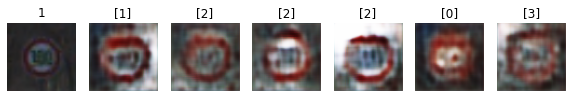

Epoch 9910 g_loss= 1.6678255 d_loss= 0.35794428 real_acc= 0.86 fake_acc= 0.84
Epoch 9920 g_loss= 1.5741044 d_loss= 0.4268494 real_acc= 0.82 fake_acc= 0.88
Epoch 9930 g_loss= 1.563566 d_loss= 0.39534277 real_acc= 0.84 fake_acc= 0.84
Epoch 9940 g_loss= 1.5583038 d_loss= 0.38614917 real_acc= 0.88 fake_acc= 0.82
Epoch 9950 g_loss= 1.4932393 d_loss= 0.36690187 real_acc= 0.94 fake_acc= 0.8
Epoch 9960 g_loss= 1.8812906 d_loss= 0.4065758 real_acc= 0.72 fake_acc= 0.86
Epoch 9970 g_loss= 2.2487552 d_loss= 0.32574707 real_acc= 0.82 fake_acc= 0.94
Epoch 9980 g_loss= 1.4302719 d_loss= 0.40524077 real_acc= 0.92 fake_acc= 0.8
Epoch 9990 g_loss= 2.2875278 d_loss= 0.33608234 real_acc= 0.8 fake_acc= 0.92
Epoch 10000 g_loss= 2.0961041 d_loss= 0.3969403 real_acc= 0.7 fake_acc= 0.92


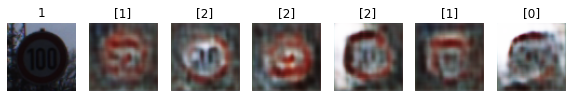

Epoch 10010 g_loss= 2.1157956 d_loss= 0.4820053 real_acc= 0.6 fake_acc= 0.88
Epoch 10020 g_loss= 2.285211 d_loss= 0.39172727 real_acc= 0.82 fake_acc= 0.96
Epoch 10030 g_loss= 1.9034249 d_loss= 0.36790234 real_acc= 0.8 fake_acc= 0.86
Epoch 10040 g_loss= 1.6763623 d_loss= 0.3651513 real_acc= 0.94 fake_acc= 0.8
Epoch 10050 g_loss= 1.476915 d_loss= 0.41305852 real_acc= 0.8 fake_acc= 0.88
Epoch 10060 g_loss= 1.6005852 d_loss= 0.3454188 real_acc= 0.94 fake_acc= 0.78
Epoch 10070 g_loss= 2.1325312 d_loss= 0.38712233 real_acc= 0.76 fake_acc= 0.92
Epoch 10080 g_loss= 1.9905509 d_loss= 0.34541166 real_acc= 0.78 fake_acc= 0.92
Epoch 10090 g_loss= 2.0918584 d_loss= 0.29862452 real_acc= 0.92 fake_acc= 0.88
Epoch 10100 g_loss= 2.0445127 d_loss= 0.31122178 real_acc= 0.86 fake_acc= 0.92


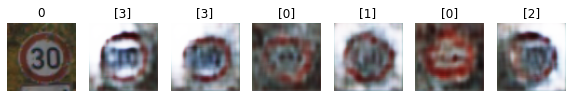

Epoch 10110 g_loss= 1.7739416 d_loss= 0.33191532 real_acc= 0.86 fake_acc= 0.92
Epoch 10120 g_loss= 1.7469971 d_loss= 0.3997739 real_acc= 0.88 fake_acc= 0.8
Epoch 10130 g_loss= 1.3970174 d_loss= 0.45883915 real_acc= 0.88 fake_acc= 0.74
Epoch 10140 g_loss= 2.2517507 d_loss= 0.35803515 real_acc= 0.8 fake_acc= 0.96
Epoch 10150 g_loss= 2.208448 d_loss= 0.38351357 real_acc= 0.8 fake_acc= 0.88
Epoch 10160 g_loss= 1.4974573 d_loss= 0.45523423 real_acc= 0.84 fake_acc= 0.74
Epoch 10170 g_loss= 1.7688867 d_loss= 0.36306113 real_acc= 0.88 fake_acc= 0.82
Epoch 10180 g_loss= 2.2253964 d_loss= 0.30402666 real_acc= 0.82 fake_acc= 0.96
Epoch 10190 g_loss= 1.8284159 d_loss= 0.38050592 real_acc= 0.86 fake_acc= 0.86
Epoch 10200 g_loss= 1.6930596 d_loss= 0.3118056 real_acc= 0.92 fake_acc= 0.84


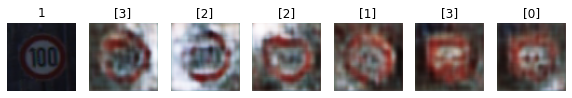

Epoch 10210 g_loss= 1.7483171 d_loss= 0.37087202 real_acc= 0.94 fake_acc= 0.76
Epoch 10220 g_loss= 1.2919067 d_loss= 0.44980454 real_acc= 0.88 fake_acc= 0.66
Epoch 10230 g_loss= 1.6056907 d_loss= 0.3440636 real_acc= 0.92 fake_acc= 0.9
Epoch 10240 g_loss= 1.7525657 d_loss= 0.35365027 real_acc= 0.9 fake_acc= 0.84
Epoch 10250 g_loss= 1.8351347 d_loss= 0.35871166 real_acc= 0.82 fake_acc= 0.88
Epoch 10260 g_loss= 1.4563769 d_loss= 0.37302703 real_acc= 0.9 fake_acc= 0.76
Epoch 10270 g_loss= 1.8349261 d_loss= 0.3316061 real_acc= 0.82 fake_acc= 0.76
Epoch 10280 g_loss= 2.126127 d_loss= 0.41158038 real_acc= 0.72 fake_acc= 0.88
Epoch 10290 g_loss= 1.7283009 d_loss= 0.41434902 real_acc= 0.76 fake_acc= 0.84
Epoch 10300 g_loss= 1.9820657 d_loss= 0.36635143 real_acc= 0.82 fake_acc= 0.9


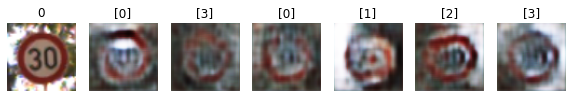

Epoch 10310 g_loss= 1.7299005 d_loss= 0.35262161 real_acc= 0.86 fake_acc= 0.9
Epoch 10320 g_loss= 1.954559 d_loss= 0.3165654 real_acc= 0.9 fake_acc= 0.88
Epoch 10330 g_loss= 1.5442281 d_loss= 0.3747623 real_acc= 0.86 fake_acc= 0.74
Epoch 10340 g_loss= 1.5274106 d_loss= 0.35271585 real_acc= 0.98 fake_acc= 0.78
Epoch 10350 g_loss= 1.5517731 d_loss= 0.3537863 real_acc= 0.88 fake_acc= 0.78
Epoch 10360 g_loss= 1.76528 d_loss= 0.34648442 real_acc= 0.9 fake_acc= 0.86
Epoch 10370 g_loss= 1.6843544 d_loss= 0.39519876 real_acc= 0.84 fake_acc= 0.84
Epoch 10380 g_loss= 2.4310043 d_loss= 0.34041166 real_acc= 0.78 fake_acc= 0.96
Epoch 10390 g_loss= 1.9349788 d_loss= 0.33901525 real_acc= 0.9 fake_acc= 0.86
Epoch 10400 g_loss= 1.9309795 d_loss= 0.3351398 real_acc= 0.88 fake_acc= 0.88


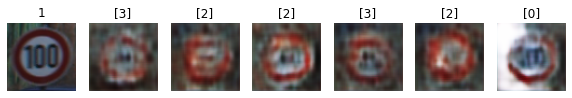

Epoch 10410 g_loss= 2.0294678 d_loss= 0.31009227 real_acc= 0.88 fake_acc= 0.94
Epoch 10420 g_loss= 2.3101296 d_loss= 0.33066148 real_acc= 0.82 fake_acc= 0.96
Epoch 10430 g_loss= 1.8452069 d_loss= 0.37137106 real_acc= 0.88 fake_acc= 0.84
Epoch 10440 g_loss= 2.0239277 d_loss= 0.32718313 real_acc= 0.88 fake_acc= 0.86
Epoch 10450 g_loss= 1.7164005 d_loss= 0.30673528 real_acc= 0.92 fake_acc= 0.86
Epoch 10460 g_loss= 1.5872176 d_loss= 0.3443318 real_acc= 0.96 fake_acc= 0.84
Epoch 10470 g_loss= 1.6759359 d_loss= 0.33848923 real_acc= 0.94 fake_acc= 0.72
Epoch 10480 g_loss= 1.8072958 d_loss= 0.37036163 real_acc= 0.82 fake_acc= 0.8
Epoch 10490 g_loss= 1.4633342 d_loss= 0.4185621 real_acc= 0.84 fake_acc= 0.86
Epoch 10500 g_loss= 1.758411 d_loss= 0.35874867 real_acc= 0.88 fake_acc= 0.88


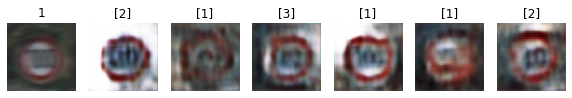

Epoch 10510 g_loss= 1.917481 d_loss= 0.4308415 real_acc= 0.78 fake_acc= 0.88
Epoch 10520 g_loss= 1.8488766 d_loss= 0.3340752 real_acc= 0.88 fake_acc= 0.86
Epoch 10530 g_loss= 1.5734572 d_loss= 0.33342254 real_acc= 0.96 fake_acc= 0.8
Epoch 10540 g_loss= 1.5424738 d_loss= 0.40032881 real_acc= 0.78 fake_acc= 0.82
Epoch 10550 g_loss= 2.057892 d_loss= 0.311588 real_acc= 0.92 fake_acc= 0.92
Epoch 10560 g_loss= 1.549131 d_loss= 0.397009 real_acc= 0.92 fake_acc= 0.74
Epoch 10570 g_loss= 1.7624559 d_loss= 0.41608375 real_acc= 0.8 fake_acc= 0.82
Epoch 10580 g_loss= 1.921588 d_loss= 0.2907561 real_acc= 0.94 fake_acc= 0.9
Epoch 10590 g_loss= 1.5925498 d_loss= 0.36200994 real_acc= 0.86 fake_acc= 0.86
Epoch 10600 g_loss= 2.0250578 d_loss= 0.3411081 real_acc= 0.82 fake_acc= 0.86


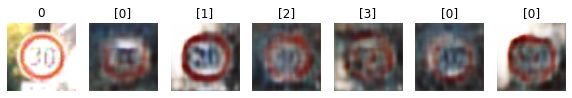

Epoch 10610 g_loss= 1.772361 d_loss= 0.3743871 real_acc= 0.9 fake_acc= 0.84
Epoch 10620 g_loss= 1.8980002 d_loss= 0.32154006 real_acc= 0.96 fake_acc= 0.72
Epoch 10630 g_loss= 1.7584312 d_loss= 0.318285 real_acc= 0.86 fake_acc= 0.84
Epoch 10640 g_loss= 1.7732253 d_loss= 0.33909547 real_acc= 0.88 fake_acc= 0.88
Epoch 10650 g_loss= 2.4535122 d_loss= 0.40549564 real_acc= 0.74 fake_acc= 0.96
Epoch 10660 g_loss= 1.9027809 d_loss= 0.3927263 real_acc= 0.76 fake_acc= 0.84
Epoch 10670 g_loss= 1.6441303 d_loss= 0.39652067 real_acc= 0.82 fake_acc= 0.8
Epoch 10680 g_loss= 1.3621331 d_loss= 0.37830013 real_acc= 0.92 fake_acc= 0.72
Epoch 10690 g_loss= 1.7278099 d_loss= 0.2890069 real_acc= 0.96 fake_acc= 0.8
Epoch 10700 g_loss= 1.552683 d_loss= 0.3838489 real_acc= 0.88 fake_acc= 0.8


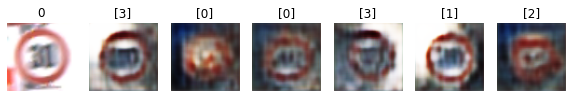

Epoch 10710 g_loss= 1.783003 d_loss= 0.35369104 real_acc= 0.92 fake_acc= 0.88
Epoch 10720 g_loss= 1.8726178 d_loss= 0.35716945 real_acc= 0.84 fake_acc= 0.94
Epoch 10730 g_loss= 1.7068676 d_loss= 0.41352475 real_acc= 0.8 fake_acc= 0.84
Epoch 10740 g_loss= 1.6538539 d_loss= 0.35420525 real_acc= 0.88 fake_acc= 0.78
Epoch 10750 g_loss= 1.7346098 d_loss= 0.2916118 real_acc= 0.94 fake_acc= 0.88
Epoch 10760 g_loss= 1.7813078 d_loss= 0.34372276 real_acc= 0.9 fake_acc= 0.86
Epoch 10770 g_loss= 2.1278956 d_loss= 0.3131436 real_acc= 0.92 fake_acc= 0.94
Epoch 10780 g_loss= 2.2752912 d_loss= 0.33506346 real_acc= 0.74 fake_acc= 0.94
Epoch 10790 g_loss= 1.7401018 d_loss= 0.38271248 real_acc= 0.82 fake_acc= 0.84
Epoch 10800 g_loss= 1.6803626 d_loss= 0.3864634 real_acc= 0.8 fake_acc= 0.82


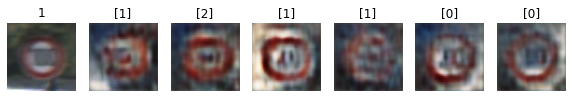

Epoch 10810 g_loss= 2.2228293 d_loss= 0.3009131 real_acc= 0.88 fake_acc= 0.98
Epoch 10820 g_loss= 2.2090187 d_loss= 0.33294755 real_acc= 0.76 fake_acc= 0.92
Epoch 10830 g_loss= 1.6223488 d_loss= 0.33808202 real_acc= 0.92 fake_acc= 0.84
Epoch 10840 g_loss= 1.6809632 d_loss= 0.354171 real_acc= 0.9 fake_acc= 0.9
Epoch 10850 g_loss= 1.4075226 d_loss= 0.35318303 real_acc= 0.94 fake_acc= 0.78
Epoch 10860 g_loss= 1.3083947 d_loss= 0.3651223 real_acc= 0.98 fake_acc= 0.68
Epoch 10870 g_loss= 1.6324562 d_loss= 0.38268173 real_acc= 0.86 fake_acc= 0.86
Epoch 10880 g_loss= 1.6931014 d_loss= 0.31989273 real_acc= 0.92 fake_acc= 0.86
Epoch 10890 g_loss= 1.6126909 d_loss= 0.2884879 real_acc= 0.94 fake_acc= 0.94
Epoch 10900 g_loss= 1.9023253 d_loss= 0.3797434 real_acc= 0.8 fake_acc= 0.9


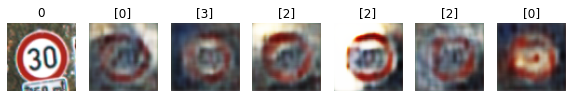

Epoch 10910 g_loss= 1.7392421 d_loss= 0.39086467 real_acc= 0.8 fake_acc= 0.82
Epoch 10920 g_loss= 2.0987194 d_loss= 0.39472502 real_acc= 0.76 fake_acc= 0.9
Epoch 10930 g_loss= 1.7581483 d_loss= 0.31925523 real_acc= 0.94 fake_acc= 0.74
Epoch 10940 g_loss= 1.9736351 d_loss= 0.319606 real_acc= 0.88 fake_acc= 0.84
Epoch 10950 g_loss= 1.4143628 d_loss= 0.4199142 real_acc= 0.9 fake_acc= 0.72
Epoch 10960 g_loss= 2.130318 d_loss= 0.32659495 real_acc= 0.84 fake_acc= 0.94
Epoch 10970 g_loss= 2.6044397 d_loss= 0.3319001 real_acc= 0.86 fake_acc= 0.96
Epoch 10980 g_loss= 1.8995216 d_loss= 0.33463323 real_acc= 0.82 fake_acc= 0.9
Epoch 10990 g_loss= 1.9107338 d_loss= 0.37165833 real_acc= 0.84 fake_acc= 0.82
Epoch 11000 g_loss= 1.9795299 d_loss= 0.32584405 real_acc= 0.92 fake_acc= 0.88


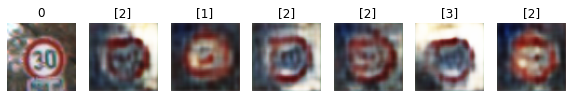

Epoch 11010 g_loss= 1.8812459 d_loss= 0.27592635 real_acc= 0.94 fake_acc= 0.88
Epoch 11020 g_loss= 1.5777614 d_loss= 0.41930693 real_acc= 0.88 fake_acc= 0.72
Epoch 11030 g_loss= 2.3041575 d_loss= 0.30385092 real_acc= 0.84 fake_acc= 0.9
Epoch 11040 g_loss= 1.8202358 d_loss= 0.37753665 real_acc= 0.84 fake_acc= 0.86
Epoch 11050 g_loss= 1.7953241 d_loss= 0.37986985 real_acc= 0.86 fake_acc= 0.9
Epoch 11060 g_loss= 1.8596262 d_loss= 0.28744835 real_acc= 0.96 fake_acc= 0.86
Epoch 11070 g_loss= 1.6376946 d_loss= 0.30261764 real_acc= 0.92 fake_acc= 0.84
Epoch 11080 g_loss= 1.8204377 d_loss= 0.3085652 real_acc= 0.9 fake_acc= 0.9
Epoch 11090 g_loss= 1.763609 d_loss= 0.40136668 real_acc= 0.82 fake_acc= 0.82
Epoch 11100 g_loss= 1.6045092 d_loss= 0.41918927 real_acc= 0.82 fake_acc= 0.86


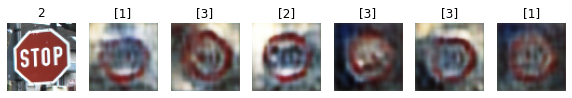

Epoch 11110 g_loss= 1.7989727 d_loss= 0.33836013 real_acc= 0.86 fake_acc= 0.86
Epoch 11120 g_loss= 1.3100383 d_loss= 0.38189262 real_acc= 0.96 fake_acc= 0.66
Epoch 11130 g_loss= 1.5314543 d_loss= 0.36219662 real_acc= 0.94 fake_acc= 0.72
Epoch 11140 g_loss= 1.8477418 d_loss= 0.34990567 real_acc= 0.84 fake_acc= 0.88
Epoch 11150 g_loss= 2.0920556 d_loss= 0.3131863 real_acc= 0.86 fake_acc= 0.92
Epoch 11160 g_loss= 1.6946187 d_loss= 0.3260739 real_acc= 0.94 fake_acc= 0.84
Epoch 11170 g_loss= 1.4938644 d_loss= 0.3733351 real_acc= 0.96 fake_acc= 0.78
Epoch 11180 g_loss= 1.7394474 d_loss= 0.32735682 real_acc= 0.94 fake_acc= 0.86
Epoch 11190 g_loss= 2.0349305 d_loss= 0.34916592 real_acc= 0.84 fake_acc= 0.9
Epoch 11200 g_loss= 1.5165782 d_loss= 0.36533803 real_acc= 0.88 fake_acc= 0.82


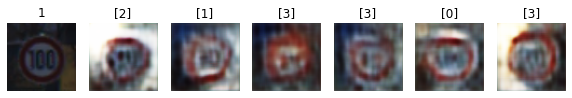

Epoch 11210 g_loss= 1.754655 d_loss= 0.3524144 real_acc= 0.84 fake_acc= 0.9
Epoch 11220 g_loss= 1.7356198 d_loss= 0.3774363 real_acc= 0.8 fake_acc= 0.88
Epoch 11230 g_loss= 1.9976301 d_loss= 0.3946982 real_acc= 0.82 fake_acc= 0.92
Epoch 11240 g_loss= 1.9552255 d_loss= 0.35005134 real_acc= 0.84 fake_acc= 0.88
Epoch 11250 g_loss= 1.8162755 d_loss= 0.44126588 real_acc= 0.82 fake_acc= 0.88
Epoch 11260 g_loss= 2.0290966 d_loss= 0.37011045 real_acc= 0.82 fake_acc= 0.9
Epoch 11270 g_loss= 1.9926866 d_loss= 0.39772934 real_acc= 0.8 fake_acc= 0.86
Epoch 11280 g_loss= 1.898836 d_loss= 0.33520794 real_acc= 0.9 fake_acc= 0.9
Epoch 11290 g_loss= 1.7549843 d_loss= 0.38207293 real_acc= 0.88 fake_acc= 0.76
Epoch 11300 g_loss= 1.5994179 d_loss= 0.4669933 real_acc= 0.8 fake_acc= 0.78


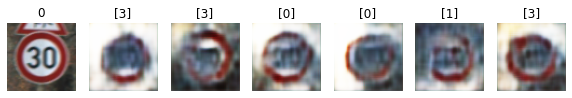

Epoch 11310 g_loss= 2.0664768 d_loss= 0.35177955 real_acc= 0.84 fake_acc= 0.86
Epoch 11320 g_loss= 1.5983368 d_loss= 0.39299306 real_acc= 0.88 fake_acc= 0.74
Epoch 11330 g_loss= 1.2929049 d_loss= 0.3969391 real_acc= 0.9 fake_acc= 0.74
Epoch 11340 g_loss= 1.8139988 d_loss= 0.37724692 real_acc= 0.88 fake_acc= 0.84
Epoch 11350 g_loss= 1.7513596 d_loss= 0.3064264 real_acc= 0.9 fake_acc= 0.86
Epoch 11360 g_loss= 2.1958294 d_loss= 0.34174043 real_acc= 0.8 fake_acc= 0.9
Epoch 11370 g_loss= 1.3562742 d_loss= 0.35843563 real_acc= 0.92 fake_acc= 0.76
Epoch 11380 g_loss= 1.866303 d_loss= 0.3604626 real_acc= 0.9 fake_acc= 0.84
Epoch 11390 g_loss= 1.615121 d_loss= 0.32115582 real_acc= 0.92 fake_acc= 0.76
Epoch 11400 g_loss= 2.0810678 d_loss= 0.30637392 real_acc= 0.82 fake_acc= 0.94


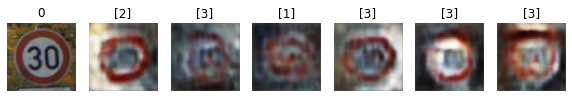

Epoch 11410 g_loss= 1.6897126 d_loss= 0.37926877 real_acc= 0.86 fake_acc= 0.84
Epoch 11420 g_loss= 1.8250405 d_loss= 0.36847872 real_acc= 0.84 fake_acc= 0.88
Epoch 11430 g_loss= 2.0299559 d_loss= 0.38153785 real_acc= 0.8 fake_acc= 0.94
Epoch 11440 g_loss= 1.5209616 d_loss= 0.3644938 real_acc= 0.92 fake_acc= 0.78
Epoch 11450 g_loss= 1.7945653 d_loss= 0.28283787 real_acc= 0.98 fake_acc= 0.84
Epoch 11460 g_loss= 1.6159362 d_loss= 0.34431928 real_acc= 0.92 fake_acc= 0.8
Epoch 11470 g_loss= 1.7236776 d_loss= 0.3595947 real_acc= 0.88 fake_acc= 0.86
Epoch 11480 g_loss= 1.7941525 d_loss= 0.29507443 real_acc= 0.94 fake_acc= 0.92
Epoch 11490 g_loss= 1.952956 d_loss= 0.3868075 real_acc= 0.78 fake_acc= 0.9
Epoch 11500 g_loss= 1.4049946 d_loss= 0.3983558 real_acc= 0.88 fake_acc= 0.7


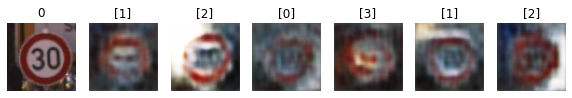

Epoch 11510 g_loss= 1.8141751 d_loss= 0.35535413 real_acc= 0.86 fake_acc= 0.86
Epoch 11520 g_loss= 1.8499646 d_loss= 0.32767013 real_acc= 0.82 fake_acc= 0.9
Epoch 11530 g_loss= 1.6622859 d_loss= 0.42348376 real_acc= 0.86 fake_acc= 0.8
Epoch 11540 g_loss= 1.5719826 d_loss= 0.39280942 real_acc= 0.86 fake_acc= 0.82
Epoch 11550 g_loss= 1.4503065 d_loss= 0.41013455 real_acc= 0.86 fake_acc= 0.78
Epoch 11560 g_loss= 2.0176427 d_loss= 0.30921066 real_acc= 0.88 fake_acc= 0.9
Epoch 11570 g_loss= 1.8384907 d_loss= 0.35145885 real_acc= 0.88 fake_acc= 0.92
Epoch 11580 g_loss= 1.9935917 d_loss= 0.31577128 real_acc= 0.94 fake_acc= 0.88
Epoch 11590 g_loss= 1.7889987 d_loss= 0.31889185 real_acc= 0.94 fake_acc= 0.86
Epoch 11600 g_loss= 2.2968812 d_loss= 0.35465574 real_acc= 0.84 fake_acc= 0.92


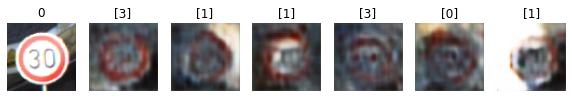

Epoch 11610 g_loss= 1.8542598 d_loss= 0.33210552 real_acc= 0.84 fake_acc= 0.86
Epoch 11620 g_loss= 1.7095087 d_loss= 0.33912975 real_acc= 0.88 fake_acc= 0.9
Epoch 11630 g_loss= 1.791618 d_loss= 0.3698824 real_acc= 0.8 fake_acc= 0.92
Epoch 11640 g_loss= 1.9695665 d_loss= 0.3468587 real_acc= 0.84 fake_acc= 0.9
Epoch 11650 g_loss= 1.8446188 d_loss= 0.29659712 real_acc= 0.88 fake_acc= 0.9
Epoch 11660 g_loss= 1.7597816 d_loss= 0.3683209 real_acc= 0.82 fake_acc= 0.88
Epoch 11670 g_loss= 1.3501778 d_loss= 0.3738234 real_acc= 0.88 fake_acc= 0.78
Epoch 11680 g_loss= 1.8480859 d_loss= 0.38131386 real_acc= 0.82 fake_acc= 0.86
Epoch 11690 g_loss= 1.8589997 d_loss= 0.36097282 real_acc= 0.76 fake_acc= 0.88
Epoch 11700 g_loss= 1.5692292 d_loss= 0.39312944 real_acc= 0.82 fake_acc= 0.76


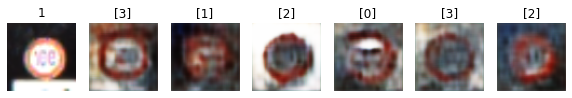

Epoch 11710 g_loss= 1.8409867 d_loss= 0.36466983 real_acc= 0.8 fake_acc= 0.92
Epoch 11720 g_loss= 2.0492537 d_loss= 0.32265788 real_acc= 0.78 fake_acc= 0.98
Epoch 11730 g_loss= 1.6122929 d_loss= 0.37268198 real_acc= 0.82 fake_acc= 0.86
Epoch 11740 g_loss= 1.9223742 d_loss= 0.41734225 real_acc= 0.74 fake_acc= 0.88
Epoch 11750 g_loss= 1.9998238 d_loss= 0.36048254 real_acc= 0.84 fake_acc= 0.96
Epoch 11760 g_loss= 2.0677972 d_loss= 0.3563237 real_acc= 0.82 fake_acc= 1.0
Epoch 11770 g_loss= 1.7472904 d_loss= 0.29918116 real_acc= 0.9 fake_acc= 0.9
Epoch 11780 g_loss= 1.6733007 d_loss= 0.3577783 real_acc= 0.86 fake_acc= 0.82
Epoch 11790 g_loss= 1.4775962 d_loss= 0.38010973 real_acc= 0.86 fake_acc= 0.74
Epoch 11800 g_loss= 2.3691452 d_loss= 0.36467642 real_acc= 0.68 fake_acc= 1.0


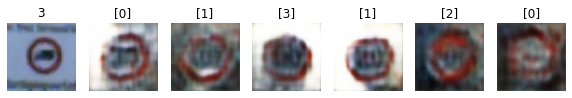

Epoch 11810 g_loss= 2.4717352 d_loss= 0.42590955 real_acc= 0.68 fake_acc= 0.94
Epoch 11820 g_loss= 1.6451521 d_loss= 0.34283298 real_acc= 0.92 fake_acc= 0.86
Epoch 11830 g_loss= 1.8789209 d_loss= 0.32937258 real_acc= 0.88 fake_acc= 0.88
Epoch 11840 g_loss= 1.628822 d_loss= 0.32616237 real_acc= 0.92 fake_acc= 0.82
Epoch 11850 g_loss= 1.4359322 d_loss= 0.3381888 real_acc= 0.9 fake_acc= 0.82
Epoch 11860 g_loss= 1.6049014 d_loss= 0.33061045 real_acc= 0.94 fake_acc= 0.9
Epoch 11870 g_loss= 2.1572227 d_loss= 0.3759002 real_acc= 0.78 fake_acc= 0.94
Epoch 11880 g_loss= 2.2138455 d_loss= 0.3622859 real_acc= 0.76 fake_acc= 0.92
Epoch 11890 g_loss= 1.8546464 d_loss= 0.30141467 real_acc= 0.92 fake_acc= 0.96
Epoch 11900 g_loss= 1.7015404 d_loss= 0.3329003 real_acc= 0.9 fake_acc= 0.8


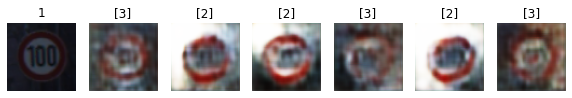

Epoch 11910 g_loss= 1.4193573 d_loss= 0.35485643 real_acc= 0.88 fake_acc= 0.86
Epoch 11920 g_loss= 1.8517517 d_loss= 0.3649244 real_acc= 0.88 fake_acc= 0.8
Epoch 11930 g_loss= 1.9703373 d_loss= 0.409101 real_acc= 0.76 fake_acc= 0.86
Epoch 11940 g_loss= 1.6000694 d_loss= 0.33396867 real_acc= 0.88 fake_acc= 0.9
Epoch 11950 g_loss= 1.7377062 d_loss= 0.28999063 real_acc= 0.94 fake_acc= 0.86
Epoch 11960 g_loss= 1.6126006 d_loss= 0.34013116 real_acc= 0.88 fake_acc= 0.86
Epoch 11970 g_loss= 1.6942445 d_loss= 0.37184477 real_acc= 0.88 fake_acc= 0.86
Epoch 11980 g_loss= 1.6778244 d_loss= 0.29152218 real_acc= 0.98 fake_acc= 0.82
Epoch 11990 g_loss= 1.7681218 d_loss= 0.32189685 real_acc= 0.86 fake_acc= 0.94
Epoch 12000 g_loss= 1.9761467 d_loss= 0.30748004 real_acc= 0.86 fake_acc= 0.92


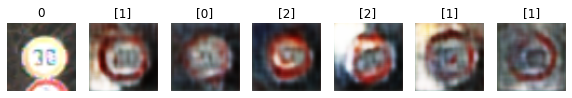

Epoch 12010 g_loss= 1.4137981 d_loss= 0.36826742 real_acc= 0.84 fake_acc= 0.8
Epoch 12020 g_loss= 1.7488941 d_loss= 0.3655945 real_acc= 0.76 fake_acc= 0.88
Epoch 12030 g_loss= 2.0142486 d_loss= 0.31358594 real_acc= 0.86 fake_acc= 0.94
Epoch 12040 g_loss= 1.4808786 d_loss= 0.4000754 real_acc= 0.86 fake_acc= 0.78
Epoch 12050 g_loss= 1.7379715 d_loss= 0.28403828 real_acc= 0.98 fake_acc= 0.9
Epoch 12060 g_loss= 2.2093225 d_loss= 0.3124423 real_acc= 0.82 fake_acc= 0.98
Epoch 12070 g_loss= 1.7700499 d_loss= 0.3683864 real_acc= 0.72 fake_acc= 0.9
Epoch 12080 g_loss= 1.8246225 d_loss= 0.33819535 real_acc= 0.88 fake_acc= 0.92
Epoch 12090 g_loss= 1.9997047 d_loss= 0.3106884 real_acc= 0.92 fake_acc= 0.9
Epoch 12100 g_loss= 1.413601 d_loss= 0.33781168 real_acc= 0.94 fake_acc= 0.84


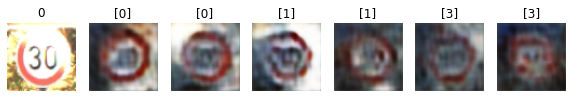

Epoch 12110 g_loss= 1.6934012 d_loss= 0.33281326 real_acc= 0.86 fake_acc= 0.88
Epoch 12120 g_loss= 2.0334787 d_loss= 0.35561347 real_acc= 0.76 fake_acc= 0.94
Epoch 12130 g_loss= 2.0990767 d_loss= 0.3631997 real_acc= 0.76 fake_acc= 0.94
Epoch 12140 g_loss= 1.7173027 d_loss= 0.3593318 real_acc= 0.84 fake_acc= 0.86
Epoch 12150 g_loss= 1.5175935 d_loss= 0.33885896 real_acc= 0.92 fake_acc= 0.74
Epoch 12160 g_loss= 1.7961998 d_loss= 0.3910383 real_acc= 0.72 fake_acc= 0.86
Epoch 12170 g_loss= 1.6100001 d_loss= 0.3853898 real_acc= 0.86 fake_acc= 0.82
Epoch 12180 g_loss= 1.4613867 d_loss= 0.36250287 real_acc= 0.86 fake_acc= 0.84
Epoch 12190 g_loss= 1.9003763 d_loss= 0.3559149 real_acc= 0.86 fake_acc= 0.94
Epoch 12200 g_loss= 1.7006456 d_loss= 0.37539452 real_acc= 0.88 fake_acc= 0.9


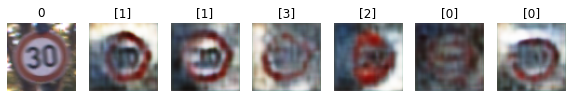

Epoch 12210 g_loss= 1.3453522 d_loss= 0.4140821 real_acc= 0.9 fake_acc= 0.76
Epoch 12220 g_loss= 1.57035 d_loss= 0.37491938 real_acc= 0.96 fake_acc= 0.84
Epoch 12230 g_loss= 1.9893909 d_loss= 0.38148102 real_acc= 0.76 fake_acc= 0.98
Epoch 12240 g_loss= 2.1181862 d_loss= 0.38730553 real_acc= 0.64 fake_acc= 0.98
Epoch 12250 g_loss= 1.5462738 d_loss= 0.4083863 real_acc= 0.84 fake_acc= 0.86
Epoch 12260 g_loss= 1.7819492 d_loss= 0.33085114 real_acc= 0.9 fake_acc= 0.92
Epoch 12270 g_loss= 1.2408094 d_loss= 0.37277386 real_acc= 0.96 fake_acc= 0.72
Epoch 12280 g_loss= 1.6009582 d_loss= 0.33203176 real_acc= 0.9 fake_acc= 0.82
Epoch 12290 g_loss= 1.3924806 d_loss= 0.37927863 real_acc= 0.92 fake_acc= 0.82
Epoch 12300 g_loss= 1.5141156 d_loss= 0.35031518 real_acc= 0.9 fake_acc= 0.84


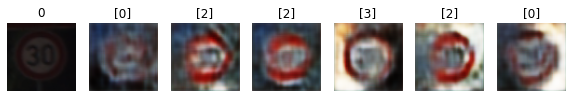

Epoch 12310 g_loss= 1.7120299 d_loss= 0.42153335 real_acc= 0.82 fake_acc= 0.88
Epoch 12320 g_loss= 1.545349 d_loss= 0.31327683 real_acc= 0.96 fake_acc= 0.86
Epoch 12330 g_loss= 1.4730551 d_loss= 0.35873318 real_acc= 0.84 fake_acc= 0.86
Epoch 12340 g_loss= 1.7847927 d_loss= 0.32817048 real_acc= 0.86 fake_acc= 0.82
Epoch 12350 g_loss= 1.628982 d_loss= 0.3843861 real_acc= 0.84 fake_acc= 0.88
Epoch 12360 g_loss= 2.1488256 d_loss= 0.31672686 real_acc= 0.82 fake_acc= 0.98
Epoch 12370 g_loss= 1.9551147 d_loss= 0.36262846 real_acc= 0.78 fake_acc= 0.96
Epoch 12380 g_loss= 1.4212935 d_loss= 0.37617117 real_acc= 0.9 fake_acc= 0.82
Epoch 12390 g_loss= 1.7405331 d_loss= 0.3813664 real_acc= 0.76 fake_acc= 0.94
Epoch 12400 g_loss= 1.5531334 d_loss= 0.31898737 real_acc= 0.94 fake_acc= 0.9


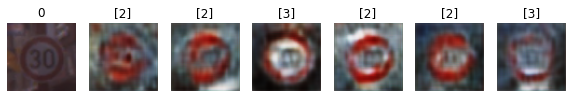

Epoch 12410 g_loss= 1.5289395 d_loss= 0.3593722 real_acc= 0.92 fake_acc= 0.88
Epoch 12420 g_loss= 1.9990048 d_loss= 0.37754023 real_acc= 0.8 fake_acc= 0.92
Epoch 12430 g_loss= 1.8942807 d_loss= 0.37416244 real_acc= 0.74 fake_acc= 0.94
Epoch 12440 g_loss= 1.3816562 d_loss= 0.34096175 real_acc= 0.92 fake_acc= 0.82
Epoch 12450 g_loss= 1.5932263 d_loss= 0.32835263 real_acc= 0.92 fake_acc= 0.92
Epoch 12460 g_loss= 1.6104702 d_loss= 0.3597256 real_acc= 0.84 fake_acc= 0.92
Epoch 12470 g_loss= 1.5130396 d_loss= 0.3775072 real_acc= 0.9 fake_acc= 0.82
Epoch 12480 g_loss= 1.4789516 d_loss= 0.3164003 real_acc= 0.96 fake_acc= 0.88
Epoch 12490 g_loss= 1.4073638 d_loss= 0.39671773 real_acc= 0.88 fake_acc= 0.82
Epoch 12500 g_loss= 1.5664036 d_loss= 0.32859552 real_acc= 0.92 fake_acc= 0.92


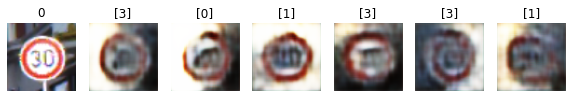

Epoch 12510 g_loss= 1.3567783 d_loss= 0.36346102 real_acc= 0.9 fake_acc= 0.78
Epoch 12520 g_loss= 1.5299457 d_loss= 0.3595022 real_acc= 0.78 fake_acc= 0.92
Epoch 12530 g_loss= 1.6192797 d_loss= 0.36534953 real_acc= 0.8 fake_acc= 0.92
Epoch 12540 g_loss= 1.9302211 d_loss= 0.31567013 real_acc= 0.86 fake_acc= 0.92
Epoch 12550 g_loss= 1.4883783 d_loss= 0.29360667 real_acc= 1.0 fake_acc= 0.88
Epoch 12560 g_loss= 1.3517272 d_loss= 0.31931323 real_acc= 0.9 fake_acc= 0.84
Epoch 12570 g_loss= 1.5299824 d_loss= 0.32805157 real_acc= 0.92 fake_acc= 0.86
Epoch 12580 g_loss= 1.7436476 d_loss= 0.31571457 real_acc= 0.92 fake_acc= 0.9
Epoch 12590 g_loss= 1.5355096 d_loss= 0.3325534 real_acc= 0.9 fake_acc= 0.9
Epoch 12600 g_loss= 1.3599586 d_loss= 0.376444 real_acc= 0.84 fake_acc= 0.8


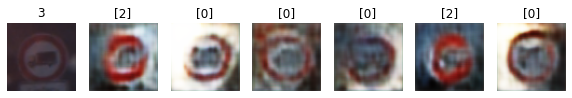

Epoch 12610 g_loss= 1.4473009 d_loss= 0.33849242 real_acc= 0.9 fake_acc= 0.84
Epoch 12620 g_loss= 1.5714829 d_loss= 0.32213563 real_acc= 0.92 fake_acc= 0.86
Epoch 12630 g_loss= 1.6505258 d_loss= 0.37481493 real_acc= 0.82 fake_acc= 0.88
Epoch 12640 g_loss= 1.7607869 d_loss= 0.34716257 real_acc= 0.84 fake_acc= 0.92
Epoch 12650 g_loss= 1.416343 d_loss= 0.36003506 real_acc= 0.86 fake_acc= 0.9
Epoch 12660 g_loss= 1.3383652 d_loss= 0.29480398 real_acc= 0.98 fake_acc= 0.82
Epoch 12670 g_loss= 1.3676513 d_loss= 0.30951697 real_acc= 0.94 fake_acc= 0.82
Epoch 12680 g_loss= 1.5796425 d_loss= 0.30411762 real_acc= 0.92 fake_acc= 0.92
Epoch 12690 g_loss= 1.8913531 d_loss= 0.3171385 real_acc= 0.84 fake_acc= 0.92
Epoch 12700 g_loss= 1.7325913 d_loss= 0.3146801 real_acc= 0.88 fake_acc= 0.92


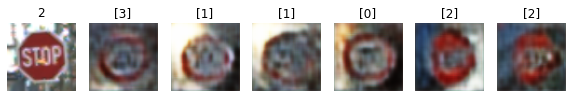

Epoch 12710 g_loss= 1.3898039 d_loss= 0.34620193 real_acc= 0.86 fake_acc= 0.86
Epoch 12720 g_loss= 1.5782377 d_loss= 0.3205821 real_acc= 0.86 fake_acc= 0.9
Epoch 12730 g_loss= 1.7491809 d_loss= 0.29688996 real_acc= 0.94 fake_acc= 0.98
Epoch 12740 g_loss= 1.3976109 d_loss= 0.36781538 real_acc= 0.94 fake_acc= 0.74
Epoch 12750 g_loss= 1.5447736 d_loss= 0.30915886 real_acc= 0.92 fake_acc= 0.92
Epoch 12760 g_loss= 1.5597887 d_loss= 0.3869744 real_acc= 0.82 fake_acc= 0.82
Epoch 12770 g_loss= 1.530765 d_loss= 0.34948152 real_acc= 0.84 fake_acc= 0.86
Epoch 12780 g_loss= 2.1167727 d_loss= 0.299702 real_acc= 0.84 fake_acc= 1.0
Epoch 12790 g_loss= 1.8529247 d_loss= 0.314074 real_acc= 0.86 fake_acc= 0.92
Epoch 12800 g_loss= 1.0817369 d_loss= 0.4113981 real_acc= 0.92 fake_acc= 0.68


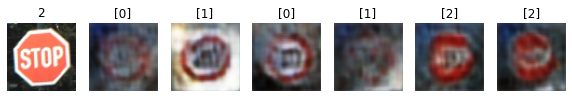

Epoch 12810 g_loss= 1.4909568 d_loss= 0.30974573 real_acc= 0.96 fake_acc= 0.88
Epoch 12820 g_loss= 2.148898 d_loss= 0.23547459 real_acc= 0.94 fake_acc= 1.0
Epoch 12830 g_loss= 2.0072956 d_loss= 0.38356844 real_acc= 0.74 fake_acc= 0.96
Epoch 12840 g_loss= 1.8356737 d_loss= 0.2950834 real_acc= 0.9 fake_acc= 0.96
Epoch 12850 g_loss= 1.5355043 d_loss= 0.32626104 real_acc= 0.88 fake_acc= 0.88
Epoch 12860 g_loss= 1.9341785 d_loss= 0.33695596 real_acc= 0.82 fake_acc= 1.0
Epoch 12870 g_loss= 1.7344992 d_loss= 0.2957714 real_acc= 0.94 fake_acc= 0.92
Epoch 12880 g_loss= 1.9000682 d_loss= 0.38673598 real_acc= 0.76 fake_acc= 0.92
Epoch 12890 g_loss= 1.7385846 d_loss= 0.29011977 real_acc= 0.92 fake_acc= 0.98
Epoch 12900 g_loss= 1.5243211 d_loss= 0.30433965 real_acc= 0.9 fake_acc= 0.9


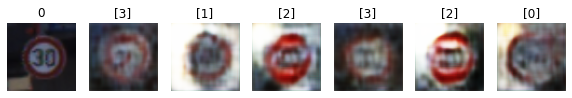

Epoch 12910 g_loss= 1.6532136 d_loss= 0.33046895 real_acc= 0.86 fake_acc= 0.88
Epoch 12920 g_loss= 1.7342469 d_loss= 0.31946987 real_acc= 0.9 fake_acc= 0.92
Epoch 12930 g_loss= 1.6462215 d_loss= 0.28776374 real_acc= 0.96 fake_acc= 0.9
Epoch 12940 g_loss= 1.6924618 d_loss= 0.34595078 real_acc= 0.86 fake_acc= 0.92
Epoch 12950 g_loss= 1.7714615 d_loss= 0.31507546 real_acc= 0.9 fake_acc= 0.96
Epoch 12960 g_loss= 1.695538 d_loss= 0.410044 real_acc= 0.7 fake_acc= 0.96
Epoch 12970 g_loss= 1.6238018 d_loss= 0.3349591 real_acc= 0.86 fake_acc= 0.94
Epoch 12980 g_loss= 1.1034266 d_loss= 0.3791537 real_acc= 0.94 fake_acc= 0.64
Epoch 12990 g_loss= 1.9884148 d_loss= 0.30696434 real_acc= 0.88 fake_acc= 0.92
Epoch 13000 g_loss= 1.958433 d_loss= 0.35597682 real_acc= 0.8 fake_acc= 0.98


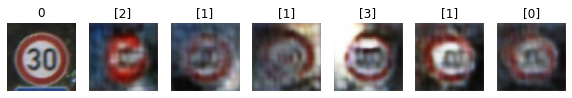

Epoch 13010 g_loss= 2.1354368 d_loss= 0.3266271 real_acc= 0.82 fake_acc= 0.96
Epoch 13020 g_loss= 1.9877003 d_loss= 0.32871637 real_acc= 0.8 fake_acc= 1.0
Epoch 13030 g_loss= 1.7557912 d_loss= 0.40898797 real_acc= 0.76 fake_acc= 0.9
Epoch 13040 g_loss= 1.565846 d_loss= 0.31315675 real_acc= 0.88 fake_acc= 0.92
Epoch 13050 g_loss= 1.3585893 d_loss= 0.3552824 real_acc= 0.94 fake_acc= 0.8
Epoch 13060 g_loss= 1.5687336 d_loss= 0.32771656 real_acc= 0.94 fake_acc= 0.86
Epoch 13070 g_loss= 1.9002259 d_loss= 0.3512662 real_acc= 0.78 fake_acc= 0.98
Epoch 13080 g_loss= 1.7605361 d_loss= 0.28614622 real_acc= 0.92 fake_acc= 0.92
Epoch 13090 g_loss= 1.6232932 d_loss= 0.29332262 real_acc= 0.94 fake_acc= 0.88
Epoch 13100 g_loss= 1.6124489 d_loss= 0.33405486 real_acc= 0.88 fake_acc= 0.9


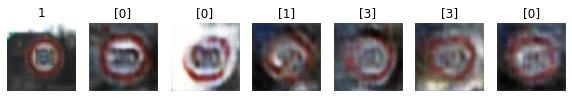

Epoch 13110 g_loss= 1.8187053 d_loss= 0.329013 real_acc= 0.78 fake_acc= 0.94
Epoch 13120 g_loss= 2.1273158 d_loss= 0.32530928 real_acc= 0.74 fake_acc= 1.0
Epoch 13130 g_loss= 1.8921698 d_loss= 0.35868576 real_acc= 0.74 fake_acc= 0.96
Epoch 13140 g_loss= 1.515618 d_loss= 0.30539834 real_acc= 0.94 fake_acc= 0.86
Epoch 13150 g_loss= 1.4991982 d_loss= 0.3558033 real_acc= 0.88 fake_acc= 0.8
Epoch 13160 g_loss= 1.5171747 d_loss= 0.29980636 real_acc= 0.94 fake_acc= 0.88
Epoch 13170 g_loss= 1.8746138 d_loss= 0.27891344 real_acc= 0.94 fake_acc= 0.88
Epoch 13180 g_loss= 1.8894625 d_loss= 0.30333483 real_acc= 0.88 fake_acc= 0.94
Epoch 13190 g_loss= 1.6035705 d_loss= 0.34615874 real_acc= 0.86 fake_acc= 0.88
Epoch 13200 g_loss= 1.8878397 d_loss= 0.30451763 real_acc= 0.9 fake_acc= 0.94


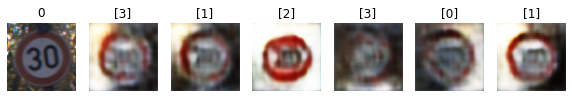

Epoch 13210 g_loss= 1.8500706 d_loss= 0.30275553 real_acc= 0.9 fake_acc= 0.98
Epoch 13220 g_loss= 1.4331688 d_loss= 0.35070884 real_acc= 0.84 fake_acc= 0.9
Epoch 13230 g_loss= 1.4626181 d_loss= 0.3435375 real_acc= 0.88 fake_acc= 0.82
Epoch 13240 g_loss= 1.4907761 d_loss= 0.34466177 real_acc= 0.88 fake_acc= 0.9
Epoch 13250 g_loss= 1.6014428 d_loss= 0.35486704 real_acc= 0.78 fake_acc= 0.92
Epoch 13260 g_loss= 1.6490229 d_loss= 0.30499506 real_acc= 0.94 fake_acc= 0.9
Epoch 13270 g_loss= 1.6394281 d_loss= 0.31557107 real_acc= 0.92 fake_acc= 0.88
Epoch 13280 g_loss= 1.450948 d_loss= 0.29087138 real_acc= 0.96 fake_acc= 0.92
Epoch 13290 g_loss= 1.5266145 d_loss= 0.3339104 real_acc= 0.84 fake_acc= 0.86
Epoch 13300 g_loss= 1.7098919 d_loss= 0.28898108 real_acc= 0.88 fake_acc= 0.94


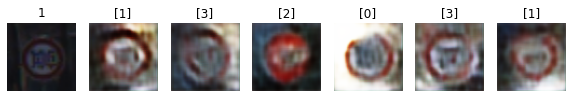

Epoch 13310 g_loss= 1.7774843 d_loss= 0.31297472 real_acc= 0.9 fake_acc= 0.92
Epoch 13320 g_loss= 2.0924206 d_loss= 0.32664496 real_acc= 0.76 fake_acc= 1.0
Epoch 13330 g_loss= 2.146765 d_loss= 0.34091154 real_acc= 0.82 fake_acc= 0.98
Epoch 13340 g_loss= 1.3825467 d_loss= 0.3773179 real_acc= 0.92 fake_acc= 0.8
Epoch 13350 g_loss= 1.3280535 d_loss= 0.36994123 real_acc= 0.9 fake_acc= 0.78
Epoch 13360 g_loss= 1.3214288 d_loss= 0.3316028 real_acc= 0.92 fake_acc= 0.82
Epoch 13370 g_loss= 1.6893116 d_loss= 0.2981183 real_acc= 0.94 fake_acc= 0.92
Epoch 13380 g_loss= 1.6032453 d_loss= 0.33122802 real_acc= 0.88 fake_acc= 0.92
Epoch 13390 g_loss= 1.8068982 d_loss= 0.3162822 real_acc= 0.82 fake_acc= 0.94
Epoch 13400 g_loss= 1.6578321 d_loss= 0.31902766 real_acc= 0.84 fake_acc= 0.92


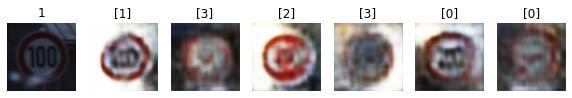

Epoch 13410 g_loss= 1.7675835 d_loss= 0.3200029 real_acc= 0.88 fake_acc= 0.96
Epoch 13420 g_loss= 1.5787668 d_loss= 0.37594917 real_acc= 0.82 fake_acc= 0.84
Epoch 13430 g_loss= 1.979959 d_loss= 0.32465816 real_acc= 0.74 fake_acc= 0.96
Epoch 13440 g_loss= 1.7276931 d_loss= 0.29784343 real_acc= 0.94 fake_acc= 0.88
Epoch 13450 g_loss= 1.6798842 d_loss= 0.34058797 real_acc= 0.88 fake_acc= 0.92
Epoch 13460 g_loss= 1.9515971 d_loss= 0.28356 real_acc= 0.9 fake_acc= 0.94
Epoch 13470 g_loss= 2.0466855 d_loss= 0.3244858 real_acc= 0.86 fake_acc= 0.94
Epoch 13480 g_loss= 1.3934578 d_loss= 0.33372116 real_acc= 0.92 fake_acc= 0.88
Epoch 13490 g_loss= 1.3802047 d_loss= 0.3807071 real_acc= 0.84 fake_acc= 0.86
Epoch 13500 g_loss= 1.8109261 d_loss= 0.27001506 real_acc= 0.84 fake_acc= 0.98


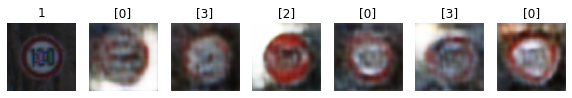

Epoch 13510 g_loss= 1.9385996 d_loss= 0.25620025 real_acc= 0.88 fake_acc= 0.96
Epoch 13520 g_loss= 1.9015044 d_loss= 0.23663919 real_acc= 0.92 fake_acc= 0.96
Epoch 13530 g_loss= 1.9197485 d_loss= 0.28509167 real_acc= 0.88 fake_acc= 1.0
Epoch 13540 g_loss= 1.7214698 d_loss= 0.299366 real_acc= 0.86 fake_acc= 0.98
Epoch 13550 g_loss= 1.6094103 d_loss= 0.26005542 real_acc= 0.94 fake_acc= 0.98
Epoch 13560 g_loss= 1.7970779 d_loss= 0.32554165 real_acc= 0.82 fake_acc= 0.94
Epoch 13570 g_loss= 1.8580266 d_loss= 0.25616947 real_acc= 0.94 fake_acc= 0.98
Epoch 13580 g_loss= 1.5156186 d_loss= 0.32296035 real_acc= 0.88 fake_acc= 0.82
Epoch 13590 g_loss= 1.372419 d_loss= 0.31735715 real_acc= 0.96 fake_acc= 0.88
Epoch 13600 g_loss= 1.3627652 d_loss= 0.34220928 real_acc= 0.92 fake_acc= 0.88


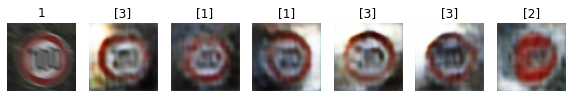

Epoch 13610 g_loss= 1.8653888 d_loss= 0.36349526 real_acc= 0.78 fake_acc= 1.0
Epoch 13620 g_loss= 1.7019697 d_loss= 0.29774195 real_acc= 0.86 fake_acc= 0.94
Epoch 13630 g_loss= 1.5263289 d_loss= 0.36007357 real_acc= 0.92 fake_acc= 0.84
Epoch 13640 g_loss= 1.5006468 d_loss= 0.28870448 real_acc= 0.96 fake_acc= 0.92
Epoch 13650 g_loss= 1.7512159 d_loss= 0.27566686 real_acc= 0.94 fake_acc= 0.92
Epoch 13660 g_loss= 1.5840733 d_loss= 0.28224304 real_acc= 0.88 fake_acc= 0.96
Epoch 13670 g_loss= 1.5913441 d_loss= 0.38719815 real_acc= 0.82 fake_acc= 0.82
Epoch 13680 g_loss= 1.362503 d_loss= 0.31727976 real_acc= 0.92 fake_acc= 0.92
Epoch 13690 g_loss= 1.5649322 d_loss= 0.33409807 real_acc= 0.86 fake_acc= 0.92
Epoch 13700 g_loss= 1.4129468 d_loss= 0.37585276 real_acc= 0.92 fake_acc= 0.8


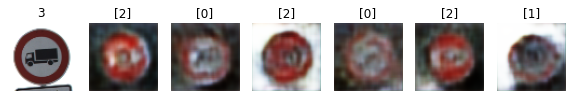

Epoch 13710 g_loss= 1.8100411 d_loss= 0.35069454 real_acc= 0.76 fake_acc= 0.92
Epoch 13720 g_loss= 1.8616707 d_loss= 0.3211577 real_acc= 0.84 fake_acc= 0.94
Epoch 13730 g_loss= 1.5669628 d_loss= 0.28690547 real_acc= 0.98 fake_acc= 0.86
Epoch 13740 g_loss= 1.548299 d_loss= 0.28860384 real_acc= 0.92 fake_acc= 0.9
Epoch 13750 g_loss= 1.8894993 d_loss= 0.3025892 real_acc= 0.9 fake_acc= 0.98
Epoch 13760 g_loss= 1.4505703 d_loss= 0.32434234 real_acc= 0.92 fake_acc= 0.86
Epoch 13770 g_loss= 1.6183238 d_loss= 0.3634615 real_acc= 0.84 fake_acc= 0.9
Epoch 13780 g_loss= 1.6402504 d_loss= 0.3276592 real_acc= 0.88 fake_acc= 0.84
Epoch 13790 g_loss= 1.3996625 d_loss= 0.3153117 real_acc= 0.94 fake_acc= 0.86
Epoch 13800 g_loss= 1.6938051 d_loss= 0.29810977 real_acc= 0.92 fake_acc= 0.9


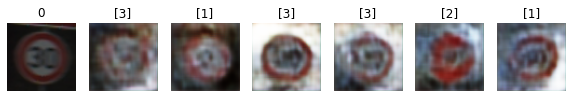

Epoch 13810 g_loss= 1.8669018 d_loss= 0.35849404 real_acc= 0.8 fake_acc= 0.88
Epoch 13820 g_loss= 1.6922197 d_loss= 0.29733443 real_acc= 0.94 fake_acc= 0.94
Epoch 13830 g_loss= 1.964646 d_loss= 0.25945884 real_acc= 0.92 fake_acc= 0.96
Epoch 13840 g_loss= 1.4709526 d_loss= 0.35711658 real_acc= 0.88 fake_acc= 0.86
Epoch 13850 g_loss= 1.4540963 d_loss= 0.30514196 real_acc= 0.96 fake_acc= 0.9
Epoch 13860 g_loss= 1.4854879 d_loss= 0.33611357 real_acc= 0.88 fake_acc= 0.84
Epoch 13870 g_loss= 1.8834118 d_loss= 0.28606087 real_acc= 0.88 fake_acc= 0.96
Epoch 13880 g_loss= 1.3411477 d_loss= 0.3320284 real_acc= 0.98 fake_acc= 0.84
Epoch 13890 g_loss= 1.8659198 d_loss= 0.33277842 real_acc= 0.8 fake_acc= 0.92
Epoch 13900 g_loss= 1.6016425 d_loss= 0.34201413 real_acc= 0.8 fake_acc= 0.88


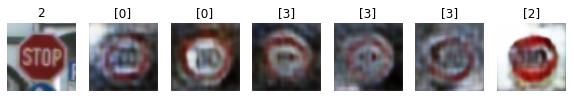

Epoch 13910 g_loss= 1.7666854 d_loss= 0.30374044 real_acc= 0.9 fake_acc= 0.98
Epoch 13920 g_loss= 1.5190376 d_loss= 0.27169982 real_acc= 0.94 fake_acc= 0.92
Epoch 13930 g_loss= 1.4193479 d_loss= 0.34427926 real_acc= 0.9 fake_acc= 0.84
Epoch 13940 g_loss= 1.6073891 d_loss= 0.26687825 real_acc= 0.96 fake_acc= 0.88
Epoch 13950 g_loss= 1.8002484 d_loss= 0.3649176 real_acc= 0.78 fake_acc= 0.94
Epoch 13960 g_loss= 2.0271184 d_loss= 0.29163066 real_acc= 0.84 fake_acc= 0.96
Epoch 13970 g_loss= 1.8570589 d_loss= 0.38528502 real_acc= 0.7 fake_acc= 0.94
Epoch 13980 g_loss= 1.8715158 d_loss= 0.32566193 real_acc= 0.78 fake_acc= 0.94
Epoch 13990 g_loss= 1.6915785 d_loss= 0.3349592 real_acc= 0.86 fake_acc= 0.94
Epoch 14000 g_loss= 1.6930766 d_loss= 0.28364366 real_acc= 0.96 fake_acc= 0.92


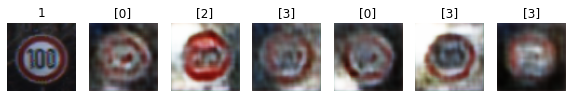

Epoch 14010 g_loss= 1.5711348 d_loss= 0.30775154 real_acc= 0.96 fake_acc= 0.94
Epoch 14020 g_loss= 1.5834994 d_loss= 0.30876017 real_acc= 0.88 fake_acc= 0.92
Epoch 14030 g_loss= 1.7588451 d_loss= 0.3306422 real_acc= 0.84 fake_acc= 0.92
Epoch 14040 g_loss= 1.7463903 d_loss= 0.2796582 real_acc= 0.86 fake_acc= 0.96
Epoch 14050 g_loss= 1.5138686 d_loss= 0.29148844 real_acc= 0.98 fake_acc= 0.88
Epoch 14060 g_loss= 1.338713 d_loss= 0.29432797 real_acc= 0.96 fake_acc= 0.94
Epoch 14070 g_loss= 1.6661406 d_loss= 0.3566767 real_acc= 0.88 fake_acc= 0.86
Epoch 14080 g_loss= 2.3339598 d_loss= 0.38636625 real_acc= 0.68 fake_acc= 0.98
Epoch 14090 g_loss= 1.7069368 d_loss= 0.30025482 real_acc= 0.9 fake_acc= 0.88
Epoch 14100 g_loss= 1.440421 d_loss= 0.27099064 real_acc= 0.98 fake_acc= 0.84


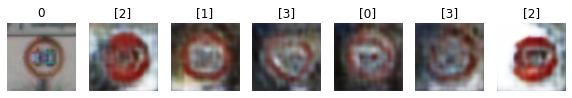

Epoch 14110 g_loss= 1.7370688 d_loss= 0.34076616 real_acc= 0.84 fake_acc= 0.9
Epoch 14120 g_loss= 1.512421 d_loss= 0.36845356 real_acc= 0.78 fake_acc= 0.9
Epoch 14130 g_loss= 1.485952 d_loss= 0.32142437 real_acc= 0.92 fake_acc= 0.86
Epoch 14140 g_loss= 1.8188663 d_loss= 0.33395922 real_acc= 0.84 fake_acc= 0.94
Epoch 14150 g_loss= 1.6405879 d_loss= 0.3487376 real_acc= 0.86 fake_acc= 0.82
Epoch 14160 g_loss= 2.4055798 d_loss= 0.312332 real_acc= 0.76 fake_acc= 1.0
Epoch 14170 g_loss= 1.4907745 d_loss= 0.3294078 real_acc= 0.92 fake_acc= 0.84
Epoch 14180 g_loss= 1.3769897 d_loss= 0.3155488 real_acc= 0.98 fake_acc= 0.76
Epoch 14190 g_loss= 1.8803453 d_loss= 0.2883105 real_acc= 0.88 fake_acc= 0.96
Epoch 14200 g_loss= 1.636114 d_loss= 0.36144644 real_acc= 0.84 fake_acc= 0.92


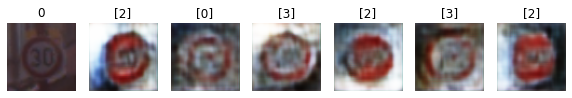

Epoch 14210 g_loss= 2.005488 d_loss= 0.3288147 real_acc= 0.78 fake_acc= 1.0
Epoch 14220 g_loss= 1.4303852 d_loss= 0.36665928 real_acc= 0.94 fake_acc= 0.8
Epoch 14230 g_loss= 1.6795236 d_loss= 0.32313228 real_acc= 0.88 fake_acc= 0.82
Epoch 14240 g_loss= 1.9415257 d_loss= 0.29183987 real_acc= 0.86 fake_acc= 0.98
Epoch 14250 g_loss= 2.008517 d_loss= 0.27113807 real_acc= 0.92 fake_acc= 1.0
Epoch 14260 g_loss= 1.702605 d_loss= 0.29738274 real_acc= 0.92 fake_acc= 0.9
Epoch 14270 g_loss= 1.699325 d_loss= 0.31326118 real_acc= 0.82 fake_acc= 0.9
Epoch 14280 g_loss= 1.625514 d_loss= 0.3289153 real_acc= 0.92 fake_acc= 0.88
Epoch 14290 g_loss= 1.4266307 d_loss= 0.34910136 real_acc= 0.9 fake_acc= 0.82
Epoch 14300 g_loss= 1.3439205 d_loss= 0.31401655 real_acc= 0.96 fake_acc= 0.86


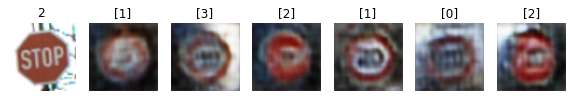

Epoch 14310 g_loss= 1.7061611 d_loss= 0.3217581 real_acc= 0.84 fake_acc= 0.96
Epoch 14320 g_loss= 2.1935282 d_loss= 0.4199851 real_acc= 0.62 fake_acc= 0.98
Epoch 14330 g_loss= 1.676942 d_loss= 0.32088113 real_acc= 0.88 fake_acc= 0.92
Epoch 14340 g_loss= 1.4830487 d_loss= 0.29633838 real_acc= 0.96 fake_acc= 0.86
Epoch 14350 g_loss= 1.5477097 d_loss= 0.29958963 real_acc= 0.94 fake_acc= 0.82
Epoch 14360 g_loss= 1.4662632 d_loss= 0.31442624 real_acc= 0.96 fake_acc= 0.9
Epoch 14370 g_loss= 1.9359491 d_loss= 0.30486447 real_acc= 0.88 fake_acc= 0.94
Epoch 14380 g_loss= 1.7360154 d_loss= 0.27990854 real_acc= 0.92 fake_acc= 0.88
Epoch 14390 g_loss= 2.4231641 d_loss= 0.3250818 real_acc= 0.8 fake_acc= 1.0
Epoch 14400 g_loss= 2.0825472 d_loss= 0.28119862 real_acc= 0.84 fake_acc= 1.0


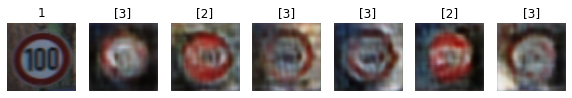

Epoch 14410 g_loss= 1.6842152 d_loss= 0.28662497 real_acc= 0.92 fake_acc= 0.9
Epoch 14420 g_loss= 1.6275287 d_loss= 0.30592638 real_acc= 0.86 fake_acc= 0.94
Epoch 14430 g_loss= 1.6892531 d_loss= 0.28336945 real_acc= 0.88 fake_acc= 0.9
Epoch 14440 g_loss= 1.4217656 d_loss= 0.31002966 real_acc= 0.92 fake_acc= 0.86
Epoch 14450 g_loss= 1.5352517 d_loss= 0.3662566 real_acc= 0.86 fake_acc= 0.78
Epoch 14460 g_loss= 1.7836571 d_loss= 0.27173147 real_acc= 0.92 fake_acc= 0.92
Epoch 14470 g_loss= 1.9069752 d_loss= 0.25759453 real_acc= 0.92 fake_acc= 0.92
Epoch 14480 g_loss= 2.0582838 d_loss= 0.21877855 real_acc= 0.92 fake_acc= 1.0
Epoch 14490 g_loss= 1.4505756 d_loss= 0.3256684 real_acc= 0.94 fake_acc= 0.86
Epoch 14500 g_loss= 1.900025 d_loss= 0.2923172 real_acc= 0.84 fake_acc= 0.92


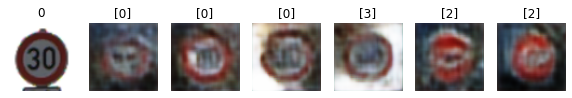

Epoch 14510 g_loss= 1.968059 d_loss= 0.28997657 real_acc= 0.88 fake_acc= 0.92
Epoch 14520 g_loss= 1.8847095 d_loss= 0.3058709 real_acc= 0.82 fake_acc= 0.94
Epoch 14530 g_loss= 1.5548201 d_loss= 0.31888688 real_acc= 0.88 fake_acc= 0.96
Epoch 14540 g_loss= 1.6317055 d_loss= 0.3946561 real_acc= 0.8 fake_acc= 0.9
Epoch 14550 g_loss= 1.372919 d_loss= 0.29637036 real_acc= 0.96 fake_acc= 0.84
Epoch 14560 g_loss= 1.6577666 d_loss= 0.31722987 real_acc= 0.9 fake_acc= 0.94
Epoch 14570 g_loss= 1.740913 d_loss= 0.28814477 real_acc= 0.96 fake_acc= 0.9
Epoch 14580 g_loss= 2.3558047 d_loss= 0.31883058 real_acc= 0.82 fake_acc= 0.96
Epoch 14590 g_loss= 1.9424244 d_loss= 0.30926982 real_acc= 0.8 fake_acc= 0.9
Epoch 14600 g_loss= 1.5272218 d_loss= 0.38530824 real_acc= 0.9 fake_acc= 0.78


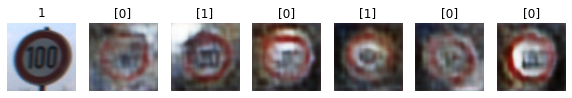

Epoch 14610 g_loss= 1.6514847 d_loss= 0.30824298 real_acc= 0.9 fake_acc= 0.94
Epoch 14620 g_loss= 1.9222085 d_loss= 0.31332773 real_acc= 0.9 fake_acc= 0.96
Epoch 14630 g_loss= 1.6821669 d_loss= 0.3098114 real_acc= 0.92 fake_acc= 0.92
Epoch 14640 g_loss= 1.5425174 d_loss= 0.34729868 real_acc= 0.92 fake_acc= 0.86
Epoch 14650 g_loss= 1.6251228 d_loss= 0.2343758 real_acc= 0.98 fake_acc= 0.96
Epoch 14660 g_loss= 1.9073923 d_loss= 0.3419516 real_acc= 0.82 fake_acc= 0.88
Epoch 14670 g_loss= 1.8869765 d_loss= 0.3383297 real_acc= 0.82 fake_acc= 0.94
Epoch 14680 g_loss= 2.1271038 d_loss= 0.3491273 real_acc= 0.76 fake_acc= 0.98
Epoch 14690 g_loss= 1.4082098 d_loss= 0.33646962 real_acc= 0.96 fake_acc= 0.82
Epoch 14700 g_loss= 1.6459053 d_loss= 0.2856217 real_acc= 0.92 fake_acc= 0.94


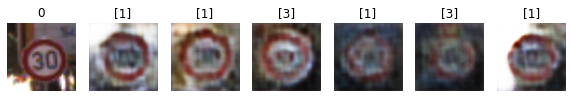

Epoch 14710 g_loss= 2.0203307 d_loss= 0.31068417 real_acc= 0.8 fake_acc= 0.92
Epoch 14720 g_loss= 2.0121493 d_loss= 0.3037847 real_acc= 0.8 fake_acc= 0.96
Epoch 14730 g_loss= 1.0951219 d_loss= 0.3498851 real_acc= 0.98 fake_acc= 0.68
Epoch 14740 g_loss= 1.3304417 d_loss= 0.31604916 real_acc= 0.98 fake_acc= 0.8
Epoch 14750 g_loss= 1.3173732 d_loss= 0.29971477 real_acc= 0.98 fake_acc= 0.86
Epoch 14760 g_loss= 1.654046 d_loss= 0.3270635 real_acc= 0.88 fake_acc= 0.9
Epoch 14770 g_loss= 2.0822124 d_loss= 0.34672457 real_acc= 0.82 fake_acc= 0.92
Epoch 14780 g_loss= 1.8680215 d_loss= 0.27821738 real_acc= 0.88 fake_acc= 0.94
Epoch 14790 g_loss= 1.9211609 d_loss= 0.31625253 real_acc= 0.86 fake_acc= 0.96
Epoch 14800 g_loss= 1.9544617 d_loss= 0.31379712 real_acc= 0.82 fake_acc= 0.92


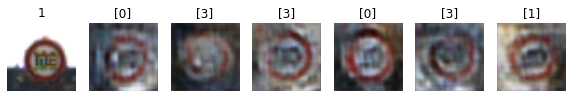

Epoch 14810 g_loss= 1.6027049 d_loss= 0.33393148 real_acc= 0.8 fake_acc= 0.86
Epoch 14820 g_loss= 1.9764639 d_loss= 0.3455709 real_acc= 0.72 fake_acc= 1.0
Epoch 14830 g_loss= 1.8329568 d_loss= 0.2610873 real_acc= 0.9 fake_acc= 0.96
Epoch 14840 g_loss= 1.9471962 d_loss= 0.27941394 real_acc= 0.88 fake_acc= 0.96
Epoch 14850 g_loss= 2.0110924 d_loss= 0.2872994 real_acc= 0.82 fake_acc= 0.96
Epoch 14860 g_loss= 1.5405437 d_loss= 0.3468436 real_acc= 0.84 fake_acc= 0.76
Epoch 14870 g_loss= 1.5343742 d_loss= 0.2959083 real_acc= 0.9 fake_acc= 0.86
Epoch 14880 g_loss= 2.096481 d_loss= 0.23707703 real_acc= 0.96 fake_acc= 0.94
Epoch 14890 g_loss= 2.1964712 d_loss= 0.2676084 real_acc= 0.86 fake_acc= 0.98
Epoch 14900 g_loss= 2.0572536 d_loss= 0.27874416 real_acc= 0.86 fake_acc= 0.96


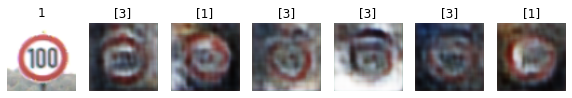

Epoch 14910 g_loss= 1.9841124 d_loss= 0.3158779 real_acc= 0.82 fake_acc= 0.92
Epoch 14920 g_loss= 1.6504447 d_loss= 0.3170678 real_acc= 0.84 fake_acc= 0.88
Epoch 14930 g_loss= 1.3474623 d_loss= 0.31598863 real_acc= 0.98 fake_acc= 0.84
Epoch 14940 g_loss= 1.8152653 d_loss= 0.26419252 real_acc= 0.9 fake_acc= 0.9
Epoch 14950 g_loss= 1.6018693 d_loss= 0.33531108 real_acc= 0.86 fake_acc= 0.94
Epoch 14960 g_loss= 1.6004267 d_loss= 0.32216233 real_acc= 0.92 fake_acc= 0.86
Epoch 14970 g_loss= 1.7954738 d_loss= 0.2602231 real_acc= 0.94 fake_acc= 0.92
Epoch 14980 g_loss= 1.7957225 d_loss= 0.2727931 real_acc= 0.94 fake_acc= 0.9
Epoch 14990 g_loss= 1.5736977 d_loss= 0.28216904 real_acc= 0.94 fake_acc= 0.94
Epoch 15000 g_loss= 1.657958 d_loss= 0.28451157 real_acc= 0.94 fake_acc= 0.92


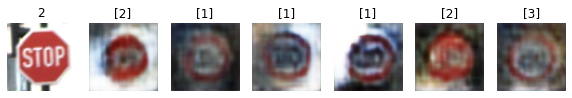

Epoch 15010 g_loss= 1.9615571 d_loss= 0.32537943 real_acc= 0.86 fake_acc= 0.96
Epoch 15020 g_loss= 1.948439 d_loss= 0.2573415 real_acc= 0.94 fake_acc= 0.96
Epoch 15030 g_loss= 2.0687492 d_loss= 0.27321467 real_acc= 0.84 fake_acc= 1.0
Epoch 15040 g_loss= 1.6662351 d_loss= 0.26320848 real_acc= 0.98 fake_acc= 0.88
Epoch 15050 g_loss= 1.567483 d_loss= 0.32899332 real_acc= 0.84 fake_acc= 0.88
Epoch 15060 g_loss= 2.3128839 d_loss= 0.29905105 real_acc= 0.8 fake_acc= 0.98
Epoch 15070 g_loss= 1.6899432 d_loss= 0.2982845 real_acc= 0.9 fake_acc= 0.92
Epoch 15080 g_loss= 1.5727401 d_loss= 0.31296694 real_acc= 0.94 fake_acc= 0.88
Epoch 15090 g_loss= 1.5783104 d_loss= 0.32379913 real_acc= 0.92 fake_acc= 0.92
Epoch 15100 g_loss= 2.1064732 d_loss= 0.22873023 real_acc= 0.92 fake_acc= 0.98


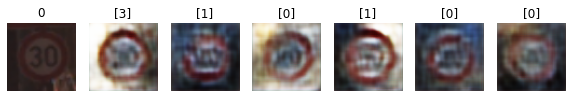

Epoch 15110 g_loss= 1.8059016 d_loss= 0.20951986 real_acc= 0.98 fake_acc= 0.92
Epoch 15120 g_loss= 1.6841176 d_loss= 0.2728807 real_acc= 0.92 fake_acc= 0.92
Epoch 15130 g_loss= 1.8912054 d_loss= 0.31509584 real_acc= 0.86 fake_acc= 0.86
Epoch 15140 g_loss= 1.4968648 d_loss= 0.29015154 real_acc= 0.96 fake_acc= 0.94
Epoch 15150 g_loss= 2.477874 d_loss= 0.28181127 real_acc= 0.76 fake_acc= 1.0
Epoch 15160 g_loss= 1.7760646 d_loss= 0.30575532 real_acc= 0.88 fake_acc= 0.94
Epoch 15170 g_loss= 1.7164547 d_loss= 0.26428357 real_acc= 0.9 fake_acc= 0.92
Epoch 15180 g_loss= 1.9031684 d_loss= 0.26626554 real_acc= 0.88 fake_acc= 0.92
Epoch 15190 g_loss= 2.3741121 d_loss= 0.28476006 real_acc= 0.82 fake_acc= 0.98
Epoch 15200 g_loss= 1.8516346 d_loss= 0.26588002 real_acc= 0.96 fake_acc= 0.9


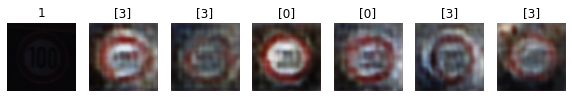

Epoch 15210 g_loss= 1.479276 d_loss= 0.3300854 real_acc= 0.9 fake_acc= 0.78
Epoch 15220 g_loss= 1.6346138 d_loss= 0.37841144 real_acc= 0.82 fake_acc= 0.88
Epoch 15230 g_loss= 2.1013076 d_loss= 0.26866788 real_acc= 0.86 fake_acc= 0.94
Epoch 15240 g_loss= 1.7826958 d_loss= 0.3261368 real_acc= 0.86 fake_acc= 0.94
Epoch 15250 g_loss= 1.7976679 d_loss= 0.27982444 real_acc= 0.94 fake_acc= 0.88
Epoch 15260 g_loss= 2.0592415 d_loss= 0.29458588 real_acc= 0.84 fake_acc= 0.96
Epoch 15270 g_loss= 1.6759294 d_loss= 0.27913252 real_acc= 0.88 fake_acc= 0.86
Epoch 15280 g_loss= 1.6824973 d_loss= 0.28391206 real_acc= 0.94 fake_acc= 0.88
Epoch 15290 g_loss= 2.008744 d_loss= 0.2962953 real_acc= 0.9 fake_acc= 0.92
Epoch 15300 g_loss= 1.9255974 d_loss= 0.2510578 real_acc= 0.9 fake_acc= 0.96


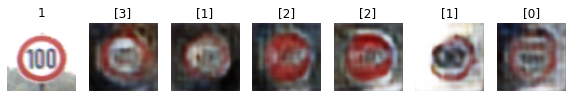

Epoch 15310 g_loss= 2.2079444 d_loss= 0.30844232 real_acc= 0.84 fake_acc= 0.94
Epoch 15320 g_loss= 1.8902527 d_loss= 0.26241776 real_acc= 0.92 fake_acc= 0.98
Epoch 15330 g_loss= 1.762873 d_loss= 0.34143507 real_acc= 0.88 fake_acc= 0.86
Epoch 15340 g_loss= 2.1143928 d_loss= 0.27165267 real_acc= 0.82 fake_acc= 1.0
Epoch 15350 g_loss= 1.8158689 d_loss= 0.2980118 real_acc= 0.82 fake_acc= 0.98
Epoch 15360 g_loss= 2.0587764 d_loss= 0.3188789 real_acc= 0.8 fake_acc= 0.94
Epoch 15370 g_loss= 2.055029 d_loss= 0.25959897 real_acc= 0.9 fake_acc= 1.0
Epoch 15380 g_loss= 1.6966128 d_loss= 0.29362082 real_acc= 0.86 fake_acc= 0.96
Epoch 15390 g_loss= 1.8235708 d_loss= 0.30871108 real_acc= 0.9 fake_acc= 0.98
Epoch 15400 g_loss= 1.6955595 d_loss= 0.2790771 real_acc= 0.92 fake_acc= 0.9


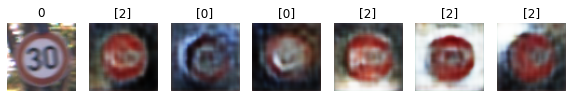

Epoch 15410 g_loss= 1.8525319 d_loss= 0.26190656 real_acc= 0.88 fake_acc= 0.94
Epoch 15420 g_loss= 1.6159389 d_loss= 0.30769312 real_acc= 0.9 fake_acc= 0.9
Epoch 15430 g_loss= 1.5618532 d_loss= 0.31461406 real_acc= 0.9 fake_acc= 0.86
Epoch 15440 g_loss= 1.8060927 d_loss= 0.26681367 real_acc= 0.94 fake_acc= 0.94
Epoch 15450 g_loss= 1.7749579 d_loss= 0.29271394 real_acc= 0.94 fake_acc= 0.9
Epoch 15460 g_loss= 1.6509229 d_loss= 0.2662857 real_acc= 0.98 fake_acc= 0.92
Epoch 15470 g_loss= 1.6932842 d_loss= 0.33608922 real_acc= 0.88 fake_acc= 0.9
Epoch 15480 g_loss= 2.1803472 d_loss= 0.2954387 real_acc= 0.86 fake_acc= 0.96
Epoch 15490 g_loss= 1.9566967 d_loss= 0.29721254 real_acc= 0.88 fake_acc= 0.98
Epoch 15500 g_loss= 2.413786 d_loss= 0.30268958 real_acc= 0.8 fake_acc= 1.0


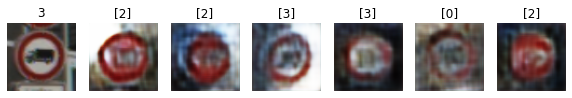

Epoch 15510 g_loss= 2.0631576 d_loss= 0.28703606 real_acc= 0.84 fake_acc= 1.0
Epoch 15520 g_loss= 1.435874 d_loss= 0.2945336 real_acc= 0.96 fake_acc= 0.8
Epoch 15530 g_loss= 2.1299691 d_loss= 0.28376144 real_acc= 0.84 fake_acc= 0.98
Epoch 15540 g_loss= 2.3250127 d_loss= 0.27280742 real_acc= 0.8 fake_acc= 0.96
Epoch 15550 g_loss= 1.9985124 d_loss= 0.26884174 real_acc= 0.88 fake_acc= 0.96
Epoch 15560 g_loss= 1.9071056 d_loss= 0.2809492 real_acc= 0.92 fake_acc= 0.9
Epoch 15570 g_loss= 1.7269024 d_loss= 0.2463586 real_acc= 0.94 fake_acc= 0.94
Epoch 15580 g_loss= 1.7511598 d_loss= 0.2884521 real_acc= 0.9 fake_acc= 0.9
Epoch 15590 g_loss= 1.3322952 d_loss= 0.30728042 real_acc= 0.98 fake_acc= 0.86
Epoch 15600 g_loss= 1.7007003 d_loss= 0.3680956 real_acc= 0.88 fake_acc= 0.86


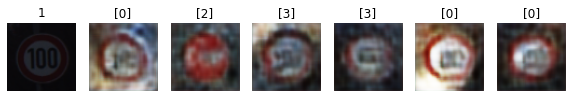

Epoch 15610 g_loss= 1.685602 d_loss= 0.32722184 real_acc= 0.88 fake_acc= 0.92
Epoch 15620 g_loss= 1.9948822 d_loss= 0.23984128 real_acc= 0.9 fake_acc= 0.94
Epoch 15630 g_loss= 1.8009824 d_loss= 0.27478477 real_acc= 0.92 fake_acc= 0.92
Epoch 15640 g_loss= 1.7027316 d_loss= 0.27338427 real_acc= 0.92 fake_acc= 0.86
Epoch 15650 g_loss= 1.8196626 d_loss= 0.30811825 real_acc= 0.88 fake_acc= 0.9
Epoch 15660 g_loss= 1.9772071 d_loss= 0.28105384 real_acc= 0.86 fake_acc= 0.92
Epoch 15670 g_loss= 1.9463449 d_loss= 0.23837408 real_acc= 0.98 fake_acc= 1.0
Epoch 15680 g_loss= 1.5709807 d_loss= 0.26380172 real_acc= 0.98 fake_acc= 0.9
Epoch 15690 g_loss= 1.9788296 d_loss= 0.3061303 real_acc= 0.88 fake_acc= 0.98
Epoch 15700 g_loss= 1.9579494 d_loss= 0.24087034 real_acc= 0.94 fake_acc= 0.96


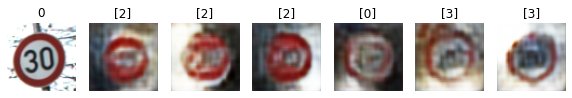

Epoch 15710 g_loss= 1.4523815 d_loss= 0.3167467 real_acc= 0.96 fake_acc= 0.84
Epoch 15720 g_loss= 1.8177212 d_loss= 0.22605142 real_acc= 0.96 fake_acc= 0.94
Epoch 15730 g_loss= 2.0753095 d_loss= 0.24526615 real_acc= 0.94 fake_acc= 0.96
Epoch 15740 g_loss= 2.0025835 d_loss= 0.2808411 real_acc= 0.86 fake_acc= 0.98
Epoch 15750 g_loss= 1.4750164 d_loss= 0.262401 real_acc= 0.98 fake_acc= 0.88
Epoch 15760 g_loss= 2.1043587 d_loss= 0.26811543 real_acc= 0.92 fake_acc= 0.94
Epoch 15770 g_loss= 2.319908 d_loss= 0.32518056 real_acc= 0.82 fake_acc= 1.0
Epoch 15780 g_loss= 1.967679 d_loss= 0.22577411 real_acc= 0.96 fake_acc= 0.92
Epoch 15790 g_loss= 1.6239123 d_loss= 0.2930961 real_acc= 0.92 fake_acc= 0.86
Epoch 15800 g_loss= 1.4206997 d_loss= 0.31111398 real_acc= 0.94 fake_acc= 0.82


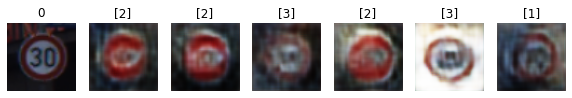

Epoch 15810 g_loss= 1.9505248 d_loss= 0.29826987 real_acc= 0.84 fake_acc= 0.98
Epoch 15820 g_loss= 2.1975312 d_loss= 0.2695427 real_acc= 0.86 fake_acc= 0.96
Epoch 15830 g_loss= 2.210394 d_loss= 0.23931253 real_acc= 0.9 fake_acc= 0.96
Epoch 15840 g_loss= 1.8913394 d_loss= 0.29657486 real_acc= 0.84 fake_acc= 0.94
Epoch 15850 g_loss= 2.2114806 d_loss= 0.27511054 real_acc= 0.84 fake_acc= 0.98
Epoch 15860 g_loss= 1.726988 d_loss= 0.2661321 real_acc= 0.92 fake_acc= 0.9
Epoch 15870 g_loss= 1.8343288 d_loss= 0.2636603 real_acc= 0.88 fake_acc= 0.98
Epoch 15880 g_loss= 1.7302743 d_loss= 0.27980965 real_acc= 0.92 fake_acc= 0.96
Epoch 15890 g_loss= 2.004821 d_loss= 0.26494008 real_acc= 0.84 fake_acc= 0.94
Epoch 15900 g_loss= 2.1546013 d_loss= 0.2705062 real_acc= 0.92 fake_acc= 0.94


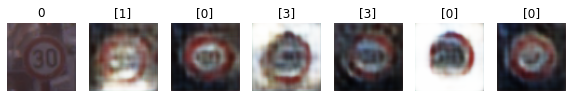

Epoch 15910 g_loss= 2.538269 d_loss= 0.29252392 real_acc= 0.76 fake_acc= 1.0
Epoch 15920 g_loss= 2.0169635 d_loss= 0.25992724 real_acc= 0.9 fake_acc= 0.98
Epoch 15930 g_loss= 1.325234 d_loss= 0.32839513 real_acc= 0.96 fake_acc= 0.8
Epoch 15940 g_loss= 1.5863038 d_loss= 0.28683835 real_acc= 0.96 fake_acc= 0.92
Epoch 15950 g_loss= 1.7463708 d_loss= 0.38116664 real_acc= 0.86 fake_acc= 0.86
Epoch 15960 g_loss= 1.9685651 d_loss= 0.26801622 real_acc= 0.94 fake_acc= 0.92
Epoch 15970 g_loss= 1.4250093 d_loss= 0.33593342 real_acc= 0.88 fake_acc= 0.84
Epoch 15980 g_loss= 1.1680892 d_loss= 0.35087442 real_acc= 0.94 fake_acc= 0.78
Epoch 15990 g_loss= 1.7868965 d_loss= 0.39257836 real_acc= 0.84 fake_acc= 0.92
Epoch 16000 g_loss= 1.7638931 d_loss= 0.25625908 real_acc= 0.96 fake_acc= 0.9


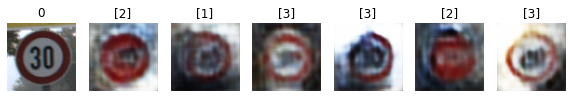

Epoch 16010 g_loss= 1.6926224 d_loss= 0.29431403 real_acc= 0.92 fake_acc= 0.86
Epoch 16020 g_loss= 2.042477 d_loss= 0.26572186 real_acc= 0.9 fake_acc= 0.94
Epoch 16030 g_loss= 1.7052058 d_loss= 0.25933382 real_acc= 0.96 fake_acc= 0.9
Epoch 16040 g_loss= 1.815448 d_loss= 0.23469049 real_acc= 0.96 fake_acc= 0.96
Epoch 16050 g_loss= 1.8642259 d_loss= 0.2538924 real_acc= 0.92 fake_acc= 0.98
Epoch 16060 g_loss= 1.8923317 d_loss= 0.26999575 real_acc= 0.94 fake_acc= 0.92
Epoch 16070 g_loss= 1.4227234 d_loss= 0.31119257 real_acc= 0.92 fake_acc= 0.88
Epoch 16080 g_loss= 2.0163817 d_loss= 0.29164678 real_acc= 0.86 fake_acc= 1.0
Epoch 16090 g_loss= 1.7069701 d_loss= 0.29097995 real_acc= 0.96 fake_acc= 0.88
Epoch 16100 g_loss= 2.063803 d_loss= 0.25639933 real_acc= 0.9 fake_acc= 0.96


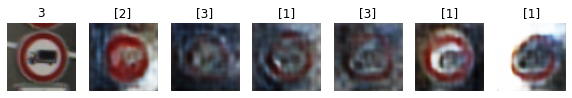

Epoch 16110 g_loss= 2.1964953 d_loss= 0.30876762 real_acc= 0.82 fake_acc= 1.0
Epoch 16120 g_loss= 1.7494391 d_loss= 0.31707782 real_acc= 0.84 fake_acc= 0.9
Epoch 16130 g_loss= 1.8591596 d_loss= 0.33350796 real_acc= 0.84 fake_acc= 0.94
Epoch 16140 g_loss= 1.8352044 d_loss= 0.24829182 real_acc= 0.9 fake_acc= 0.96
Epoch 16150 g_loss= 1.4036074 d_loss= 0.31223723 real_acc= 0.94 fake_acc= 0.82
Epoch 16160 g_loss= 2.1647031 d_loss= 0.25311553 real_acc= 0.88 fake_acc= 0.98
Epoch 16170 g_loss= 1.9946934 d_loss= 0.37454927 real_acc= 0.78 fake_acc= 0.9
Epoch 16180 g_loss= 1.93913 d_loss= 0.28208524 real_acc= 0.9 fake_acc= 0.98
Epoch 16190 g_loss= 2.048377 d_loss= 0.27733532 real_acc= 0.9 fake_acc= 1.0
Epoch 16200 g_loss= 1.9034268 d_loss= 0.28472456 real_acc= 0.88 fake_acc= 0.96


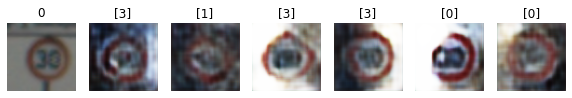

Epoch 16210 g_loss= 1.878826 d_loss= 0.2470752 real_acc= 0.94 fake_acc= 0.9
Epoch 16220 g_loss= 1.5425321 d_loss= 0.31349644 real_acc= 0.92 fake_acc= 0.86
Epoch 16230 g_loss= 1.6645272 d_loss= 0.27264887 real_acc= 0.92 fake_acc= 0.9
Epoch 16240 g_loss= 1.5999523 d_loss= 0.29770023 real_acc= 0.94 fake_acc= 0.88
Epoch 16250 g_loss= 1.6794524 d_loss= 0.28633672 real_acc= 0.92 fake_acc= 0.9
Epoch 16260 g_loss= 1.9060957 d_loss= 0.277328 real_acc= 0.78 fake_acc= 0.98
Epoch 16270 g_loss= 1.6610337 d_loss= 0.26695636 real_acc= 0.96 fake_acc= 0.84
Epoch 16280 g_loss= 1.477872 d_loss= 0.32049313 real_acc= 0.9 fake_acc= 0.82
Epoch 16290 g_loss= 1.7609242 d_loss= 0.3219661 real_acc= 0.9 fake_acc= 0.78
Epoch 16300 g_loss= 1.5324107 d_loss= 0.24734679 real_acc= 1.0 fake_acc= 0.84


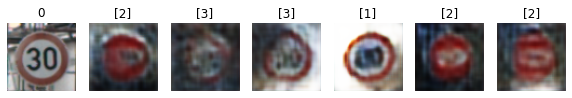

Epoch 16310 g_loss= 1.6914467 d_loss= 0.28400666 real_acc= 0.92 fake_acc= 0.94
Epoch 16320 g_loss= 1.7061397 d_loss= 0.28437734 real_acc= 0.86 fake_acc= 0.98
Epoch 16330 g_loss= 1.5228887 d_loss= 0.3388785 real_acc= 0.9 fake_acc= 0.86
Epoch 16340 g_loss= 1.7763745 d_loss= 0.2593041 real_acc= 0.92 fake_acc= 0.96
Epoch 16350 g_loss= 1.6542293 d_loss= 0.2606383 real_acc= 1.0 fake_acc= 0.92
Epoch 16360 g_loss= 2.2048445 d_loss= 0.3102987 real_acc= 0.8 fake_acc= 1.0
Epoch 16370 g_loss= 2.0522578 d_loss= 0.29027784 real_acc= 0.86 fake_acc= 0.94
Epoch 16380 g_loss= 1.5769197 d_loss= 0.26988083 real_acc= 1.0 fake_acc= 0.84
Epoch 16390 g_loss= 1.930766 d_loss= 0.2665854 real_acc= 0.88 fake_acc= 0.98
Epoch 16400 g_loss= 1.8508751 d_loss= 0.31535053 real_acc= 0.9 fake_acc= 0.96


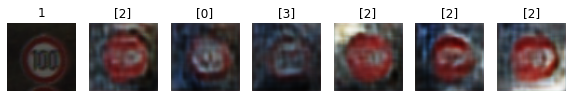

Epoch 16410 g_loss= 1.7427733 d_loss= 0.27923104 real_acc= 0.94 fake_acc= 0.94
Epoch 16420 g_loss= 1.931047 d_loss= 0.31938156 real_acc= 0.86 fake_acc= 0.92
Epoch 16430 g_loss= 1.6200995 d_loss= 0.29836243 real_acc= 0.92 fake_acc= 0.88
Epoch 16440 g_loss= 2.316686 d_loss= 0.37240535 real_acc= 0.74 fake_acc= 1.0
Epoch 16450 g_loss= 1.6019702 d_loss= 0.31529337 real_acc= 0.92 fake_acc= 0.9
Epoch 16460 g_loss= 1.6176934 d_loss= 0.32274014 real_acc= 0.94 fake_acc= 0.78
Epoch 16470 g_loss= 2.4782162 d_loss= 0.28716898 real_acc= 0.82 fake_acc= 0.96
Epoch 16480 g_loss= 1.824112 d_loss= 0.34897202 real_acc= 0.78 fake_acc= 0.94
Epoch 16490 g_loss= 1.485813 d_loss= 0.2997815 real_acc= 0.94 fake_acc= 0.86
Epoch 16500 g_loss= 1.8268743 d_loss= 0.29447252 real_acc= 0.9 fake_acc= 0.88


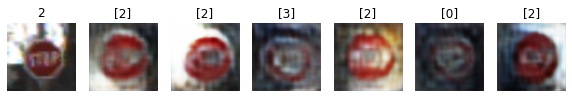

Epoch 16510 g_loss= 1.4893227 d_loss= 0.3458283 real_acc= 0.92 fake_acc= 0.88
Epoch 16520 g_loss= 1.933249 d_loss= 0.27739203 real_acc= 0.94 fake_acc= 0.88
Epoch 16530 g_loss= 2.2403374 d_loss= 0.31363747 real_acc= 0.82 fake_acc= 0.98
Epoch 16540 g_loss= 2.1184766 d_loss= 0.30481237 real_acc= 0.82 fake_acc= 0.98
Epoch 16550 g_loss= 1.732547 d_loss= 0.30102694 real_acc= 0.92 fake_acc= 0.9
Epoch 16560 g_loss= 1.9770856 d_loss= 0.28228605 real_acc= 0.9 fake_acc= 0.96
Epoch 16570 g_loss= 2.4219968 d_loss= 0.28375867 real_acc= 0.86 fake_acc= 0.98
Epoch 16580 g_loss= 1.8863417 d_loss= 0.25539267 real_acc= 0.96 fake_acc= 0.96
Epoch 16590 g_loss= 1.8267539 d_loss= 0.35999876 real_acc= 0.82 fake_acc= 0.94
Epoch 16600 g_loss= 2.1064909 d_loss= 0.36226922 real_acc= 0.84 fake_acc= 0.94


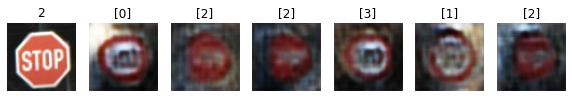

Epoch 16610 g_loss= 1.9429109 d_loss= 0.25589198 real_acc= 0.96 fake_acc= 0.92
Epoch 16620 g_loss= 1.8146778 d_loss= 0.2971107 real_acc= 0.86 fake_acc= 1.0
Epoch 16630 g_loss= 1.7997987 d_loss= 0.2962042 real_acc= 0.86 fake_acc= 0.92
Epoch 16640 g_loss= 1.887006 d_loss= 0.28663403 real_acc= 0.86 fake_acc= 0.96
Epoch 16650 g_loss= 1.9251028 d_loss= 0.33695298 real_acc= 0.84 fake_acc= 0.88
Epoch 16660 g_loss= 2.0354035 d_loss= 0.27987593 real_acc= 0.86 fake_acc= 0.98
Epoch 16670 g_loss= 1.6407732 d_loss= 0.29250547 real_acc= 0.98 fake_acc= 0.9
Epoch 16680 g_loss= 1.6916221 d_loss= 0.25317433 real_acc= 0.98 fake_acc= 0.9
Epoch 16690 g_loss= 1.8605855 d_loss= 0.28612822 real_acc= 0.92 fake_acc= 0.98
Epoch 16700 g_loss= 1.9859871 d_loss= 0.25453007 real_acc= 0.9 fake_acc= 0.94


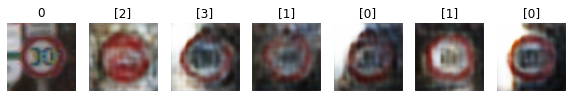

Epoch 16710 g_loss= 1.7026963 d_loss= 0.2974302 real_acc= 0.94 fake_acc= 0.86
Epoch 16720 g_loss= 1.6760718 d_loss= 0.2560603 real_acc= 0.96 fake_acc= 0.94
Epoch 16730 g_loss= 1.6012226 d_loss= 0.29011792 real_acc= 0.96 fake_acc= 0.86
Epoch 16740 g_loss= 2.0042412 d_loss= 0.28387734 real_acc= 0.86 fake_acc= 1.0
Epoch 16750 g_loss= 2.0402038 d_loss= 0.26509994 real_acc= 0.96 fake_acc= 0.92
Epoch 16760 g_loss= 1.6902515 d_loss= 0.28835234 real_acc= 0.94 fake_acc= 0.86
Epoch 16770 g_loss= 2.3213396 d_loss= 0.3197031 real_acc= 0.78 fake_acc= 0.98
Epoch 16780 g_loss= 2.0967638 d_loss= 0.24512348 real_acc= 0.96 fake_acc= 0.94
Epoch 16790 g_loss= 1.6787037 d_loss= 0.26435685 real_acc= 0.96 fake_acc= 0.9
Epoch 16800 g_loss= 1.7505957 d_loss= 0.31122598 real_acc= 0.82 fake_acc= 0.92


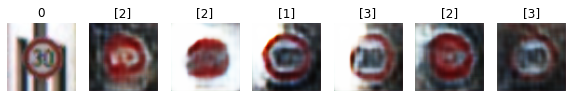

Epoch 16810 g_loss= 1.719534 d_loss= 0.31470886 real_acc= 0.86 fake_acc= 0.9
Epoch 16820 g_loss= 1.4447961 d_loss= 0.3374732 real_acc= 0.94 fake_acc= 0.8
Epoch 16830 g_loss= 2.128943 d_loss= 0.31549376 real_acc= 0.8 fake_acc= 0.98
Epoch 16840 g_loss= 1.9415729 d_loss= 0.25537467 real_acc= 0.94 fake_acc= 0.88
Epoch 16850 g_loss= 2.1955042 d_loss= 0.36206025 real_acc= 0.76 fake_acc= 0.92
Epoch 16860 g_loss= 2.2740874 d_loss= 0.29967228 real_acc= 0.84 fake_acc= 0.96
Epoch 16870 g_loss= 1.4965671 d_loss= 0.30798855 real_acc= 0.94 fake_acc= 0.78
Epoch 16880 g_loss= 1.6891522 d_loss= 0.40048555 real_acc= 0.76 fake_acc= 0.94
Epoch 16890 g_loss= 1.657564 d_loss= 0.30828688 real_acc= 0.92 fake_acc= 0.86
Epoch 16900 g_loss= 1.937231 d_loss= 0.24247456 real_acc= 0.94 fake_acc= 0.96


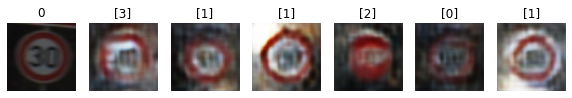

Epoch 16910 g_loss= 2.075252 d_loss= 0.2664205 real_acc= 0.92 fake_acc= 0.96
Epoch 16920 g_loss= 2.2818131 d_loss= 0.3092217 real_acc= 0.76 fake_acc= 0.94
Epoch 16930 g_loss= 1.8235267 d_loss= 0.32566172 real_acc= 0.88 fake_acc= 0.92
Epoch 16940 g_loss= 1.6801645 d_loss= 0.26479882 real_acc= 1.0 fake_acc= 0.84
Epoch 16950 g_loss= 1.5530859 d_loss= 0.32282132 real_acc= 0.9 fake_acc= 0.82
Epoch 16960 g_loss= 2.3168364 d_loss= 0.41074404 real_acc= 0.64 fake_acc= 0.98
Epoch 16970 g_loss= 2.067225 d_loss= 0.2646423 real_acc= 0.84 fake_acc= 0.96
Epoch 16980 g_loss= 2.0126994 d_loss= 0.25393564 real_acc= 0.96 fake_acc= 0.9
Epoch 16990 g_loss= 1.9311156 d_loss= 0.29091445 real_acc= 0.86 fake_acc= 0.96
Epoch 17000 g_loss= 1.940447 d_loss= 0.28172165 real_acc= 0.9 fake_acc= 0.92


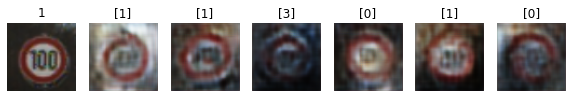

Epoch 17010 g_loss= 1.5274537 d_loss= 0.30120486 real_acc= 0.9 fake_acc= 0.86
Epoch 17020 g_loss= 2.2931104 d_loss= 0.23374456 real_acc= 0.94 fake_acc= 0.96
Epoch 17030 g_loss= 2.2007449 d_loss= 0.30357057 real_acc= 0.8 fake_acc= 0.96
Epoch 17040 g_loss= 2.0067205 d_loss= 0.33158258 real_acc= 0.78 fake_acc= 1.0
Epoch 17050 g_loss= 1.7798952 d_loss= 0.3080562 real_acc= 0.86 fake_acc= 0.88
Epoch 17060 g_loss= 1.7401996 d_loss= 0.26137024 real_acc= 0.96 fake_acc= 0.84
Epoch 17070 g_loss= 1.7850238 d_loss= 0.34113216 real_acc= 0.86 fake_acc= 0.9
Epoch 17080 g_loss= 1.8330331 d_loss= 0.2919168 real_acc= 0.88 fake_acc= 0.96
Epoch 17090 g_loss= 2.1644669 d_loss= 0.27050626 real_acc= 0.82 fake_acc= 0.98
Epoch 17100 g_loss= 2.1744447 d_loss= 0.27778363 real_acc= 0.86 fake_acc= 0.96


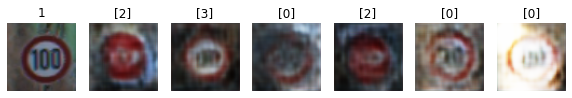

Epoch 17110 g_loss= 1.7448882 d_loss= 0.25015587 real_acc= 1.0 fake_acc= 0.86
Epoch 17120 g_loss= 1.7018132 d_loss= 0.28132126 real_acc= 0.9 fake_acc= 0.86
Epoch 17130 g_loss= 1.9411476 d_loss= 0.3270604 real_acc= 0.76 fake_acc= 0.96
Epoch 17140 g_loss= 1.9218189 d_loss= 0.2730499 real_acc= 0.86 fake_acc= 0.96
Epoch 17150 g_loss= 1.8758086 d_loss= 0.25169796 real_acc= 0.92 fake_acc= 0.96
Epoch 17160 g_loss= 1.6185026 d_loss= 0.2641331 real_acc= 1.0 fake_acc= 0.8
Epoch 17170 g_loss= 1.9871764 d_loss= 0.2748889 real_acc= 0.94 fake_acc= 0.94
Epoch 17180 g_loss= 2.456315 d_loss= 0.32863975 real_acc= 0.8 fake_acc= 0.94
Epoch 17190 g_loss= 2.165273 d_loss= 0.32290727 real_acc= 0.84 fake_acc= 0.94
Epoch 17200 g_loss= 1.7309747 d_loss= 0.30444336 real_acc= 0.94 fake_acc= 0.88


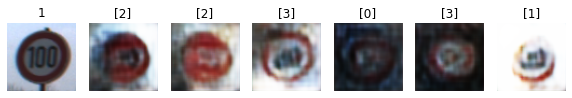

Epoch 17210 g_loss= 1.6516343 d_loss= 0.35712776 real_acc= 0.86 fake_acc= 0.88
Epoch 17220 g_loss= 1.7874227 d_loss= 0.30914032 real_acc= 0.9 fake_acc= 0.9
Epoch 17230 g_loss= 2.0581472 d_loss= 0.2520294 real_acc= 0.92 fake_acc= 0.96
Epoch 17240 g_loss= 2.1406798 d_loss= 0.29226276 real_acc= 0.86 fake_acc= 0.9
Epoch 17250 g_loss= 1.9342076 d_loss= 0.28237695 real_acc= 0.94 fake_acc= 0.9
Epoch 17260 g_loss= 1.6932904 d_loss= 0.35122994 real_acc= 0.84 fake_acc= 0.92
Epoch 17270 g_loss= 1.9303241 d_loss= 0.27832562 real_acc= 0.94 fake_acc= 0.96
Epoch 17280 g_loss= 1.7954209 d_loss= 0.30032742 real_acc= 0.9 fake_acc= 0.88
Epoch 17290 g_loss= 1.8277426 d_loss= 0.26578984 real_acc= 0.96 fake_acc= 0.86
Epoch 17300 g_loss= 2.0766501 d_loss= 0.3275512 real_acc= 0.8 fake_acc= 0.98


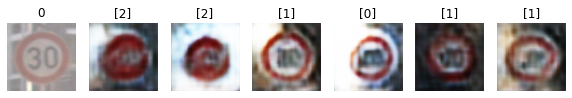

Epoch 17310 g_loss= 1.789325 d_loss= 0.30510157 real_acc= 0.92 fake_acc= 0.9
Epoch 17320 g_loss= 1.6356742 d_loss= 0.34568936 real_acc= 0.86 fake_acc= 0.82
Epoch 17330 g_loss= 2.1889603 d_loss= 0.31868887 real_acc= 0.84 fake_acc= 0.94
Epoch 17340 g_loss= 1.7253948 d_loss= 0.30120888 real_acc= 0.9 fake_acc= 0.82
Epoch 17350 g_loss= 1.9734362 d_loss= 0.31732035 real_acc= 0.9 fake_acc= 0.92
Epoch 17360 g_loss= 1.8211712 d_loss= 0.3246864 real_acc= 0.88 fake_acc= 0.88
Epoch 17370 g_loss= 1.6219035 d_loss= 0.2965495 real_acc= 0.88 fake_acc= 0.88
Epoch 17380 g_loss= 1.7037692 d_loss= 0.3310135 real_acc= 0.9 fake_acc= 0.9
Epoch 17390 g_loss= 2.115014 d_loss= 0.30073962 real_acc= 0.86 fake_acc= 0.98
Epoch 17400 g_loss= 2.0496829 d_loss= 0.31402123 real_acc= 0.8 fake_acc= 0.98


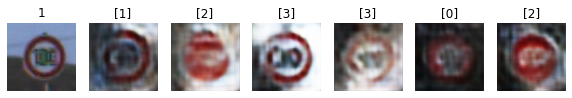

Epoch 17410 g_loss= 1.6359237 d_loss= 0.27003157 real_acc= 1.0 fake_acc= 0.84
Epoch 17420 g_loss= 2.2201424 d_loss= 0.28442731 real_acc= 0.88 fake_acc= 0.98
Epoch 17430 g_loss= 1.5877849 d_loss= 0.29228494 real_acc= 0.92 fake_acc= 0.9
Epoch 17440 g_loss= 1.9381194 d_loss= 0.29475278 real_acc= 0.9 fake_acc= 0.92
Epoch 17450 g_loss= 1.9392833 d_loss= 0.24826741 real_acc= 0.88 fake_acc= 0.98
Epoch 17460 g_loss= 1.6174669 d_loss= 0.35363883 real_acc= 0.88 fake_acc= 0.86
Epoch 17470 g_loss= 2.1252997 d_loss= 0.26770657 real_acc= 0.86 fake_acc= 0.96
Epoch 17480 g_loss= 1.7646959 d_loss= 0.2685037 real_acc= 0.9 fake_acc= 0.9
Epoch 17490 g_loss= 1.8016132 d_loss= 0.25541306 real_acc= 0.96 fake_acc= 0.96
Epoch 17500 g_loss= 2.2107072 d_loss= 0.2515747 real_acc= 0.88 fake_acc= 0.98


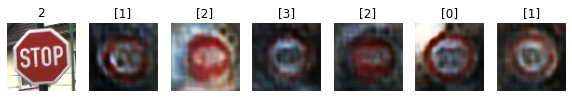

Epoch 17510 g_loss= 1.5023559 d_loss= 0.3199182 real_acc= 0.94 fake_acc= 0.82
Epoch 17520 g_loss= 1.8431602 d_loss= 0.27231422 real_acc= 0.9 fake_acc= 0.92
Epoch 17530 g_loss= 1.7931072 d_loss= 0.31115347 real_acc= 0.88 fake_acc= 0.88
Epoch 17540 g_loss= 2.1670246 d_loss= 0.2592734 real_acc= 0.94 fake_acc= 0.94
Epoch 17550 g_loss= 2.012249 d_loss= 0.288307 real_acc= 0.88 fake_acc= 0.98
Epoch 17560 g_loss= 1.8741393 d_loss= 0.31290394 real_acc= 0.84 fake_acc= 0.88
Epoch 17570 g_loss= 1.50952 d_loss= 0.2905274 real_acc= 0.98 fake_acc= 0.8
Epoch 17580 g_loss= 1.9343449 d_loss= 0.3095808 real_acc= 0.84 fake_acc= 0.94
Epoch 17590 g_loss= 1.8682843 d_loss= 0.31308007 real_acc= 0.82 fake_acc= 0.94
Epoch 17600 g_loss= 1.7784778 d_loss= 0.34188735 real_acc= 0.86 fake_acc= 0.9


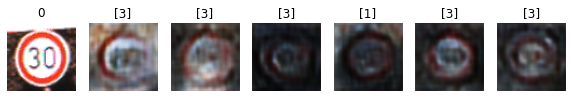

Epoch 17610 g_loss= 1.7726979 d_loss= 0.26421225 real_acc= 0.9 fake_acc= 0.98
Epoch 17620 g_loss= 2.1708677 d_loss= 0.29320058 real_acc= 0.84 fake_acc= 0.92
Epoch 17630 g_loss= 1.9223381 d_loss= 0.28561246 real_acc= 0.88 fake_acc= 0.9
Epoch 17640 g_loss= 1.7741339 d_loss= 0.30787176 real_acc= 0.92 fake_acc= 0.92
Epoch 17650 g_loss= 1.2438145 d_loss= 0.37309197 real_acc= 0.96 fake_acc= 0.72
Epoch 17660 g_loss= 2.0676894 d_loss= 0.22779396 real_acc= 0.92 fake_acc= 0.94
Epoch 17670 g_loss= 1.6893674 d_loss= 0.32162303 real_acc= 0.9 fake_acc= 0.88
Epoch 17680 g_loss= 2.0746527 d_loss= 0.3221051 real_acc= 0.84 fake_acc= 1.0
Epoch 17690 g_loss= 2.4874651 d_loss= 0.3211486 real_acc= 0.86 fake_acc= 1.0
Epoch 17700 g_loss= 1.7011675 d_loss= 0.275188 real_acc= 0.98 fake_acc= 0.84


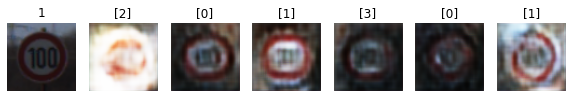

Epoch 17710 g_loss= 1.685319 d_loss= 0.3181051 real_acc= 0.9 fake_acc= 0.88
Epoch 17720 g_loss= 2.1114569 d_loss= 0.28205824 real_acc= 0.82 fake_acc= 0.96
Epoch 17730 g_loss= 2.3082643 d_loss= 0.36362186 real_acc= 0.76 fake_acc= 0.98
Epoch 17740 g_loss= 1.9469757 d_loss= 0.22038998 real_acc= 0.96 fake_acc= 0.96
Epoch 17750 g_loss= 1.7683585 d_loss= 0.30230302 real_acc= 0.9 fake_acc= 0.86
Epoch 17760 g_loss= 1.8916719 d_loss= 0.33425713 real_acc= 0.82 fake_acc= 0.9
Epoch 17770 g_loss= 1.7512908 d_loss= 0.33162737 real_acc= 0.9 fake_acc= 0.9
Epoch 17780 g_loss= 2.0510128 d_loss= 0.21561652 real_acc= 0.96 fake_acc= 0.92
Epoch 17790 g_loss= 1.9405748 d_loss= 0.28033108 real_acc= 0.84 fake_acc= 0.92
Epoch 17800 g_loss= 2.0339026 d_loss= 0.3292287 real_acc= 0.82 fake_acc= 0.96


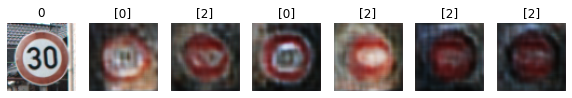

Epoch 17810 g_loss= 1.9806442 d_loss= 0.29066965 real_acc= 0.88 fake_acc= 0.94
Epoch 17820 g_loss= 1.7355859 d_loss= 0.35839492 real_acc= 0.82 fake_acc= 0.84
Epoch 17830 g_loss= 1.6653255 d_loss= 0.33121568 real_acc= 0.94 fake_acc= 0.84
Epoch 17840 g_loss= 2.2048807 d_loss= 0.24986073 real_acc= 0.94 fake_acc= 0.96
Epoch 17850 g_loss= 2.0876267 d_loss= 0.33314854 real_acc= 0.82 fake_acc= 0.94
Epoch 17860 g_loss= 2.1615655 d_loss= 0.27428597 real_acc= 0.84 fake_acc= 0.96
Epoch 17870 g_loss= 1.606064 d_loss= 0.3111208 real_acc= 0.92 fake_acc= 0.8
Epoch 17880 g_loss= 2.0109606 d_loss= 0.27798092 real_acc= 0.88 fake_acc= 0.96
Epoch 17890 g_loss= 2.0415125 d_loss= 0.3437983 real_acc= 0.86 fake_acc= 0.96
Epoch 17900 g_loss= 1.5357684 d_loss= 0.2918807 real_acc= 0.98 fake_acc= 0.86


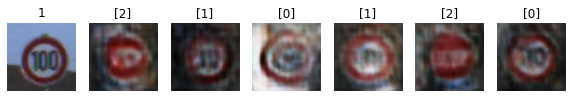

Epoch 17910 g_loss= 1.6293415 d_loss= 0.26502448 real_acc= 0.96 fake_acc= 0.92
Epoch 17920 g_loss= 1.8097854 d_loss= 0.3539186 real_acc= 0.78 fake_acc= 0.96
Epoch 17930 g_loss= 1.8151996 d_loss= 0.3226957 real_acc= 0.9 fake_acc= 0.84
Epoch 17940 g_loss= 1.7185642 d_loss= 0.28882247 real_acc= 0.94 fake_acc= 0.84
Epoch 17950 g_loss= 2.0039988 d_loss= 0.32989854 real_acc= 0.8 fake_acc= 0.94
Epoch 17960 g_loss= 1.4468405 d_loss= 0.39640677 real_acc= 0.92 fake_acc= 0.68
Epoch 17970 g_loss= 1.8338536 d_loss= 0.2757057 real_acc= 0.9 fake_acc= 0.92
Epoch 17980 g_loss= 1.946399 d_loss= 0.27766046 real_acc= 0.9 fake_acc= 0.94
Epoch 17990 g_loss= 1.9852016 d_loss= 0.2460466 real_acc= 0.88 fake_acc= 0.98
Epoch 18000 g_loss= 2.1072464 d_loss= 0.26380783 real_acc= 0.9 fake_acc= 0.92


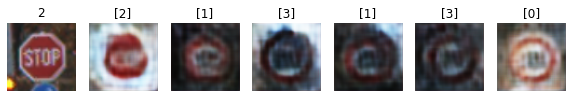

Epoch 18010 g_loss= 1.6173705 d_loss= 0.3374566 real_acc= 0.88 fake_acc= 0.8
Epoch 18020 g_loss= 1.801601 d_loss= 0.29311898 real_acc= 0.9 fake_acc= 0.92
Epoch 18030 g_loss= 2.3014736 d_loss= 0.3222987 real_acc= 0.82 fake_acc= 0.94
Epoch 18040 g_loss= 1.8893685 d_loss= 0.304581 real_acc= 0.88 fake_acc= 0.86
Epoch 18050 g_loss= 1.9507223 d_loss= 0.30868012 real_acc= 0.88 fake_acc= 1.0
Epoch 18060 g_loss= 1.9266696 d_loss= 0.31165034 real_acc= 0.84 fake_acc= 0.92
Epoch 18070 g_loss= 1.7647731 d_loss= 0.26129413 real_acc= 0.9 fake_acc= 0.88
Epoch 18080 g_loss= 2.0645847 d_loss= 0.30325562 real_acc= 0.82 fake_acc= 0.96
Epoch 18090 g_loss= 1.7471439 d_loss= 0.28710443 real_acc= 0.88 fake_acc= 0.94
Epoch 18100 g_loss= 1.7552255 d_loss= 0.2984997 real_acc= 0.92 fake_acc= 0.88


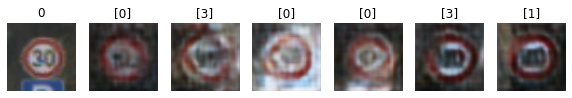

Epoch 18110 g_loss= 2.3557155 d_loss= 0.26749456 real_acc= 0.84 fake_acc= 0.98
Epoch 18120 g_loss= 1.8230755 d_loss= 0.35422462 real_acc= 0.86 fake_acc= 0.84
Epoch 18130 g_loss= 1.6027876 d_loss= 0.3177508 real_acc= 0.86 fake_acc= 0.84
Epoch 18140 g_loss= 1.4989241 d_loss= 0.38358492 real_acc= 0.86 fake_acc= 0.78
Epoch 18150 g_loss= 1.7504768 d_loss= 0.33300272 real_acc= 0.76 fake_acc= 0.96
Epoch 18160 g_loss= 1.6155896 d_loss= 0.27694318 real_acc= 0.98 fake_acc= 0.82
Epoch 18170 g_loss= 1.7182366 d_loss= 0.25294733 real_acc= 0.96 fake_acc= 0.88
Epoch 18180 g_loss= 2.065179 d_loss= 0.35827264 real_acc= 0.76 fake_acc= 0.98
Epoch 18190 g_loss= 1.6614401 d_loss= 0.27498353 real_acc= 0.96 fake_acc= 0.88
Epoch 18200 g_loss= 2.0115254 d_loss= 0.32801637 real_acc= 0.78 fake_acc= 0.92


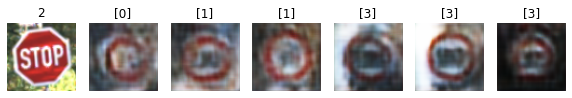

Epoch 18210 g_loss= 2.3404021 d_loss= 0.284113 real_acc= 0.84 fake_acc= 0.92
Epoch 18220 g_loss= 1.9423933 d_loss= 0.30437523 real_acc= 0.88 fake_acc= 0.94
Epoch 18230 g_loss= 1.502668 d_loss= 0.3000306 real_acc= 0.92 fake_acc= 0.86
Epoch 18240 g_loss= 1.6237473 d_loss= 0.26114184 real_acc= 0.94 fake_acc= 0.94
Epoch 18250 g_loss= 1.9498279 d_loss= 0.29048708 real_acc= 0.9 fake_acc= 0.92
Epoch 18260 g_loss= 1.7978199 d_loss= 0.3215558 real_acc= 0.92 fake_acc= 0.94
Epoch 18270 g_loss= 1.4179695 d_loss= 0.29331043 real_acc= 0.98 fake_acc= 0.86
Epoch 18280 g_loss= 1.8138268 d_loss= 0.24566492 real_acc= 0.98 fake_acc= 0.92
Epoch 18290 g_loss= 1.773555 d_loss= 0.22292586 real_acc= 0.98 fake_acc= 0.92
Epoch 18300 g_loss= 2.1758862 d_loss= 0.293342 real_acc= 0.82 fake_acc= 1.0


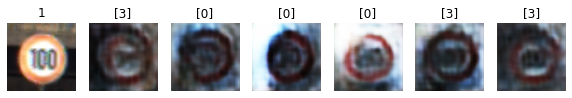

Epoch 18310 g_loss= 1.7068775 d_loss= 0.31250256 real_acc= 0.86 fake_acc= 0.94
Epoch 18320 g_loss= 1.6655422 d_loss= 0.28141528 real_acc= 0.92 fake_acc= 0.9
Epoch 18330 g_loss= 1.8341812 d_loss= 0.30853334 real_acc= 0.92 fake_acc= 0.84
Epoch 18340 g_loss= 1.9581546 d_loss= 0.30269015 real_acc= 0.82 fake_acc= 0.96
Epoch 18350 g_loss= 1.9669873 d_loss= 0.33557415 real_acc= 0.86 fake_acc= 0.94
Epoch 18360 g_loss= 1.9901414 d_loss= 0.3330374 real_acc= 0.84 fake_acc= 0.94
Epoch 18370 g_loss= 2.0870824 d_loss= 0.29088193 real_acc= 0.82 fake_acc= 0.94
Epoch 18380 g_loss= 2.0397596 d_loss= 0.2784687 real_acc= 0.88 fake_acc= 0.98
Epoch 18390 g_loss= 1.707351 d_loss= 0.37292135 real_acc= 0.92 fake_acc= 0.8
Epoch 18400 g_loss= 1.789122 d_loss= 0.2920699 real_acc= 0.94 fake_acc= 0.8


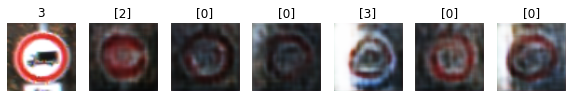

Epoch 18410 g_loss= 1.8945361 d_loss= 0.33619344 real_acc= 0.84 fake_acc= 0.92
Epoch 18420 g_loss= 2.2044742 d_loss= 0.25844833 real_acc= 0.84 fake_acc= 0.96
Epoch 18430 g_loss= 2.1883228 d_loss= 0.26242128 real_acc= 0.86 fake_acc= 0.98
Epoch 18440 g_loss= 1.9828742 d_loss= 0.27644593 real_acc= 0.9 fake_acc= 0.92
Epoch 18450 g_loss= 1.6589235 d_loss= 0.30088276 real_acc= 0.84 fake_acc= 0.96
Epoch 18460 g_loss= 1.7318158 d_loss= 0.3135153 real_acc= 0.9 fake_acc= 0.88
Epoch 18470 g_loss= 2.082297 d_loss= 0.26342854 real_acc= 0.9 fake_acc= 0.96
Epoch 18480 g_loss= 2.4847944 d_loss= 0.23933719 real_acc= 0.88 fake_acc= 0.96
Epoch 18490 g_loss= 1.8667994 d_loss= 0.30358243 real_acc= 0.82 fake_acc= 0.92
Epoch 18500 g_loss= 1.972514 d_loss= 0.20772175 real_acc= 0.96 fake_acc= 0.92


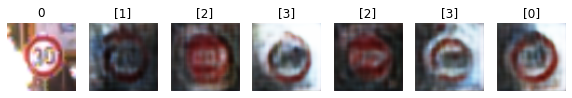

Epoch 18510 g_loss= 2.1188984 d_loss= 0.32412487 real_acc= 0.84 fake_acc= 0.9
Epoch 18520 g_loss= 1.5872532 d_loss= 0.32208952 real_acc= 0.92 fake_acc= 0.86
Epoch 18530 g_loss= 1.8765143 d_loss= 0.2753924 real_acc= 0.86 fake_acc= 0.98
Epoch 18540 g_loss= 1.836464 d_loss= 0.26849976 real_acc= 0.94 fake_acc= 0.88
Epoch 18550 g_loss= 1.8355328 d_loss= 0.29766488 real_acc= 0.88 fake_acc= 0.92
Epoch 18560 g_loss= 2.2945075 d_loss= 0.25990552 real_acc= 0.9 fake_acc= 0.88
Epoch 18570 g_loss= 2.302914 d_loss= 0.31530577 real_acc= 0.82 fake_acc= 0.96
Epoch 18580 g_loss= 1.4216458 d_loss= 0.30326113 real_acc= 0.94 fake_acc= 0.88
Epoch 18590 g_loss= 1.7574311 d_loss= 0.30255717 real_acc= 0.9 fake_acc= 0.94
Epoch 18600 g_loss= 2.1762142 d_loss= 0.32707107 real_acc= 0.82 fake_acc= 0.92


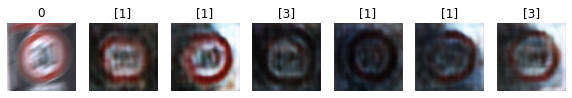

Epoch 18610 g_loss= 2.2845197 d_loss= 0.23209025 real_acc= 0.9 fake_acc= 0.98
Epoch 18620 g_loss= 1.8529514 d_loss= 0.32618332 real_acc= 0.88 fake_acc= 0.88
Epoch 18630 g_loss= 2.0572672 d_loss= 0.24249843 real_acc= 0.9 fake_acc= 0.98
Epoch 18640 g_loss= 1.9452941 d_loss= 0.2637195 real_acc= 0.96 fake_acc= 0.9
Epoch 18650 g_loss= 2.3806813 d_loss= 0.26430637 real_acc= 0.9 fake_acc= 0.98
Epoch 18660 g_loss= 2.0976913 d_loss= 0.30366373 real_acc= 0.82 fake_acc= 0.96
Epoch 18670 g_loss= 1.630697 d_loss= 0.32375538 real_acc= 0.92 fake_acc= 0.84
Epoch 18680 g_loss= 1.9957603 d_loss= 0.25139028 real_acc= 0.92 fake_acc= 0.96
Epoch 18690 g_loss= 2.0720882 d_loss= 0.2821802 real_acc= 0.88 fake_acc= 0.9
Epoch 18700 g_loss= 1.5997365 d_loss= 0.27785647 real_acc= 0.98 fake_acc= 0.9


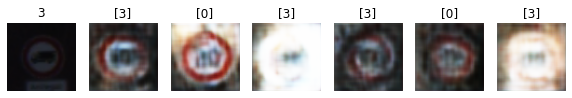

Epoch 18710 g_loss= 1.4710675 d_loss= 0.38277373 real_acc= 0.88 fake_acc= 0.8
Epoch 18720 g_loss= 1.9912485 d_loss= 0.27527517 real_acc= 0.92 fake_acc= 0.9
Epoch 18730 g_loss= 2.196812 d_loss= 0.20026319 real_acc= 0.96 fake_acc= 0.96
Epoch 18740 g_loss= 2.2894828 d_loss= 0.27158603 real_acc= 0.9 fake_acc= 0.96
Epoch 18750 g_loss= 1.8082396 d_loss= 0.3508451 real_acc= 0.88 fake_acc= 0.92
Epoch 18760 g_loss= 1.7878054 d_loss= 0.2743702 real_acc= 0.94 fake_acc= 0.92
Epoch 18770 g_loss= 2.0806222 d_loss= 0.32012206 real_acc= 0.82 fake_acc= 0.92
Epoch 18780 g_loss= 2.0887778 d_loss= 0.30567628 real_acc= 0.8 fake_acc= 0.96
Epoch 18790 g_loss= 2.4401226 d_loss= 0.29531288 real_acc= 0.84 fake_acc= 0.94
Epoch 18800 g_loss= 1.5224527 d_loss= 0.3157603 real_acc= 0.98 fake_acc= 0.72


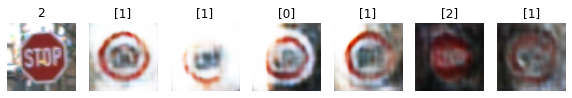

Epoch 18810 g_loss= 1.6329602 d_loss= 0.31740403 real_acc= 0.96 fake_acc= 0.88
Epoch 18820 g_loss= 2.3015268 d_loss= 0.3770057 real_acc= 0.72 fake_acc= 0.96
Epoch 18830 g_loss= 1.9119719 d_loss= 0.2842617 real_acc= 0.9 fake_acc= 0.88
Epoch 18840 g_loss= 1.920895 d_loss= 0.33528703 real_acc= 0.78 fake_acc= 0.92
Epoch 18850 g_loss= 1.7355124 d_loss= 0.3284154 real_acc= 0.9 fake_acc= 0.86
Epoch 18860 g_loss= 1.8410769 d_loss= 0.33620214 real_acc= 0.9 fake_acc= 0.88
Epoch 18870 g_loss= 2.4376683 d_loss= 0.28281853 real_acc= 0.84 fake_acc= 0.96
Epoch 18880 g_loss= 2.1771424 d_loss= 0.26950628 real_acc= 0.9 fake_acc= 0.92
Epoch 18890 g_loss= 2.1522253 d_loss= 0.27477223 real_acc= 0.88 fake_acc= 0.92
Epoch 18900 g_loss= 2.0184155 d_loss= 0.34253255 real_acc= 0.78 fake_acc= 0.9


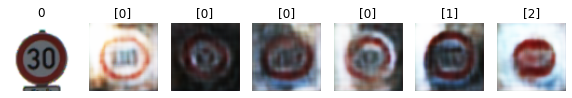

Epoch 18910 g_loss= 2.019146 d_loss= 0.3390866 real_acc= 0.82 fake_acc= 0.98
Epoch 18920 g_loss= 1.4668632 d_loss= 0.39657295 real_acc= 0.86 fake_acc= 0.88
Epoch 18930 g_loss= 1.7321767 d_loss= 0.30488282 real_acc= 0.9 fake_acc= 0.82
Epoch 18940 g_loss= 1.9749703 d_loss= 0.3030026 real_acc= 0.84 fake_acc= 0.96
Epoch 18950 g_loss= 1.6640857 d_loss= 0.3394823 real_acc= 0.82 fake_acc= 0.84
Epoch 18960 g_loss= 1.8797075 d_loss= 0.31818712 real_acc= 0.84 fake_acc= 0.86
Epoch 18970 g_loss= 1.632182 d_loss= 0.34245497 real_acc= 0.9 fake_acc= 0.82
Epoch 18980 g_loss= 1.8400844 d_loss= 0.30475372 real_acc= 0.88 fake_acc= 0.94
Epoch 18990 g_loss= 1.9429426 d_loss= 0.2866214 real_acc= 0.88 fake_acc= 0.94
Epoch 19000 g_loss= 1.6031756 d_loss= 0.35692993 real_acc= 0.84 fake_acc= 0.9


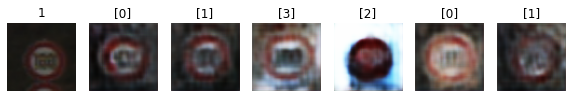

Epoch 19010 g_loss= 1.6543797 d_loss= 0.27144423 real_acc= 0.94 fake_acc= 0.9
Epoch 19020 g_loss= 2.1159368 d_loss= 0.27068004 real_acc= 0.88 fake_acc= 0.98
Epoch 19030 g_loss= 1.3204193 d_loss= 0.3369485 real_acc= 0.96 fake_acc= 0.7
Epoch 19040 g_loss= 1.7101392 d_loss= 0.3031447 real_acc= 0.92 fake_acc= 0.84
Epoch 19050 g_loss= 1.853672 d_loss= 0.3099773 real_acc= 0.84 fake_acc= 0.92
Epoch 19060 g_loss= 1.4615005 d_loss= 0.31635422 real_acc= 0.9 fake_acc= 0.82
Epoch 19070 g_loss= 1.7995001 d_loss= 0.33061445 real_acc= 0.94 fake_acc= 0.82
Epoch 19080 g_loss= 1.6341606 d_loss= 0.341667 real_acc= 0.88 fake_acc= 0.84
Epoch 19090 g_loss= 1.8458477 d_loss= 0.33432224 real_acc= 0.84 fake_acc= 0.88
Epoch 19100 g_loss= 1.9759593 d_loss= 0.28141713 real_acc= 0.9 fake_acc= 1.0


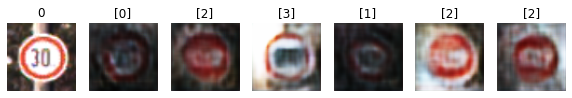

Epoch 19110 g_loss= 1.7127551 d_loss= 0.33252448 real_acc= 0.88 fake_acc= 0.84
Epoch 19120 g_loss= 2.1349845 d_loss= 0.26098493 real_acc= 0.84 fake_acc= 1.0
Epoch 19130 g_loss= 1.864718 d_loss= 0.27567363 real_acc= 0.92 fake_acc= 0.88
Epoch 19140 g_loss= 1.650025 d_loss= 0.32589984 real_acc= 0.92 fake_acc= 0.82
Epoch 19150 g_loss= 1.5941647 d_loss= 0.28260982 real_acc= 0.94 fake_acc= 0.84
Epoch 19160 g_loss= 2.2723415 d_loss= 0.25253302 real_acc= 0.88 fake_acc= 0.96
Epoch 19170 g_loss= 1.5713676 d_loss= 0.325745 real_acc= 0.94 fake_acc= 0.82
Epoch 19180 g_loss= 2.203686 d_loss= 0.27898705 real_acc= 0.8 fake_acc= 0.92
Epoch 19190 g_loss= 1.8944288 d_loss= 0.36536866 real_acc= 0.8 fake_acc= 0.94
Epoch 19200 g_loss= 1.7337134 d_loss= 0.2674913 real_acc= 0.92 fake_acc= 0.94


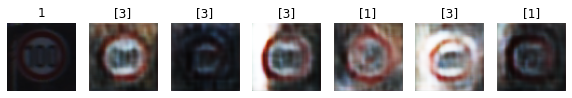

Epoch 19210 g_loss= 1.6555896 d_loss= 0.26750064 real_acc= 0.96 fake_acc= 0.88
Epoch 19220 g_loss= 2.0704894 d_loss= 0.3239003 real_acc= 0.82 fake_acc= 0.92
Epoch 19230 g_loss= 1.8416823 d_loss= 0.27132586 real_acc= 0.94 fake_acc= 0.84
Epoch 19240 g_loss= 1.8344216 d_loss= 0.27041876 real_acc= 0.9 fake_acc= 0.92
Epoch 19250 g_loss= 1.7235014 d_loss= 0.27617413 real_acc= 0.9 fake_acc= 0.86
Epoch 19260 g_loss= 1.514485 d_loss= 0.3312614 real_acc= 0.88 fake_acc= 0.92
Epoch 19270 g_loss= 2.5704708 d_loss= 0.27398565 real_acc= 0.8 fake_acc= 1.0
Epoch 19280 g_loss= 2.0788474 d_loss= 0.33205795 real_acc= 0.8 fake_acc= 0.92
Epoch 19290 g_loss= 1.651284 d_loss= 0.33696872 real_acc= 0.86 fake_acc= 0.9
Epoch 19300 g_loss= 1.783749 d_loss= 0.28151724 real_acc= 0.92 fake_acc= 0.86


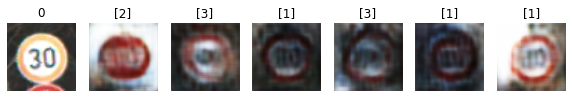

Epoch 19310 g_loss= 2.1112893 d_loss= 0.3424546 real_acc= 0.82 fake_acc= 0.98
Epoch 19320 g_loss= 1.8771276 d_loss= 0.28062505 real_acc= 0.9 fake_acc= 0.92
Epoch 19330 g_loss= 2.2823539 d_loss= 0.27355847 real_acc= 0.82 fake_acc= 0.98
Epoch 19340 g_loss= 1.8555121 d_loss= 0.32789415 real_acc= 0.88 fake_acc= 0.9
Epoch 19350 g_loss= 2.2495873 d_loss= 0.2956103 real_acc= 0.82 fake_acc= 0.92
Epoch 19360 g_loss= 1.6036922 d_loss= 0.39108655 real_acc= 0.88 fake_acc= 0.8
Epoch 19370 g_loss= 1.795123 d_loss= 0.2802425 real_acc= 0.92 fake_acc= 0.98
Epoch 19380 g_loss= 1.9839401 d_loss= 0.38174558 real_acc= 0.84 fake_acc= 0.96
Epoch 19390 g_loss= 2.3969915 d_loss= 0.31675324 real_acc= 0.82 fake_acc= 0.96
Epoch 19400 g_loss= 2.035199 d_loss= 0.30823052 real_acc= 0.86 fake_acc= 0.94


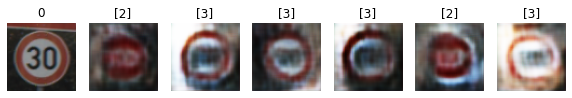

Epoch 19410 g_loss= 1.6441592 d_loss= 0.3404327 real_acc= 0.92 fake_acc= 0.78
Epoch 19420 g_loss= 1.7767303 d_loss= 0.32531255 real_acc= 0.9 fake_acc= 0.86
Epoch 19430 g_loss= 1.9506707 d_loss= 0.34646508 real_acc= 0.76 fake_acc= 0.88
Epoch 19440 g_loss= 1.9508365 d_loss= 0.25930393 real_acc= 0.88 fake_acc= 0.9
Epoch 19450 g_loss= 2.1631346 d_loss= 0.33227992 real_acc= 0.9 fake_acc= 0.96
Epoch 19460 g_loss= 1.884231 d_loss= 0.28801697 real_acc= 0.92 fake_acc= 0.94
Epoch 19470 g_loss= 1.408172 d_loss= 0.2722858 real_acc= 0.96 fake_acc= 0.86
Epoch 19480 g_loss= 1.6572338 d_loss= 0.2961638 real_acc= 0.92 fake_acc= 0.9
Epoch 19490 g_loss= 1.6926739 d_loss= 0.29374212 real_acc= 0.92 fake_acc= 0.94
Epoch 19500 g_loss= 1.6244056 d_loss= 0.3405763 real_acc= 0.82 fake_acc= 0.88


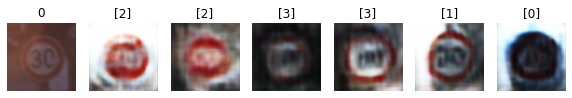

Epoch 19510 g_loss= 2.0469859 d_loss= 0.2761909 real_acc= 0.88 fake_acc= 0.92
Epoch 19520 g_loss= 1.9517758 d_loss= 0.2831513 real_acc= 0.88 fake_acc= 0.96
Epoch 19530 g_loss= 1.991327 d_loss= 0.31759882 real_acc= 0.84 fake_acc= 0.92
Epoch 19540 g_loss= 1.7420013 d_loss= 0.30550367 real_acc= 0.88 fake_acc= 0.92
Epoch 19550 g_loss= 2.2663784 d_loss= 0.3023709 real_acc= 0.86 fake_acc= 0.98
Epoch 19560 g_loss= 1.9666692 d_loss= 0.28461534 real_acc= 0.82 fake_acc= 0.98
Epoch 19570 g_loss= 1.8329537 d_loss= 0.28603518 real_acc= 0.84 fake_acc= 0.96
Epoch 19580 g_loss= 2.4627993 d_loss= 0.2506205 real_acc= 0.86 fake_acc= 1.0
Epoch 19590 g_loss= 1.5339928 d_loss= 0.32715806 real_acc= 0.9 fake_acc= 0.84
Epoch 19600 g_loss= 1.589077 d_loss= 0.27720186 real_acc= 0.98 fake_acc= 0.88


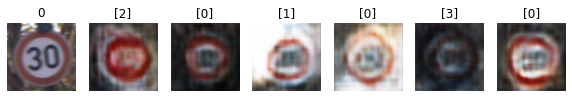

Epoch 19610 g_loss= 1.6695976 d_loss= 0.30650055 real_acc= 0.92 fake_acc= 0.9
Epoch 19620 g_loss= 1.5812697 d_loss= 0.31334853 real_acc= 0.9 fake_acc= 0.82
Epoch 19630 g_loss= 2.1729684 d_loss= 0.31033748 real_acc= 0.84 fake_acc= 0.94
Epoch 19640 g_loss= 2.274483 d_loss= 0.26651442 real_acc= 0.86 fake_acc= 0.92
Epoch 19650 g_loss= 1.9587233 d_loss= 0.2694885 real_acc= 0.86 fake_acc= 0.94
Epoch 19660 g_loss= 1.5541751 d_loss= 0.34042144 real_acc= 0.86 fake_acc= 0.76
Epoch 19670 g_loss= 2.2219305 d_loss= 0.3109023 real_acc= 0.88 fake_acc= 0.92
Epoch 19680 g_loss= 1.9340444 d_loss= 0.24706289 real_acc= 0.92 fake_acc= 0.98
Epoch 19690 g_loss= 2.031955 d_loss= 0.3930195 real_acc= 0.72 fake_acc= 0.96
Epoch 19700 g_loss= 1.8018882 d_loss= 0.2807874 real_acc= 0.92 fake_acc= 0.9


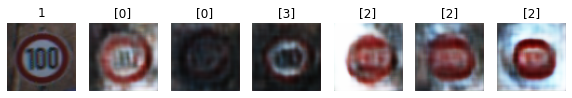

Epoch 19710 g_loss= 1.7994773 d_loss= 0.26114988 real_acc= 0.94 fake_acc= 0.94
Epoch 19720 g_loss= 1.870883 d_loss= 0.3547814 real_acc= 0.84 fake_acc= 0.92
Epoch 19730 g_loss= 1.96526 d_loss= 0.23803717 real_acc= 0.92 fake_acc= 0.94
Epoch 19740 g_loss= 1.8345933 d_loss= 0.32583845 real_acc= 0.9 fake_acc= 0.94
Epoch 19750 g_loss= 1.9323831 d_loss= 0.25640514 real_acc= 0.92 fake_acc= 0.96
Epoch 19760 g_loss= 1.951901 d_loss= 0.24850276 real_acc= 0.92 fake_acc= 0.96
Epoch 19770 g_loss= 1.8836986 d_loss= 0.28515476 real_acc= 0.9 fake_acc= 0.98
Epoch 19780 g_loss= 2.1882403 d_loss= 0.27129075 real_acc= 0.9 fake_acc= 0.92
Epoch 19790 g_loss= 2.4305136 d_loss= 0.313325 real_acc= 0.74 fake_acc= 1.0
Epoch 19800 g_loss= 1.611219 d_loss= 0.3006506 real_acc= 0.92 fake_acc= 0.86


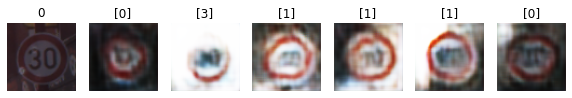

Epoch 19810 g_loss= 1.7731862 d_loss= 0.2680488 real_acc= 0.94 fake_acc= 0.9
Epoch 19820 g_loss= 1.9919406 d_loss= 0.27706677 real_acc= 0.92 fake_acc= 0.9
Epoch 19830 g_loss= 1.9710661 d_loss= 0.302374 real_acc= 0.86 fake_acc= 0.9
Epoch 19840 g_loss= 2.0331233 d_loss= 0.2836917 real_acc= 0.9 fake_acc= 0.9
Epoch 19850 g_loss= 1.6518757 d_loss= 0.34548324 real_acc= 0.84 fake_acc= 0.88
Epoch 19860 g_loss= 2.2235827 d_loss= 0.3323267 real_acc= 0.82 fake_acc= 0.98
Epoch 19870 g_loss= 2.0311427 d_loss= 0.22425392 real_acc= 0.98 fake_acc= 0.94
Epoch 19880 g_loss= 2.2352393 d_loss= 0.25417852 real_acc= 0.88 fake_acc= 0.96
Epoch 19890 g_loss= 1.6818782 d_loss= 0.3175575 real_acc= 0.9 fake_acc= 0.82
Epoch 19900 g_loss= 1.7089294 d_loss= 0.26513636 real_acc= 0.94 fake_acc= 0.9


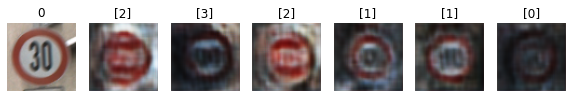

Epoch 19910 g_loss= 1.8583261 d_loss= 0.29610485 real_acc= 0.9 fake_acc= 0.82
Epoch 19920 g_loss= 2.0524333 d_loss= 0.30853006 real_acc= 0.88 fake_acc= 0.9
Epoch 19930 g_loss= 1.3286096 d_loss= 0.34781155 real_acc= 0.9 fake_acc= 0.8
Epoch 19940 g_loss= 1.6815408 d_loss= 0.29225194 real_acc= 0.86 fake_acc= 0.92
Epoch 19950 g_loss= 2.5464005 d_loss= 0.30943674 real_acc= 0.8 fake_acc= 0.98
Epoch 19960 g_loss= 1.845672 d_loss= 0.28115547 real_acc= 0.94 fake_acc= 0.86
Epoch 19970 g_loss= 1.8235697 d_loss= 0.32187128 real_acc= 0.86 fake_acc= 0.92
Epoch 19980 g_loss= 1.5335771 d_loss= 0.35691202 real_acc= 0.84 fake_acc= 0.9
Epoch 19990 g_loss= 1.4162118 d_loss= 0.3905297 real_acc= 0.86 fake_acc= 0.76
Epoch 20000 g_loss= 1.9875839 d_loss= 0.24197605 real_acc= 0.9 fake_acc= 0.9


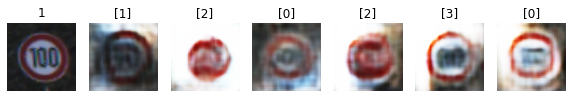

Epoch 20010 g_loss= 2.1370678 d_loss= 0.30938137 real_acc= 0.82 fake_acc= 0.94
Epoch 20020 g_loss= 2.039668 d_loss= 0.32989702 real_acc= 0.76 fake_acc= 0.94
Epoch 20030 g_loss= 1.5166057 d_loss= 0.34173372 real_acc= 0.98 fake_acc= 0.74
Epoch 20040 g_loss= 2.0657814 d_loss= 0.31780347 real_acc= 0.84 fake_acc= 0.92
Epoch 20050 g_loss= 2.3728995 d_loss= 0.28901997 real_acc= 0.82 fake_acc= 0.96
Epoch 20060 g_loss= 1.4974034 d_loss= 0.34611332 real_acc= 0.84 fake_acc= 0.8
Epoch 20070 g_loss= 1.8179734 d_loss= 0.2726633 real_acc= 0.92 fake_acc= 0.92
Epoch 20080 g_loss= 2.2388134 d_loss= 0.23904562 real_acc= 0.92 fake_acc= 0.98
Epoch 20090 g_loss= 1.8296622 d_loss= 0.32211268 real_acc= 0.9 fake_acc= 0.86
Epoch 20100 g_loss= 2.381826 d_loss= 0.31658497 real_acc= 0.78 fake_acc= 0.96


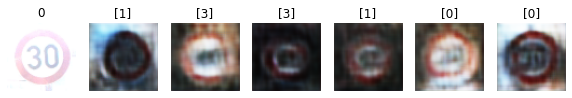

Epoch 20110 g_loss= 1.7555157 d_loss= 0.25720763 real_acc= 0.9 fake_acc= 0.94
Epoch 20120 g_loss= 1.7245618 d_loss= 0.25364834 real_acc= 0.9 fake_acc= 0.96
Epoch 20130 g_loss= 1.8882856 d_loss= 0.26905268 real_acc= 0.96 fake_acc= 0.88
Epoch 20140 g_loss= 2.4163022 d_loss= 0.34430733 real_acc= 0.82 fake_acc= 0.94
Epoch 20150 g_loss= 2.0852828 d_loss= 0.2872712 real_acc= 0.94 fake_acc= 0.98
Epoch 20160 g_loss= 1.6542889 d_loss= 0.23581657 real_acc= 1.0 fake_acc= 0.92
Epoch 20170 g_loss= 1.9872664 d_loss= 0.21345189 real_acc= 0.98 fake_acc= 0.94
Epoch 20180 g_loss= 1.6866528 d_loss= 0.33371228 real_acc= 0.94 fake_acc= 0.82
Epoch 20190 g_loss= 1.9117045 d_loss= 0.26759565 real_acc= 0.9 fake_acc= 0.92
Epoch 20200 g_loss= 2.0777404 d_loss= 0.25950658 real_acc= 0.92 fake_acc= 0.94


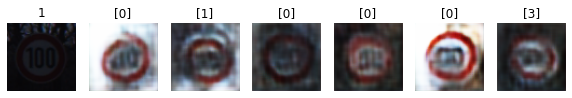

Epoch 20210 g_loss= 1.7413878 d_loss= 0.32677028 real_acc= 0.94 fake_acc= 0.8
Epoch 20220 g_loss= 1.2808155 d_loss= 0.40806943 real_acc= 0.9 fake_acc= 0.8
Epoch 20230 g_loss= 1.6935474 d_loss= 0.268884 real_acc= 0.92 fake_acc= 0.92
Epoch 20240 g_loss= 1.8556237 d_loss= 0.27161384 real_acc= 0.9 fake_acc= 0.94
Epoch 20250 g_loss= 2.422527 d_loss= 0.2142295 real_acc= 0.88 fake_acc= 0.98
Epoch 20260 g_loss= 2.0441406 d_loss= 0.23150992 real_acc= 0.96 fake_acc= 0.96
Epoch 20270 g_loss= 1.4820317 d_loss= 0.33395022 real_acc= 0.92 fake_acc= 0.84
Epoch 20280 g_loss= 1.6154234 d_loss= 0.2871517 real_acc= 0.96 fake_acc= 0.8
Epoch 20290 g_loss= 2.06161 d_loss= 0.27373892 real_acc= 0.88 fake_acc= 0.96
Epoch 20300 g_loss= 2.3006651 d_loss= 0.28210706 real_acc= 0.8 fake_acc= 0.98


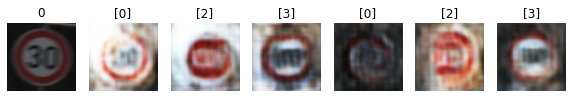

Epoch 20310 g_loss= 2.0027902 d_loss= 0.2867987 real_acc= 0.92 fake_acc= 0.92
Epoch 20320 g_loss= 2.3993506 d_loss= 0.25910842 real_acc= 0.84 fake_acc= 1.0
Epoch 20330 g_loss= 1.8101571 d_loss= 0.3198457 real_acc= 0.86 fake_acc= 0.92
Epoch 20340 g_loss= 1.4080657 d_loss= 0.29318526 real_acc= 0.96 fake_acc= 0.84
Epoch 20350 g_loss= 1.862361 d_loss= 0.2494031 real_acc= 0.94 fake_acc= 0.92
Epoch 20360 g_loss= 2.0004482 d_loss= 0.3023284 real_acc= 0.86 fake_acc= 0.98
Epoch 20370 g_loss= 1.6544324 d_loss= 0.34206888 real_acc= 0.9 fake_acc= 0.8
Epoch 20380 g_loss= 2.0027094 d_loss= 0.28401002 real_acc= 0.9 fake_acc= 0.96
Epoch 20390 g_loss= 2.118948 d_loss= 0.27833802 real_acc= 0.9 fake_acc= 0.94
Epoch 20400 g_loss= 1.5676384 d_loss= 0.32804912 real_acc= 0.84 fake_acc= 0.92


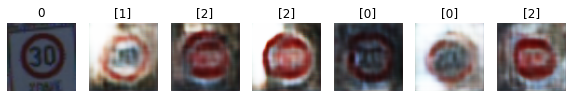

Epoch 20410 g_loss= 1.8826964 d_loss= 0.24975315 real_acc= 0.96 fake_acc= 0.96
Epoch 20420 g_loss= 1.957882 d_loss= 0.27982968 real_acc= 0.9 fake_acc= 0.94
Epoch 20430 g_loss= 1.9396912 d_loss= 0.23607212 real_acc= 0.9 fake_acc= 0.94
Epoch 20440 g_loss= 2.1957211 d_loss= 0.31978953 real_acc= 0.84 fake_acc= 0.92
Epoch 20450 g_loss= 2.1528668 d_loss= 0.27539974 real_acc= 0.84 fake_acc= 0.96
Epoch 20460 g_loss= 1.8495256 d_loss= 0.29011723 real_acc= 0.92 fake_acc= 0.9
Epoch 20470 g_loss= 2.1846333 d_loss= 0.28614992 real_acc= 0.84 fake_acc= 1.0
Epoch 20480 g_loss= 1.5362848 d_loss= 0.38525683 real_acc= 0.9 fake_acc= 0.88
Epoch 20490 g_loss= 1.7932979 d_loss= 0.29213035 real_acc= 0.92 fake_acc= 0.86
Epoch 20500 g_loss= 2.158483 d_loss= 0.24388246 real_acc= 0.94 fake_acc= 0.96


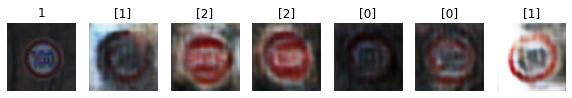

Epoch 20510 g_loss= 2.014241 d_loss= 0.31042674 real_acc= 0.88 fake_acc= 0.92
Epoch 20520 g_loss= 1.8358296 d_loss= 0.2686473 real_acc= 0.92 fake_acc= 0.98
Epoch 20530 g_loss= 1.9895885 d_loss= 0.26174682 real_acc= 0.92 fake_acc= 0.92
Epoch 20540 g_loss= 1.8238488 d_loss= 0.31238538 real_acc= 0.88 fake_acc= 0.9
Epoch 20550 g_loss= 2.3535657 d_loss= 0.2838228 real_acc= 0.8 fake_acc= 0.96
Epoch 20560 g_loss= 1.6474273 d_loss= 0.2458598 real_acc= 0.96 fake_acc= 0.88
Epoch 20570 g_loss= 1.6783847 d_loss= 0.3236435 real_acc= 0.96 fake_acc= 0.86
Epoch 20580 g_loss= 1.9450284 d_loss= 0.32143515 real_acc= 0.86 fake_acc= 0.94
Epoch 20590 g_loss= 2.2046127 d_loss= 0.3264514 real_acc= 0.82 fake_acc= 0.98
Epoch 20600 g_loss= 1.8781871 d_loss= 0.32092637 real_acc= 0.88 fake_acc= 0.92


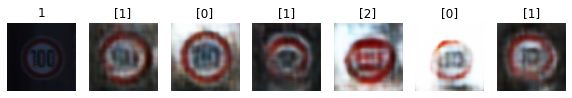

Epoch 20610 g_loss= 2.004822 d_loss= 0.33921552 real_acc= 0.86 fake_acc= 0.9
Epoch 20620 g_loss= 2.342347 d_loss= 0.25123164 real_acc= 0.9 fake_acc= 0.96
Epoch 20630 g_loss= 2.4373639 d_loss= 0.33153388 real_acc= 0.84 fake_acc= 0.98
Epoch 20640 g_loss= 1.9501513 d_loss= 0.31708273 real_acc= 0.86 fake_acc= 0.98
Epoch 20650 g_loss= 1.2560592 d_loss= 0.3714453 real_acc= 0.94 fake_acc= 0.7
Epoch 20660 g_loss= 1.558253 d_loss= 0.3295806 real_acc= 0.92 fake_acc= 0.86
Epoch 20670 g_loss= 1.8606746 d_loss= 0.22270428 real_acc= 0.96 fake_acc= 0.96
Epoch 20680 g_loss= 2.0652106 d_loss= 0.23824394 real_acc= 0.9 fake_acc= 0.96
Epoch 20690 g_loss= 1.9567044 d_loss= 0.34719843 real_acc= 0.76 fake_acc= 0.92
Epoch 20700 g_loss= 1.9501861 d_loss= 0.26167527 real_acc= 0.9 fake_acc= 0.88


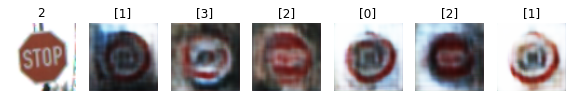

Epoch 20710 g_loss= 1.4147488 d_loss= 0.3138066 real_acc= 0.94 fake_acc= 0.76
Epoch 20720 g_loss= 1.7069515 d_loss= 0.31612706 real_acc= 0.9 fake_acc= 0.86
Epoch 20730 g_loss= 1.745817 d_loss= 0.3260284 real_acc= 0.82 fake_acc= 0.92
Epoch 20740 g_loss= 1.9921902 d_loss= 0.26455703 real_acc= 0.88 fake_acc= 0.96
Epoch 20750 g_loss= 2.1389027 d_loss= 0.30638707 real_acc= 0.8 fake_acc= 0.94
Epoch 20760 g_loss= 2.010823 d_loss= 0.25511336 real_acc= 0.92 fake_acc= 1.0
Epoch 20770 g_loss= 1.8901294 d_loss= 0.27143607 real_acc= 0.92 fake_acc= 0.92
Epoch 20780 g_loss= 2.1445715 d_loss= 0.38340613 real_acc= 0.68 fake_acc= 0.94
Epoch 20790 g_loss= 2.3430681 d_loss= 0.27763104 real_acc= 0.9 fake_acc= 0.96
Epoch 20800 g_loss= 1.6750591 d_loss= 0.27901343 real_acc= 0.94 fake_acc= 0.88


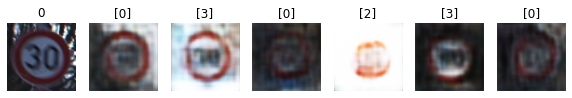

Epoch 20810 g_loss= 1.9338624 d_loss= 0.2522992 real_acc= 0.92 fake_acc= 0.94
Epoch 20820 g_loss= 2.0799553 d_loss= 0.28444576 real_acc= 0.9 fake_acc= 0.94
Epoch 20830 g_loss= 2.0708215 d_loss= 0.31739986 real_acc= 0.88 fake_acc= 0.94
Epoch 20840 g_loss= 1.8412513 d_loss= 0.29250842 real_acc= 0.9 fake_acc= 0.94
Epoch 20850 g_loss= 1.7585254 d_loss= 0.32967418 real_acc= 0.8 fake_acc= 0.9
Epoch 20860 g_loss= 1.7253662 d_loss= 0.32387653 real_acc= 0.88 fake_acc= 0.84
Epoch 20870 g_loss= 1.7178221 d_loss= 0.33685392 real_acc= 0.78 fake_acc= 0.92
Epoch 20880 g_loss= 1.6396904 d_loss= 0.2856832 real_acc= 0.92 fake_acc= 0.8
Epoch 20890 g_loss= 2.1979475 d_loss= 0.23409858 real_acc= 0.92 fake_acc= 0.98
Epoch 20900 g_loss= 2.5239806 d_loss= 0.38959175 real_acc= 0.62 fake_acc= 0.98


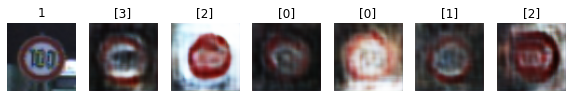

Epoch 20910 g_loss= 2.0305564 d_loss= 0.31385416 real_acc= 0.86 fake_acc= 0.92
Epoch 20920 g_loss= 1.6679013 d_loss= 0.29474577 real_acc= 0.92 fake_acc= 0.78
Epoch 20930 g_loss= 1.5340521 d_loss= 0.35063314 real_acc= 0.88 fake_acc= 0.8
Epoch 20940 g_loss= 1.9096347 d_loss= 0.3049672 real_acc= 0.82 fake_acc= 0.96
Epoch 20950 g_loss= 2.4507527 d_loss= 0.26071978 real_acc= 0.84 fake_acc= 0.94
Epoch 20960 g_loss= 1.7664834 d_loss= 0.30299437 real_acc= 0.92 fake_acc= 0.9
Epoch 20970 g_loss= 1.7275178 d_loss= 0.29506612 real_acc= 0.9 fake_acc= 0.84
Epoch 20980 g_loss= 1.6068889 d_loss= 0.26725045 real_acc= 0.98 fake_acc= 0.84
Epoch 20990 g_loss= 1.6195874 d_loss= 0.27447912 real_acc= 0.9 fake_acc= 0.88
Epoch 21000 g_loss= 1.4958044 d_loss= 0.31212205 real_acc= 0.94 fake_acc= 0.82


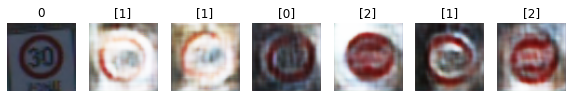

Epoch 21010 g_loss= 1.5801007 d_loss= 0.28740266 real_acc= 0.92 fake_acc= 0.9
Epoch 21020 g_loss= 1.7543688 d_loss= 0.2804173 real_acc= 0.94 fake_acc= 0.9
Epoch 21030 g_loss= 1.9231708 d_loss= 0.21908134 real_acc= 0.94 fake_acc= 0.94
Epoch 21040 g_loss= 1.8294361 d_loss= 0.23257592 real_acc= 0.94 fake_acc= 0.94
Epoch 21050 g_loss= 1.8052378 d_loss= 0.24078536 real_acc= 0.94 fake_acc= 0.94
Epoch 21060 g_loss= 2.1015007 d_loss= 0.31929058 real_acc= 0.9 fake_acc= 0.92
Epoch 21070 g_loss= 2.1461866 d_loss= 0.23648462 real_acc= 0.9 fake_acc= 0.94
Epoch 21080 g_loss= 1.7445332 d_loss= 0.26891658 real_acc= 0.94 fake_acc= 0.9
Epoch 21090 g_loss= 1.9807556 d_loss= 0.34931976 real_acc= 0.8 fake_acc= 0.86
Epoch 21100 g_loss= 2.4282186 d_loss= 0.24352065 real_acc= 0.84 fake_acc= 1.0


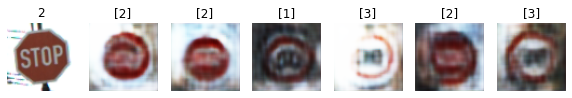

Epoch 21110 g_loss= 2.03262 d_loss= 0.3428045 real_acc= 0.86 fake_acc= 0.9
Epoch 21120 g_loss= 1.6659448 d_loss= 0.36665833 real_acc= 0.92 fake_acc= 0.76
Epoch 21130 g_loss= 1.6850548 d_loss= 0.25834936 real_acc= 0.94 fake_acc= 0.86
Epoch 21140 g_loss= 2.1649773 d_loss= 0.30065283 real_acc= 0.86 fake_acc= 0.96
Epoch 21150 g_loss= 1.868017 d_loss= 0.33244383 real_acc= 0.88 fake_acc= 0.94
Epoch 21160 g_loss= 2.1202254 d_loss= 0.3212393 real_acc= 0.86 fake_acc= 0.94
Epoch 21170 g_loss= 1.4961522 d_loss= 0.3602966 real_acc= 0.94 fake_acc= 0.82
Epoch 21180 g_loss= 1.9822038 d_loss= 0.27317208 real_acc= 0.84 fake_acc= 0.98
Epoch 21190 g_loss= 1.9011164 d_loss= 0.32050174 real_acc= 0.86 fake_acc= 0.9
Epoch 21200 g_loss= 1.6594741 d_loss= 0.30580038 real_acc= 0.9 fake_acc= 0.84


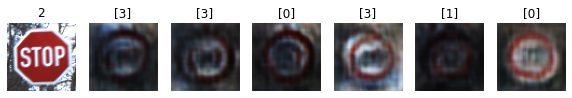

Epoch 21210 g_loss= 1.984541 d_loss= 0.32976252 real_acc= 0.72 fake_acc= 0.98
Epoch 21220 g_loss= 1.529589 d_loss= 0.35345978 real_acc= 0.88 fake_acc= 0.8
Epoch 21230 g_loss= 1.7194078 d_loss= 0.26534048 real_acc= 0.92 fake_acc= 0.88
Epoch 21240 g_loss= 2.0860155 d_loss= 0.20189622 real_acc= 0.96 fake_acc= 0.98
Epoch 21250 g_loss= 1.7603875 d_loss= 0.29640618 real_acc= 0.92 fake_acc= 0.96
Epoch 21260 g_loss= 2.0785134 d_loss= 0.30248773 real_acc= 0.86 fake_acc= 0.94
Epoch 21270 g_loss= 1.8833886 d_loss= 0.27221626 real_acc= 0.94 fake_acc= 0.94
Epoch 21280 g_loss= 2.1092174 d_loss= 0.23113966 real_acc= 0.92 fake_acc= 0.96
Epoch 21290 g_loss= 1.8118086 d_loss= 0.2898832 real_acc= 0.94 fake_acc= 0.92
Epoch 21300 g_loss= 2.1037498 d_loss= 0.22332495 real_acc= 0.92 fake_acc= 0.98


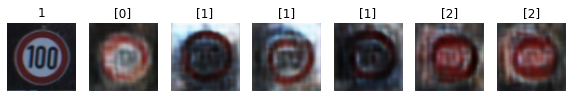

Epoch 21310 g_loss= 1.8801811 d_loss= 0.2629922 real_acc= 0.9 fake_acc= 0.94
Epoch 21320 g_loss= 1.66857 d_loss= 0.32506588 real_acc= 0.82 fake_acc= 0.94
Epoch 21330 g_loss= 2.0666792 d_loss= 0.29138842 real_acc= 0.88 fake_acc= 0.9
Epoch 21340 g_loss= 1.8719871 d_loss= 0.25895685 real_acc= 0.9 fake_acc= 0.92
Epoch 21350 g_loss= 1.7689704 d_loss= 0.29331124 real_acc= 0.92 fake_acc= 0.9
Epoch 21360 g_loss= 1.794624 d_loss= 0.2639168 real_acc= 0.88 fake_acc= 0.96
Epoch 21370 g_loss= 2.003892 d_loss= 0.28867516 real_acc= 0.88 fake_acc= 0.96
Epoch 21380 g_loss= 1.7633832 d_loss= 0.2641223 real_acc= 0.94 fake_acc= 0.92
Epoch 21390 g_loss= 1.7505023 d_loss= 0.3329991 real_acc= 0.86 fake_acc= 0.92
Epoch 21400 g_loss= 2.0843248 d_loss= 0.29141986 real_acc= 0.86 fake_acc= 0.9


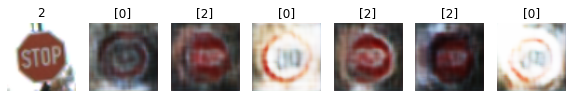

Epoch 21410 g_loss= 1.6624842 d_loss= 0.2622036 real_acc= 0.96 fake_acc= 0.86
Epoch 21420 g_loss= 2.0697997 d_loss= 0.23139828 real_acc= 0.9 fake_acc= 0.96
Epoch 21430 g_loss= 1.9202285 d_loss= 0.29759762 real_acc= 0.84 fake_acc= 0.92
Epoch 21440 g_loss= 2.2946362 d_loss= 0.31638587 real_acc= 0.76 fake_acc= 0.98
Epoch 21450 g_loss= 2.2269926 d_loss= 0.30001512 real_acc= 0.88 fake_acc= 0.98
Epoch 21460 g_loss= 1.525433 d_loss= 0.3599997 real_acc= 0.84 fake_acc= 0.86
Epoch 21470 g_loss= 1.7783769 d_loss= 0.31572288 real_acc= 0.84 fake_acc= 0.9
Epoch 21480 g_loss= 2.3050573 d_loss= 0.32767004 real_acc= 0.76 fake_acc= 1.0
Epoch 21490 g_loss= 1.7937769 d_loss= 0.2593278 real_acc= 0.96 fake_acc= 0.92
Epoch 21500 g_loss= 1.3967826 d_loss= 0.37972504 real_acc= 0.92 fake_acc= 0.74


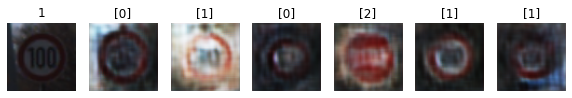

Epoch 21510 g_loss= 2.007798 d_loss= 0.2982903 real_acc= 0.92 fake_acc= 0.96
Epoch 21520 g_loss= 1.7131747 d_loss= 0.24211493 real_acc= 0.94 fake_acc= 0.88
Epoch 21530 g_loss= 2.0987387 d_loss= 0.23384175 real_acc= 0.94 fake_acc= 0.98
Epoch 21540 g_loss= 2.084959 d_loss= 0.2663316 real_acc= 0.92 fake_acc= 0.9
Epoch 21550 g_loss= 1.5833606 d_loss= 0.33599085 real_acc= 0.94 fake_acc= 0.82
Epoch 21560 g_loss= 2.02991 d_loss= 0.2986521 real_acc= 0.86 fake_acc= 0.94
Epoch 21570 g_loss= 2.3774116 d_loss= 0.33932555 real_acc= 0.76 fake_acc= 0.96
Epoch 21580 g_loss= 2.0162764 d_loss= 0.30128688 real_acc= 0.9 fake_acc= 0.9
Epoch 21590 g_loss= 2.1000957 d_loss= 0.25842136 real_acc= 0.9 fake_acc= 0.94
Epoch 21600 g_loss= 1.3117877 d_loss= 0.35829067 real_acc= 0.94 fake_acc= 0.74


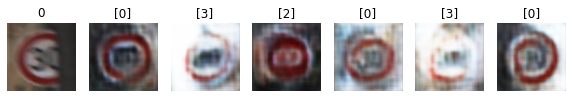

Epoch 21610 g_loss= 2.0380063 d_loss= 0.21818514 real_acc= 0.94 fake_acc= 0.94
Epoch 21620 g_loss= 1.69612 d_loss= 0.36995435 real_acc= 0.92 fake_acc= 0.92
Epoch 21630 g_loss= 2.1695402 d_loss= 0.28033584 real_acc= 0.88 fake_acc= 0.94
Epoch 21640 g_loss= 2.0396974 d_loss= 0.2550515 real_acc= 0.9 fake_acc= 0.9
Epoch 21650 g_loss= 2.090637 d_loss= 0.28995246 real_acc= 0.86 fake_acc= 0.96
Epoch 21660 g_loss= 1.6715605 d_loss= 0.2846527 real_acc= 0.96 fake_acc= 0.82
Epoch 21670 g_loss= 1.7350992 d_loss= 0.27349257 real_acc= 0.94 fake_acc= 0.92
Epoch 21680 g_loss= 2.0160904 d_loss= 0.2707464 real_acc= 0.9 fake_acc= 0.9
Epoch 21690 g_loss= 2.262029 d_loss= 0.33601397 real_acc= 0.74 fake_acc= 0.98
Epoch 21700 g_loss= 1.9219784 d_loss= 0.2730432 real_acc= 0.9 fake_acc= 0.92


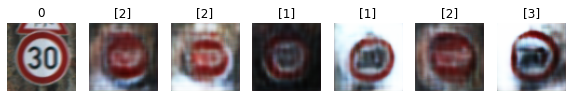

Epoch 21710 g_loss= 1.8139223 d_loss= 0.30146852 real_acc= 0.92 fake_acc= 0.86
Epoch 21720 g_loss= 2.1285532 d_loss= 0.26458362 real_acc= 0.88 fake_acc= 0.94
Epoch 21730 g_loss= 1.8397723 d_loss= 0.25300083 real_acc= 0.94 fake_acc= 0.94
Epoch 21740 g_loss= 2.1617227 d_loss= 0.35961404 real_acc= 0.8 fake_acc= 0.98
Epoch 21750 g_loss= 1.8531063 d_loss= 0.32566345 real_acc= 0.88 fake_acc= 0.9
Epoch 21760 g_loss= 1.8347802 d_loss= 0.35870156 real_acc= 0.78 fake_acc= 0.92
Epoch 21770 g_loss= 1.680428 d_loss= 0.32980916 real_acc= 0.84 fake_acc= 0.88
Epoch 21780 g_loss= 1.9859014 d_loss= 0.29160544 real_acc= 0.86 fake_acc= 0.96
Epoch 21790 g_loss= 1.8859048 d_loss= 0.23849069 real_acc= 0.94 fake_acc= 0.96
Epoch 21800 g_loss= 2.3251674 d_loss= 0.28202954 real_acc= 0.88 fake_acc= 0.98


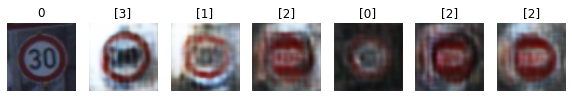

Epoch 21810 g_loss= 1.9006758 d_loss= 0.3307147 real_acc= 0.88 fake_acc= 0.88
Epoch 21820 g_loss= 1.6299864 d_loss= 0.331363 real_acc= 0.9 fake_acc= 0.86
Epoch 21830 g_loss= 1.7555952 d_loss= 0.27707458 real_acc= 0.92 fake_acc= 0.92
Epoch 21840 g_loss= 2.1983454 d_loss= 0.26668206 real_acc= 0.86 fake_acc= 1.0
Epoch 21850 g_loss= 2.1520941 d_loss= 0.33857906 real_acc= 0.86 fake_acc= 0.92
Epoch 21860 g_loss= 1.9829211 d_loss= 0.29891944 real_acc= 0.88 fake_acc= 0.96
Epoch 21870 g_loss= 1.9235681 d_loss= 0.23850194 real_acc= 0.92 fake_acc= 0.9
Epoch 21880 g_loss= 2.3467572 d_loss= 0.27781403 real_acc= 0.86 fake_acc= 0.94
Epoch 21890 g_loss= 1.9237106 d_loss= 0.25776833 real_acc= 0.9 fake_acc= 0.84
Epoch 21900 g_loss= 1.5126648 d_loss= 0.31139082 real_acc= 0.92 fake_acc= 0.92


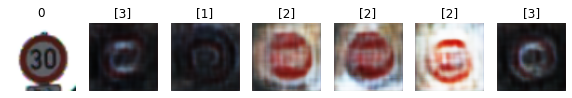

Epoch 21910 g_loss= 1.6109642 d_loss= 0.2707444 real_acc= 0.98 fake_acc= 0.9
Epoch 21920 g_loss= 2.1658993 d_loss= 0.2932779 real_acc= 0.82 fake_acc= 0.96
Epoch 21930 g_loss= 2.1010365 d_loss= 0.31840372 real_acc= 0.82 fake_acc= 0.94
Epoch 21940 g_loss= 1.806355 d_loss= 0.27630544 real_acc= 0.94 fake_acc= 0.9
Epoch 21950 g_loss= 1.6687036 d_loss= 0.30839643 real_acc= 0.88 fake_acc= 0.86
Epoch 21960 g_loss= 2.0160315 d_loss= 0.2726503 real_acc= 0.9 fake_acc= 0.9
Epoch 21970 g_loss= 2.3570523 d_loss= 0.26056495 real_acc= 0.84 fake_acc= 0.96
Epoch 21980 g_loss= 1.8251439 d_loss= 0.27410284 real_acc= 0.88 fake_acc= 0.98
Epoch 21990 g_loss= 1.9524372 d_loss= 0.23577677 real_acc= 0.92 fake_acc= 0.94
Epoch 22000 g_loss= 2.233521 d_loss= 0.23800844 real_acc= 0.88 fake_acc= 0.96


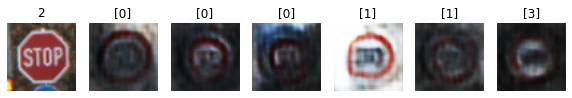

Epoch 22010 g_loss= 1.5451846 d_loss= 0.34477472 real_acc= 0.84 fake_acc= 0.84
Epoch 22020 g_loss= 1.8476807 d_loss= 0.33193678 real_acc= 0.8 fake_acc= 0.98
Epoch 22030 g_loss= 1.6412194 d_loss= 0.3170079 real_acc= 0.82 fake_acc= 0.88
Epoch 22040 g_loss= 2.098307 d_loss= 0.23561901 real_acc= 0.94 fake_acc= 0.96
Epoch 22050 g_loss= 2.0804021 d_loss= 0.25155792 real_acc= 0.9 fake_acc= 0.96
Epoch 22060 g_loss= 1.5644236 d_loss= 0.28573582 real_acc= 0.96 fake_acc= 0.86
Epoch 22070 g_loss= 1.8261137 d_loss= 0.26808953 real_acc= 0.9 fake_acc= 0.96
Epoch 22080 g_loss= 2.1176908 d_loss= 0.31363568 real_acc= 0.8 fake_acc= 0.94
Epoch 22090 g_loss= 1.8116096 d_loss= 0.2883438 real_acc= 0.88 fake_acc= 0.94
Epoch 22100 g_loss= 1.9988732 d_loss= 0.3248609 real_acc= 0.8 fake_acc= 0.9


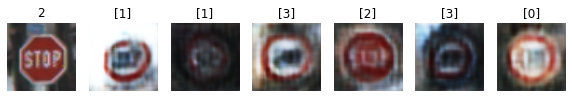

Epoch 22110 g_loss= 1.579628 d_loss= 0.26719397 real_acc= 0.94 fake_acc= 0.84
Epoch 22120 g_loss= 2.2321174 d_loss= 0.26880613 real_acc= 0.9 fake_acc= 0.94
Epoch 22130 g_loss= 1.8102907 d_loss= 0.27129865 real_acc= 0.88 fake_acc= 0.94
Epoch 22140 g_loss= 2.0840468 d_loss= 0.45696738 real_acc= 0.74 fake_acc= 0.9
Epoch 22150 g_loss= 1.9611466 d_loss= 0.2943122 real_acc= 0.88 fake_acc= 0.94
Epoch 22160 g_loss= 1.6341434 d_loss= 0.2925072 real_acc= 0.94 fake_acc= 0.82
Epoch 22170 g_loss= 1.9036719 d_loss= 0.25645363 real_acc= 0.96 fake_acc= 0.98
Epoch 22180 g_loss= 1.5914803 d_loss= 0.3453967 real_acc= 0.84 fake_acc= 0.9
Epoch 22190 g_loss= 1.860558 d_loss= 0.29296964 real_acc= 0.9 fake_acc= 0.88
Epoch 22200 g_loss= 2.2506478 d_loss= 0.29833162 real_acc= 0.84 fake_acc= 0.96


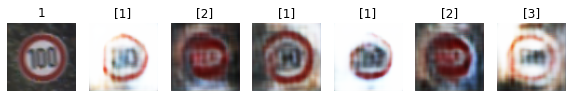

Epoch 22210 g_loss= 1.8203957 d_loss= 0.2594023 real_acc= 0.92 fake_acc= 0.94
Epoch 22220 g_loss= 1.7788068 d_loss= 0.3435796 real_acc= 0.9 fake_acc= 0.9
Epoch 22230 g_loss= 1.9459065 d_loss= 0.30167538 real_acc= 0.86 fake_acc= 0.96
Epoch 22240 g_loss= 2.0364344 d_loss= 0.25084168 real_acc= 0.92 fake_acc= 0.94
Epoch 22250 g_loss= 1.6798096 d_loss= 0.3053917 real_acc= 0.92 fake_acc= 0.86
Epoch 22260 g_loss= 2.0223765 d_loss= 0.2375409 real_acc= 0.96 fake_acc= 0.94
Epoch 22270 g_loss= 2.2446368 d_loss= 0.2736086 real_acc= 0.92 fake_acc= 0.94
Epoch 22280 g_loss= 2.1704793 d_loss= 0.29551253 real_acc= 0.78 fake_acc= 0.96
Epoch 22290 g_loss= 2.0860796 d_loss= 0.27908087 real_acc= 0.84 fake_acc= 0.98
Epoch 22300 g_loss= 2.0281034 d_loss= 0.226724 real_acc= 0.96 fake_acc= 0.88


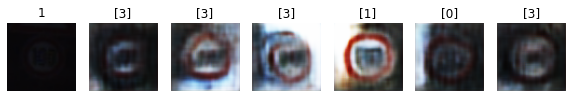

Epoch 22310 g_loss= 1.6492368 d_loss= 0.27102858 real_acc= 0.98 fake_acc= 0.92
Epoch 22320 g_loss= 1.7347778 d_loss= 0.28697947 real_acc= 0.88 fake_acc= 0.9
Epoch 22330 g_loss= 2.045073 d_loss= 0.3160318 real_acc= 0.78 fake_acc= 0.96
Epoch 22340 g_loss= 1.7983606 d_loss= 0.28662166 real_acc= 0.88 fake_acc= 0.9
Epoch 22350 g_loss= 1.8172965 d_loss= 0.2868616 real_acc= 0.9 fake_acc= 0.94
Epoch 22360 g_loss= 2.0180035 d_loss= 0.27463287 real_acc= 0.88 fake_acc= 0.98
Epoch 22370 g_loss= 1.4694145 d_loss= 0.35137585 real_acc= 0.84 fake_acc= 0.78
Epoch 22380 g_loss= 1.7309427 d_loss= 0.28211504 real_acc= 0.94 fake_acc= 0.82
Epoch 22390 g_loss= 1.5103278 d_loss= 0.35918507 real_acc= 0.9 fake_acc= 0.86
Epoch 22400 g_loss= 2.2001987 d_loss= 0.27330163 real_acc= 0.86 fake_acc= 0.94


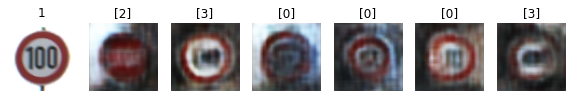

Epoch 22410 g_loss= 1.8251445 d_loss= 0.23308516 real_acc= 0.94 fake_acc= 0.96
Epoch 22420 g_loss= 1.7675118 d_loss= 0.2730162 real_acc= 0.92 fake_acc= 0.9
Epoch 22430 g_loss= 2.099275 d_loss= 0.24843484 real_acc= 0.9 fake_acc= 0.94
Epoch 22440 g_loss= 1.7388111 d_loss= 0.28608763 real_acc= 0.86 fake_acc= 0.88
Epoch 22450 g_loss= 2.1167402 d_loss= 0.24682242 real_acc= 0.92 fake_acc= 0.92
Epoch 22460 g_loss= 1.8688927 d_loss= 0.3208456 real_acc= 0.84 fake_acc= 0.9
Epoch 22470 g_loss= 1.7823954 d_loss= 0.33728033 real_acc= 0.88 fake_acc= 0.9
Epoch 22480 g_loss= 1.5408947 d_loss= 0.26846775 real_acc= 0.96 fake_acc= 0.88
Epoch 22490 g_loss= 2.018707 d_loss= 0.3069259 real_acc= 0.86 fake_acc= 0.96
Epoch 22500 g_loss= 2.1581855 d_loss= 0.2713349 real_acc= 0.86 fake_acc= 0.96


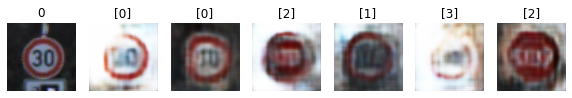

Epoch 22510 g_loss= 1.3693297 d_loss= 0.31652242 real_acc= 0.94 fake_acc= 0.82
Epoch 22520 g_loss= 1.7526773 d_loss= 0.31506324 real_acc= 0.86 fake_acc= 0.88
Epoch 22530 g_loss= 2.1684341 d_loss= 0.22681609 real_acc= 0.92 fake_acc= 0.96
Epoch 22540 g_loss= 2.2850428 d_loss= 0.2655056 real_acc= 0.84 fake_acc= 0.96
Epoch 22550 g_loss= 2.2520032 d_loss= 0.27640545 real_acc= 0.84 fake_acc= 0.98
Epoch 22560 g_loss= 1.7747018 d_loss= 0.27973464 real_acc= 0.92 fake_acc= 0.88
Epoch 22570 g_loss= 1.6299999 d_loss= 0.31642374 real_acc= 0.96 fake_acc= 0.78
Epoch 22580 g_loss= 1.6071794 d_loss= 0.32814145 real_acc= 0.92 fake_acc= 0.78
Epoch 22590 g_loss= 2.0749593 d_loss= 0.23270866 real_acc= 0.94 fake_acc= 0.98
Epoch 22600 g_loss= 2.4630983 d_loss= 0.27051568 real_acc= 0.84 fake_acc= 0.96


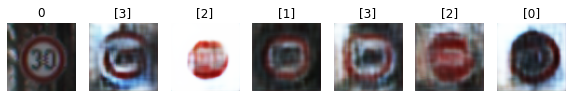

Epoch 22610 g_loss= 2.1802888 d_loss= 0.34444967 real_acc= 0.82 fake_acc= 0.94
Epoch 22620 g_loss= 1.6395313 d_loss= 0.28017876 real_acc= 0.88 fake_acc= 0.96
Epoch 22630 g_loss= 1.8577118 d_loss= 0.2735564 real_acc= 0.86 fake_acc= 0.94
Epoch 22640 g_loss= 1.9221787 d_loss= 0.30225813 real_acc= 0.86 fake_acc= 0.92
Epoch 22650 g_loss= 2.1932938 d_loss= 0.33652768 real_acc= 0.78 fake_acc= 0.98
Epoch 22660 g_loss= 2.3862236 d_loss= 0.28653446 real_acc= 0.84 fake_acc= 1.0
Epoch 22670 g_loss= 1.9201529 d_loss= 0.27443692 real_acc= 0.86 fake_acc= 0.94
Epoch 22680 g_loss= 1.6910383 d_loss= 0.378055 real_acc= 0.82 fake_acc= 0.88
Epoch 22690 g_loss= 1.7188667 d_loss= 0.2719617 real_acc= 0.96 fake_acc= 0.9
Epoch 22700 g_loss= 1.7957982 d_loss= 0.30961883 real_acc= 0.88 fake_acc= 0.9


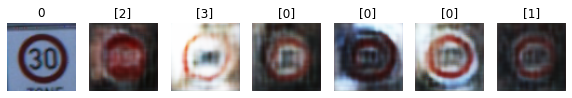

Epoch 22710 g_loss= 2.0434697 d_loss= 0.22859603 real_acc= 0.92 fake_acc= 0.92
Epoch 22720 g_loss= 1.748196 d_loss= 0.374524 real_acc= 0.78 fake_acc= 0.9
Epoch 22730 g_loss= 2.176239 d_loss= 0.27741888 real_acc= 0.88 fake_acc= 0.96
Epoch 22740 g_loss= 1.7443976 d_loss= 0.26052922 real_acc= 0.96 fake_acc= 0.9
Epoch 22750 g_loss= 1.9023275 d_loss= 0.29910302 real_acc= 0.88 fake_acc= 0.92
Epoch 22760 g_loss= 2.4578512 d_loss= 0.2714457 real_acc= 0.88 fake_acc= 0.96
Epoch 22770 g_loss= 1.9348487 d_loss= 0.31203908 real_acc= 0.9 fake_acc= 0.96
Epoch 22780 g_loss= 1.7099339 d_loss= 0.26689976 real_acc= 0.92 fake_acc= 0.88
Epoch 22790 g_loss= 1.6749607 d_loss= 0.3043666 real_acc= 0.88 fake_acc= 0.94
Epoch 22800 g_loss= 1.8269893 d_loss= 0.2763014 real_acc= 0.92 fake_acc= 0.88


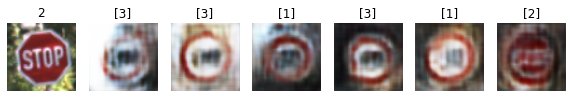

Epoch 22810 g_loss= 1.8103245 d_loss= 0.2760992 real_acc= 0.88 fake_acc= 0.94
Epoch 22820 g_loss= 2.0108478 d_loss= 0.24858767 real_acc= 0.94 fake_acc= 0.9
Epoch 22830 g_loss= 1.8399951 d_loss= 0.2923035 real_acc= 0.86 fake_acc= 0.9
Epoch 22840 g_loss= 2.2314587 d_loss= 0.3009547 real_acc= 0.8 fake_acc= 0.88
Epoch 22850 g_loss= 1.6708038 d_loss= 0.29907566 real_acc= 0.9 fake_acc= 0.88
Epoch 22860 g_loss= 1.7592055 d_loss= 0.2847982 real_acc= 0.92 fake_acc= 0.92
Epoch 22870 g_loss= 2.4059052 d_loss= 0.30736056 real_acc= 0.82 fake_acc= 1.0
Epoch 22880 g_loss= 1.5457021 d_loss= 0.26518792 real_acc= 0.96 fake_acc= 0.78
Epoch 22890 g_loss= 1.8249657 d_loss= 0.30437952 real_acc= 0.9 fake_acc= 0.92
Epoch 22900 g_loss= 1.9699086 d_loss= 0.31279024 real_acc= 0.8 fake_acc= 0.94


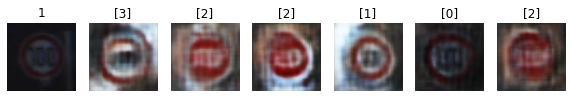

Epoch 22910 g_loss= 1.6221482 d_loss= 0.3496167 real_acc= 0.96 fake_acc= 0.8
Epoch 22920 g_loss= 1.7980549 d_loss= 0.36815614 real_acc= 0.82 fake_acc= 0.92
Epoch 22930 g_loss= 1.4559627 d_loss= 0.35659492 real_acc= 0.88 fake_acc= 0.86
Epoch 22940 g_loss= 1.8854272 d_loss= 0.26320437 real_acc= 0.9 fake_acc= 0.9
Epoch 22950 g_loss= 2.1796653 d_loss= 0.23933913 real_acc= 0.9 fake_acc= 0.92
Epoch 22960 g_loss= 2.4055955 d_loss= 0.28787956 real_acc= 0.84 fake_acc= 1.0
Epoch 22970 g_loss= 1.7519178 d_loss= 0.2769742 real_acc= 0.9 fake_acc= 0.92
Epoch 22980 g_loss= 1.9311099 d_loss= 0.30782384 real_acc= 0.88 fake_acc= 0.96
Epoch 22990 g_loss= 1.603515 d_loss= 0.29895905 real_acc= 0.94 fake_acc= 0.94
Epoch 23000 g_loss= 1.5693783 d_loss= 0.30597132 real_acc= 0.86 fake_acc= 0.88


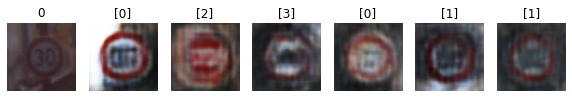

Epoch 23010 g_loss= 1.8198448 d_loss= 0.34946504 real_acc= 0.8 fake_acc= 0.9
Epoch 23020 g_loss= 2.303723 d_loss= 0.23961921 real_acc= 0.88 fake_acc= 0.96
Epoch 23030 g_loss= 1.6818238 d_loss= 0.2953674 real_acc= 0.88 fake_acc= 0.86
Epoch 23040 g_loss= 1.8786136 d_loss= 0.29104826 real_acc= 0.92 fake_acc= 0.98
Epoch 23050 g_loss= 2.1905842 d_loss= 0.27879396 real_acc= 0.84 fake_acc= 0.96
Epoch 23060 g_loss= 1.8038559 d_loss= 0.255666 real_acc= 0.98 fake_acc= 0.84
Epoch 23070 g_loss= 1.8634932 d_loss= 0.30369246 real_acc= 0.8 fake_acc= 0.9
Epoch 23080 g_loss= 1.6454953 d_loss= 0.29118258 real_acc= 0.9 fake_acc= 0.88
Epoch 23090 g_loss= 2.0911334 d_loss= 0.2506294 real_acc= 0.96 fake_acc= 0.94
Epoch 23100 g_loss= 2.0371592 d_loss= 0.31554648 real_acc= 0.88 fake_acc= 0.88


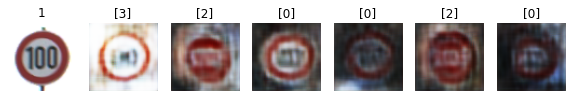

Epoch 23110 g_loss= 1.8027822 d_loss= 0.2959946 real_acc= 0.88 fake_acc= 0.84
Epoch 23120 g_loss= 2.0386345 d_loss= 0.26912796 real_acc= 0.9 fake_acc= 0.94
Epoch 23130 g_loss= 2.1217258 d_loss= 0.28139088 real_acc= 0.84 fake_acc= 0.94
Epoch 23140 g_loss= 1.9281231 d_loss= 0.31349838 real_acc= 0.82 fake_acc= 0.92
Epoch 23150 g_loss= 1.823505 d_loss= 0.2645404 real_acc= 0.94 fake_acc= 0.98
Epoch 23160 g_loss= 1.8390436 d_loss= 0.2664917 real_acc= 0.9 fake_acc= 0.94
Epoch 23170 g_loss= 1.8629136 d_loss= 0.3129201 real_acc= 0.9 fake_acc= 0.88
Epoch 23180 g_loss= 1.9861827 d_loss= 0.24785005 real_acc= 0.96 fake_acc= 0.88
Epoch 23190 g_loss= 1.9314748 d_loss= 0.29497433 real_acc= 0.84 fake_acc= 0.98
Epoch 23200 g_loss= 2.038065 d_loss= 0.27168328 real_acc= 0.9 fake_acc= 0.88


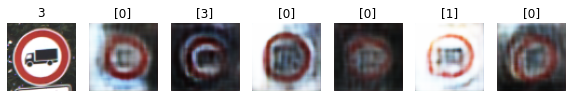

Epoch 23210 g_loss= 2.391323 d_loss= 0.2898846 real_acc= 0.82 fake_acc= 1.0
Epoch 23220 g_loss= 1.8604856 d_loss= 0.22112581 real_acc= 0.94 fake_acc= 0.94
Epoch 23230 g_loss= 1.9569817 d_loss= 0.28591537 real_acc= 0.86 fake_acc= 0.92
Epoch 23240 g_loss= 2.131501 d_loss= 0.27800405 real_acc= 0.86 fake_acc= 0.96
Epoch 23250 g_loss= 2.1719034 d_loss= 0.24206246 real_acc= 0.9 fake_acc= 0.98
Epoch 23260 g_loss= 2.066111 d_loss= 0.21895632 real_acc= 0.94 fake_acc= 1.0
Epoch 23270 g_loss= 1.6768945 d_loss= 0.26144275 real_acc= 0.94 fake_acc= 0.86
Epoch 23280 g_loss= 2.0976124 d_loss= 0.23117849 real_acc= 0.94 fake_acc= 0.98
Epoch 23290 g_loss= 1.824854 d_loss= 0.27380916 real_acc= 0.92 fake_acc= 0.88
Epoch 23300 g_loss= 2.0793254 d_loss= 0.24740835 real_acc= 0.92 fake_acc= 0.96


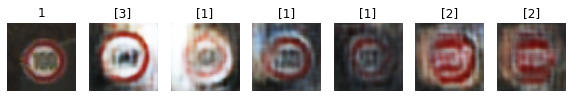

Epoch 23310 g_loss= 1.9525927 d_loss= 0.28918493 real_acc= 0.84 fake_acc= 0.96
Epoch 23320 g_loss= 1.8751171 d_loss= 0.3012004 real_acc= 0.86 fake_acc= 0.92
Epoch 23330 g_loss= 1.685016 d_loss= 0.25197357 real_acc= 0.98 fake_acc= 0.96
Epoch 23340 g_loss= 1.3023692 d_loss= 0.2832207 real_acc= 1.0 fake_acc= 0.76
Epoch 23350 g_loss= 1.9540815 d_loss= 0.2950756 real_acc= 0.86 fake_acc= 0.96
Epoch 23360 g_loss= 2.457173 d_loss= 0.3216643 real_acc= 0.82 fake_acc= 0.98
Epoch 23370 g_loss= 2.6773713 d_loss= 0.3437088 real_acc= 0.74 fake_acc= 1.0
Epoch 23380 g_loss= 1.9495687 d_loss= 0.27852866 real_acc= 0.88 fake_acc= 0.94
Epoch 23390 g_loss= 1.469181 d_loss= 0.3580635 real_acc= 0.86 fake_acc= 0.78
Epoch 23400 g_loss= 1.9202282 d_loss= 0.24155003 real_acc= 0.94 fake_acc= 0.94


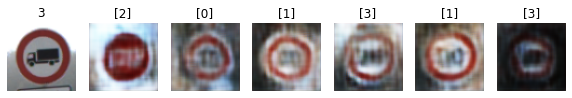

Epoch 23410 g_loss= 2.361762 d_loss= 0.29827344 real_acc= 0.82 fake_acc= 0.98
Epoch 23420 g_loss= 2.0453112 d_loss= 0.30164889 real_acc= 0.8 fake_acc= 0.92
Epoch 23430 g_loss= 1.6927582 d_loss= 0.26951104 real_acc= 0.92 fake_acc= 0.92
Epoch 23440 g_loss= 2.3352325 d_loss= 0.3303675 real_acc= 0.8 fake_acc= 0.98
Epoch 23450 g_loss= 2.0494192 d_loss= 0.24693412 real_acc= 0.88 fake_acc= 0.94
Epoch 23460 g_loss= 1.7411809 d_loss= 0.252218 real_acc= 0.92 fake_acc= 0.88
Epoch 23470 g_loss= 1.5171148 d_loss= 0.3560992 real_acc= 0.98 fake_acc= 0.8
Epoch 23480 g_loss= 1.6001285 d_loss= 0.25387585 real_acc= 0.98 fake_acc= 0.84
Epoch 23490 g_loss= 1.9517919 d_loss= 0.31841487 real_acc= 0.84 fake_acc= 0.94
Epoch 23500 g_loss= 2.2032914 d_loss= 0.3061383 real_acc= 0.8 fake_acc= 0.92


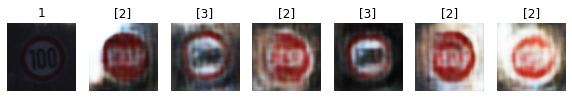

Epoch 23510 g_loss= 1.8999932 d_loss= 0.26364207 real_acc= 0.92 fake_acc= 0.9
Epoch 23520 g_loss= 1.9676082 d_loss= 0.27893803 real_acc= 0.86 fake_acc= 0.96
Epoch 23530 g_loss= 2.0394738 d_loss= 0.2641154 real_acc= 0.86 fake_acc= 0.9
Epoch 23540 g_loss= 1.8867269 d_loss= 0.3490161 real_acc= 0.86 fake_acc= 0.94
Epoch 23550 g_loss= 1.9100623 d_loss= 0.29220206 real_acc= 0.8 fake_acc= 0.94
Epoch 23560 g_loss= 1.899928 d_loss= 0.36761725 real_acc= 0.8 fake_acc= 0.92
Epoch 23570 g_loss= 1.9285389 d_loss= 0.23470137 real_acc= 0.92 fake_acc= 0.98
Epoch 23580 g_loss= 2.2352967 d_loss= 0.29978198 real_acc= 0.88 fake_acc= 0.98
Epoch 23590 g_loss= 1.9930707 d_loss= 0.27045327 real_acc= 0.9 fake_acc= 0.92
Epoch 23600 g_loss= 1.6410294 d_loss= 0.28876987 real_acc= 0.88 fake_acc= 0.88


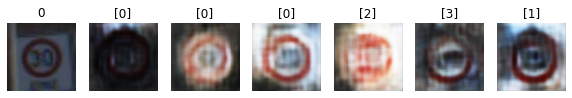

Epoch 23610 g_loss= 2.0837646 d_loss= 0.2590261 real_acc= 0.84 fake_acc= 0.98
Epoch 23620 g_loss= 2.015031 d_loss= 0.30108207 real_acc= 0.9 fake_acc= 0.94
Epoch 23630 g_loss= 1.9593573 d_loss= 0.25188172 real_acc= 0.94 fake_acc= 0.92
Epoch 23640 g_loss= 2.424095 d_loss= 0.26474294 real_acc= 0.84 fake_acc= 0.98
Epoch 23650 g_loss= 1.7124183 d_loss= 0.2649348 real_acc= 0.96 fake_acc= 0.9
Epoch 23660 g_loss= 1.5882192 d_loss= 0.3173458 real_acc= 0.86 fake_acc= 0.84
Epoch 23670 g_loss= 1.9452416 d_loss= 0.2774671 real_acc= 0.88 fake_acc= 0.94
Epoch 23680 g_loss= 2.2634523 d_loss= 0.24732314 real_acc= 0.92 fake_acc= 0.96
Epoch 23690 g_loss= 1.875381 d_loss= 0.2534511 real_acc= 0.92 fake_acc= 0.98
Epoch 23700 g_loss= 1.6896231 d_loss= 0.2904712 real_acc= 0.96 fake_acc= 0.84


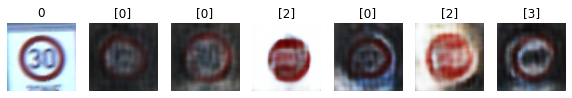

Epoch 23710 g_loss= 2.3103504 d_loss= 0.2440719 real_acc= 0.92 fake_acc= 0.98
Epoch 23720 g_loss= 2.0135279 d_loss= 0.28758895 real_acc= 0.9 fake_acc= 0.96
Epoch 23730 g_loss= 2.1114266 d_loss= 0.31729048 real_acc= 0.82 fake_acc= 0.92
Epoch 23740 g_loss= 1.7570761 d_loss= 0.29438078 real_acc= 0.9 fake_acc= 0.92
Epoch 23750 g_loss= 2.2780874 d_loss= 0.24464144 real_acc= 0.9 fake_acc= 1.0
Epoch 23760 g_loss= 2.2329116 d_loss= 0.2730177 real_acc= 0.82 fake_acc= 1.0
Epoch 23770 g_loss= 1.6885663 d_loss= 0.300377 real_acc= 0.96 fake_acc= 0.9
Epoch 23780 g_loss= 2.2565343 d_loss= 0.3131635 real_acc= 0.82 fake_acc= 0.96
Epoch 23790 g_loss= 2.0841346 d_loss= 0.22803515 real_acc= 0.92 fake_acc= 0.96
Epoch 23800 g_loss= 2.0926409 d_loss= 0.29148996 real_acc= 0.82 fake_acc= 0.96


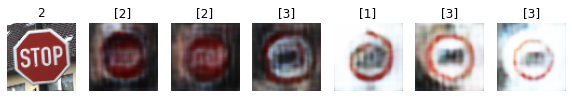

Epoch 23810 g_loss= 1.402218 d_loss= 0.31611118 real_acc= 0.94 fake_acc= 0.78
Epoch 23820 g_loss= 1.9214243 d_loss= 0.25486648 real_acc= 0.92 fake_acc= 0.9
Epoch 23830 g_loss= 1.6812016 d_loss= 0.324355 real_acc= 0.88 fake_acc= 0.84
Epoch 23840 g_loss= 1.7425777 d_loss= 0.30935004 real_acc= 0.9 fake_acc= 0.86
Epoch 23850 g_loss= 2.7236674 d_loss= 0.34853128 real_acc= 0.72 fake_acc= 1.0
Epoch 23860 g_loss= 1.810381 d_loss= 0.2697153 real_acc= 0.88 fake_acc= 0.92
Epoch 23870 g_loss= 1.9267502 d_loss= 0.25777245 real_acc= 0.94 fake_acc= 0.98
Epoch 23880 g_loss= 2.0434027 d_loss= 0.29807812 real_acc= 0.82 fake_acc= 0.92
Epoch 23890 g_loss= 1.700409 d_loss= 0.31376135 real_acc= 0.9 fake_acc= 0.86
Epoch 23900 g_loss= 1.6797789 d_loss= 0.31706345 real_acc= 0.84 fake_acc= 0.92


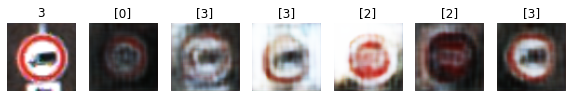

Epoch 23910 g_loss= 1.5852796 d_loss= 0.332075 real_acc= 0.9 fake_acc= 0.86
Epoch 23920 g_loss= 2.0848298 d_loss= 0.2380897 real_acc= 0.9 fake_acc= 0.92
Epoch 23930 g_loss= 2.3409207 d_loss= 0.24098739 real_acc= 0.9 fake_acc= 0.98
Epoch 23940 g_loss= 1.915441 d_loss= 0.33016616 real_acc= 0.84 fake_acc= 0.96
Epoch 23950 g_loss= 1.9881493 d_loss= 0.24856994 real_acc= 0.92 fake_acc= 0.92
Epoch 23960 g_loss= 2.2342935 d_loss= 0.31231147 real_acc= 0.84 fake_acc= 0.94
Epoch 23970 g_loss= 1.8999904 d_loss= 0.26806164 real_acc= 0.94 fake_acc= 0.9
Epoch 23980 g_loss= 1.9038773 d_loss= 0.23000136 real_acc= 0.96 fake_acc= 0.9
Epoch 23990 g_loss= 2.3693473 d_loss= 0.31075564 real_acc= 0.78 fake_acc= 0.98
Epoch 24000 g_loss= 2.7765582 d_loss= 0.25592238 real_acc= 0.84 fake_acc= 0.94


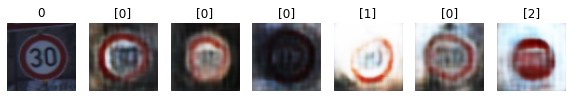

Epoch 24010 g_loss= 1.6834748 d_loss= 0.26363507 real_acc= 0.92 fake_acc= 0.92
Epoch 24020 g_loss= 1.8298111 d_loss= 0.25436082 real_acc= 0.9 fake_acc= 0.88
Epoch 24030 g_loss= 1.8012297 d_loss= 0.2870914 real_acc= 0.88 fake_acc= 0.9
Epoch 24040 g_loss= 1.7948654 d_loss= 0.24557808 real_acc= 0.92 fake_acc= 0.92
Epoch 24050 g_loss= 2.005389 d_loss= 0.2738155 real_acc= 0.96 fake_acc= 0.92
Epoch 24060 g_loss= 2.0012696 d_loss= 0.25600374 real_acc= 0.86 fake_acc= 0.98
Epoch 24070 g_loss= 1.6563787 d_loss= 0.3499739 real_acc= 0.92 fake_acc= 0.8
Epoch 24080 g_loss= 2.0148356 d_loss= 0.2895221 real_acc= 0.86 fake_acc= 0.96
Epoch 24090 g_loss= 1.5561206 d_loss= 0.30476198 real_acc= 0.9 fake_acc= 0.84
Epoch 24100 g_loss= 2.1569254 d_loss= 0.29108354 real_acc= 0.84 fake_acc= 0.96


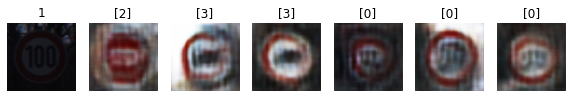

Epoch 24110 g_loss= 1.8344162 d_loss= 0.27515388 real_acc= 0.94 fake_acc= 0.92
Epoch 24120 g_loss= 2.0242193 d_loss= 0.32169798 real_acc= 0.78 fake_acc= 0.9
Epoch 24130 g_loss= 2.1053822 d_loss= 0.3256486 real_acc= 0.78 fake_acc= 0.94
Epoch 24140 g_loss= 1.7684332 d_loss= 0.27130193 real_acc= 0.92 fake_acc= 0.88
Epoch 24150 g_loss= 2.0207782 d_loss= 0.24192673 real_acc= 0.9 fake_acc= 0.98
Epoch 24160 g_loss= 2.3238158 d_loss= 0.25397095 real_acc= 0.86 fake_acc= 0.98
Epoch 24170 g_loss= 1.9699185 d_loss= 0.23225583 real_acc= 0.92 fake_acc= 0.92
Epoch 24180 g_loss= 1.9666736 d_loss= 0.3176381 real_acc= 0.82 fake_acc= 0.88
Epoch 24190 g_loss= 2.2792194 d_loss= 0.28183845 real_acc= 0.84 fake_acc= 0.96
Epoch 24200 g_loss= 1.9612387 d_loss= 0.22132583 real_acc= 0.9 fake_acc= 0.94


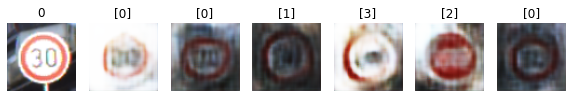

Epoch 24210 g_loss= 2.394789 d_loss= 0.2283619 real_acc= 0.86 fake_acc= 0.98
Epoch 24220 g_loss= 1.8846723 d_loss= 0.315466 real_acc= 0.86 fake_acc= 0.92
Epoch 24230 g_loss= 2.0894942 d_loss= 0.28517187 real_acc= 0.92 fake_acc= 0.92
Epoch 24240 g_loss= 1.9888108 d_loss= 0.25128812 real_acc= 0.9 fake_acc= 0.98
Epoch 24250 g_loss= 2.3332148 d_loss= 0.31506702 real_acc= 0.86 fake_acc= 0.96
Epoch 24260 g_loss= 1.7210251 d_loss= 0.27017552 real_acc= 0.92 fake_acc= 0.94
Epoch 24270 g_loss= 1.8978008 d_loss= 0.30435234 real_acc= 0.9 fake_acc= 0.92
Epoch 24280 g_loss= 2.046746 d_loss= 0.27353597 real_acc= 0.9 fake_acc= 0.92
Epoch 24290 g_loss= 2.0849047 d_loss= 0.2780156 real_acc= 0.86 fake_acc= 0.96
Epoch 24300 g_loss= 1.8858076 d_loss= 0.29979095 real_acc= 0.94 fake_acc= 0.88


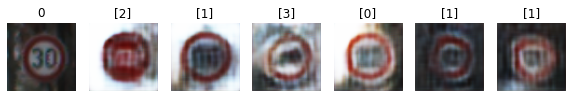

Epoch 24310 g_loss= 1.7451175 d_loss= 0.31312132 real_acc= 0.84 fake_acc= 0.9
Epoch 24320 g_loss= 2.0619392 d_loss= 0.23067197 real_acc= 0.96 fake_acc= 0.96
Epoch 24330 g_loss= 2.2146094 d_loss= 0.28089166 real_acc= 0.82 fake_acc= 0.96
Epoch 24340 g_loss= 2.074874 d_loss= 0.35293293 real_acc= 0.78 fake_acc= 0.98
Epoch 24350 g_loss= 1.8602643 d_loss= 0.2919721 real_acc= 0.9 fake_acc= 0.96
Epoch 24360 g_loss= 1.8907273 d_loss= 0.27800217 real_acc= 0.86 fake_acc= 0.94
Epoch 24370 g_loss= 2.317873 d_loss= 0.36291084 real_acc= 0.72 fake_acc= 0.98
Epoch 24380 g_loss= 1.4231822 d_loss= 0.30544358 real_acc= 0.94 fake_acc= 0.8
Epoch 24390 g_loss= 1.4911221 d_loss= 0.31830734 real_acc= 0.94 fake_acc= 0.86
Epoch 24400 g_loss= 2.002193 d_loss= 0.29613948 real_acc= 0.84 fake_acc= 0.86


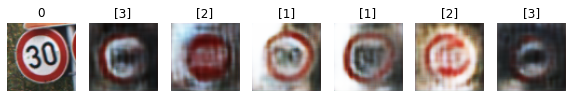

Epoch 24410 g_loss= 2.16563 d_loss= 0.24498335 real_acc= 0.96 fake_acc= 0.98
Epoch 24420 g_loss= 1.7053804 d_loss= 0.3046322 real_acc= 0.9 fake_acc= 0.88
Epoch 24430 g_loss= 1.4508688 d_loss= 0.31027085 real_acc= 0.92 fake_acc= 0.86
Epoch 24440 g_loss= 2.4568152 d_loss= 0.28610975 real_acc= 0.92 fake_acc= 0.96
Epoch 24450 g_loss= 2.4581885 d_loss= 0.19685332 real_acc= 0.96 fake_acc= 0.98
Epoch 24460 g_loss= 1.8006908 d_loss= 0.25702763 real_acc= 0.9 fake_acc= 0.96
Epoch 24470 g_loss= 1.7623504 d_loss= 0.2994579 real_acc= 0.88 fake_acc= 0.9
Epoch 24480 g_loss= 1.956937 d_loss= 0.26168898 real_acc= 0.9 fake_acc= 0.94
Epoch 24490 g_loss= 2.3932192 d_loss= 0.267596 real_acc= 0.84 fake_acc= 0.98
Epoch 24500 g_loss= 1.5820608 d_loss= 0.3106706 real_acc= 0.9 fake_acc= 0.9


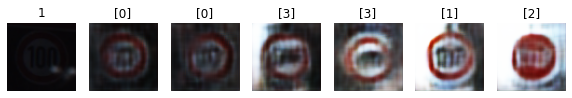

Epoch 24510 g_loss= 1.8970995 d_loss= 0.33483407 real_acc= 0.8 fake_acc= 0.94
Epoch 24520 g_loss= 1.8632618 d_loss= 0.26787186 real_acc= 0.86 fake_acc= 0.94
Epoch 24530 g_loss= 1.611134 d_loss= 0.30119804 real_acc= 0.88 fake_acc= 0.86
Epoch 24540 g_loss= 2.0849788 d_loss= 0.3457889 real_acc= 0.8 fake_acc= 0.92
Epoch 24550 g_loss= 2.260892 d_loss= 0.25392887 real_acc= 0.8 fake_acc= 0.98
Epoch 24560 g_loss= 1.7206486 d_loss= 0.29960677 real_acc= 0.9 fake_acc= 0.96
Epoch 24570 g_loss= 1.8156303 d_loss= 0.28747657 real_acc= 0.9 fake_acc= 0.92
Epoch 24580 g_loss= 2.1738665 d_loss= 0.2673635 real_acc= 0.88 fake_acc= 0.94
Epoch 24590 g_loss= 1.5689389 d_loss= 0.23001015 real_acc= 0.98 fake_acc= 0.88
Epoch 24600 g_loss= 2.1619241 d_loss= 0.2448707 real_acc= 0.86 fake_acc= 0.98


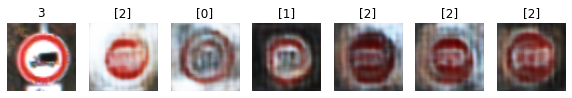

Epoch 24610 g_loss= 2.0907226 d_loss= 0.258865 real_acc= 0.84 fake_acc= 0.96
Epoch 24620 g_loss= 1.7711254 d_loss= 0.23283374 real_acc= 1.0 fake_acc= 0.92
Epoch 24630 g_loss= 2.6055694 d_loss= 0.23454626 real_acc= 0.82 fake_acc= 1.0
Epoch 24640 g_loss= 1.7213458 d_loss= 0.26978308 real_acc= 0.92 fake_acc= 0.84
Epoch 24650 g_loss= 1.851055 d_loss= 0.24756414 real_acc= 0.9 fake_acc= 0.96
Epoch 24660 g_loss= 2.1825137 d_loss= 0.25692657 real_acc= 0.86 fake_acc= 0.94
Epoch 24670 g_loss= 1.9643844 d_loss= 0.30510777 real_acc= 0.86 fake_acc= 0.92
Epoch 24680 g_loss= 2.0180478 d_loss= 0.35372135 real_acc= 0.8 fake_acc= 0.94
Epoch 24690 g_loss= 1.6428626 d_loss= 0.29460704 real_acc= 0.86 fake_acc= 0.86
Epoch 24700 g_loss= 1.3981748 d_loss= 0.28781268 real_acc= 0.96 fake_acc= 0.8


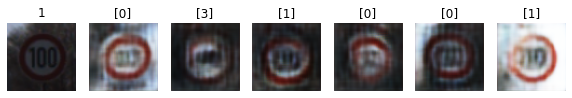

Epoch 24710 g_loss= 2.1164274 d_loss= 0.2478578 real_acc= 0.92 fake_acc= 0.98
Epoch 24720 g_loss= 2.9469738 d_loss= 0.32886693 real_acc= 0.72 fake_acc= 0.98
Epoch 24730 g_loss= 2.0950282 d_loss= 0.26834607 real_acc= 0.92 fake_acc= 0.96
Epoch 24740 g_loss= 1.5616765 d_loss= 0.27261963 real_acc= 0.9 fake_acc= 0.86
Epoch 24750 g_loss= 2.0131207 d_loss= 0.24818894 real_acc= 0.88 fake_acc= 0.98
Epoch 24760 g_loss= 2.5935168 d_loss= 0.21459892 real_acc= 0.92 fake_acc= 1.0
Epoch 24770 g_loss= 2.1193748 d_loss= 0.28112188 real_acc= 0.84 fake_acc= 0.9
Epoch 24780 g_loss= 2.0112464 d_loss= 0.2806874 real_acc= 0.84 fake_acc= 0.94
Epoch 24790 g_loss= 1.3463403 d_loss= 0.31609684 real_acc= 0.94 fake_acc= 0.74
Epoch 24800 g_loss= 1.7463315 d_loss= 0.28352678 real_acc= 0.94 fake_acc= 0.96


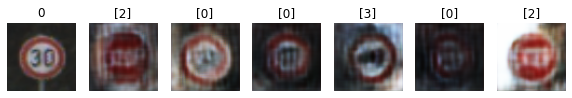

Epoch 24810 g_loss= 2.026331 d_loss= 0.28963464 real_acc= 0.86 fake_acc= 0.98
Epoch 24820 g_loss= 2.087128 d_loss= 0.2737956 real_acc= 0.86 fake_acc= 0.96
Epoch 24830 g_loss= 2.0099123 d_loss= 0.27305052 real_acc= 0.92 fake_acc= 0.98
Epoch 24840 g_loss= 2.2229285 d_loss= 0.21164528 real_acc= 0.92 fake_acc= 0.92
Epoch 24850 g_loss= 2.407137 d_loss= 0.27624124 real_acc= 0.82 fake_acc= 0.98
Epoch 24860 g_loss= 2.0465734 d_loss= 0.3213383 real_acc= 0.8 fake_acc= 0.88
Epoch 24870 g_loss= 1.8302066 d_loss= 0.25513077 real_acc= 0.96 fake_acc= 0.88
Epoch 24880 g_loss= 2.4113576 d_loss= 0.24185963 real_acc= 0.88 fake_acc= 0.96
Epoch 24890 g_loss= 1.7987075 d_loss= 0.26712245 real_acc= 0.92 fake_acc= 0.9
Epoch 24900 g_loss= 1.6731621 d_loss= 0.2699139 real_acc= 0.9 fake_acc= 0.88


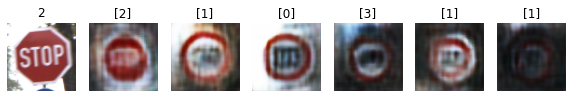

Epoch 24910 g_loss= 1.7991606 d_loss= 0.2716626 real_acc= 0.92 fake_acc= 0.94
Epoch 24920 g_loss= 2.057079 d_loss= 0.26740766 real_acc= 0.88 fake_acc= 0.92
Epoch 24930 g_loss= 2.042241 d_loss= 0.27431512 real_acc= 0.88 fake_acc= 0.92
Epoch 24940 g_loss= 1.9212762 d_loss= 0.35856152 real_acc= 0.82 fake_acc= 0.92
Epoch 24950 g_loss= 2.0521183 d_loss= 0.20482183 real_acc= 0.98 fake_acc= 0.96
Epoch 24960 g_loss= 1.6191739 d_loss= 0.27704126 real_acc= 0.94 fake_acc= 0.92
Epoch 24970 g_loss= 2.0654306 d_loss= 0.27454197 real_acc= 0.92 fake_acc= 0.94
Epoch 24980 g_loss= 2.3392513 d_loss= 0.29639566 real_acc= 0.88 fake_acc= 0.96
Epoch 24990 g_loss= 1.6736203 d_loss= 0.26884118 real_acc= 0.94 fake_acc= 0.96
Epoch 25000 g_loss= 1.8878206 d_loss= 0.27325708 real_acc= 0.9 fake_acc= 0.94


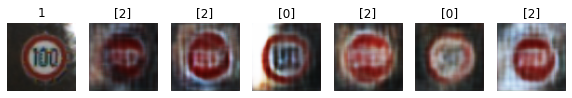

Epoch 25010 g_loss= 2.013125 d_loss= 0.26827925 real_acc= 0.9 fake_acc= 0.94
Epoch 25020 g_loss= 1.8890485 d_loss= 0.37170538 real_acc= 0.78 fake_acc= 0.9
Epoch 25030 g_loss= 1.9143894 d_loss= 0.2708946 real_acc= 0.86 fake_acc= 0.96
Epoch 25040 g_loss= 2.4866939 d_loss= 0.2722277 real_acc= 0.84 fake_acc= 0.98
Epoch 25050 g_loss= 1.6606166 d_loss= 0.27556148 real_acc= 0.9 fake_acc= 0.9
Epoch 25060 g_loss= 1.7786403 d_loss= 0.3084237 real_acc= 0.86 fake_acc= 0.98
Epoch 25070 g_loss= 2.0532272 d_loss= 0.25430077 real_acc= 0.92 fake_acc= 0.96
Epoch 25080 g_loss= 2.7062292 d_loss= 0.34201357 real_acc= 0.8 fake_acc= 0.98
Epoch 25090 g_loss= 2.1012893 d_loss= 0.2537187 real_acc= 0.92 fake_acc= 0.96
Epoch 25100 g_loss= 1.9461071 d_loss= 0.2126262 real_acc= 0.94 fake_acc= 0.9


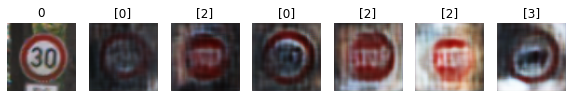

Epoch 25110 g_loss= 2.166619 d_loss= 0.1778383 real_acc= 1.0 fake_acc= 0.98
Epoch 25120 g_loss= 2.2794926 d_loss= 0.29730815 real_acc= 0.82 fake_acc= 0.94
Epoch 25130 g_loss= 1.6715416 d_loss= 0.27866644 real_acc= 0.94 fake_acc= 0.84
Epoch 25140 g_loss= 1.3377692 d_loss= 0.35539237 real_acc= 0.96 fake_acc= 0.74
Epoch 25150 g_loss= 1.9550095 d_loss= 0.25737345 real_acc= 0.9 fake_acc= 0.98
Epoch 25160 g_loss= 2.4779115 d_loss= 0.20248523 real_acc= 0.96 fake_acc= 1.0
Epoch 25170 g_loss= 2.5706987 d_loss= 0.24438687 real_acc= 0.82 fake_acc= 0.98
Epoch 25180 g_loss= 2.4748924 d_loss= 0.22716743 real_acc= 0.9 fake_acc= 0.98
Epoch 25190 g_loss= 2.927053 d_loss= 0.22876562 real_acc= 0.82 fake_acc= 1.0
Epoch 25200 g_loss= 2.3293595 d_loss= 0.27113485 real_acc= 0.84 fake_acc= 0.96


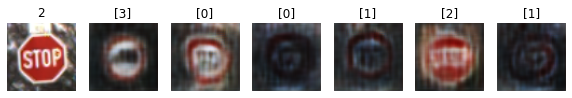

Epoch 25210 g_loss= 1.8220195 d_loss= 0.30539513 real_acc= 0.88 fake_acc= 0.96
Epoch 25220 g_loss= 2.052678 d_loss= 0.211723 real_acc= 0.94 fake_acc= 0.96
Epoch 25230 g_loss= 2.1265225 d_loss= 0.22536321 real_acc= 0.94 fake_acc= 0.96
Epoch 25240 g_loss= 2.0170977 d_loss= 0.25805703 real_acc= 0.94 fake_acc= 0.84
Epoch 25250 g_loss= 2.1503813 d_loss= 0.22534606 real_acc= 0.9 fake_acc= 0.98
Epoch 25260 g_loss= 1.6834291 d_loss= 0.2691049 real_acc= 0.96 fake_acc= 0.9
Epoch 25270 g_loss= 1.7221522 d_loss= 0.2893087 real_acc= 0.92 fake_acc= 0.9
Epoch 25280 g_loss= 1.7159734 d_loss= 0.36158863 real_acc= 0.8 fake_acc= 0.9
Epoch 25290 g_loss= 1.9776771 d_loss= 0.3095025 real_acc= 0.8 fake_acc= 0.94
Epoch 25300 g_loss= 1.9618013 d_loss= 0.24244034 real_acc= 0.92 fake_acc= 0.9


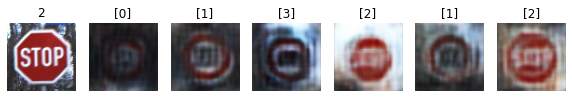

Epoch 25310 g_loss= 1.9208163 d_loss= 0.26131284 real_acc= 0.92 fake_acc= 0.96
Epoch 25320 g_loss= 1.9178392 d_loss= 0.28837004 real_acc= 0.92 fake_acc= 0.86
Epoch 25330 g_loss= 1.694937 d_loss= 0.30484122 real_acc= 0.96 fake_acc= 0.9
Epoch 25340 g_loss= 2.0507178 d_loss= 0.27805537 real_acc= 0.82 fake_acc= 0.96
Epoch 25350 g_loss= 1.8921912 d_loss= 0.35377994 real_acc= 0.84 fake_acc= 0.86
Epoch 25360 g_loss= 1.78716 d_loss= 0.29488653 real_acc= 0.9 fake_acc= 0.84
Epoch 25370 g_loss= 1.9860417 d_loss= 0.25071144 real_acc= 0.92 fake_acc= 0.92
Epoch 25380 g_loss= 2.0423224 d_loss= 0.25129703 real_acc= 0.9 fake_acc= 1.0
Epoch 25390 g_loss= 1.9720126 d_loss= 0.24322996 real_acc= 0.9 fake_acc= 1.0
Epoch 25400 g_loss= 1.8421744 d_loss= 0.29944098 real_acc= 0.92 fake_acc= 0.9


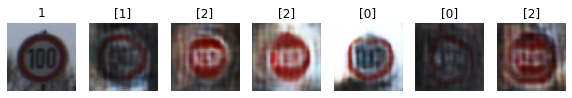

Epoch 25410 g_loss= 1.995941 d_loss= 0.2353444 real_acc= 0.94 fake_acc= 0.94
Epoch 25420 g_loss= 1.981438 d_loss= 0.26104194 real_acc= 0.9 fake_acc= 0.92
Epoch 25430 g_loss= 1.7677907 d_loss= 0.2929365 real_acc= 0.9 fake_acc= 0.94
Epoch 25440 g_loss= 1.8467706 d_loss= 0.23825753 real_acc= 0.9 fake_acc= 0.94
Epoch 25450 g_loss= 2.2841632 d_loss= 0.2043508 real_acc= 0.96 fake_acc= 0.98
Epoch 25460 g_loss= 1.8153129 d_loss= 0.2787743 real_acc= 0.94 fake_acc= 0.8
Epoch 25470 g_loss= 2.1166291 d_loss= 0.25997984 real_acc= 0.86 fake_acc= 0.92
Epoch 25480 g_loss= 1.8334569 d_loss= 0.2892983 real_acc= 0.92 fake_acc= 0.94
Epoch 25490 g_loss= 1.8658845 d_loss= 0.22106946 real_acc= 0.96 fake_acc= 0.94
Epoch 25500 g_loss= 2.373936 d_loss= 0.23659804 real_acc= 0.9 fake_acc= 0.98


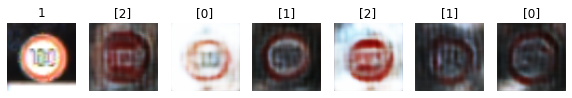

Epoch 25510 g_loss= 1.5930839 d_loss= 0.32040283 real_acc= 0.86 fake_acc= 0.92
Epoch 25520 g_loss= 1.9467412 d_loss= 0.3157674 real_acc= 0.96 fake_acc= 0.86
Epoch 25530 g_loss= 2.08753 d_loss= 0.29219007 real_acc= 0.84 fake_acc= 0.9
Epoch 25540 g_loss= 2.00733 d_loss= 0.24218225 real_acc= 0.9 fake_acc= 0.92
Epoch 25550 g_loss= 1.5268297 d_loss= 0.32378185 real_acc= 0.94 fake_acc= 0.92
Epoch 25560 g_loss= 2.0967643 d_loss= 0.25343087 real_acc= 0.84 fake_acc= 0.98
Epoch 25570 g_loss= 1.8535225 d_loss= 0.21196753 real_acc= 0.98 fake_acc= 0.96
Epoch 25580 g_loss= 1.9606167 d_loss= 0.27974683 real_acc= 0.84 fake_acc= 0.92
Epoch 25590 g_loss= 2.145959 d_loss= 0.24722688 real_acc= 0.9 fake_acc= 0.98
Epoch 25600 g_loss= 2.204352 d_loss= 0.23772104 real_acc= 0.9 fake_acc= 0.9


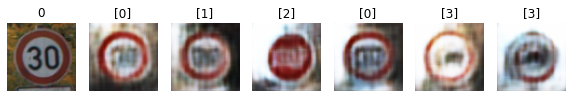

Epoch 25610 g_loss= 2.2906065 d_loss= 0.2763022 real_acc= 0.8 fake_acc= 0.96
Epoch 25620 g_loss= 2.1224031 d_loss= 0.23851548 real_acc= 0.9 fake_acc= 0.94
Epoch 25630 g_loss= 2.2541194 d_loss= 0.3203002 real_acc= 0.88 fake_acc= 0.94
Epoch 25640 g_loss= 2.192912 d_loss= 0.24204302 real_acc= 0.92 fake_acc= 0.96
Epoch 25650 g_loss= 2.4489102 d_loss= 0.30173174 real_acc= 0.78 fake_acc= 1.0
Epoch 25660 g_loss= 1.8583848 d_loss= 0.2607746 real_acc= 0.9 fake_acc= 0.96
Epoch 25670 g_loss= 1.7430042 d_loss= 0.27318507 real_acc= 0.9 fake_acc= 0.92
Epoch 25680 g_loss= 1.7999198 d_loss= 0.2343759 real_acc= 0.98 fake_acc= 0.9
Epoch 25690 g_loss= 2.064024 d_loss= 0.24962416 real_acc= 0.9 fake_acc= 0.98
Epoch 25700 g_loss= 2.0891073 d_loss= 0.25835294 real_acc= 0.88 fake_acc= 0.94


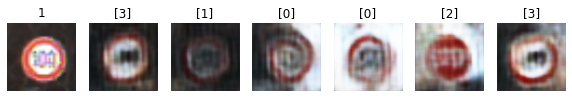

Epoch 25710 g_loss= 2.362899 d_loss= 0.21405241 real_acc= 0.84 fake_acc= 0.98
Epoch 25720 g_loss= 2.1251557 d_loss= 0.2801274 real_acc= 0.84 fake_acc= 0.92
Epoch 25730 g_loss= 1.6749176 d_loss= 0.26602513 real_acc= 0.94 fake_acc= 0.84
Epoch 25740 g_loss= 1.689815 d_loss= 0.28106445 real_acc= 0.92 fake_acc= 0.9
Epoch 25750 g_loss= 1.9578706 d_loss= 0.2804075 real_acc= 0.88 fake_acc= 0.92
Epoch 25760 g_loss= 2.1306572 d_loss= 0.25889674 real_acc= 0.88 fake_acc= 0.94
Epoch 25770 g_loss= 2.007185 d_loss= 0.30571443 real_acc= 0.88 fake_acc= 0.96
Epoch 25780 g_loss= 1.8988968 d_loss= 0.20412788 real_acc= 0.96 fake_acc= 0.94
Epoch 25790 g_loss= 2.2321303 d_loss= 0.2874713 real_acc= 0.8 fake_acc= 0.98
Epoch 25800 g_loss= 1.9097515 d_loss= 0.25269264 real_acc= 0.9 fake_acc= 0.88


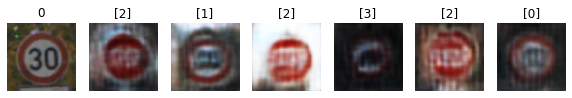

Epoch 25810 g_loss= 2.0583801 d_loss= 0.2091349 real_acc= 0.96 fake_acc= 0.94
Epoch 25820 g_loss= 2.462008 d_loss= 0.31090534 real_acc= 0.76 fake_acc= 0.98
Epoch 25830 g_loss= 1.9060779 d_loss= 0.29387966 real_acc= 0.84 fake_acc= 0.94
Epoch 25840 g_loss= 1.721104 d_loss= 0.27218273 real_acc= 0.98 fake_acc= 0.84
Epoch 25850 g_loss= 1.727797 d_loss= 0.29200748 real_acc= 0.92 fake_acc= 0.84
Epoch 25860 g_loss= 2.1817715 d_loss= 0.22806929 real_acc= 0.92 fake_acc= 0.98
Epoch 25870 g_loss= 1.8662776 d_loss= 0.26744604 real_acc= 0.9 fake_acc= 0.96
Epoch 25880 g_loss= 2.0984516 d_loss= 0.19824795 real_acc= 0.96 fake_acc= 0.94
Epoch 25890 g_loss= 2.3718264 d_loss= 0.31854618 real_acc= 0.82 fake_acc= 1.0
Epoch 25900 g_loss= 1.7464703 d_loss= 0.24269928 real_acc= 0.96 fake_acc= 0.94


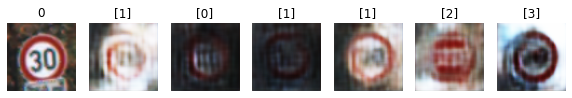

Epoch 25910 g_loss= 2.0938213 d_loss= 0.23577183 real_acc= 0.94 fake_acc= 0.9
Epoch 25920 g_loss= 2.0851133 d_loss= 0.28862166 real_acc= 0.9 fake_acc= 0.96
Epoch 25930 g_loss= 1.9543399 d_loss= 0.22386834 real_acc= 0.94 fake_acc= 0.96
Epoch 25940 g_loss= 2.134774 d_loss= 0.2510371 real_acc= 0.88 fake_acc= 0.94
Epoch 25950 g_loss= 1.9752687 d_loss= 0.2876747 real_acc= 0.92 fake_acc= 0.92
Epoch 25960 g_loss= 2.1446905 d_loss= 0.29029593 real_acc= 0.86 fake_acc= 0.9
Epoch 25970 g_loss= 1.942065 d_loss= 0.27003813 real_acc= 0.88 fake_acc= 0.9
Epoch 25980 g_loss= 1.7051191 d_loss= 0.25082743 real_acc= 0.94 fake_acc= 0.92
Epoch 25990 g_loss= 2.1119986 d_loss= 0.28151053 real_acc= 0.88 fake_acc= 0.98
Epoch 26000 g_loss= 2.1293921 d_loss= 0.2774788 real_acc= 0.9 fake_acc= 0.88


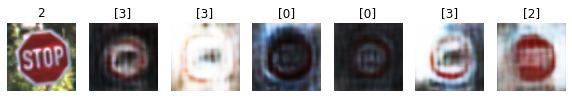

Epoch 26010 g_loss= 1.6486595 d_loss= 0.26248878 real_acc= 0.94 fake_acc= 0.88
Epoch 26020 g_loss= 1.7961916 d_loss= 0.31253397 real_acc= 0.9 fake_acc= 0.86
Epoch 26030 g_loss= 2.5151806 d_loss= 0.25670373 real_acc= 0.86 fake_acc= 0.92
Epoch 26040 g_loss= 2.1393654 d_loss= 0.2287189 real_acc= 0.96 fake_acc= 0.92
Epoch 26050 g_loss= 2.1223092 d_loss= 0.30576316 real_acc= 0.86 fake_acc= 0.98
Epoch 26060 g_loss= 1.8872637 d_loss= 0.23511244 real_acc= 0.96 fake_acc= 0.9
Epoch 26070 g_loss= 2.4847965 d_loss= 0.2152058 real_acc= 0.86 fake_acc= 1.0
Epoch 26080 g_loss= 2.2464926 d_loss= 0.20509914 real_acc= 0.92 fake_acc= 1.0
Epoch 26090 g_loss= 1.7232552 d_loss= 0.22880504 real_acc= 1.0 fake_acc= 0.84
Epoch 26100 g_loss= 1.5868498 d_loss= 0.27051133 real_acc= 0.98 fake_acc= 0.84


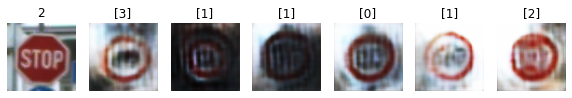

Epoch 26110 g_loss= 2.345559 d_loss= 0.35158476 real_acc= 0.74 fake_acc= 0.94
Epoch 26120 g_loss= 1.9116445 d_loss= 0.248693 real_acc= 0.9 fake_acc= 0.9
Epoch 26130 g_loss= 1.9513316 d_loss= 0.2412446 real_acc= 0.94 fake_acc= 0.9
Epoch 26140 g_loss= 1.6962156 d_loss= 0.2725869 real_acc= 0.92 fake_acc= 0.98
Epoch 26150 g_loss= 1.9589931 d_loss= 0.25328237 real_acc= 0.92 fake_acc= 0.96
Epoch 26160 g_loss= 1.9197302 d_loss= 0.21726054 real_acc= 0.98 fake_acc= 0.9
Epoch 26170 g_loss= 1.8735203 d_loss= 0.3106913 real_acc= 0.9 fake_acc= 0.88
Epoch 26180 g_loss= 1.7076542 d_loss= 0.27198327 real_acc= 0.94 fake_acc= 0.92
Epoch 26190 g_loss= 1.6959474 d_loss= 0.29041004 real_acc= 0.9 fake_acc= 0.82
Epoch 26200 g_loss= 1.66002 d_loss= 0.31640714 real_acc= 0.88 fake_acc= 0.94


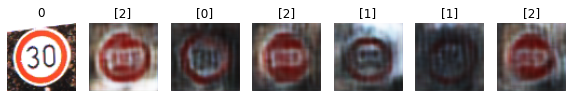

Epoch 26210 g_loss= 2.1139333 d_loss= 0.2413105 real_acc= 0.94 fake_acc= 1.0
Epoch 26220 g_loss= 2.2746596 d_loss= 0.23042184 real_acc= 0.88 fake_acc= 0.96
Epoch 26230 g_loss= 2.1838987 d_loss= 0.2160733 real_acc= 0.94 fake_acc= 0.96
Epoch 26240 g_loss= 1.8526161 d_loss= 0.28019768 real_acc= 0.88 fake_acc= 0.92
Epoch 26250 g_loss= 2.5480237 d_loss= 0.29220602 real_acc= 0.74 fake_acc= 1.0
Epoch 26260 g_loss= 1.613362 d_loss= 0.27611113 real_acc= 0.96 fake_acc= 0.86
Epoch 26270 g_loss= 1.5724498 d_loss= 0.2765096 real_acc= 0.98 fake_acc= 0.84
Epoch 26280 g_loss= 2.0914347 d_loss= 0.28382123 real_acc= 0.86 fake_acc= 0.92
Epoch 26290 g_loss= 2.159992 d_loss= 0.2613815 real_acc= 0.9 fake_acc= 0.94
Epoch 26300 g_loss= 1.6555696 d_loss= 0.22752038 real_acc= 0.98 fake_acc= 0.92


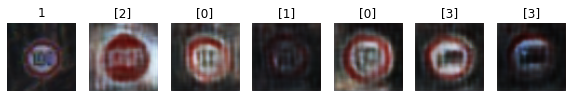

Epoch 26310 g_loss= 1.937973 d_loss= 0.27940077 real_acc= 0.84 fake_acc= 0.9
Epoch 26320 g_loss= 1.8834451 d_loss= 0.30308363 real_acc= 0.94 fake_acc= 0.9
Epoch 26330 g_loss= 1.806677 d_loss= 0.22983775 real_acc= 0.94 fake_acc= 0.98
Epoch 26340 g_loss= 2.2605495 d_loss= 0.26637936 real_acc= 0.86 fake_acc= 0.96
Epoch 26350 g_loss= 2.5070384 d_loss= 0.2514346 real_acc= 0.84 fake_acc= 0.98
Epoch 26360 g_loss= 2.2743406 d_loss= 0.23363987 real_acc= 0.92 fake_acc= 0.98
Epoch 26370 g_loss= 2.272924 d_loss= 0.217271 real_acc= 0.92 fake_acc= 0.92
Epoch 26380 g_loss= 2.1689818 d_loss= 0.23513472 real_acc= 0.86 fake_acc= 0.94
Epoch 26390 g_loss= 2.132884 d_loss= 0.24033043 real_acc= 0.88 fake_acc= 0.92
Epoch 26400 g_loss= 1.8544368 d_loss= 0.32129115 real_acc= 0.88 fake_acc= 0.86


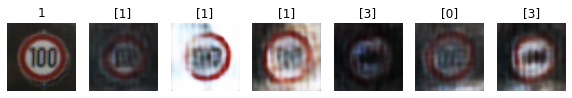

Epoch 26410 g_loss= 2.2735474 d_loss= 0.26704022 real_acc= 0.92 fake_acc= 0.9
Epoch 26420 g_loss= 2.046029 d_loss= 0.27061033 real_acc= 0.82 fake_acc= 1.0
Epoch 26430 g_loss= 1.9202687 d_loss= 0.27942717 real_acc= 0.9 fake_acc= 0.92
Epoch 26440 g_loss= 1.8777958 d_loss= 0.2815953 real_acc= 0.88 fake_acc= 0.94
Epoch 26450 g_loss= 1.7188976 d_loss= 0.27652043 real_acc= 0.92 fake_acc= 0.88
Epoch 26460 g_loss= 1.9230673 d_loss= 0.2267871 real_acc= 1.0 fake_acc= 0.9
Epoch 26470 g_loss= 1.8444085 d_loss= 0.24131179 real_acc= 0.96 fake_acc= 0.9
Epoch 26480 g_loss= 2.8703072 d_loss= 0.25290585 real_acc= 0.82 fake_acc= 0.98
Epoch 26490 g_loss= 2.6032624 d_loss= 0.28130555 real_acc= 0.82 fake_acc= 0.98
Epoch 26500 g_loss= 2.2083216 d_loss= 0.2295745 real_acc= 0.9 fake_acc= 0.94


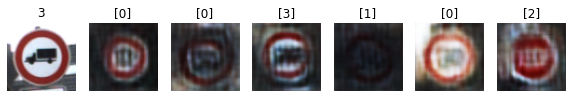

Epoch 26510 g_loss= 1.8924832 d_loss= 0.26156175 real_acc= 0.92 fake_acc= 0.9
Epoch 26520 g_loss= 2.1714585 d_loss= 0.27137828 real_acc= 0.9 fake_acc= 1.0
Epoch 26530 g_loss= 2.0225549 d_loss= 0.31323394 real_acc= 0.86 fake_acc= 0.94
Epoch 26540 g_loss= 1.9073466 d_loss= 0.26161572 real_acc= 0.96 fake_acc= 0.92
Epoch 26550 g_loss= 2.1913738 d_loss= 0.2362817 real_acc= 0.9 fake_acc= 0.98
Epoch 26560 g_loss= 1.8103812 d_loss= 0.2507027 real_acc= 0.96 fake_acc= 0.94
Epoch 26570 g_loss= 2.2496684 d_loss= 0.20704481 real_acc= 0.94 fake_acc= 0.96
Epoch 26580 g_loss= 2.3776932 d_loss= 0.22825578 real_acc= 0.88 fake_acc= 0.96
Epoch 26590 g_loss= 1.8534454 d_loss= 0.2503248 real_acc= 0.9 fake_acc= 0.94
Epoch 26600 g_loss= 2.0131655 d_loss= 0.24412459 real_acc= 0.96 fake_acc= 0.88


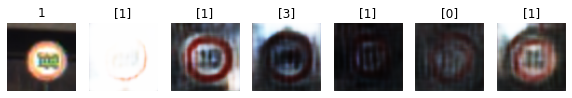

Epoch 26610 g_loss= 2.2384157 d_loss= 0.24542339 real_acc= 0.86 fake_acc= 0.96
Epoch 26620 g_loss= 1.8564318 d_loss= 0.27169806 real_acc= 0.84 fake_acc= 0.94
Epoch 26630 g_loss= 2.1097953 d_loss= 0.23376054 real_acc= 0.9 fake_acc= 0.92
Epoch 26640 g_loss= 2.0238717 d_loss= 0.32960552 real_acc= 0.82 fake_acc= 1.0
Epoch 26650 g_loss= 2.109713 d_loss= 0.25433046 real_acc= 0.86 fake_acc= 0.92
Epoch 26660 g_loss= 1.9327928 d_loss= 0.33237016 real_acc= 0.8 fake_acc= 0.92
Epoch 26670 g_loss= 2.4255354 d_loss= 0.22866598 real_acc= 0.86 fake_acc= 0.98
Epoch 26680 g_loss= 1.8510693 d_loss= 0.23133597 real_acc= 0.92 fake_acc= 0.94
Epoch 26690 g_loss= 2.0716276 d_loss= 0.26889887 real_acc= 0.9 fake_acc= 0.96
Epoch 26700 g_loss= 1.9179765 d_loss= 0.2042318 real_acc= 0.98 fake_acc= 0.92


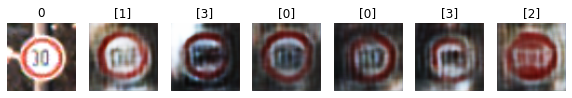

Epoch 26710 g_loss= 2.029525 d_loss= 0.27248135 real_acc= 0.92 fake_acc= 0.94
Epoch 26720 g_loss= 1.8499503 d_loss= 0.295995 real_acc= 0.94 fake_acc= 0.84
Epoch 26730 g_loss= 1.878908 d_loss= 0.27909225 real_acc= 0.92 fake_acc= 0.94
Epoch 26740 g_loss= 2.3588479 d_loss= 0.2688841 real_acc= 0.84 fake_acc= 0.94
Epoch 26750 g_loss= 1.8887 d_loss= 0.29152778 real_acc= 0.9 fake_acc= 0.86
Epoch 26760 g_loss= 2.148343 d_loss= 0.29600888 real_acc= 0.84 fake_acc= 0.96
Epoch 26770 g_loss= 1.6461018 d_loss= 0.29960203 real_acc= 0.92 fake_acc= 0.92
Epoch 26780 g_loss= 2.0322595 d_loss= 0.2659294 real_acc= 0.88 fake_acc= 0.92
Epoch 26790 g_loss= 2.095503 d_loss= 0.2906161 real_acc= 0.84 fake_acc= 0.9
Epoch 26800 g_loss= 2.0858996 d_loss= 0.22157225 real_acc= 0.92 fake_acc= 0.96


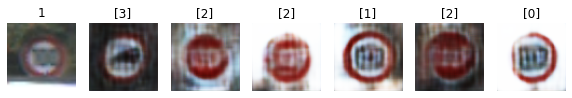

Epoch 26810 g_loss= 2.0558996 d_loss= 0.21144626 real_acc= 0.94 fake_acc= 0.94
Epoch 26820 g_loss= 2.1084194 d_loss= 0.29185715 real_acc= 0.82 fake_acc= 0.9
Epoch 26830 g_loss= 2.6032124 d_loss= 0.19803235 real_acc= 0.94 fake_acc= 1.0
Epoch 26840 g_loss= 2.0951192 d_loss= 0.29020074 real_acc= 0.82 fake_acc= 0.96
Epoch 26850 g_loss= 1.5320065 d_loss= 0.25372344 real_acc= 0.94 fake_acc= 0.9
Epoch 26860 g_loss= 1.7781965 d_loss= 0.27716154 real_acc= 0.94 fake_acc= 0.84
Epoch 26870 g_loss= 2.4129324 d_loss= 0.2958583 real_acc= 0.84 fake_acc= 0.96
Epoch 26880 g_loss= 2.1099644 d_loss= 0.21661848 real_acc= 0.98 fake_acc= 0.94
Epoch 26890 g_loss= 2.203955 d_loss= 0.2442198 real_acc= 0.88 fake_acc= 0.94
Epoch 26900 g_loss= 2.104226 d_loss= 0.21374974 real_acc= 0.92 fake_acc= 0.98


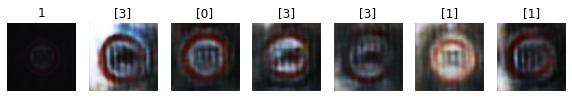

Epoch 26910 g_loss= 1.8105721 d_loss= 0.28498924 real_acc= 0.86 fake_acc= 0.96
Epoch 26920 g_loss= 1.6209059 d_loss= 0.2737888 real_acc= 0.92 fake_acc= 0.82
Epoch 26930 g_loss= 1.6199324 d_loss= 0.2704328 real_acc= 0.9 fake_acc= 0.9
Epoch 26940 g_loss= 1.6668828 d_loss= 0.26507404 real_acc= 0.94 fake_acc= 0.88
Epoch 26950 g_loss= 2.1696937 d_loss= 0.2578667 real_acc= 0.9 fake_acc= 0.96
Epoch 26960 g_loss= 2.4328256 d_loss= 0.2433694 real_acc= 0.86 fake_acc= 0.98
Epoch 26970 g_loss= 2.0542135 d_loss= 0.24974647 real_acc= 0.9 fake_acc= 0.98
Epoch 26980 g_loss= 2.0263941 d_loss= 0.3002354 real_acc= 0.86 fake_acc= 0.9
Epoch 26990 g_loss= 1.9760563 d_loss= 0.28260803 real_acc= 0.88 fake_acc= 0.94
Epoch 27000 g_loss= 2.3503213 d_loss= 0.33988422 real_acc= 0.82 fake_acc= 0.96


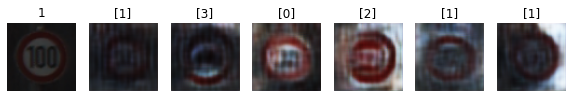

Epoch 27010 g_loss= 1.9672376 d_loss= 0.29093212 real_acc= 0.88 fake_acc= 0.9
Epoch 27020 g_loss= 1.5450214 d_loss= 0.316193 real_acc= 0.9 fake_acc= 0.84
Epoch 27030 g_loss= 1.8880136 d_loss= 0.25383282 real_acc= 0.9 fake_acc= 0.96
Epoch 27040 g_loss= 2.1087334 d_loss= 0.2793314 real_acc= 0.86 fake_acc= 0.96
Epoch 27050 g_loss= 1.8859296 d_loss= 0.2445566 real_acc= 0.96 fake_acc= 0.9
Epoch 27060 g_loss= 2.3113654 d_loss= 0.20030995 real_acc= 0.94 fake_acc= 0.96
Epoch 27070 g_loss= 1.9689106 d_loss= 0.25245368 real_acc= 0.92 fake_acc= 0.92
Epoch 27080 g_loss= 1.84092 d_loss= 0.19747835 real_acc= 0.96 fake_acc= 1.0
Epoch 27090 g_loss= 2.4811964 d_loss= 0.32199395 real_acc= 0.72 fake_acc= 0.98
Epoch 27100 g_loss= 1.7453898 d_loss= 0.27055147 real_acc= 0.88 fake_acc= 0.9


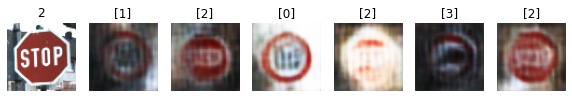

Epoch 27110 g_loss= 1.9331756 d_loss= 0.23369846 real_acc= 0.96 fake_acc= 0.92
Epoch 27120 g_loss= 2.0100405 d_loss= 0.2728107 real_acc= 0.9 fake_acc= 0.96
Epoch 27130 g_loss= 2.3015282 d_loss= 0.22165488 real_acc= 0.88 fake_acc= 0.98
Epoch 27140 g_loss= 1.7748395 d_loss= 0.24541967 real_acc= 1.0 fake_acc= 0.9
Epoch 27150 g_loss= 1.919908 d_loss= 0.2838578 real_acc= 0.84 fake_acc= 0.94
Epoch 27160 g_loss= 2.4212205 d_loss= 0.2392816 real_acc= 0.86 fake_acc= 0.96
Epoch 27170 g_loss= 2.355684 d_loss= 0.20094968 real_acc= 0.94 fake_acc= 1.0
Epoch 27180 g_loss= 1.9607435 d_loss= 0.2328502 real_acc= 0.92 fake_acc= 0.98
Epoch 27190 g_loss= 2.1375005 d_loss= 0.22212586 real_acc= 0.92 fake_acc= 0.98
Epoch 27200 g_loss= 1.5992846 d_loss= 0.25357252 real_acc= 0.98 fake_acc= 0.88


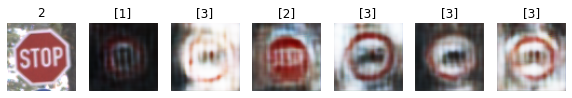

Epoch 27210 g_loss= 1.9219882 d_loss= 0.25753504 real_acc= 0.84 fake_acc= 0.98
Epoch 27220 g_loss= 1.9874465 d_loss= 0.26446903 real_acc= 0.9 fake_acc= 0.9
Epoch 27230 g_loss= 1.6908216 d_loss= 0.27923825 real_acc= 0.94 fake_acc= 0.82
Epoch 27240 g_loss= 2.2606688 d_loss= 0.29182765 real_acc= 0.78 fake_acc= 0.98
Epoch 27250 g_loss= 2.2138708 d_loss= 0.2742649 real_acc= 0.84 fake_acc= 0.96
Epoch 27260 g_loss= 1.6603111 d_loss= 0.377015 real_acc= 0.8 fake_acc= 0.88
Epoch 27270 g_loss= 1.9729885 d_loss= 0.25772142 real_acc= 0.88 fake_acc= 0.98
Epoch 27280 g_loss= 2.1129844 d_loss= 0.2088357 real_acc= 0.92 fake_acc= 0.96
Epoch 27290 g_loss= 2.0981727 d_loss= 0.2831363 real_acc= 0.88 fake_acc= 0.96
Epoch 27300 g_loss= 2.2268956 d_loss= 0.26466915 real_acc= 0.88 fake_acc= 0.98


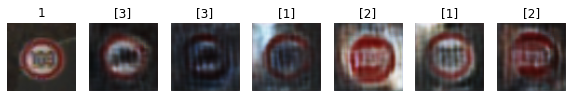

Epoch 27310 g_loss= 1.9326491 d_loss= 0.30039316 real_acc= 0.9 fake_acc= 0.92
Epoch 27320 g_loss= 2.2053783 d_loss= 0.24198917 real_acc= 0.9 fake_acc= 0.92
Epoch 27330 g_loss= 2.4653454 d_loss= 0.2478579 real_acc= 0.86 fake_acc= 1.0
Epoch 27340 g_loss= 1.584673 d_loss= 0.27787244 real_acc= 0.94 fake_acc= 0.88
Epoch 27350 g_loss= 1.8395735 d_loss= 0.23712957 real_acc= 0.94 fake_acc= 0.94
Epoch 27360 g_loss= 2.3387945 d_loss= 0.19473395 real_acc= 0.94 fake_acc= 1.0
Epoch 27370 g_loss= 2.0445268 d_loss= 0.30621183 real_acc= 0.84 fake_acc= 0.94
Epoch 27380 g_loss= 2.1643493 d_loss= 0.2653979 real_acc= 0.9 fake_acc= 0.86
Epoch 27390 g_loss= 1.9051154 d_loss= 0.25243032 real_acc= 0.94 fake_acc= 0.88
Epoch 27400 g_loss= 1.8300064 d_loss= 0.25227928 real_acc= 0.92 fake_acc= 0.9


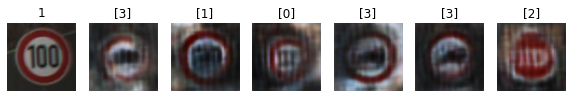

Epoch 27410 g_loss= 2.0447838 d_loss= 0.20967025 real_acc= 0.94 fake_acc= 0.98
Epoch 27420 g_loss= 1.3921672 d_loss= 0.25133637 real_acc= 1.0 fake_acc= 0.82
Epoch 27430 g_loss= 2.4156475 d_loss= 0.22722891 real_acc= 0.9 fake_acc= 1.0
Epoch 27440 g_loss= 3.0909848 d_loss= 0.2847728 real_acc= 0.74 fake_acc= 1.0
Epoch 27450 g_loss= 2.3487551 d_loss= 0.2703855 real_acc= 0.82 fake_acc= 0.94
Epoch 27460 g_loss= 1.6962323 d_loss= 0.25142276 real_acc= 0.94 fake_acc= 0.92
Epoch 27470 g_loss= 1.6638112 d_loss= 0.28933048 real_acc= 0.9 fake_acc= 0.88
Epoch 27480 g_loss= 2.4878755 d_loss= 0.22030172 real_acc= 0.88 fake_acc= 1.0
Epoch 27490 g_loss= 1.9768226 d_loss= 0.25087613 real_acc= 0.98 fake_acc= 0.9
Epoch 27500 g_loss= 2.2884858 d_loss= 0.24376515 real_acc= 0.84 fake_acc= 0.98


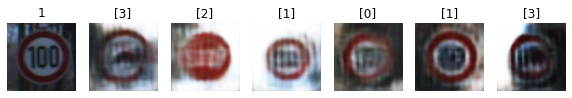

Epoch 27510 g_loss= 1.7454756 d_loss= 0.24750164 real_acc= 0.96 fake_acc= 0.98
Epoch 27520 g_loss= 1.8500818 d_loss= 0.25004604 real_acc= 0.92 fake_acc= 0.98
Epoch 27530 g_loss= 2.069382 d_loss= 0.21256983 real_acc= 0.94 fake_acc= 0.92
Epoch 27540 g_loss= 2.3677566 d_loss= 0.19802713 real_acc= 0.92 fake_acc= 1.0
Epoch 27550 g_loss= 2.3793714 d_loss= 0.20353717 real_acc= 0.96 fake_acc= 0.98
Epoch 27560 g_loss= 2.1470108 d_loss= 0.29432493 real_acc= 0.82 fake_acc= 0.94
Epoch 27570 g_loss= 1.7408779 d_loss= 0.26562327 real_acc= 0.98 fake_acc= 0.84
Epoch 27580 g_loss= 1.9191083 d_loss= 0.32996607 real_acc= 0.86 fake_acc= 0.98
Epoch 27590 g_loss= 2.297115 d_loss= 0.28882083 real_acc= 0.82 fake_acc= 0.94
Epoch 27600 g_loss= 2.2031758 d_loss= 0.22343484 real_acc= 0.94 fake_acc= 0.94


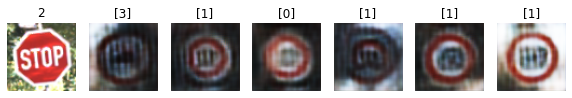

Epoch 27610 g_loss= 2.1082067 d_loss= 0.19435833 real_acc= 0.96 fake_acc= 0.92
Epoch 27620 g_loss= 2.4775515 d_loss= 0.25898015 real_acc= 0.86 fake_acc= 0.96
Epoch 27630 g_loss= 1.7698238 d_loss= 0.3030055 real_acc= 0.9 fake_acc= 0.92
Epoch 27640 g_loss= 2.3289626 d_loss= 0.2725494 real_acc= 0.86 fake_acc= 0.96
Epoch 27650 g_loss= 3.0095127 d_loss= 0.24418615 real_acc= 0.86 fake_acc= 1.0
Epoch 27660 g_loss= 2.4432023 d_loss= 0.23209947 real_acc= 0.86 fake_acc= 1.0
Epoch 27670 g_loss= 1.742735 d_loss= 0.21292928 real_acc= 0.96 fake_acc= 0.9
Epoch 27680 g_loss= 2.2875154 d_loss= 0.22426851 real_acc= 0.88 fake_acc= 1.0
Epoch 27690 g_loss= 2.1781683 d_loss= 0.20529777 real_acc= 0.94 fake_acc= 0.94
Epoch 27700 g_loss= 2.2953196 d_loss= 0.21658161 real_acc= 0.96 fake_acc= 0.94


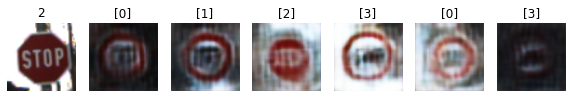

Epoch 27710 g_loss= 1.7068622 d_loss= 0.31149644 real_acc= 0.92 fake_acc= 0.84
Epoch 27720 g_loss= 2.2531383 d_loss= 0.25038117 real_acc= 0.9 fake_acc= 0.94
Epoch 27730 g_loss= 1.8397315 d_loss= 0.23319119 real_acc= 0.96 fake_acc= 0.94
Epoch 27740 g_loss= 2.0926504 d_loss= 0.2741387 real_acc= 0.9 fake_acc= 0.92
Epoch 27750 g_loss= 1.8896838 d_loss= 0.29364774 real_acc= 0.88 fake_acc= 0.94
Epoch 27760 g_loss= 1.9747176 d_loss= 0.24684593 real_acc= 0.92 fake_acc= 0.94
Epoch 27770 g_loss= 2.1759753 d_loss= 0.21689242 real_acc= 0.94 fake_acc= 0.96
Epoch 27780 g_loss= 2.6715205 d_loss= 0.2156934 real_acc= 0.94 fake_acc= 0.98
Epoch 27790 g_loss= 1.9998633 d_loss= 0.22260416 real_acc= 0.96 fake_acc= 0.92
Epoch 27800 g_loss= 2.1178625 d_loss= 0.26646554 real_acc= 0.9 fake_acc= 0.94


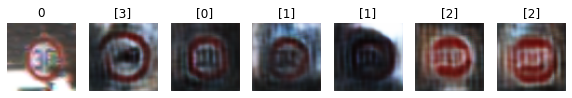

Epoch 27810 g_loss= 2.0455203 d_loss= 0.25526282 real_acc= 0.88 fake_acc= 0.98
Epoch 27820 g_loss= 1.987816 d_loss= 0.24919738 real_acc= 0.88 fake_acc= 0.96
Epoch 27830 g_loss= 2.5034838 d_loss= 0.31006238 real_acc= 0.84 fake_acc= 0.98
Epoch 27840 g_loss= 2.3567924 d_loss= 0.26867437 real_acc= 0.86 fake_acc= 1.0
Epoch 27850 g_loss= 1.9315162 d_loss= 0.2711153 real_acc= 0.84 fake_acc= 0.96
Epoch 27860 g_loss= 1.5976007 d_loss= 0.31024143 real_acc= 0.9 fake_acc= 0.86
Epoch 27870 g_loss= 1.7704636 d_loss= 0.27030078 real_acc= 0.96 fake_acc= 0.9
Epoch 27880 g_loss= 2.3010654 d_loss= 0.26453844 real_acc= 0.9 fake_acc= 0.94
Epoch 27890 g_loss= 1.9726272 d_loss= 0.24063666 real_acc= 0.9 fake_acc= 0.92
Epoch 27900 g_loss= 1.683512 d_loss= 0.2350458 real_acc= 0.98 fake_acc= 0.86


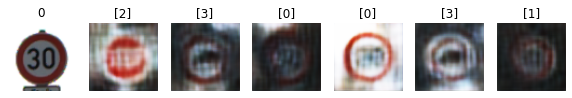

Epoch 27910 g_loss= 2.197169 d_loss= 0.2253322 real_acc= 0.88 fake_acc= 1.0
Epoch 27920 g_loss= 2.1824954 d_loss= 0.22510299 real_acc= 0.94 fake_acc= 0.96
Epoch 27930 g_loss= 2.444958 d_loss= 0.25298363 real_acc= 0.9 fake_acc= 1.0
Epoch 27940 g_loss= 1.8052708 d_loss= 0.32288724 real_acc= 0.88 fake_acc= 0.94
Epoch 27950 g_loss= 1.810917 d_loss= 0.26999432 real_acc= 0.92 fake_acc= 0.88
Epoch 27960 g_loss= 1.8373475 d_loss= 0.26227292 real_acc= 0.98 fake_acc= 0.88
Epoch 27970 g_loss= 1.8795631 d_loss= 0.20123693 real_acc= 1.0 fake_acc= 0.94
Epoch 27980 g_loss= 2.3251235 d_loss= 0.2159687 real_acc= 0.94 fake_acc= 1.0
Epoch 27990 g_loss= 1.9780155 d_loss= 0.38979465 real_acc= 0.78 fake_acc= 0.96
Epoch 28000 g_loss= 2.1925194 d_loss= 0.2753026 real_acc= 0.8 fake_acc= 0.96


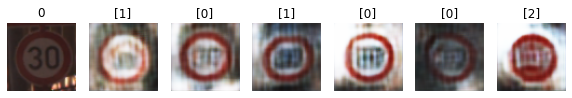

Epoch 28010 g_loss= 1.5940357 d_loss= 0.28086266 real_acc= 0.92 fake_acc= 0.9
Epoch 28020 g_loss= 2.1800191 d_loss= 0.21249402 real_acc= 0.96 fake_acc= 0.92
Epoch 28030 g_loss= 2.2938542 d_loss= 0.2302166 real_acc= 0.88 fake_acc= 0.96
Epoch 28040 g_loss= 2.0449047 d_loss= 0.31259245 real_acc= 0.86 fake_acc= 0.96
Epoch 28050 g_loss= 2.0494225 d_loss= 0.2071087 real_acc= 0.94 fake_acc= 0.9
Epoch 28060 g_loss= 1.914548 d_loss= 0.20148242 real_acc= 0.98 fake_acc= 0.92
Epoch 28070 g_loss= 2.3699343 d_loss= 0.1889315 real_acc= 0.96 fake_acc= 0.96
Epoch 28080 g_loss= 2.108985 d_loss= 0.32634515 real_acc= 0.88 fake_acc= 0.86
Epoch 28090 g_loss= 1.7861991 d_loss= 0.29600516 real_acc= 0.88 fake_acc= 0.86
Epoch 28100 g_loss= 2.0736077 d_loss= 0.21831408 real_acc= 0.92 fake_acc= 0.94


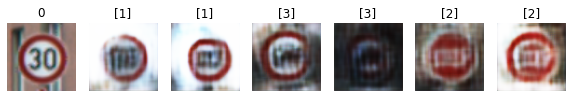

Epoch 28110 g_loss= 2.2863424 d_loss= 0.2342214 real_acc= 0.92 fake_acc= 0.96
Epoch 28120 g_loss= 2.2320511 d_loss= 0.203581 real_acc= 0.92 fake_acc= 0.98
Epoch 28130 g_loss= 2.1913812 d_loss= 0.24865878 real_acc= 0.88 fake_acc= 0.96
Epoch 28140 g_loss= 1.9652889 d_loss= 0.20386672 real_acc= 0.98 fake_acc= 0.9
Epoch 28150 g_loss= 2.0320055 d_loss= 0.29328895 real_acc= 0.9 fake_acc= 0.88
Epoch 28160 g_loss= 2.1308417 d_loss= 0.24479593 real_acc= 0.82 fake_acc= 0.98
Epoch 28170 g_loss= 2.0800698 d_loss= 0.27048144 real_acc= 0.88 fake_acc= 0.94
Epoch 28180 g_loss= 2.4162736 d_loss= 0.23442289 real_acc= 0.86 fake_acc= 1.0
Epoch 28190 g_loss= 2.3150277 d_loss= 0.21816637 real_acc= 0.94 fake_acc= 0.96
Epoch 28200 g_loss= 1.8921845 d_loss= 0.20820507 real_acc= 0.98 fake_acc= 0.96


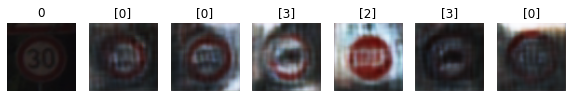

Epoch 28210 g_loss= 1.9208932 d_loss= 0.2779671 real_acc= 0.9 fake_acc= 0.88
Epoch 28220 g_loss= 2.1749885 d_loss= 0.20639065 real_acc= 0.98 fake_acc= 0.98
Epoch 28230 g_loss= 2.2548454 d_loss= 0.26977375 real_acc= 0.88 fake_acc= 0.98
Epoch 28240 g_loss= 1.879625 d_loss= 0.21503186 real_acc= 0.94 fake_acc= 0.94
Epoch 28250 g_loss= 2.072231 d_loss= 0.2394147 real_acc= 0.92 fake_acc= 0.92
Epoch 28260 g_loss= 2.2790399 d_loss= 0.23430985 real_acc= 0.88 fake_acc= 0.96
Epoch 28270 g_loss= 2.4460635 d_loss= 0.264947 real_acc= 0.82 fake_acc= 1.0
Epoch 28280 g_loss= 1.8560632 d_loss= 0.26757222 real_acc= 0.9 fake_acc= 0.94
Epoch 28290 g_loss= 2.076282 d_loss= 0.26542854 real_acc= 0.88 fake_acc= 0.96
Epoch 28300 g_loss= 2.15409 d_loss= 0.22728936 real_acc= 0.9 fake_acc= 0.94


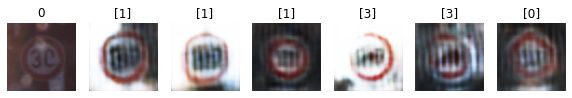

Epoch 28310 g_loss= 1.9870294 d_loss= 0.23995414 real_acc= 0.94 fake_acc= 0.92
Epoch 28320 g_loss= 2.1988935 d_loss= 0.23944607 real_acc= 0.86 fake_acc= 0.94
Epoch 28330 g_loss= 2.150081 d_loss= 0.22922726 real_acc= 0.9 fake_acc= 0.96
Epoch 28340 g_loss= 2.2866006 d_loss= 0.31024626 real_acc= 0.84 fake_acc= 0.96
Epoch 28350 g_loss= 2.2982426 d_loss= 0.20958856 real_acc= 0.92 fake_acc= 0.96
Epoch 28360 g_loss= 2.1489594 d_loss= 0.33433568 real_acc= 0.8 fake_acc= 0.92
Epoch 28370 g_loss= 2.2680407 d_loss= 0.23698655 real_acc= 0.86 fake_acc= 0.98
Epoch 28380 g_loss= 1.7261748 d_loss= 0.2846092 real_acc= 0.88 fake_acc= 0.86
Epoch 28390 g_loss= 1.9273219 d_loss= 0.26081675 real_acc= 0.92 fake_acc= 0.94
Epoch 28400 g_loss= 2.063992 d_loss= 0.25639468 real_acc= 0.88 fake_acc= 0.94


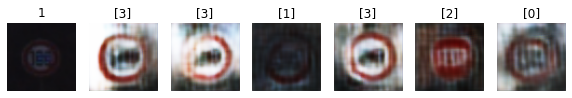

Epoch 28410 g_loss= 2.4635053 d_loss= 0.24664116 real_acc= 0.82 fake_acc= 0.98
Epoch 28420 g_loss= 2.3379328 d_loss= 0.17932758 real_acc= 0.9 fake_acc= 1.0
Epoch 28430 g_loss= 1.4897248 d_loss= 0.3674372 real_acc= 0.94 fake_acc= 0.8
Epoch 28440 g_loss= 1.7108061 d_loss= 0.30111945 real_acc= 0.92 fake_acc= 0.92
Epoch 28450 g_loss= 2.6406007 d_loss= 0.23894247 real_acc= 0.84 fake_acc= 1.0
Epoch 28460 g_loss= 2.2462127 d_loss= 0.22441709 real_acc= 0.94 fake_acc= 0.96
Epoch 28470 g_loss= 1.817171 d_loss= 0.25707567 real_acc= 0.9 fake_acc= 0.9
Epoch 28480 g_loss= 1.7855757 d_loss= 0.2817012 real_acc= 0.88 fake_acc= 0.94
Epoch 28490 g_loss= 1.9513693 d_loss= 0.23910037 real_acc= 0.92 fake_acc= 0.9
Epoch 28500 g_loss= 2.417817 d_loss= 0.30656403 real_acc= 0.82 fake_acc= 0.94


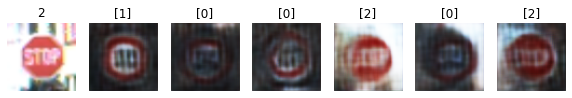

Epoch 28510 g_loss= 2.1809282 d_loss= 0.25424963 real_acc= 0.92 fake_acc= 0.92
Epoch 28520 g_loss= 1.8386736 d_loss= 0.24055952 real_acc= 0.94 fake_acc= 0.9
Epoch 28530 g_loss= 2.5913093 d_loss= 0.3044818 real_acc= 0.76 fake_acc= 1.0
Epoch 28540 g_loss= 1.7952174 d_loss= 0.25286514 real_acc= 0.94 fake_acc= 0.96
Epoch 28550 g_loss= 1.8098866 d_loss= 0.25240108 real_acc= 0.98 fake_acc= 0.92
Epoch 28560 g_loss= 2.608418 d_loss= 0.26019016 real_acc= 0.84 fake_acc= 0.98
Epoch 28570 g_loss= 2.3735075 d_loss= 0.22131422 real_acc= 0.92 fake_acc= 0.96
Epoch 28580 g_loss= 2.1808934 d_loss= 0.22387956 real_acc= 0.94 fake_acc= 0.96
Epoch 28590 g_loss= 2.0726445 d_loss= 0.19820948 real_acc= 0.94 fake_acc= 0.96
Epoch 28600 g_loss= 2.0798101 d_loss= 0.2548694 real_acc= 0.86 fake_acc= 0.94


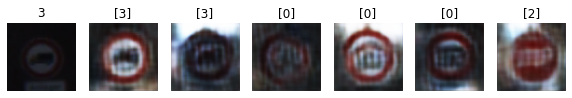

Epoch 28610 g_loss= 1.9237351 d_loss= 0.24429858 real_acc= 0.92 fake_acc= 0.94
Epoch 28620 g_loss= 2.0777802 d_loss= 0.26765016 real_acc= 0.88 fake_acc= 0.98
Epoch 28630 g_loss= 2.1091483 d_loss= 0.3207513 real_acc= 0.84 fake_acc= 0.94
Epoch 28640 g_loss= 2.0423896 d_loss= 0.23515049 real_acc= 0.88 fake_acc= 1.0
Epoch 28650 g_loss= 2.3086731 d_loss= 0.2736597 real_acc= 0.88 fake_acc= 0.92
Epoch 28660 g_loss= 2.179955 d_loss= 0.24203375 real_acc= 0.94 fake_acc= 0.94
Epoch 28670 g_loss= 1.9795171 d_loss= 0.22853449 real_acc= 0.94 fake_acc= 0.94
Epoch 28680 g_loss= 2.2427025 d_loss= 0.2326893 real_acc= 0.94 fake_acc= 0.9
Epoch 28690 g_loss= 2.2385879 d_loss= 0.30630523 real_acc= 0.8 fake_acc= 0.98
Epoch 28700 g_loss= 1.7062573 d_loss= 0.25433767 real_acc= 0.94 fake_acc= 0.94


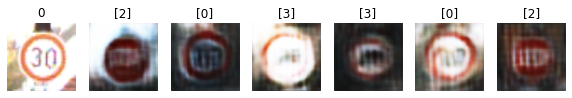

Epoch 28710 g_loss= 1.9940898 d_loss= 0.22893599 real_acc= 0.94 fake_acc= 0.92
Epoch 28720 g_loss= 1.7034781 d_loss= 0.24635725 real_acc= 0.98 fake_acc= 0.94
Epoch 28730 g_loss= 2.4600716 d_loss= 0.23084192 real_acc= 0.84 fake_acc= 0.98
Epoch 28740 g_loss= 2.1384969 d_loss= 0.25990283 real_acc= 0.88 fake_acc= 0.94
Epoch 28750 g_loss= 2.4950314 d_loss= 0.2747354 real_acc= 0.84 fake_acc= 0.9
Epoch 28760 g_loss= 1.7171026 d_loss= 0.23668388 real_acc= 0.96 fake_acc= 0.94
Epoch 28770 g_loss= 1.6130277 d_loss= 0.26900178 real_acc= 0.9 fake_acc= 0.94
Epoch 28780 g_loss= 2.21617 d_loss= 0.22972393 real_acc= 0.92 fake_acc= 0.88
Epoch 28790 g_loss= 1.7774291 d_loss= 0.25594634 real_acc= 0.9 fake_acc= 0.92
Epoch 28800 g_loss= 1.9360968 d_loss= 0.2510351 real_acc= 0.96 fake_acc= 0.88


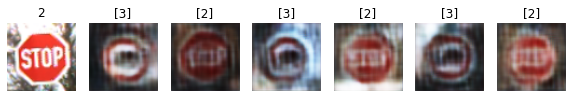

Epoch 28810 g_loss= 2.5893486 d_loss= 0.25228974 real_acc= 0.84 fake_acc= 0.98
Epoch 28820 g_loss= 1.941962 d_loss= 0.217219 real_acc= 0.94 fake_acc= 0.96
Epoch 28830 g_loss= 2.0685086 d_loss= 0.23636144 real_acc= 0.9 fake_acc= 0.96
Epoch 28840 g_loss= 2.2103286 d_loss= 0.19876085 real_acc= 0.98 fake_acc= 0.96
Epoch 28850 g_loss= 2.0787766 d_loss= 0.29482687 real_acc= 0.84 fake_acc= 0.92
Epoch 28860 g_loss= 2.166441 d_loss= 0.23535642 real_acc= 0.92 fake_acc= 0.94
Epoch 28870 g_loss= 2.3093712 d_loss= 0.2513725 real_acc= 0.82 fake_acc= 0.98
Epoch 28880 g_loss= 1.9576058 d_loss= 0.28100163 real_acc= 0.88 fake_acc= 0.94
Epoch 28890 g_loss= 1.8772895 d_loss= 0.22712427 real_acc= 0.96 fake_acc= 0.94
Epoch 28900 g_loss= 2.5758917 d_loss= 0.23492253 real_acc= 0.92 fake_acc= 0.94


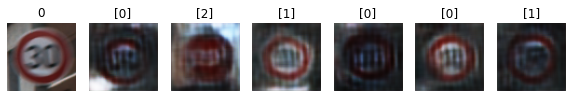

Epoch 28910 g_loss= 2.1475213 d_loss= 0.2549023 real_acc= 0.9 fake_acc= 0.94
Epoch 28920 g_loss= 2.2686622 d_loss= 0.19483748 real_acc= 0.9 fake_acc= 0.98
Epoch 28930 g_loss= 2.1721785 d_loss= 0.18397763 real_acc= 0.98 fake_acc= 1.0
Epoch 28940 g_loss= 1.721489 d_loss= 0.3295585 real_acc= 0.9 fake_acc= 0.9
Epoch 28950 g_loss= 1.608276 d_loss= 0.2814284 real_acc= 0.94 fake_acc= 0.84
Epoch 28960 g_loss= 2.3274152 d_loss= 0.20801735 real_acc= 0.9 fake_acc= 0.94
Epoch 28970 g_loss= 1.8315958 d_loss= 0.27114516 real_acc= 0.92 fake_acc= 0.86
Epoch 28980 g_loss= 1.4048638 d_loss= 0.35649166 real_acc= 0.92 fake_acc= 0.76
Epoch 28990 g_loss= 1.9816711 d_loss= 0.335142 real_acc= 0.88 fake_acc= 0.9
Epoch 29000 g_loss= 2.8028562 d_loss= 0.27392265 real_acc= 0.76 fake_acc= 1.0


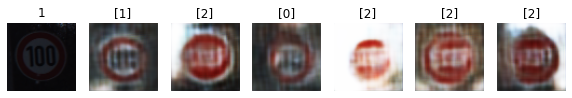

Epoch 29010 g_loss= 1.8837788 d_loss= 0.22428384 real_acc= 0.94 fake_acc= 0.92
Epoch 29020 g_loss= 1.5731338 d_loss= 0.30505732 real_acc= 0.94 fake_acc= 0.82
Epoch 29030 g_loss= 2.2893734 d_loss= 0.25609535 real_acc= 0.84 fake_acc= 0.94
Epoch 29040 g_loss= 2.23972 d_loss= 0.2213982 real_acc= 0.9 fake_acc= 0.92
Epoch 29050 g_loss= 1.93901 d_loss= 0.22557631 real_acc= 0.98 fake_acc= 0.98
Epoch 29060 g_loss= 1.6712174 d_loss= 0.36306962 real_acc= 0.82 fake_acc= 0.9
Epoch 29070 g_loss= 2.0366395 d_loss= 0.250766 real_acc= 0.86 fake_acc= 0.98
Epoch 29080 g_loss= 2.1783128 d_loss= 0.25930342 real_acc= 0.86 fake_acc= 0.96
Epoch 29090 g_loss= 1.904966 d_loss= 0.2279188 real_acc= 0.96 fake_acc= 0.92
Epoch 29100 g_loss= 2.0464041 d_loss= 0.20115992 real_acc= 0.98 fake_acc= 0.88


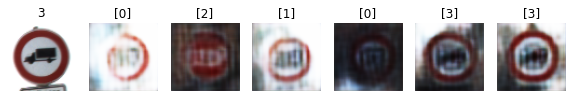

Epoch 29110 g_loss= 2.0508273 d_loss= 0.26803553 real_acc= 0.94 fake_acc= 0.94
Epoch 29120 g_loss= 2.2158256 d_loss= 0.22711226 real_acc= 0.92 fake_acc= 0.96
Epoch 29130 g_loss= 2.0225072 d_loss= 0.21237037 real_acc= 0.92 fake_acc= 0.96
Epoch 29140 g_loss= 1.8365242 d_loss= 0.3053011 real_acc= 0.86 fake_acc= 0.9
Epoch 29150 g_loss= 2.2088542 d_loss= 0.23980895 real_acc= 0.9 fake_acc= 1.0
Epoch 29160 g_loss= 1.9183612 d_loss= 0.24571142 real_acc= 0.98 fake_acc= 0.86
Epoch 29170 g_loss= 1.6753801 d_loss= 0.26122963 real_acc= 0.92 fake_acc= 0.92
Epoch 29180 g_loss= 2.325527 d_loss= 0.20203096 real_acc= 0.9 fake_acc= 0.98
Epoch 29190 g_loss= 2.5470476 d_loss= 0.22836204 real_acc= 0.88 fake_acc= 0.96
Epoch 29200 g_loss= 2.062744 d_loss= 0.21578848 real_acc= 0.92 fake_acc= 0.92


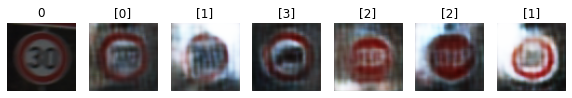

Epoch 29210 g_loss= 1.9130697 d_loss= 0.23417458 real_acc= 0.92 fake_acc= 0.92
Epoch 29220 g_loss= 2.2724984 d_loss= 0.19916174 real_acc= 0.94 fake_acc= 0.96
Epoch 29230 g_loss= 2.2356331 d_loss= 0.24264681 real_acc= 0.86 fake_acc= 0.92
Epoch 29240 g_loss= 2.2182806 d_loss= 0.26510662 real_acc= 0.92 fake_acc= 0.98
Epoch 29250 g_loss= 2.3039477 d_loss= 0.17403045 real_acc= 0.94 fake_acc= 1.0
Epoch 29260 g_loss= 1.6732962 d_loss= 0.30901378 real_acc= 0.92 fake_acc= 0.86
Epoch 29270 g_loss= 2.1374302 d_loss= 0.23330843 real_acc= 0.88 fake_acc= 0.96
Epoch 29280 g_loss= 2.5528777 d_loss= 0.20720848 real_acc= 0.9 fake_acc= 1.0
Epoch 29290 g_loss= 1.7646457 d_loss= 0.26478085 real_acc= 0.9 fake_acc= 0.94
Epoch 29300 g_loss= 1.7299045 d_loss= 0.29625338 real_acc= 0.88 fake_acc= 0.86


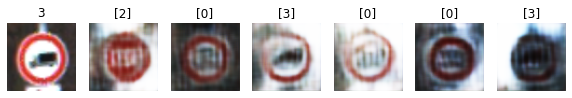

Epoch 29310 g_loss= 2.181004 d_loss= 0.28701282 real_acc= 0.76 fake_acc= 0.98
Epoch 29320 g_loss= 2.0389357 d_loss= 0.28791478 real_acc= 0.88 fake_acc= 0.94
Epoch 29330 g_loss= 2.082012 d_loss= 0.2683695 real_acc= 0.92 fake_acc= 0.92
Epoch 29340 g_loss= 2.0372994 d_loss= 0.27325913 real_acc= 0.94 fake_acc= 0.88
Epoch 29350 g_loss= 2.172945 d_loss= 0.25989994 real_acc= 0.88 fake_acc= 0.88
Epoch 29360 g_loss= 1.9811149 d_loss= 0.29024565 real_acc= 0.84 fake_acc= 0.9
Epoch 29370 g_loss= 2.38462 d_loss= 0.19659418 real_acc= 0.92 fake_acc= 0.96
Epoch 29380 g_loss= 2.01564 d_loss= 0.2575312 real_acc= 0.88 fake_acc= 0.96
Epoch 29390 g_loss= 2.0901518 d_loss= 0.21888837 real_acc= 0.94 fake_acc= 0.98
Epoch 29400 g_loss= 2.3039358 d_loss= 0.18804777 real_acc= 0.94 fake_acc= 0.96


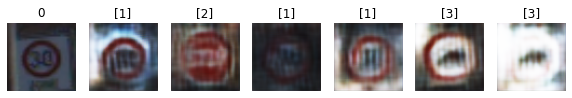

Epoch 29410 g_loss= 1.9547796 d_loss= 0.20713213 real_acc= 0.98 fake_acc= 0.92
Epoch 29420 g_loss= 2.1382563 d_loss= 0.23048978 real_acc= 0.92 fake_acc= 0.98
Epoch 29430 g_loss= 1.5966809 d_loss= 0.3175122 real_acc= 0.86 fake_acc= 0.86
Epoch 29440 g_loss= 1.8004947 d_loss= 0.22520322 real_acc= 0.94 fake_acc= 0.9
Epoch 29450 g_loss= 2.0519745 d_loss= 0.27973473 real_acc= 0.88 fake_acc= 0.98
Epoch 29460 g_loss= 1.985422 d_loss= 0.27206 real_acc= 0.84 fake_acc= 0.92
Epoch 29470 g_loss= 2.3070855 d_loss= 0.22080198 real_acc= 0.92 fake_acc= 0.94
Epoch 29480 g_loss= 2.1926308 d_loss= 0.27850607 real_acc= 0.9 fake_acc= 0.98
Epoch 29490 g_loss= 2.0202563 d_loss= 0.17581663 real_acc= 0.96 fake_acc= 0.98
Epoch 29500 g_loss= 2.1542256 d_loss= 0.2530966 real_acc= 0.88 fake_acc= 0.94


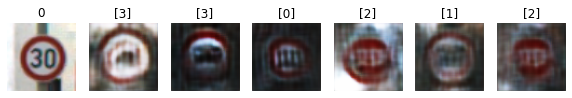

Epoch 29510 g_loss= 2.3402905 d_loss= 0.23899034 real_acc= 0.92 fake_acc= 0.94
Epoch 29520 g_loss= 1.8940434 d_loss= 0.295191 real_acc= 0.9 fake_acc= 0.9
Epoch 29530 g_loss= 1.816397 d_loss= 0.26676762 real_acc= 0.94 fake_acc= 0.84
Epoch 29540 g_loss= 1.9347086 d_loss= 0.24266845 real_acc= 0.96 fake_acc= 0.98
Epoch 29550 g_loss= 2.3578458 d_loss= 0.18376696 real_acc= 0.92 fake_acc= 0.98
Epoch 29560 g_loss= 1.8867157 d_loss= 0.23580764 real_acc= 0.92 fake_acc= 0.92
Epoch 29570 g_loss= 2.2845254 d_loss= 0.22929314 real_acc= 0.86 fake_acc= 0.98
Epoch 29580 g_loss= 2.5107691 d_loss= 0.24227563 real_acc= 0.82 fake_acc= 1.0
Epoch 29590 g_loss= 1.8402966 d_loss= 0.26622772 real_acc= 0.9 fake_acc= 0.92
Epoch 29600 g_loss= 2.0552757 d_loss= 0.26311976 real_acc= 0.9 fake_acc= 1.0


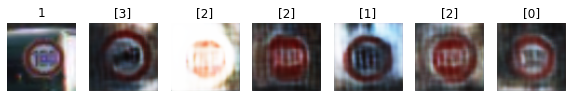

Epoch 29610 g_loss= 2.0342817 d_loss= 0.24369684 real_acc= 0.92 fake_acc= 0.98
Epoch 29620 g_loss= 2.7478662 d_loss= 0.26588404 real_acc= 0.84 fake_acc= 1.0
Epoch 29630 g_loss= 2.2150338 d_loss= 0.22796533 real_acc= 0.96 fake_acc= 0.96
Epoch 29640 g_loss= 1.7953535 d_loss= 0.20129438 real_acc= 0.98 fake_acc= 0.92
Epoch 29650 g_loss= 2.5880344 d_loss= 0.32106283 real_acc= 0.76 fake_acc= 1.0
Epoch 29660 g_loss= 2.618004 d_loss= 0.33566397 real_acc= 0.74 fake_acc= 1.0
Epoch 29670 g_loss= 1.477425 d_loss= 0.28235978 real_acc= 0.9 fake_acc= 0.9
Epoch 29680 g_loss= 1.8423088 d_loss= 0.318881 real_acc= 0.9 fake_acc= 0.84
Epoch 29690 g_loss= 2.5445535 d_loss= 0.22073421 real_acc= 0.88 fake_acc= 0.98
Epoch 29700 g_loss= 2.3582368 d_loss= 0.25226203 real_acc= 0.86 fake_acc= 0.92


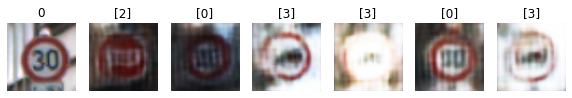

Epoch 29710 g_loss= 2.0973988 d_loss= 0.25769332 real_acc= 0.9 fake_acc= 0.92
Epoch 29720 g_loss= 2.554752 d_loss= 0.24069764 real_acc= 0.88 fake_acc= 1.0
Epoch 29730 g_loss= 1.9266677 d_loss= 0.26309818 real_acc= 0.94 fake_acc= 0.88
Epoch 29740 g_loss= 2.379202 d_loss= 0.17491613 real_acc= 0.94 fake_acc= 0.98
Epoch 29750 g_loss= 2.0940032 d_loss= 0.27108058 real_acc= 0.9 fake_acc= 0.92
Epoch 29760 g_loss= 1.766221 d_loss= 0.26873177 real_acc= 0.94 fake_acc= 0.82
Epoch 29770 g_loss= 1.9048575 d_loss= 0.26195422 real_acc= 0.88 fake_acc= 0.96
Epoch 29780 g_loss= 1.8955728 d_loss= 0.25783128 real_acc= 0.92 fake_acc= 0.88
Epoch 29790 g_loss= 2.0554655 d_loss= 0.25184965 real_acc= 0.86 fake_acc= 0.9
Epoch 29800 g_loss= 1.7234902 d_loss= 0.21973988 real_acc= 0.98 fake_acc= 0.96


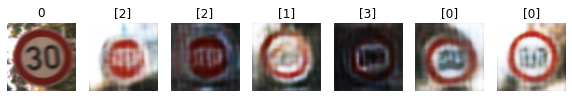

Epoch 29810 g_loss= 2.1460671 d_loss= 0.25825602 real_acc= 0.88 fake_acc= 0.98
Epoch 29820 g_loss= 1.9758191 d_loss= 0.22973785 real_acc= 0.94 fake_acc= 0.96
Epoch 29830 g_loss= 2.566871 d_loss= 0.22285597 real_acc= 0.92 fake_acc= 1.0
Epoch 29840 g_loss= 2.3294458 d_loss= 0.2032763 real_acc= 0.96 fake_acc= 0.98
Epoch 29850 g_loss= 1.8926598 d_loss= 0.23184521 real_acc= 0.94 fake_acc= 0.92
Epoch 29860 g_loss= 1.981546 d_loss= 0.2266984 real_acc= 0.96 fake_acc= 0.9
Epoch 29870 g_loss= 2.0390086 d_loss= 0.22610447 real_acc= 0.94 fake_acc= 0.94
Epoch 29880 g_loss= 2.0130322 d_loss= 0.23739733 real_acc= 0.96 fake_acc= 0.88
Epoch 29890 g_loss= 2.3463154 d_loss= 0.21385682 real_acc= 0.9 fake_acc= 0.9
Epoch 29900 g_loss= 1.8641762 d_loss= 0.20298521 real_acc= 0.96 fake_acc= 0.98


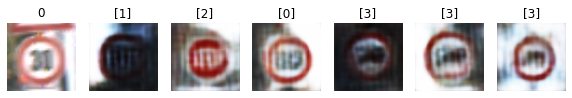

Epoch 29910 g_loss= 1.9875928 d_loss= 0.26608688 real_acc= 0.9 fake_acc= 0.88
Epoch 29920 g_loss= 1.8925424 d_loss= 0.25391096 real_acc= 0.92 fake_acc= 0.88
Epoch 29930 g_loss= 2.029509 d_loss= 0.28912616 real_acc= 0.88 fake_acc= 1.0
Epoch 29940 g_loss= 1.9328712 d_loss= 0.25606573 real_acc= 0.94 fake_acc= 0.94
Epoch 29950 g_loss= 2.2388885 d_loss= 0.21547857 real_acc= 0.92 fake_acc= 0.94
Epoch 29960 g_loss= 2.088396 d_loss= 0.22326323 real_acc= 0.96 fake_acc= 0.92
Epoch 29970 g_loss= 2.9455476 d_loss= 0.26424912 real_acc= 0.78 fake_acc= 0.98
Epoch 29980 g_loss= 1.8290579 d_loss= 0.27013347 real_acc= 0.9 fake_acc= 0.92
Epoch 29990 g_loss= 1.6930292 d_loss= 0.21233094 real_acc= 0.98 fake_acc= 0.92
Epoch 30000 g_loss= 2.241407 d_loss= 0.2156201 real_acc= 0.94 fake_acc= 0.94


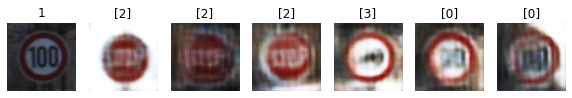

Epoch 30010 g_loss= 2.2396336 d_loss= 0.21651027 real_acc= 0.86 fake_acc= 0.96
Epoch 30020 g_loss= 2.2329237 d_loss= 0.21074314 real_acc= 0.92 fake_acc= 0.98
Epoch 30030 g_loss= 2.1103525 d_loss= 0.23379257 real_acc= 0.94 fake_acc= 0.92
Epoch 30040 g_loss= 1.9432753 d_loss= 0.25985903 real_acc= 0.92 fake_acc= 0.94
Epoch 30050 g_loss= 1.7955593 d_loss= 0.30861592 real_acc= 0.84 fake_acc= 0.96
Epoch 30060 g_loss= 2.4039524 d_loss= 0.2336496 real_acc= 0.9 fake_acc= 0.98
Epoch 30070 g_loss= 2.0417085 d_loss= 0.23288077 real_acc= 0.88 fake_acc= 0.94
Epoch 30080 g_loss= 2.072446 d_loss= 0.28995475 real_acc= 0.88 fake_acc= 0.98
Epoch 30090 g_loss= 2.1952076 d_loss= 0.23681973 real_acc= 0.92 fake_acc= 0.94
Epoch 30100 g_loss= 2.1327827 d_loss= 0.26608846 real_acc= 0.88 fake_acc= 0.92


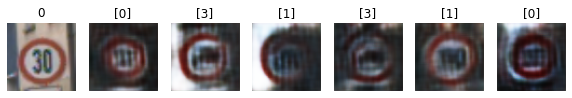

Epoch 30110 g_loss= 1.8814523 d_loss= 0.24812812 real_acc= 0.88 fake_acc= 0.9
Epoch 30120 g_loss= 1.9916089 d_loss= 0.1866132 real_acc= 0.98 fake_acc= 0.98
Epoch 30130 g_loss= 2.6166983 d_loss= 0.20620221 real_acc= 0.92 fake_acc= 0.98
Epoch 30140 g_loss= 2.4457293 d_loss= 0.21681923 real_acc= 0.9 fake_acc= 1.0
Epoch 30150 g_loss= 3.012984 d_loss= 0.2411423 real_acc= 0.86 fake_acc= 0.98
Epoch 30160 g_loss= 2.581778 d_loss= 0.28969496 real_acc= 0.82 fake_acc= 0.94
Epoch 30170 g_loss= 1.8532978 d_loss= 0.20837384 real_acc= 0.98 fake_acc= 0.92
Epoch 30180 g_loss= 2.0670068 d_loss= 0.22589403 real_acc= 0.96 fake_acc= 0.96
Epoch 30190 g_loss= 2.0709493 d_loss= 0.2764736 real_acc= 0.8 fake_acc= 0.9
Epoch 30200 g_loss= 2.0109289 d_loss= 0.2415182 real_acc= 0.92 fake_acc= 0.92


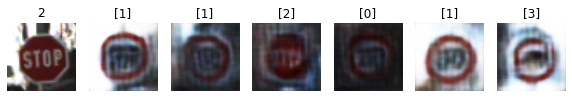

Epoch 30210 g_loss= 2.4028444 d_loss= 0.23211451 real_acc= 0.88 fake_acc= 0.98
Epoch 30220 g_loss= 2.2519178 d_loss= 0.23853096 real_acc= 0.9 fake_acc= 0.94
Epoch 30230 g_loss= 1.9634525 d_loss= 0.24893159 real_acc= 0.9 fake_acc= 0.94
Epoch 30240 g_loss= 1.6669785 d_loss= 0.246526 real_acc= 0.98 fake_acc= 0.86
Epoch 30250 g_loss= 2.166341 d_loss= 0.23007596 real_acc= 0.94 fake_acc= 0.96
Epoch 30260 g_loss= 2.1576009 d_loss= 0.21633002 real_acc= 0.9 fake_acc= 0.94
Epoch 30270 g_loss= 2.0784054 d_loss= 0.24478363 real_acc= 0.92 fake_acc= 0.94
Epoch 30280 g_loss= 2.2861185 d_loss= 0.17588142 real_acc= 0.94 fake_acc= 1.0
Epoch 30290 g_loss= 1.9894954 d_loss= 0.20677754 real_acc= 0.92 fake_acc= 0.96
Epoch 30300 g_loss= 2.2552602 d_loss= 0.29355216 real_acc= 0.82 fake_acc= 1.0


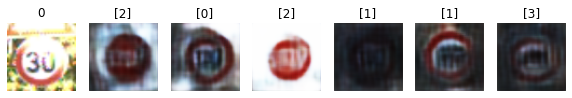

Epoch 30310 g_loss= 1.8014374 d_loss= 0.26885438 real_acc= 0.88 fake_acc= 0.94
Epoch 30320 g_loss= 2.2585173 d_loss= 0.22306916 real_acc= 0.88 fake_acc= 0.98
Epoch 30330 g_loss= 1.8835938 d_loss= 0.24627736 real_acc= 0.92 fake_acc= 0.96
Epoch 30340 g_loss= 2.0319262 d_loss= 0.3013642 real_acc= 0.86 fake_acc= 0.92
Epoch 30350 g_loss= 2.2792017 d_loss= 0.19764501 real_acc= 0.94 fake_acc= 0.98
Epoch 30360 g_loss= 2.357938 d_loss= 0.2878015 real_acc= 0.86 fake_acc= 0.96
Epoch 30370 g_loss= 2.2441697 d_loss= 0.27298307 real_acc= 0.84 fake_acc= 0.9
Epoch 30380 g_loss= 2.233637 d_loss= 0.2739563 real_acc= 0.88 fake_acc= 0.9
Epoch 30390 g_loss= 2.1924937 d_loss= 0.2912041 real_acc= 0.86 fake_acc= 0.94
Epoch 30400 g_loss= 2.1779156 d_loss= 0.2687955 real_acc= 0.86 fake_acc= 0.9


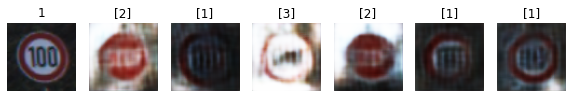

Epoch 30410 g_loss= 2.0910766 d_loss= 0.22242162 real_acc= 0.96 fake_acc= 0.94
Epoch 30420 g_loss= 1.8872349 d_loss= 0.2529771 real_acc= 0.9 fake_acc= 0.96
Epoch 30430 g_loss= 1.6703693 d_loss= 0.258409 real_acc= 0.98 fake_acc= 0.82
Epoch 30440 g_loss= 2.0869997 d_loss= 0.19617788 real_acc= 0.94 fake_acc= 0.92
Epoch 30450 g_loss= 2.1003194 d_loss= 0.2707352 real_acc= 0.9 fake_acc= 0.96
Epoch 30460 g_loss= 2.2645423 d_loss= 0.21048152 real_acc= 0.94 fake_acc= 0.96
Epoch 30470 g_loss= 2.0136204 d_loss= 0.26040143 real_acc= 0.86 fake_acc= 0.94
Epoch 30480 g_loss= 2.2655053 d_loss= 0.1978629 real_acc= 0.88 fake_acc= 1.0
Epoch 30490 g_loss= 2.145467 d_loss= 0.24731925 real_acc= 0.96 fake_acc= 0.94
Epoch 30500 g_loss= 2.1311054 d_loss= 0.24943283 real_acc= 0.9 fake_acc= 0.94


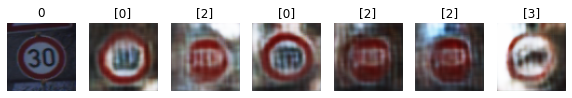

Epoch 30510 g_loss= 1.8692709 d_loss= 0.30284956 real_acc= 0.86 fake_acc= 0.86
Epoch 30520 g_loss= 2.2281137 d_loss= 0.20780203 real_acc= 0.96 fake_acc= 0.94
Epoch 30530 g_loss= 1.7950281 d_loss= 0.24249554 real_acc= 0.98 fake_acc= 0.84
Epoch 30540 g_loss= 2.2754586 d_loss= 0.2511456 real_acc= 0.9 fake_acc= 0.94
Epoch 30550 g_loss= 2.4744134 d_loss= 0.23723346 real_acc= 0.88 fake_acc= 0.96
Epoch 30560 g_loss= 1.6543939 d_loss= 0.23064068 real_acc= 0.98 fake_acc= 0.88
Epoch 30570 g_loss= 1.9445012 d_loss= 0.22941086 real_acc= 0.96 fake_acc= 0.9
Epoch 30580 g_loss= 2.4456966 d_loss= 0.21972355 real_acc= 0.88 fake_acc= 0.98
Epoch 30590 g_loss= 2.172254 d_loss= 0.20129737 real_acc= 0.98 fake_acc= 0.98
Epoch 30600 g_loss= 2.3952005 d_loss= 0.21469015 real_acc= 0.86 fake_acc= 0.98


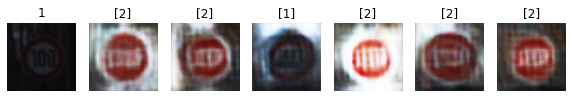

Epoch 30610 g_loss= 2.3991253 d_loss= 0.25004822 real_acc= 0.86 fake_acc= 1.0
Epoch 30620 g_loss= 1.7174993 d_loss= 0.27458107 real_acc= 0.94 fake_acc= 0.78
Epoch 30630 g_loss= 2.3333797 d_loss= 0.18962097 real_acc= 0.92 fake_acc= 0.92
Epoch 30640 g_loss= 2.442806 d_loss= 0.22075903 real_acc= 0.88 fake_acc= 0.96
Epoch 30650 g_loss= 2.921753 d_loss= 0.22759336 real_acc= 0.88 fake_acc= 0.96
Epoch 30660 g_loss= 2.131834 d_loss= 0.2402139 real_acc= 0.88 fake_acc= 0.98
Epoch 30670 g_loss= 2.09227 d_loss= 0.20400316 real_acc= 0.98 fake_acc= 0.94
Epoch 30680 g_loss= 1.5576233 d_loss= 0.2757302 real_acc= 0.94 fake_acc= 0.9
Epoch 30690 g_loss= 2.273814 d_loss= 0.26936322 real_acc= 0.8 fake_acc= 0.96
Epoch 30700 g_loss= 2.144695 d_loss= 0.24093653 real_acc= 0.96 fake_acc= 0.92


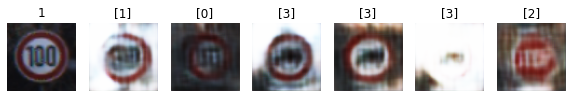

Epoch 30710 g_loss= 1.9996789 d_loss= 0.23683868 real_acc= 0.94 fake_acc= 0.94
Epoch 30720 g_loss= 2.2921052 d_loss= 0.29671496 real_acc= 0.82 fake_acc= 0.94
Epoch 30730 g_loss= 2.2829995 d_loss= 0.24025792 real_acc= 0.86 fake_acc= 0.96
Epoch 30740 g_loss= 2.0163467 d_loss= 0.2498511 real_acc= 0.9 fake_acc= 0.94
Epoch 30750 g_loss= 1.8177344 d_loss= 0.25196722 real_acc= 0.96 fake_acc= 0.88
Epoch 30760 g_loss= 2.2186844 d_loss= 0.30630338 real_acc= 0.8 fake_acc= 0.96
Epoch 30770 g_loss= 2.159992 d_loss= 0.22817868 real_acc= 0.86 fake_acc= 0.98
Epoch 30780 g_loss= 2.5676696 d_loss= 0.14607921 real_acc= 0.96 fake_acc= 0.96
Epoch 30790 g_loss= 1.8521656 d_loss= 0.23027998 real_acc= 0.94 fake_acc= 0.9
Epoch 30800 g_loss= 2.4415596 d_loss= 0.28006124 real_acc= 0.82 fake_acc= 0.96


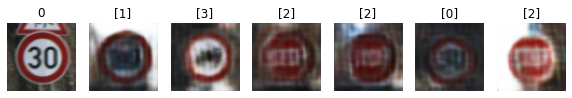

Epoch 30810 g_loss= 2.4240305 d_loss= 0.21947017 real_acc= 0.88 fake_acc= 0.94
Epoch 30820 g_loss= 2.0268955 d_loss= 0.227139 real_acc= 0.96 fake_acc= 0.96
Epoch 30830 g_loss= 2.3348768 d_loss= 0.23053989 real_acc= 0.86 fake_acc= 0.98
Epoch 30840 g_loss= 2.2511256 d_loss= 0.24599433 real_acc= 0.86 fake_acc= 1.0
Epoch 30850 g_loss= 1.7905111 d_loss= 0.23212506 real_acc= 0.96 fake_acc= 0.9
Epoch 30860 g_loss= 2.6095111 d_loss= 0.25264996 real_acc= 0.88 fake_acc= 1.0
Epoch 30870 g_loss= 2.926521 d_loss= 0.26896322 real_acc= 0.84 fake_acc= 1.0
Epoch 30880 g_loss= 1.6273019 d_loss= 0.30431098 real_acc= 0.96 fake_acc= 0.84
Epoch 30890 g_loss= 1.9008174 d_loss= 0.1932402 real_acc= 1.0 fake_acc= 0.96
Epoch 30900 g_loss= 2.1962664 d_loss= 0.31336865 real_acc= 0.76 fake_acc= 0.96


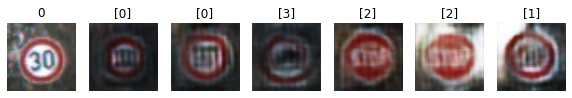

Epoch 30910 g_loss= 2.1899862 d_loss= 0.20247993 real_acc= 0.9 fake_acc= 0.98
Epoch 30920 g_loss= 1.9454732 d_loss= 0.24360558 real_acc= 0.92 fake_acc= 0.94
Epoch 30930 g_loss= 2.1925685 d_loss= 0.18833223 real_acc= 0.96 fake_acc= 0.98
Epoch 30940 g_loss= 2.6637583 d_loss= 0.18975188 real_acc= 0.94 fake_acc= 0.96
Epoch 30950 g_loss= 2.2169325 d_loss= 0.24471897 real_acc= 0.94 fake_acc= 0.92
Epoch 30960 g_loss= 2.308192 d_loss= 0.23828486 real_acc= 0.82 fake_acc= 0.96
Epoch 30970 g_loss= 2.0242999 d_loss= 0.20382138 real_acc= 0.96 fake_acc= 0.96
Epoch 30980 g_loss= 1.972334 d_loss= 0.20302838 real_acc= 0.96 fake_acc= 0.96
Epoch 30990 g_loss= 2.229501 d_loss= 0.22109559 real_acc= 0.94 fake_acc= 0.96
Epoch 31000 g_loss= 2.3940866 d_loss= 0.23952472 real_acc= 0.92 fake_acc= 0.94


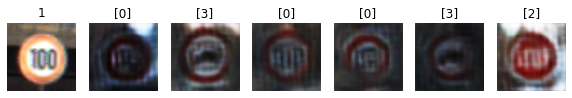

Epoch 31010 g_loss= 2.0977702 d_loss= 0.18290482 real_acc= 0.98 fake_acc= 0.96
Epoch 31020 g_loss= 2.4235935 d_loss= 0.19933073 real_acc= 0.94 fake_acc= 1.0
Epoch 31030 g_loss= 2.501056 d_loss= 0.26379415 real_acc= 0.86 fake_acc= 0.96
Epoch 31040 g_loss= 1.6569858 d_loss= 0.25145042 real_acc= 0.98 fake_acc= 0.84
Epoch 31050 g_loss= 1.8381894 d_loss= 0.25412422 real_acc= 0.92 fake_acc= 0.92
Epoch 31060 g_loss= 1.9558634 d_loss= 0.18960068 real_acc= 0.96 fake_acc= 0.96
Epoch 31070 g_loss= 2.3880153 d_loss= 0.21751475 real_acc= 0.88 fake_acc= 0.98
Epoch 31080 g_loss= 2.6168642 d_loss= 0.18682127 real_acc= 0.9 fake_acc= 0.94
Epoch 31090 g_loss= 2.475654 d_loss= 0.2179912 real_acc= 0.94 fake_acc= 0.96
Epoch 31100 g_loss= 2.03253 d_loss= 0.23102227 real_acc= 0.94 fake_acc= 0.92


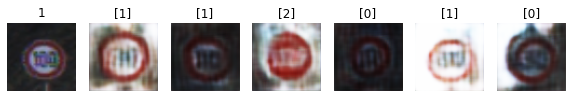

Epoch 31110 g_loss= 2.3804407 d_loss= 0.2961598 real_acc= 0.8 fake_acc= 0.96
Epoch 31120 g_loss= 2.3728292 d_loss= 0.23351142 real_acc= 0.88 fake_acc= 0.98
Epoch 31130 g_loss= 2.0790327 d_loss= 0.24184634 real_acc= 0.98 fake_acc= 0.88
Epoch 31140 g_loss= 1.9579065 d_loss= 0.23071052 real_acc= 0.92 fake_acc= 0.96
Epoch 31150 g_loss= 2.208091 d_loss= 0.25906408 real_acc= 0.88 fake_acc= 0.96
Epoch 31160 g_loss= 2.6661787 d_loss= 0.20384863 real_acc= 0.9 fake_acc= 0.98
Epoch 31170 g_loss= 2.067903 d_loss= 0.25628597 real_acc= 0.9 fake_acc= 0.92
Epoch 31180 g_loss= 2.1257415 d_loss= 0.20018888 real_acc= 0.96 fake_acc= 1.0
Epoch 31190 g_loss= 2.0309227 d_loss= 0.29274353 real_acc= 0.86 fake_acc= 0.98
Epoch 31200 g_loss= 2.3095684 d_loss= 0.23950645 real_acc= 0.88 fake_acc= 0.98


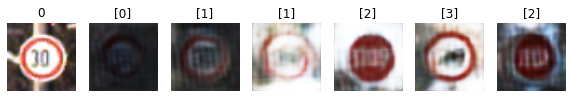

Epoch 31210 g_loss= 1.7642708 d_loss= 0.22553685 real_acc= 0.96 fake_acc= 0.86
Epoch 31220 g_loss= 1.8242146 d_loss= 0.2705254 real_acc= 0.9 fake_acc= 0.92
Epoch 31230 g_loss= 2.3852308 d_loss= 0.22407924 real_acc= 0.9 fake_acc= 0.96
Epoch 31240 g_loss= 2.4209902 d_loss= 0.21047366 real_acc= 0.94 fake_acc= 0.94
Epoch 31250 g_loss= 2.3178346 d_loss= 0.21506847 real_acc= 0.94 fake_acc= 1.0
Epoch 31260 g_loss= 1.7946543 d_loss= 0.21265489 real_acc= 1.0 fake_acc= 0.9
Epoch 31270 g_loss= 1.9677606 d_loss= 0.26081663 real_acc= 0.92 fake_acc= 0.94
Epoch 31280 g_loss= 2.7524989 d_loss= 0.27880844 real_acc= 0.8 fake_acc= 1.0
Epoch 31290 g_loss= 2.4650257 d_loss= 0.21017557 real_acc= 0.92 fake_acc= 0.96
Epoch 31300 g_loss= 2.5628512 d_loss= 0.2570364 real_acc= 0.86 fake_acc= 1.0


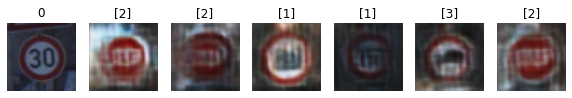

Epoch 31310 g_loss= 2.1554687 d_loss= 0.2738638 real_acc= 0.92 fake_acc= 0.9
Epoch 31320 g_loss= 1.8545238 d_loss= 0.21202558 real_acc= 0.96 fake_acc= 0.98
Epoch 31330 g_loss= 1.9425521 d_loss= 0.2730916 real_acc= 0.9 fake_acc= 0.92
Epoch 31340 g_loss= 2.9353309 d_loss= 0.20945236 real_acc= 0.92 fake_acc= 0.98
Epoch 31350 g_loss= 2.2669756 d_loss= 0.2537745 real_acc= 0.92 fake_acc= 0.98
Epoch 31360 g_loss= 2.3132086 d_loss= 0.24886481 real_acc= 0.86 fake_acc= 0.98
Epoch 31370 g_loss= 2.38194 d_loss= 0.22275572 real_acc= 0.92 fake_acc= 1.0
Epoch 31380 g_loss= 1.9162146 d_loss= 0.27755505 real_acc= 0.9 fake_acc= 0.86
Epoch 31390 g_loss= 2.0593035 d_loss= 0.250889 real_acc= 0.94 fake_acc= 0.92
Epoch 31400 g_loss= 2.1141462 d_loss= 0.16626917 real_acc= 0.98 fake_acc= 0.98


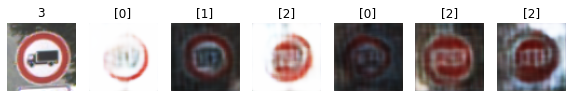

Epoch 31410 g_loss= 2.588399 d_loss= 0.22650775 real_acc= 0.9 fake_acc= 0.94
Epoch 31420 g_loss= 2.5845108 d_loss= 0.29282314 real_acc= 0.8 fake_acc= 0.98
Epoch 31430 g_loss= 1.5795583 d_loss= 0.2432427 real_acc= 0.98 fake_acc= 0.92
Epoch 31440 g_loss= 1.8156034 d_loss= 0.23916833 real_acc= 0.94 fake_acc= 0.88
Epoch 31450 g_loss= 2.0108862 d_loss= 0.24392307 real_acc= 0.92 fake_acc= 0.94
Epoch 31460 g_loss= 2.5293746 d_loss= 0.2223441 real_acc= 0.92 fake_acc= 0.96
Epoch 31470 g_loss= 2.2262769 d_loss= 0.24461225 real_acc= 0.86 fake_acc= 1.0
Epoch 31480 g_loss= 2.0693057 d_loss= 0.19454394 real_acc= 0.98 fake_acc= 0.98
Epoch 31490 g_loss= 2.3774111 d_loss= 0.22613314 real_acc= 0.94 fake_acc= 0.94
Epoch 31500 g_loss= 1.8569812 d_loss= 0.25905418 real_acc= 0.92 fake_acc= 0.92


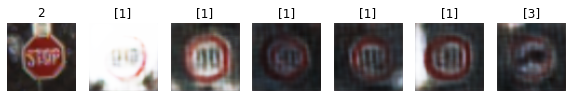

Epoch 31510 g_loss= 1.559982 d_loss= 0.25335595 real_acc= 0.94 fake_acc= 0.86
Epoch 31520 g_loss= 2.2685764 d_loss= 0.22963467 real_acc= 0.92 fake_acc= 0.94
Epoch 31530 g_loss= 2.5130467 d_loss= 0.24419786 real_acc= 0.9 fake_acc= 0.96
Epoch 31540 g_loss= 2.4923038 d_loss= 0.30483922 real_acc= 0.84 fake_acc= 0.98
Epoch 31550 g_loss= 1.8141841 d_loss= 0.29226595 real_acc= 0.88 fake_acc= 0.9
Epoch 31560 g_loss= 2.0875509 d_loss= 0.21413283 real_acc= 0.92 fake_acc= 1.0
Epoch 31570 g_loss= 2.0333683 d_loss= 0.197411 real_acc= 0.96 fake_acc= 0.96
Epoch 31580 g_loss= 1.8636175 d_loss= 0.26361233 real_acc= 0.96 fake_acc= 0.86
Epoch 31590 g_loss= 2.368015 d_loss= 0.3104465 real_acc= 0.8 fake_acc= 0.96
Epoch 31600 g_loss= 2.6255405 d_loss= 0.2789514 real_acc= 0.78 fake_acc= 0.96


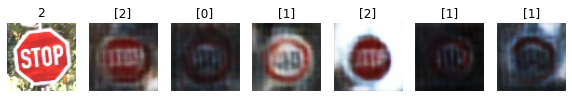

Epoch 31610 g_loss= 2.5842445 d_loss= 0.3220685 real_acc= 0.76 fake_acc= 0.98
Epoch 31620 g_loss= 1.4616113 d_loss= 0.25297 real_acc= 1.0 fake_acc= 0.86
Epoch 31630 g_loss= 2.2185063 d_loss= 0.2715739 real_acc= 0.82 fake_acc= 0.96
Epoch 31640 g_loss= 1.7593309 d_loss= 0.22735867 real_acc= 1.0 fake_acc= 0.86
Epoch 31650 g_loss= 2.2917528 d_loss= 0.34507427 real_acc= 0.7 fake_acc= 0.92
Epoch 31660 g_loss= 2.315407 d_loss= 0.29486144 real_acc= 0.86 fake_acc= 0.96
Epoch 31670 g_loss= 1.9061234 d_loss= 0.27608263 real_acc= 0.94 fake_acc= 0.86
Epoch 31680 g_loss= 1.9520061 d_loss= 0.2579763 real_acc= 0.92 fake_acc= 0.88
Epoch 31690 g_loss= 2.3884804 d_loss= 0.17413259 real_acc= 0.96 fake_acc= 0.98
Epoch 31700 g_loss= 2.4760854 d_loss= 0.22867048 real_acc= 0.88 fake_acc= 0.96


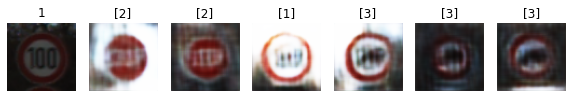

Epoch 31710 g_loss= 1.891546 d_loss= 0.24197948 real_acc= 0.94 fake_acc= 0.9
Epoch 31720 g_loss= 2.5903835 d_loss= 0.29049718 real_acc= 0.82 fake_acc= 0.98
Epoch 31730 g_loss= 2.0679853 d_loss= 0.22516996 real_acc= 0.94 fake_acc= 0.92
Epoch 31740 g_loss= 2.2912035 d_loss= 0.26073378 real_acc= 0.84 fake_acc= 0.94
Epoch 31750 g_loss= 2.3954415 d_loss= 0.27100238 real_acc= 0.78 fake_acc= 0.98
Epoch 31760 g_loss= 1.9785358 d_loss= 0.24279407 real_acc= 0.92 fake_acc= 0.9
Epoch 31770 g_loss= 2.3037798 d_loss= 0.26188302 real_acc= 0.82 fake_acc= 0.94
Epoch 31780 g_loss= 2.3087776 d_loss= 0.22880724 real_acc= 0.88 fake_acc= 0.98
Epoch 31790 g_loss= 2.0487134 d_loss= 0.19851947 real_acc= 0.98 fake_acc= 0.94
Epoch 31800 g_loss= 1.9068978 d_loss= 0.28836823 real_acc= 0.88 fake_acc= 0.86


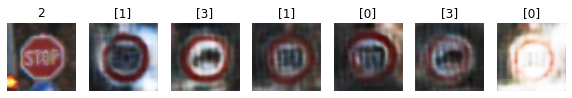

Epoch 31810 g_loss= 2.2963197 d_loss= 0.21031761 real_acc= 0.96 fake_acc= 0.96
Epoch 31820 g_loss= 2.3782232 d_loss= 0.18515958 real_acc= 0.92 fake_acc= 1.0
Epoch 31830 g_loss= 1.8493242 d_loss= 0.24952991 real_acc= 0.9 fake_acc= 0.94
Epoch 31840 g_loss= 2.5478396 d_loss= 0.21090996 real_acc= 0.96 fake_acc= 1.0
Epoch 31850 g_loss= 2.250001 d_loss= 0.21551906 real_acc= 0.9 fake_acc= 0.92
Epoch 31860 g_loss= 2.2705495 d_loss= 0.2360346 real_acc= 0.86 fake_acc= 0.98
Epoch 31870 g_loss= 2.462813 d_loss= 0.18855807 real_acc= 0.94 fake_acc= 0.94
Epoch 31880 g_loss= 2.197652 d_loss= 0.25643015 real_acc= 0.86 fake_acc= 0.94
Epoch 31890 g_loss= 2.1111987 d_loss= 0.21387585 real_acc= 0.96 fake_acc= 0.96
Epoch 31900 g_loss= 2.2950828 d_loss= 0.2996545 real_acc= 0.84 fake_acc= 0.96


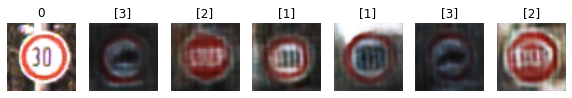

Epoch 31910 g_loss= 2.6996589 d_loss= 0.26708502 real_acc= 0.88 fake_acc= 0.96
Epoch 31920 g_loss= 2.0344372 d_loss= 0.20165116 real_acc= 0.94 fake_acc= 0.92
Epoch 31930 g_loss= 2.294581 d_loss= 0.2337929 real_acc= 0.86 fake_acc= 0.96
Epoch 31940 g_loss= 2.3652725 d_loss= 0.22513148 real_acc= 0.9 fake_acc= 0.98
Epoch 31950 g_loss= 1.9718612 d_loss= 0.21672508 real_acc= 0.98 fake_acc= 0.92
Epoch 31960 g_loss= 2.420746 d_loss= 0.160481 real_acc= 0.98 fake_acc= 0.96
Epoch 31970 g_loss= 2.2379417 d_loss= 0.19492407 real_acc= 0.92 fake_acc= 0.96
Epoch 31980 g_loss= 2.3645601 d_loss= 0.24867982 real_acc= 0.88 fake_acc= 0.98
Epoch 31990 g_loss= 1.9437808 d_loss= 0.24319467 real_acc= 0.88 fake_acc= 0.94
Epoch 32000 g_loss= 1.7352226 d_loss= 0.23494628 real_acc= 0.94 fake_acc= 0.84


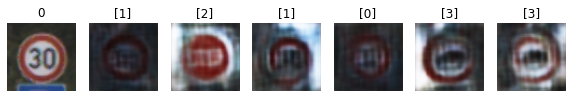

Epoch 32010 g_loss= 2.124586 d_loss= 0.2780199 real_acc= 0.9 fake_acc= 0.94
Epoch 32020 g_loss= 2.4822965 d_loss= 0.25604296 real_acc= 0.88 fake_acc= 0.96
Epoch 32030 g_loss= 2.1731179 d_loss= 0.21332613 real_acc= 0.94 fake_acc= 0.94
Epoch 32040 g_loss= 2.2717304 d_loss= 0.22660586 real_acc= 0.88 fake_acc= 0.94
Epoch 32050 g_loss= 1.8863616 d_loss= 0.20045383 real_acc= 1.0 fake_acc= 0.92
Epoch 32060 g_loss= 2.4070454 d_loss= 0.2091797 real_acc= 0.9 fake_acc= 0.96
Epoch 32070 g_loss= 2.6110337 d_loss= 0.25231534 real_acc= 0.82 fake_acc= 0.96
Epoch 32080 g_loss= 2.1216028 d_loss= 0.30639976 real_acc= 0.78 fake_acc= 0.92
Epoch 32090 g_loss= 2.6466033 d_loss= 0.24194166 real_acc= 0.92 fake_acc= 0.98
Epoch 32100 g_loss= 2.2216446 d_loss= 0.24207735 real_acc= 0.92 fake_acc= 0.92


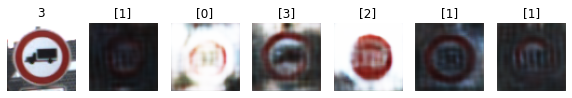

Epoch 32110 g_loss= 2.5100334 d_loss= 0.22048572 real_acc= 0.9 fake_acc= 0.94
Epoch 32120 g_loss= 1.7842139 d_loss= 0.23310953 real_acc= 0.96 fake_acc= 0.88
Epoch 32130 g_loss= 2.0972128 d_loss= 0.22088125 real_acc= 0.94 fake_acc= 0.92
Epoch 32140 g_loss= 2.7139962 d_loss= 0.21737424 real_acc= 0.9 fake_acc= 0.96
Epoch 32150 g_loss= 2.2223861 d_loss= 0.19831085 real_acc= 0.92 fake_acc= 1.0
Epoch 32160 g_loss= 1.8743293 d_loss= 0.2303863 real_acc= 0.96 fake_acc= 0.96
Epoch 32170 g_loss= 2.2890975 d_loss= 0.22783387 real_acc= 0.88 fake_acc= 0.96
Epoch 32180 g_loss= 1.9285642 d_loss= 0.24990058 real_acc= 0.92 fake_acc= 0.92
Epoch 32190 g_loss= 1.6494243 d_loss= 0.25523305 real_acc= 1.0 fake_acc= 0.8
Epoch 32200 g_loss= 2.0158195 d_loss= 0.22251067 real_acc= 0.92 fake_acc= 0.94


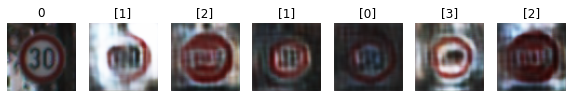

Epoch 32210 g_loss= 2.3011208 d_loss= 0.2631563 real_acc= 0.92 fake_acc= 0.96
Epoch 32220 g_loss= 2.1602616 d_loss= 0.19396782 real_acc= 0.94 fake_acc= 0.92
Epoch 32230 g_loss= 1.8833835 d_loss= 0.22167797 real_acc= 0.88 fake_acc= 0.96
Epoch 32240 g_loss= 1.7284602 d_loss= 0.2840244 real_acc= 0.9 fake_acc= 0.9
Epoch 32250 g_loss= 2.240408 d_loss= 0.1864858 real_acc= 0.92 fake_acc= 0.98
Epoch 32260 g_loss= 2.6611445 d_loss= 0.22042763 real_acc= 0.88 fake_acc= 0.98
Epoch 32270 g_loss= 2.7784503 d_loss= 0.28646952 real_acc= 0.8 fake_acc= 1.0
Epoch 32280 g_loss= 2.7644076 d_loss= 0.25836518 real_acc= 0.84 fake_acc= 1.0
Epoch 32290 g_loss= 1.9232985 d_loss= 0.23158324 real_acc= 0.98 fake_acc= 0.9
Epoch 32300 g_loss= 1.6777108 d_loss= 0.2512 real_acc= 0.98 fake_acc= 0.9


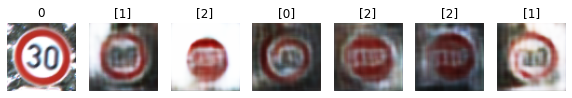

Epoch 32310 g_loss= 2.1562536 d_loss= 0.19261658 real_acc= 0.98 fake_acc= 0.98
Epoch 32320 g_loss= 2.2452424 d_loss= 0.21311699 real_acc= 0.9 fake_acc= 0.98
Epoch 32330 g_loss= 2.0930262 d_loss= 0.22403023 real_acc= 0.92 fake_acc= 0.92
Epoch 32340 g_loss= 2.1508207 d_loss= 0.22129092 real_acc= 0.94 fake_acc= 0.96
Epoch 32350 g_loss= 2.1587074 d_loss= 0.2771584 real_acc= 0.84 fake_acc= 0.92
Epoch 32360 g_loss= 1.8082958 d_loss= 0.2365627 real_acc= 0.92 fake_acc= 0.92
Epoch 32370 g_loss= 2.5633264 d_loss= 0.25501126 real_acc= 0.84 fake_acc= 0.98
Epoch 32380 g_loss= 2.1706796 d_loss= 0.18627775 real_acc= 0.94 fake_acc= 0.98
Epoch 32390 g_loss= 2.4955459 d_loss= 0.2094545 real_acc= 0.92 fake_acc= 0.98
Epoch 32400 g_loss= 2.5274858 d_loss= 0.15429208 real_acc= 0.98 fake_acc= 0.96


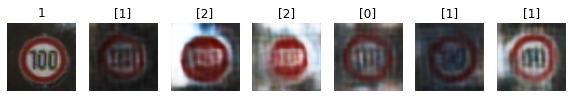

Epoch 32410 g_loss= 2.6364977 d_loss= 0.29763594 real_acc= 0.82 fake_acc= 0.96
Epoch 32420 g_loss= 2.0639527 d_loss= 0.2424111 real_acc= 0.92 fake_acc= 0.88
Epoch 32430 g_loss= 2.132808 d_loss= 0.19068101 real_acc= 0.96 fake_acc= 0.94
Epoch 32440 g_loss= 2.2278636 d_loss= 0.2127136 real_acc= 0.94 fake_acc= 0.98
Epoch 32450 g_loss= 2.1284037 d_loss= 0.18666068 real_acc= 0.98 fake_acc= 0.92
Epoch 32460 g_loss= 2.5745192 d_loss= 0.22331434 real_acc= 0.9 fake_acc= 0.98
Epoch 32470 g_loss= 3.1405265 d_loss= 0.32259125 real_acc= 0.74 fake_acc= 1.0
Epoch 32480 g_loss= 2.2788236 d_loss= 0.25815344 real_acc= 0.84 fake_acc= 0.9
Epoch 32490 g_loss= 2.023526 d_loss= 0.21167059 real_acc= 0.92 fake_acc= 0.98
Epoch 32500 g_loss= 1.9768023 d_loss= 0.22414023 real_acc= 0.96 fake_acc= 0.88


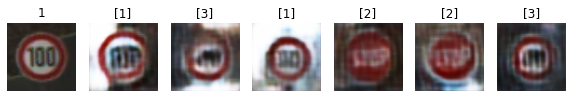

Epoch 32510 g_loss= 2.3631306 d_loss= 0.18627852 real_acc= 0.94 fake_acc= 0.98
Epoch 32520 g_loss= 2.5471177 d_loss= 0.21947023 real_acc= 0.92 fake_acc= 0.98
Epoch 32530 g_loss= 2.1846342 d_loss= 0.24120799 real_acc= 0.9 fake_acc= 0.94
Epoch 32540 g_loss= 2.271386 d_loss= 0.23697615 real_acc= 0.9 fake_acc= 0.96
Epoch 32550 g_loss= 2.0321531 d_loss= 0.21958765 real_acc= 0.96 fake_acc= 0.94
Epoch 32560 g_loss= 2.3610559 d_loss= 0.27040946 real_acc= 0.82 fake_acc= 0.94
Epoch 32570 g_loss= 2.152964 d_loss= 0.22991475 real_acc= 0.9 fake_acc= 0.92
Epoch 32580 g_loss= 2.8355813 d_loss= 0.25260046 real_acc= 0.88 fake_acc= 1.0
Epoch 32590 g_loss= 2.5405338 d_loss= 0.23302089 real_acc= 0.8 fake_acc= 0.96
Epoch 32600 g_loss= 1.913317 d_loss= 0.20230173 real_acc= 0.94 fake_acc= 0.92


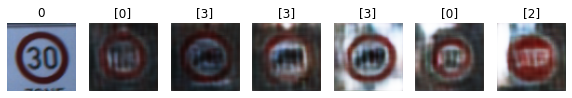

Epoch 32610 g_loss= 2.2018652 d_loss= 0.19377652 real_acc= 0.92 fake_acc= 0.96
Epoch 32620 g_loss= 2.4511547 d_loss= 0.1945401 real_acc= 0.9 fake_acc= 0.98
Epoch 32630 g_loss= 2.1269917 d_loss= 0.267687 real_acc= 0.9 fake_acc= 0.96
Epoch 32640 g_loss= 2.0580316 d_loss= 0.19118497 real_acc= 1.0 fake_acc= 0.92
Epoch 32650 g_loss= 2.2537682 d_loss= 0.20794412 real_acc= 0.9 fake_acc= 0.98
Epoch 32660 g_loss= 2.2146988 d_loss= 0.22714847 real_acc= 0.96 fake_acc= 0.94
Epoch 32670 g_loss= 2.5709727 d_loss= 0.2187267 real_acc= 0.9 fake_acc= 0.96
Epoch 32680 g_loss= 2.6286666 d_loss= 0.18988492 real_acc= 0.94 fake_acc= 1.0
Epoch 32690 g_loss= 2.5228045 d_loss= 0.28962368 real_acc= 0.8 fake_acc= 0.92
Epoch 32700 g_loss= 2.1826882 d_loss= 0.23402312 real_acc= 0.94 fake_acc= 0.98


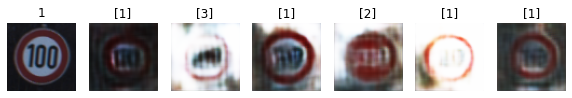

Epoch 32710 g_loss= 1.9540048 d_loss= 0.22727859 real_acc= 0.96 fake_acc= 0.88
Epoch 32720 g_loss= 1.9482526 d_loss= 0.26894277 real_acc= 0.92 fake_acc= 0.86
Epoch 32730 g_loss= 2.5269036 d_loss= 0.1885659 real_acc= 0.92 fake_acc= 0.96
Epoch 32740 g_loss= 2.037352 d_loss= 0.1866625 real_acc= 0.98 fake_acc= 0.98
Epoch 32750 g_loss= 2.0904794 d_loss= 0.21564196 real_acc= 0.92 fake_acc= 0.98
Epoch 32760 g_loss= 2.0991435 d_loss= 0.20471916 real_acc= 0.96 fake_acc= 0.96
Epoch 32770 g_loss= 1.9797091 d_loss= 0.26614904 real_acc= 0.94 fake_acc= 0.96
Epoch 32780 g_loss= 2.2570944 d_loss= 0.19878244 real_acc= 0.94 fake_acc= 0.92
Epoch 32790 g_loss= 2.3194962 d_loss= 0.217417 real_acc= 0.86 fake_acc= 0.98
Epoch 32800 g_loss= 2.5834568 d_loss= 0.21009323 real_acc= 0.94 fake_acc= 1.0


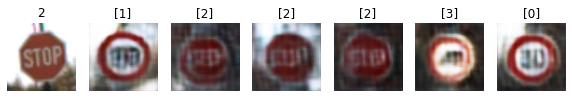

Epoch 32810 g_loss= 2.0475013 d_loss= 0.24151766 real_acc= 0.88 fake_acc= 0.94
Epoch 32820 g_loss= 1.9746828 d_loss= 0.28414106 real_acc= 0.92 fake_acc= 0.9
Epoch 32830 g_loss= 2.3126137 d_loss= 0.203269 real_acc= 0.94 fake_acc= 0.96
Epoch 32840 g_loss= 2.5410786 d_loss= 0.20989534 real_acc= 0.88 fake_acc= 1.0
Epoch 32850 g_loss= 2.2512507 d_loss= 0.23329467 real_acc= 0.88 fake_acc= 0.94
Epoch 32860 g_loss= 2.0220551 d_loss= 0.27007514 real_acc= 0.96 fake_acc= 0.88
Epoch 32870 g_loss= 2.1127656 d_loss= 0.26433033 real_acc= 0.88 fake_acc= 0.9
Epoch 32880 g_loss= 2.3563092 d_loss= 0.20286441 real_acc= 0.96 fake_acc= 0.98
Epoch 32890 g_loss= 2.2577279 d_loss= 0.22088745 real_acc= 0.94 fake_acc= 0.92
Epoch 32900 g_loss= 2.018905 d_loss= 0.24612467 real_acc= 0.88 fake_acc= 0.98


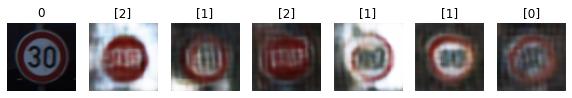

Epoch 32910 g_loss= 2.3880854 d_loss= 0.24903211 real_acc= 0.84 fake_acc= 0.94
Epoch 32920 g_loss= 2.4389393 d_loss= 0.19154832 real_acc= 0.94 fake_acc= 1.0
Epoch 32930 g_loss= 2.09911 d_loss= 0.19988267 real_acc= 0.96 fake_acc= 0.98
Epoch 32940 g_loss= 2.2861984 d_loss= 0.20452754 real_acc= 0.94 fake_acc= 0.92
Epoch 32950 g_loss= 2.1513314 d_loss= 0.19009864 real_acc= 0.94 fake_acc= 0.94
Epoch 32960 g_loss= 2.0887008 d_loss= 0.20580897 real_acc= 0.96 fake_acc= 0.96
Epoch 32970 g_loss= 2.1482475 d_loss= 0.22034241 real_acc= 0.88 fake_acc= 0.98
Epoch 32980 g_loss= 2.4620385 d_loss= 0.19203341 real_acc= 0.94 fake_acc= 1.0
Epoch 32990 g_loss= 2.226555 d_loss= 0.20671876 real_acc= 0.94 fake_acc= 0.9
Epoch 33000 g_loss= 2.0829308 d_loss= 0.3405158 real_acc= 0.8 fake_acc= 0.94


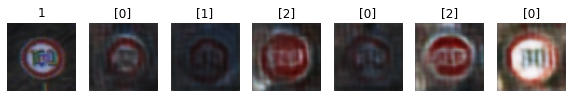

Epoch 33010 g_loss= 2.0946832 d_loss= 0.21713577 real_acc= 0.96 fake_acc= 0.9
Epoch 33020 g_loss= 2.7939827 d_loss= 0.22871748 real_acc= 0.92 fake_acc= 0.94
Epoch 33030 g_loss= 2.1245623 d_loss= 0.26458737 real_acc= 0.82 fake_acc= 1.0
Epoch 33040 g_loss= 1.7390983 d_loss= 0.25135112 real_acc= 0.96 fake_acc= 0.82
Epoch 33050 g_loss= 2.172884 d_loss= 0.22325858 real_acc= 0.9 fake_acc= 0.96
Epoch 33060 g_loss= 2.7133286 d_loss= 0.20812225 real_acc= 0.9 fake_acc= 1.0
Epoch 33070 g_loss= 2.8877938 d_loss= 0.17750907 real_acc= 0.9 fake_acc= 0.98
Epoch 33080 g_loss= 2.6646173 d_loss= 0.20244019 real_acc= 0.88 fake_acc= 0.98
Epoch 33090 g_loss= 2.088992 d_loss= 0.22655188 real_acc= 0.94 fake_acc= 0.94
Epoch 33100 g_loss= 1.7160398 d_loss= 0.31232798 real_acc= 0.9 fake_acc= 0.86


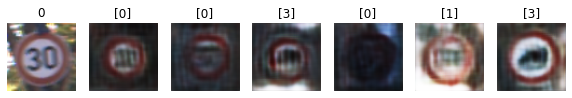

Epoch 33110 g_loss= 2.235368 d_loss= 0.2678752 real_acc= 0.82 fake_acc= 0.96
Epoch 33120 g_loss= 2.5577536 d_loss= 0.2174606 real_acc= 0.94 fake_acc= 0.92
Epoch 33130 g_loss= 2.189439 d_loss= 0.25036505 real_acc= 0.88 fake_acc= 0.92
Epoch 33140 g_loss= 1.5251694 d_loss= 0.30078402 real_acc= 0.92 fake_acc= 0.82
Epoch 33150 g_loss= 2.4954226 d_loss= 0.24320562 real_acc= 0.88 fake_acc= 1.0
Epoch 33160 g_loss= 2.4111211 d_loss= 0.23058203 real_acc= 0.86 fake_acc= 0.96
Epoch 33170 g_loss= 2.1535742 d_loss= 0.24395576 real_acc= 0.86 fake_acc= 0.98
Epoch 33180 g_loss= 2.2332125 d_loss= 0.24940154 real_acc= 0.92 fake_acc= 0.94
Epoch 33190 g_loss= 2.258325 d_loss= 0.20129997 real_acc= 0.9 fake_acc= 0.94
Epoch 33200 g_loss= 2.6133583 d_loss= 0.19283329 real_acc= 0.92 fake_acc= 0.94


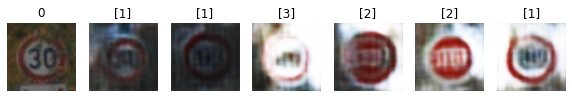

Epoch 33210 g_loss= 2.65135 d_loss= 0.15974323 real_acc= 0.96 fake_acc= 0.96
Epoch 33220 g_loss= 2.3830905 d_loss= 0.2122717 real_acc= 0.94 fake_acc= 0.98
Epoch 33230 g_loss= 2.3554494 d_loss= 0.28553578 real_acc= 0.88 fake_acc= 0.94
Epoch 33240 g_loss= 1.9083551 d_loss= 0.2409322 real_acc= 0.92 fake_acc= 0.92
Epoch 33250 g_loss= 2.1178582 d_loss= 0.1898777 real_acc= 0.98 fake_acc= 0.92
Epoch 33260 g_loss= 2.585414 d_loss= 0.21761625 real_acc= 0.88 fake_acc= 0.98
Epoch 33270 g_loss= 2.5405002 d_loss= 0.22410342 real_acc= 0.84 fake_acc= 0.96
Epoch 33280 g_loss= 2.0633357 d_loss= 0.19625491 real_acc= 0.96 fake_acc= 0.92
Epoch 33290 g_loss= 2.2088723 d_loss= 0.21071357 real_acc= 0.94 fake_acc= 0.96
Epoch 33300 g_loss= 2.6035776 d_loss= 0.19243935 real_acc= 0.92 fake_acc= 0.98


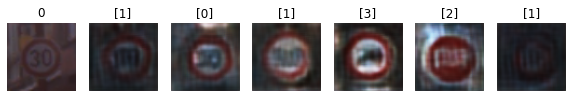

Epoch 33310 g_loss= 2.0889955 d_loss= 0.19191545 real_acc= 0.98 fake_acc= 0.94
Epoch 33320 g_loss= 1.9401387 d_loss= 0.27158043 real_acc= 0.84 fake_acc= 0.88
Epoch 33330 g_loss= 2.3135295 d_loss= 0.27008483 real_acc= 0.86 fake_acc= 0.92
Epoch 33340 g_loss= 2.779977 d_loss= 0.22265859 real_acc= 0.9 fake_acc= 1.0
Epoch 33350 g_loss= 2.595763 d_loss= 0.2660309 real_acc= 0.82 fake_acc= 0.94
Epoch 33360 g_loss= 1.9308541 d_loss= 0.21912241 real_acc= 0.96 fake_acc= 0.96
Epoch 33370 g_loss= 2.2561815 d_loss= 0.19530334 real_acc= 0.96 fake_acc= 0.96
Epoch 33380 g_loss= 2.4120367 d_loss= 0.27033108 real_acc= 0.86 fake_acc= 0.96
Epoch 33390 g_loss= 2.238409 d_loss= 0.23802838 real_acc= 0.94 fake_acc= 1.0
Epoch 33400 g_loss= 2.0051823 d_loss= 0.23627219 real_acc= 0.92 fake_acc= 0.94


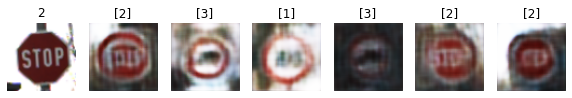

Epoch 33410 g_loss= 2.3118925 d_loss= 0.23906493 real_acc= 0.9 fake_acc= 0.9
Epoch 33420 g_loss= 2.2918768 d_loss= 0.21189463 real_acc= 0.9 fake_acc= 0.94
Epoch 33430 g_loss= 2.692678 d_loss= 0.2216929 real_acc= 0.88 fake_acc= 0.96
Epoch 33440 g_loss= 2.3313477 d_loss= 0.26635334 real_acc= 0.86 fake_acc= 1.0
Epoch 33450 g_loss= 2.318847 d_loss= 0.3002776 real_acc= 0.82 fake_acc= 0.94
Epoch 33460 g_loss= 2.1707737 d_loss= 0.2246302 real_acc= 0.94 fake_acc= 0.92
Epoch 33470 g_loss= 2.18718 d_loss= 0.21857043 real_acc= 0.92 fake_acc= 0.92
Epoch 33480 g_loss= 2.155024 d_loss= 0.20086716 real_acc= 0.96 fake_acc= 1.0
Epoch 33490 g_loss= 2.3801742 d_loss= 0.22854167 real_acc= 0.88 fake_acc= 0.94
Epoch 33500 g_loss= 2.1208148 d_loss= 0.26287496 real_acc= 0.92 fake_acc= 0.9


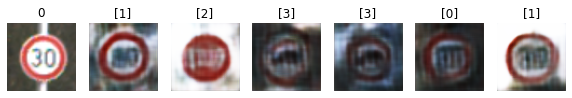

Epoch 33510 g_loss= 2.1457534 d_loss= 0.24609789 real_acc= 0.88 fake_acc= 0.92
Epoch 33520 g_loss= 2.6595504 d_loss= 0.2660861 real_acc= 0.84 fake_acc= 0.98
Epoch 33530 g_loss= 2.1858299 d_loss= 0.23990837 real_acc= 0.88 fake_acc= 0.92
Epoch 33540 g_loss= 1.968029 d_loss= 0.24855796 real_acc= 0.9 fake_acc= 0.88
Epoch 33550 g_loss= 2.0251832 d_loss= 0.23530467 real_acc= 0.94 fake_acc= 0.98
Epoch 33560 g_loss= 2.2646036 d_loss= 0.23276553 real_acc= 0.9 fake_acc= 0.94
Epoch 33570 g_loss= 1.9009722 d_loss= 0.23016098 real_acc= 0.98 fake_acc= 0.92
Epoch 33580 g_loss= 2.064965 d_loss= 0.20605364 real_acc= 0.96 fake_acc= 1.0
Epoch 33590 g_loss= 2.4170425 d_loss= 0.18541339 real_acc= 0.94 fake_acc= 0.96
Epoch 33600 g_loss= 2.5139396 d_loss= 0.26423147 real_acc= 0.84 fake_acc= 0.96


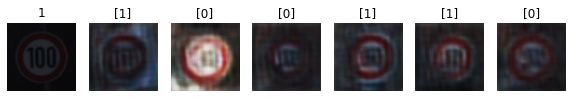

Epoch 33610 g_loss= 2.3351068 d_loss= 0.32276112 real_acc= 0.8 fake_acc= 0.94
Epoch 33620 g_loss= 2.557239 d_loss= 0.22574478 real_acc= 0.86 fake_acc= 0.98
Epoch 33630 g_loss= 2.0185175 d_loss= 0.2460333 real_acc= 0.92 fake_acc= 0.86
Epoch 33640 g_loss= 1.9904754 d_loss= 0.23649591 real_acc= 0.92 fake_acc= 0.92
Epoch 33650 g_loss= 2.3539102 d_loss= 0.1871317 real_acc= 0.96 fake_acc= 0.94
Epoch 33660 g_loss= 3.0055356 d_loss= 0.19532593 real_acc= 0.86 fake_acc= 1.0
Epoch 33670 g_loss= 2.2392313 d_loss= 0.26788956 real_acc= 0.86 fake_acc= 0.94
Epoch 33680 g_loss= 1.8699024 d_loss= 0.23617375 real_acc= 0.96 fake_acc= 0.82
Epoch 33690 g_loss= 2.4238293 d_loss= 0.2180956 real_acc= 0.92 fake_acc= 0.96
Epoch 33700 g_loss= 2.1842446 d_loss= 0.2309593 real_acc= 0.94 fake_acc= 0.98


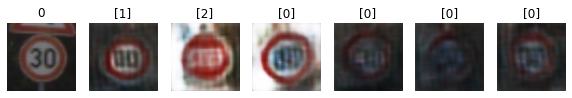

Epoch 33710 g_loss= 2.2574232 d_loss= 0.22000527 real_acc= 0.96 fake_acc= 0.94
Epoch 33720 g_loss= 2.379883 d_loss= 0.18009458 real_acc= 0.9 fake_acc= 0.98
Epoch 33730 g_loss= 2.298497 d_loss= 0.2497406 real_acc= 0.88 fake_acc= 0.96
Epoch 33740 g_loss= 2.4427712 d_loss= 0.2069759 real_acc= 0.88 fake_acc= 0.98
Epoch 33750 g_loss= 2.4737365 d_loss= 0.24069268 real_acc= 0.84 fake_acc= 0.96
Epoch 33760 g_loss= 2.443395 d_loss= 0.24558198 real_acc= 0.86 fake_acc= 0.96
Epoch 33770 g_loss= 2.5787394 d_loss= 0.22083089 real_acc= 0.88 fake_acc= 0.96
Epoch 33780 g_loss= 2.5049143 d_loss= 0.28163174 real_acc= 0.86 fake_acc= 0.96
Epoch 33790 g_loss= 2.2087765 d_loss= 0.20922402 real_acc= 0.92 fake_acc= 0.94
Epoch 33800 g_loss= 2.6026251 d_loss= 0.2766439 real_acc= 0.78 fake_acc= 0.98


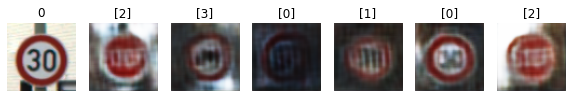

Epoch 33810 g_loss= 2.3434722 d_loss= 0.20821792 real_acc= 0.84 fake_acc= 0.96
Epoch 33820 g_loss= 2.040912 d_loss= 0.3230581 real_acc= 0.82 fake_acc= 0.9
Epoch 33830 g_loss= 2.1287801 d_loss= 0.26662236 real_acc= 0.86 fake_acc= 0.96
Epoch 33840 g_loss= 2.4053402 d_loss= 0.19874644 real_acc= 0.94 fake_acc= 0.96
Epoch 33850 g_loss= 2.1337032 d_loss= 0.26772165 real_acc= 0.9 fake_acc= 0.9
Epoch 33860 g_loss= 2.069265 d_loss= 0.19139197 real_acc= 0.98 fake_acc= 0.92
Epoch 33870 g_loss= 2.4105732 d_loss= 0.22577766 real_acc= 0.84 fake_acc= 0.98
Epoch 33880 g_loss= 2.4919631 d_loss= 0.25530222 real_acc= 0.88 fake_acc= 1.0
Epoch 33890 g_loss= 1.880693 d_loss= 0.23198715 real_acc= 0.96 fake_acc= 0.84
Epoch 33900 g_loss= 2.055513 d_loss= 0.2627152 real_acc= 0.9 fake_acc= 0.96


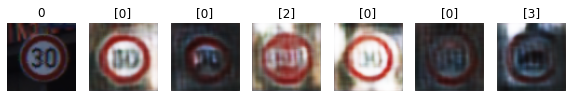

Epoch 33910 g_loss= 2.6428378 d_loss= 0.25479704 real_acc= 0.82 fake_acc= 1.0
Epoch 33920 g_loss= 2.4434621 d_loss= 0.18388385 real_acc= 0.96 fake_acc= 0.96
Epoch 33930 g_loss= 2.2236762 d_loss= 0.18482181 real_acc= 0.94 fake_acc= 0.9
Epoch 33940 g_loss= 2.2193928 d_loss= 0.24228749 real_acc= 0.92 fake_acc= 0.9
Epoch 33950 g_loss= 2.4140894 d_loss= 0.20989768 real_acc= 0.92 fake_acc= 0.96
Epoch 33960 g_loss= 1.9178139 d_loss= 0.21358772 real_acc= 0.96 fake_acc= 0.94
Epoch 33970 g_loss= 2.1852891 d_loss= 0.17012858 real_acc= 0.98 fake_acc= 0.92
Epoch 33980 g_loss= 2.2984312 d_loss= 0.22572275 real_acc= 0.88 fake_acc= 0.92
Epoch 33990 g_loss= 2.5671263 d_loss= 0.27205503 real_acc= 0.8 fake_acc= 0.94
Epoch 34000 g_loss= 3.0690882 d_loss= 0.32960665 real_acc= 0.8 fake_acc= 1.0


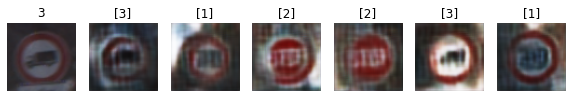

Epoch 34010 g_loss= 2.4333854 d_loss= 0.24963015 real_acc= 0.84 fake_acc= 0.98
Epoch 34020 g_loss= 1.8738005 d_loss= 0.28002876 real_acc= 0.9 fake_acc= 0.88
Epoch 34030 g_loss= 2.2392313 d_loss= 0.18053362 real_acc= 0.92 fake_acc= 0.92
Epoch 34040 g_loss= 2.1464074 d_loss= 0.24646777 real_acc= 0.96 fake_acc= 0.92
Epoch 34050 g_loss= 2.4223268 d_loss= 0.21457776 real_acc= 0.94 fake_acc= 0.94
Epoch 34060 g_loss= 2.4700882 d_loss= 0.20818007 real_acc= 0.92 fake_acc= 0.98
Epoch 34070 g_loss= 1.941252 d_loss= 0.31271094 real_acc= 0.86 fake_acc= 0.96
Epoch 34080 g_loss= 2.427432 d_loss= 0.21984895 real_acc= 0.92 fake_acc= 0.96
Epoch 34090 g_loss= 2.2356188 d_loss= 0.21931699 real_acc= 0.92 fake_acc= 1.0
Epoch 34100 g_loss= 2.2740755 d_loss= 0.259411 real_acc= 0.86 fake_acc= 0.98


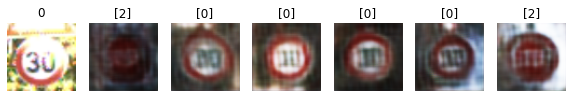

Epoch 34110 g_loss= 1.8892725 d_loss= 0.23986866 real_acc= 0.94 fake_acc= 0.9
Epoch 34120 g_loss= 2.4098802 d_loss= 0.20516056 real_acc= 0.9 fake_acc= 0.96
Epoch 34130 g_loss= 2.6000283 d_loss= 0.24285975 real_acc= 0.84 fake_acc= 0.92
Epoch 34140 g_loss= 2.2832022 d_loss= 0.21375594 real_acc= 0.96 fake_acc= 0.94
Epoch 34150 g_loss= 1.9743478 d_loss= 0.22760224 real_acc= 0.9 fake_acc= 0.98
Epoch 34160 g_loss= 1.4856901 d_loss= 0.2514408 real_acc= 1.0 fake_acc= 0.82
Epoch 34170 g_loss= 2.6691742 d_loss= 0.2382069 real_acc= 0.92 fake_acc= 1.0
Epoch 34180 g_loss= 3.0439346 d_loss= 0.30929583 real_acc= 0.74 fake_acc= 0.98
Epoch 34190 g_loss= 2.1837573 d_loss= 0.21276323 real_acc= 0.92 fake_acc= 0.92
Epoch 34200 g_loss= 1.8723633 d_loss= 0.23700705 real_acc= 0.94 fake_acc= 0.88


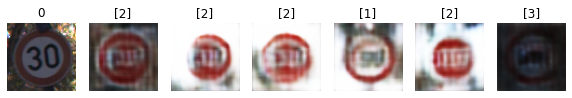

Epoch 34210 g_loss= 2.158036 d_loss= 0.22183555 real_acc= 0.96 fake_acc= 0.92
Epoch 34220 g_loss= 2.2429755 d_loss= 0.19765462 real_acc= 0.96 fake_acc= 0.98
Epoch 34230 g_loss= 2.250104 d_loss= 0.20959562 real_acc= 0.92 fake_acc= 0.94
Epoch 34240 g_loss= 2.4932241 d_loss= 0.24409547 real_acc= 0.92 fake_acc= 0.98
Epoch 34250 g_loss= 2.5616772 d_loss= 0.27389354 real_acc= 0.78 fake_acc= 0.96
Epoch 34260 g_loss= 2.7341287 d_loss= 0.23618338 real_acc= 0.86 fake_acc= 1.0
Epoch 34270 g_loss= 2.0408607 d_loss= 0.21258774 real_acc= 0.96 fake_acc= 0.94
Epoch 34280 g_loss= 1.9049809 d_loss= 0.25487983 real_acc= 0.94 fake_acc= 0.88
Epoch 34290 g_loss= 1.9852974 d_loss= 0.27467364 real_acc= 0.92 fake_acc= 0.92
Epoch 34300 g_loss= 2.9580936 d_loss= 0.26600516 real_acc= 0.76 fake_acc= 0.98


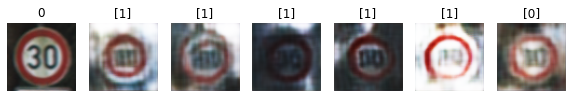

Epoch 34310 g_loss= 2.7500422 d_loss= 0.21347904 real_acc= 0.86 fake_acc= 1.0
Epoch 34320 g_loss= 2.1722238 d_loss= 0.24151626 real_acc= 0.9 fake_acc= 0.92
Epoch 34330 g_loss= 1.7510914 d_loss= 0.26189843 real_acc= 0.94 fake_acc= 0.88
Epoch 34340 g_loss= 2.4319026 d_loss= 0.21283348 real_acc= 0.9 fake_acc= 0.96
Epoch 34350 g_loss= 2.301177 d_loss= 0.17758584 real_acc= 0.98 fake_acc= 0.94
Epoch 34360 g_loss= 2.3006148 d_loss= 0.25572026 real_acc= 0.86 fake_acc= 0.94
Epoch 34370 g_loss= 1.8906808 d_loss= 0.21712905 real_acc= 0.96 fake_acc= 0.94
Epoch 34380 g_loss= 1.8704723 d_loss= 0.20565456 real_acc= 1.0 fake_acc= 0.94
Epoch 34390 g_loss= 3.092971 d_loss= 0.25150406 real_acc= 0.86 fake_acc= 1.0
Epoch 34400 g_loss= 2.7863007 d_loss= 0.25967866 real_acc= 0.8 fake_acc= 1.0


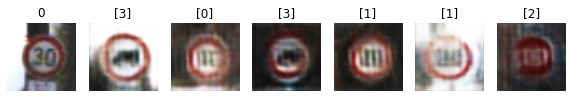

Epoch 34410 g_loss= 2.6820502 d_loss= 0.24179992 real_acc= 0.86 fake_acc= 1.0
Epoch 34420 g_loss= 2.115499 d_loss= 0.2290074 real_acc= 0.94 fake_acc= 0.96
Epoch 34430 g_loss= 2.2547312 d_loss= 0.26765025 real_acc= 0.84 fake_acc= 0.92
Epoch 34440 g_loss= 2.2744403 d_loss= 0.24326734 real_acc= 0.9 fake_acc= 0.96
Epoch 34450 g_loss= 2.490603 d_loss= 0.19885883 real_acc= 0.9 fake_acc= 0.98
Epoch 34460 g_loss= 2.2793365 d_loss= 0.27934626 real_acc= 0.84 fake_acc= 0.96
Epoch 34470 g_loss= 2.0416584 d_loss= 0.19947568 real_acc= 0.98 fake_acc= 0.9
Epoch 34480 g_loss= 1.792833 d_loss= 0.28518707 real_acc= 0.92 fake_acc= 0.88
Epoch 34490 g_loss= 2.2362013 d_loss= 0.19833155 real_acc= 0.98 fake_acc= 0.96
Epoch 34500 g_loss= 2.4967527 d_loss= 0.24010724 real_acc= 0.92 fake_acc= 1.0


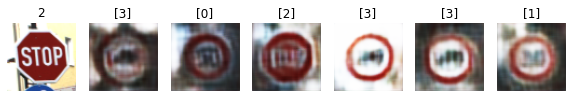

Epoch 34510 g_loss= 2.4948459 d_loss= 0.22936897 real_acc= 0.92 fake_acc= 0.96
Epoch 34520 g_loss= 2.256234 d_loss= 0.2026903 real_acc= 0.96 fake_acc= 0.96
Epoch 34530 g_loss= 2.1930087 d_loss= 0.2544852 real_acc= 0.94 fake_acc= 0.92
Epoch 34540 g_loss= 2.08413 d_loss= 0.22696161 real_acc= 0.94 fake_acc= 0.9
Epoch 34550 g_loss= 2.2060816 d_loss= 0.22598523 real_acc= 0.96 fake_acc= 0.92
Epoch 34560 g_loss= 2.2487035 d_loss= 0.22555655 real_acc= 0.92 fake_acc= 0.98
Epoch 34570 g_loss= 2.0501194 d_loss= 0.19902043 real_acc= 0.96 fake_acc= 0.94
Epoch 34580 g_loss= 2.2185757 d_loss= 0.2381725 real_acc= 0.88 fake_acc= 0.94
Epoch 34590 g_loss= 2.344893 d_loss= 0.21869814 real_acc= 0.94 fake_acc= 0.9
Epoch 34600 g_loss= 1.7332722 d_loss= 0.282158 real_acc= 0.98 fake_acc= 0.9


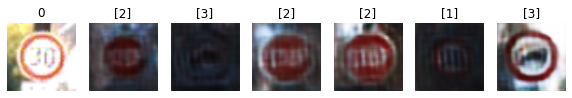

Epoch 34610 g_loss= 1.9256548 d_loss= 0.24155766 real_acc= 0.86 fake_acc= 0.98
Epoch 34620 g_loss= 2.243698 d_loss= 0.17148286 real_acc= 0.98 fake_acc= 0.96
Epoch 34630 g_loss= 2.5212336 d_loss= 0.22080371 real_acc= 0.9 fake_acc= 0.98
Epoch 34640 g_loss= 2.336986 d_loss= 0.21460898 real_acc= 0.94 fake_acc= 0.96
Epoch 34650 g_loss= 2.1106396 d_loss= 0.19824365 real_acc= 0.98 fake_acc= 0.96
Epoch 34660 g_loss= 2.0519514 d_loss= 0.22232825 real_acc= 0.94 fake_acc= 0.94
Epoch 34670 g_loss= 2.0981596 d_loss= 0.3160196 real_acc= 0.84 fake_acc= 0.94
Epoch 34680 g_loss= 2.0870304 d_loss= 0.27349603 real_acc= 0.88 fake_acc= 0.88
Epoch 34690 g_loss= 1.7437053 d_loss= 0.23935533 real_acc= 0.98 fake_acc= 0.9
Epoch 34700 g_loss= 1.7599635 d_loss= 0.28495717 real_acc= 0.9 fake_acc= 0.84


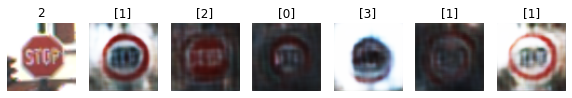

Epoch 34710 g_loss= 2.586431 d_loss= 0.21056461 real_acc= 0.86 fake_acc= 1.0
Epoch 34720 g_loss= 2.8515213 d_loss= 0.295398 real_acc= 0.78 fake_acc= 0.98
Epoch 34730 g_loss= 3.0560524 d_loss= 0.20531756 real_acc= 0.88 fake_acc= 1.0
Epoch 34740 g_loss= 2.093103 d_loss= 0.18996458 real_acc= 0.94 fake_acc= 0.92
Epoch 34750 g_loss= 2.0620768 d_loss= 0.20544417 real_acc= 0.96 fake_acc= 0.9
Epoch 34760 g_loss= 1.8289424 d_loss= 0.24203089 real_acc= 0.9 fake_acc= 0.94
Epoch 34770 g_loss= 2.384173 d_loss= 0.3134398 real_acc= 0.78 fake_acc= 0.92
Epoch 34780 g_loss= 1.9467821 d_loss= 0.23555635 real_acc= 0.96 fake_acc= 0.92
Epoch 34790 g_loss= 1.9455125 d_loss= 0.25849193 real_acc= 0.94 fake_acc= 0.9
Epoch 34800 g_loss= 1.7583193 d_loss= 0.24772647 real_acc= 0.96 fake_acc= 0.84


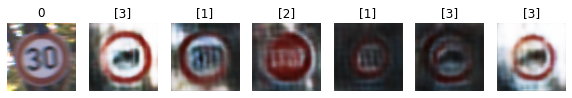

Epoch 34810 g_loss= 2.1562417 d_loss= 0.18392053 real_acc= 1.0 fake_acc= 0.96
Epoch 34820 g_loss= 2.6437325 d_loss= 0.22913042 real_acc= 0.88 fake_acc= 0.96
Epoch 34830 g_loss= 2.4294739 d_loss= 0.28831366 real_acc= 0.86 fake_acc= 0.98
Epoch 34840 g_loss= 1.9314063 d_loss= 0.23978698 real_acc= 0.9 fake_acc= 0.94
Epoch 34850 g_loss= 2.2766938 d_loss= 0.21216321 real_acc= 0.94 fake_acc= 0.94
Epoch 34860 g_loss= 2.6147048 d_loss= 0.23753628 real_acc= 0.78 fake_acc= 0.98
Epoch 34870 g_loss= 2.2767947 d_loss= 0.24542889 real_acc= 0.84 fake_acc= 0.98
Epoch 34880 g_loss= 1.9499164 d_loss= 0.2344895 real_acc= 0.96 fake_acc= 0.9
Epoch 34890 g_loss= 2.003449 d_loss= 0.22874153 real_acc= 0.94 fake_acc= 0.96
Epoch 34900 g_loss= 2.476884 d_loss= 0.25307167 real_acc= 0.84 fake_acc= 1.0


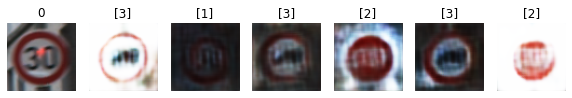

Epoch 34910 g_loss= 2.0311391 d_loss= 0.21367356 real_acc= 0.94 fake_acc= 0.98
Epoch 34920 g_loss= 2.2153451 d_loss= 0.19123207 real_acc= 0.94 fake_acc= 1.0
Epoch 34930 g_loss= 2.3413398 d_loss= 0.20513484 real_acc= 0.92 fake_acc= 0.96
Epoch 34940 g_loss= 2.3735056 d_loss= 0.19463256 real_acc= 0.94 fake_acc= 0.98
Epoch 34950 g_loss= 2.1146421 d_loss= 0.22720155 real_acc= 0.94 fake_acc= 0.96
Epoch 34960 g_loss= 2.3849914 d_loss= 0.21117559 real_acc= 0.92 fake_acc= 0.92
Epoch 34970 g_loss= 2.7314692 d_loss= 0.22284012 real_acc= 0.86 fake_acc= 1.0
Epoch 34980 g_loss= 2.2421641 d_loss= 0.24771233 real_acc= 0.9 fake_acc= 0.96
Epoch 34990 g_loss= 2.252822 d_loss= 0.2274663 real_acc= 0.92 fake_acc= 0.98
Epoch 35000 g_loss= 1.9521734 d_loss= 0.27301824 real_acc= 0.9 fake_acc= 0.86


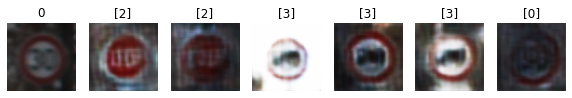

Epoch 35010 g_loss= 1.9354707 d_loss= 0.19567955 real_acc= 0.98 fake_acc= 0.94
Epoch 35020 g_loss= 2.4242895 d_loss= 0.18707931 real_acc= 0.94 fake_acc= 1.0
Epoch 35030 g_loss= 2.080274 d_loss= 0.25825882 real_acc= 0.9 fake_acc= 0.92
Epoch 35040 g_loss= 1.9686927 d_loss= 0.24037018 real_acc= 0.92 fake_acc= 0.94
Epoch 35050 g_loss= 2.2579088 d_loss= 0.18123782 real_acc= 0.98 fake_acc= 0.96
Epoch 35060 g_loss= 2.2645485 d_loss= 0.25354633 real_acc= 0.9 fake_acc= 0.9
Epoch 35070 g_loss= 2.1004581 d_loss= 0.25750172 real_acc= 0.9 fake_acc= 0.94
Epoch 35080 g_loss= 2.347544 d_loss= 0.15736458 real_acc= 0.96 fake_acc= 1.0
Epoch 35090 g_loss= 2.0692236 d_loss= 0.22564748 real_acc= 0.96 fake_acc= 0.94
Epoch 35100 g_loss= 2.4867544 d_loss= 0.25807175 real_acc= 0.84 fake_acc= 0.96


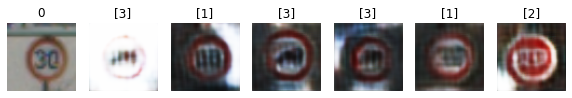

Epoch 35110 g_loss= 2.2717085 d_loss= 0.20249116 real_acc= 0.94 fake_acc= 0.96
Epoch 35120 g_loss= 2.042565 d_loss= 0.22188747 real_acc= 0.96 fake_acc= 0.98
Epoch 35130 g_loss= 1.6962413 d_loss= 0.29531866 real_acc= 0.94 fake_acc= 0.88
Epoch 35140 g_loss= 2.2767289 d_loss= 0.21302734 real_acc= 0.92 fake_acc= 0.94
Epoch 35150 g_loss= 2.3072262 d_loss= 0.19645609 real_acc= 0.94 fake_acc= 0.96
Epoch 35160 g_loss= 1.9869465 d_loss= 0.21603277 real_acc= 0.96 fake_acc= 0.92
Epoch 35170 g_loss= 2.4743674 d_loss= 0.17989351 real_acc= 0.92 fake_acc= 0.98
Epoch 35180 g_loss= 2.375474 d_loss= 0.1989775 real_acc= 0.92 fake_acc= 0.96
Epoch 35190 g_loss= 2.112375 d_loss= 0.3250564 real_acc= 0.8 fake_acc= 0.94
Epoch 35200 g_loss= 1.7531565 d_loss= 0.26954782 real_acc= 0.96 fake_acc= 0.82


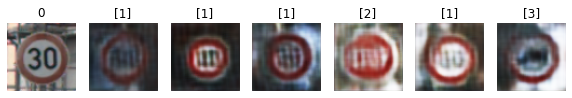

Epoch 35210 g_loss= 2.4271014 d_loss= 0.19908932 real_acc= 0.94 fake_acc= 0.96
Epoch 35220 g_loss= 2.7574286 d_loss= 0.2418301 real_acc= 0.82 fake_acc= 0.98
Epoch 35230 g_loss= 2.6784356 d_loss= 0.2654762 real_acc= 0.86 fake_acc= 0.96
Epoch 35240 g_loss= 1.7698125 d_loss= 0.23719645 real_acc= 0.96 fake_acc= 0.88
Epoch 35250 g_loss= 1.821751 d_loss= 0.23723607 real_acc= 1.0 fake_acc= 0.9
Epoch 35260 g_loss= 2.356785 d_loss= 0.2124007 real_acc= 0.9 fake_acc= 0.9
Epoch 35270 g_loss= 2.152205 d_loss= 0.20957357 real_acc= 0.98 fake_acc= 0.92
Epoch 35280 g_loss= 2.6552153 d_loss= 0.25085032 real_acc= 0.88 fake_acc= 1.0
Epoch 35290 g_loss= 2.6058786 d_loss= 0.23993659 real_acc= 0.82 fake_acc= 1.0
Epoch 35300 g_loss= 1.9339628 d_loss= 0.24438156 real_acc= 0.94 fake_acc= 0.94


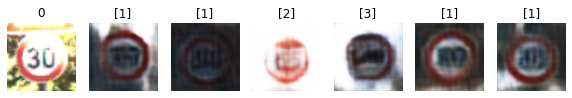

Epoch 35310 g_loss= 2.4326878 d_loss= 0.29471377 real_acc= 0.86 fake_acc= 0.88
Epoch 35320 g_loss= 2.4505892 d_loss= 0.2517871 real_acc= 0.88 fake_acc= 0.94
Epoch 35330 g_loss= 2.0392013 d_loss= 0.20667675 real_acc= 0.98 fake_acc= 0.94
Epoch 35340 g_loss= 2.1224144 d_loss= 0.27838618 real_acc= 0.86 fake_acc= 0.94
Epoch 35350 g_loss= 1.6216371 d_loss= 0.26052934 real_acc= 0.98 fake_acc= 0.84
Epoch 35360 g_loss= 2.140922 d_loss= 0.20040312 real_acc= 0.96 fake_acc= 0.94
Epoch 35370 g_loss= 1.8311805 d_loss= 0.25574118 real_acc= 0.92 fake_acc= 0.88
Epoch 35380 g_loss= 2.302199 d_loss= 0.2650435 real_acc= 0.88 fake_acc= 0.96
Epoch 35390 g_loss= 2.6333022 d_loss= 0.25368685 real_acc= 0.84 fake_acc= 0.96
Epoch 35400 g_loss= 2.4053714 d_loss= 0.20763482 real_acc= 0.92 fake_acc= 0.94


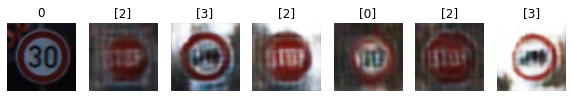

Epoch 35410 g_loss= 2.2047324 d_loss= 0.23644827 real_acc= 0.96 fake_acc= 0.96
Epoch 35420 g_loss= 1.841052 d_loss= 0.21209224 real_acc= 0.96 fake_acc= 0.98
Epoch 35430 g_loss= 2.5138876 d_loss= 0.22505036 real_acc= 0.88 fake_acc= 0.96
Epoch 35440 g_loss= 2.5135448 d_loss= 0.22334869 real_acc= 0.92 fake_acc= 1.0
Epoch 35450 g_loss= 2.0286121 d_loss= 0.22756228 real_acc= 0.94 fake_acc= 0.88
Epoch 35460 g_loss= 2.162033 d_loss= 0.2188609 real_acc= 0.94 fake_acc= 0.92
Epoch 35470 g_loss= 2.5808327 d_loss= 0.31203446 real_acc= 0.8 fake_acc= 0.94
Epoch 35480 g_loss= 2.1666498 d_loss= 0.18229973 real_acc= 0.94 fake_acc= 0.98
Epoch 35490 g_loss= 2.1666474 d_loss= 0.23222873 real_acc= 0.92 fake_acc= 0.88
Epoch 35500 g_loss= 2.0338938 d_loss= 0.29267144 real_acc= 0.88 fake_acc= 0.92


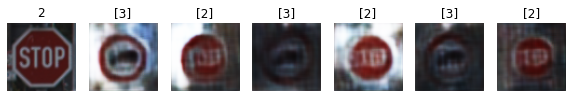

Epoch 35510 g_loss= 2.431069 d_loss= 0.2661892 real_acc= 0.86 fake_acc= 0.92
Epoch 35520 g_loss= 1.9474859 d_loss= 0.22881928 real_acc= 0.92 fake_acc= 0.98
Epoch 35530 g_loss= 1.8103011 d_loss= 0.23966277 real_acc= 0.98 fake_acc= 0.88
Epoch 35540 g_loss= 2.270632 d_loss= 0.24934104 real_acc= 0.86 fake_acc= 0.96
Epoch 35550 g_loss= 2.1275434 d_loss= 0.18308991 real_acc= 0.92 fake_acc= 0.88
Epoch 35560 g_loss= 2.0240173 d_loss= 0.25496697 real_acc= 0.94 fake_acc= 0.94
Epoch 35570 g_loss= 2.6886985 d_loss= 0.1857534 real_acc= 0.92 fake_acc= 1.0
Epoch 35580 g_loss= 2.0975103 d_loss= 0.24144402 real_acc= 0.94 fake_acc= 0.86
Epoch 35590 g_loss= 2.089653 d_loss= 0.22237699 real_acc= 0.9 fake_acc= 0.96
Epoch 35600 g_loss= 1.7078122 d_loss= 0.2971409 real_acc= 0.96 fake_acc= 0.88


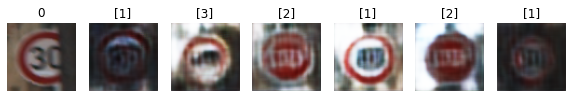

Epoch 35610 g_loss= 2.2272027 d_loss= 0.2067602 real_acc= 0.92 fake_acc= 0.96
Epoch 35620 g_loss= 1.9582208 d_loss= 0.23676431 real_acc= 0.88 fake_acc= 0.92
Epoch 35630 g_loss= 2.288456 d_loss= 0.29006454 real_acc= 0.88 fake_acc= 0.98
Epoch 35640 g_loss= 2.4117348 d_loss= 0.2175442 real_acc= 0.92 fake_acc= 0.96
Epoch 35650 g_loss= 2.3047726 d_loss= 0.22357327 real_acc= 0.9 fake_acc= 0.96
Epoch 35660 g_loss= 2.2822957 d_loss= 0.26252377 real_acc= 0.94 fake_acc= 0.88
Epoch 35670 g_loss= 2.178914 d_loss= 0.19529673 real_acc= 0.94 fake_acc= 0.98
Epoch 35680 g_loss= 2.0061796 d_loss= 0.2736258 real_acc= 0.9 fake_acc= 0.9
Epoch 35690 g_loss= 1.9978645 d_loss= 0.27870056 real_acc= 0.94 fake_acc= 0.88
Epoch 35700 g_loss= 2.4357793 d_loss= 0.25652254 real_acc= 0.84 fake_acc= 0.98


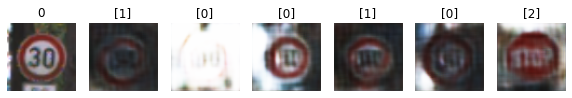

Epoch 35710 g_loss= 2.3864675 d_loss= 0.26263225 real_acc= 0.86 fake_acc= 0.96
Epoch 35720 g_loss= 2.617192 d_loss= 0.25639778 real_acc= 0.86 fake_acc= 0.98
Epoch 35730 g_loss= 2.1829133 d_loss= 0.250563 real_acc= 0.92 fake_acc= 0.94
Epoch 35740 g_loss= 1.8978281 d_loss= 0.24144849 real_acc= 0.96 fake_acc= 0.86
Epoch 35750 g_loss= 2.0343752 d_loss= 0.23475078 real_acc= 0.9 fake_acc= 0.94
Epoch 35760 g_loss= 2.300079 d_loss= 0.23097876 real_acc= 0.88 fake_acc= 0.92
Epoch 35770 g_loss= 2.3248677 d_loss= 0.17574474 real_acc= 0.98 fake_acc= 1.0
Epoch 35780 g_loss= 2.3787355 d_loss= 0.22519606 real_acc= 0.9 fake_acc= 0.92
Epoch 35790 g_loss= 2.1874065 d_loss= 0.23791814 real_acc= 0.94 fake_acc= 0.86
Epoch 35800 g_loss= 1.6259813 d_loss= 0.25440866 real_acc= 1.0 fake_acc= 0.86


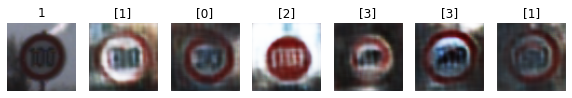

Epoch 35810 g_loss= 2.2644498 d_loss= 0.25033298 real_acc= 0.84 fake_acc= 0.96
Epoch 35820 g_loss= 2.060885 d_loss= 0.20916416 real_acc= 0.92 fake_acc= 0.92
Epoch 35830 g_loss= 1.9730524 d_loss= 0.19525468 real_acc= 0.98 fake_acc= 0.92
Epoch 35840 g_loss= 2.3426142 d_loss= 0.19934174 real_acc= 0.92 fake_acc= 0.94
Epoch 35850 g_loss= 2.1632779 d_loss= 0.19735865 real_acc= 0.92 fake_acc= 0.96
Epoch 35860 g_loss= 2.5895324 d_loss= 0.25379884 real_acc= 0.88 fake_acc= 0.96
Epoch 35870 g_loss= 1.8942097 d_loss= 0.22886999 real_acc= 0.96 fake_acc= 0.94
Epoch 35880 g_loss= 2.4078372 d_loss= 0.19340602 real_acc= 0.92 fake_acc= 0.92
Epoch 35890 g_loss= 2.1054196 d_loss= 0.21025881 real_acc= 0.92 fake_acc= 0.96
Epoch 35900 g_loss= 1.8991848 d_loss= 0.24678612 real_acc= 0.9 fake_acc= 0.98


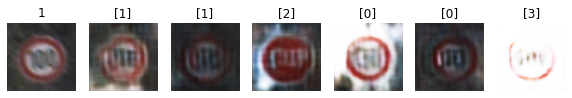

Epoch 35910 g_loss= 2.4541214 d_loss= 0.23807786 real_acc= 0.92 fake_acc= 0.96
Epoch 35920 g_loss= 2.3883734 d_loss= 0.21156013 real_acc= 0.92 fake_acc= 0.96
Epoch 35930 g_loss= 1.7408607 d_loss= 0.24627835 real_acc= 0.94 fake_acc= 0.86
Epoch 35940 g_loss= 2.3861074 d_loss= 0.23919992 real_acc= 0.92 fake_acc= 0.94
Epoch 35950 g_loss= 2.535819 d_loss= 0.21816257 real_acc= 0.88 fake_acc= 0.98
Epoch 35960 g_loss= 2.7640374 d_loss= 0.16593081 real_acc= 0.96 fake_acc= 0.94
Epoch 35970 g_loss= 1.9581099 d_loss= 0.22394611 real_acc= 0.92 fake_acc= 0.94
Epoch 35980 g_loss= 2.2832038 d_loss= 0.21188316 real_acc= 0.92 fake_acc= 0.9
Epoch 35990 g_loss= 2.0186486 d_loss= 0.22749138 real_acc= 0.94 fake_acc= 0.9
Epoch 36000 g_loss= 2.231246 d_loss= 0.18479866 real_acc= 0.94 fake_acc= 0.96


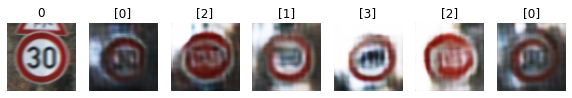

Epoch 36010 g_loss= 2.352924 d_loss= 0.2376712 real_acc= 0.86 fake_acc= 0.96
Epoch 36020 g_loss= 2.2478187 d_loss= 0.2269019 real_acc= 0.9 fake_acc= 1.0
Epoch 36030 g_loss= 2.2000227 d_loss= 0.2911836 real_acc= 0.86 fake_acc= 0.9
Epoch 36040 g_loss= 2.6196842 d_loss= 0.23385389 real_acc= 0.88 fake_acc= 0.96
Epoch 36050 g_loss= 2.1642292 d_loss= 0.20720349 real_acc= 0.92 fake_acc= 0.98
Epoch 36060 g_loss= 2.0251367 d_loss= 0.22840807 real_acc= 0.94 fake_acc= 0.9
Epoch 36070 g_loss= 1.9995797 d_loss= 0.26167527 real_acc= 0.98 fake_acc= 0.88
Epoch 36080 g_loss= 2.3698034 d_loss= 0.25891033 real_acc= 0.86 fake_acc= 0.94
Epoch 36090 g_loss= 2.4899654 d_loss= 0.17216685 real_acc= 0.96 fake_acc= 1.0
Epoch 36100 g_loss= 2.1926794 d_loss= 0.23198877 real_acc= 0.88 fake_acc= 0.96


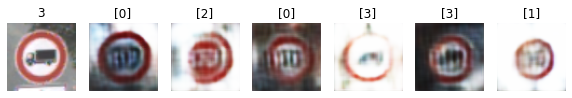

Epoch 36110 g_loss= 1.925114 d_loss= 0.25525126 real_acc= 0.94 fake_acc= 0.9
Epoch 36120 g_loss= 2.254992 d_loss= 0.22184336 real_acc= 0.98 fake_acc= 0.96
Epoch 36130 g_loss= 2.738912 d_loss= 0.20028587 real_acc= 0.88 fake_acc= 0.96
Epoch 36140 g_loss= 2.142701 d_loss= 0.16084667 real_acc= 1.0 fake_acc= 0.94
Epoch 36150 g_loss= 2.135958 d_loss= 0.21489829 real_acc= 0.94 fake_acc= 0.96
Epoch 36160 g_loss= 2.0617983 d_loss= 0.242559 real_acc= 0.92 fake_acc= 0.92
Epoch 36170 g_loss= 2.365675 d_loss= 0.22449303 real_acc= 0.9 fake_acc= 0.98
Epoch 36180 g_loss= 2.4867475 d_loss= 0.21271858 real_acc= 0.86 fake_acc= 0.98
Epoch 36190 g_loss= 1.9998796 d_loss= 0.2477155 real_acc= 0.88 fake_acc= 0.96
Epoch 36200 g_loss= 2.3530173 d_loss= 0.2180818 real_acc= 0.96 fake_acc= 0.98


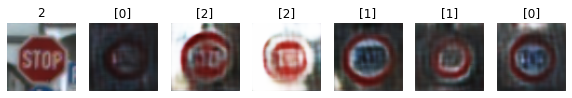

Epoch 36210 g_loss= 1.7798384 d_loss= 0.25840095 real_acc= 1.0 fake_acc= 0.78
Epoch 36220 g_loss= 2.2982671 d_loss= 0.23969096 real_acc= 0.9 fake_acc= 0.96
Epoch 36230 g_loss= 2.0756736 d_loss= 0.18429334 real_acc= 0.98 fake_acc= 0.98
Epoch 36240 g_loss= 2.1328232 d_loss= 0.22599901 real_acc= 0.9 fake_acc= 0.88
Epoch 36250 g_loss= 2.3941686 d_loss= 0.20182453 real_acc= 0.92 fake_acc= 0.98
Epoch 36260 g_loss= 2.4837964 d_loss= 0.2262009 real_acc= 0.94 fake_acc= 0.96
Epoch 36270 g_loss= 2.482487 d_loss= 0.26235178 real_acc= 0.88 fake_acc= 1.0
Epoch 36280 g_loss= 2.4487197 d_loss= 0.15785575 real_acc= 0.98 fake_acc= 0.98
Epoch 36290 g_loss= 1.9512079 d_loss= 0.26208058 real_acc= 0.92 fake_acc= 0.94
Epoch 36300 g_loss= 2.1165195 d_loss= 0.1684682 real_acc= 0.96 fake_acc= 1.0


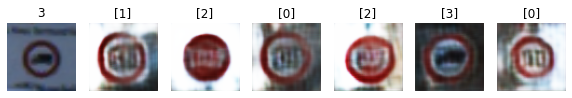

Epoch 36310 g_loss= 2.474283 d_loss= 0.20023423 real_acc= 0.96 fake_acc= 1.0
Epoch 36320 g_loss= 2.3747082 d_loss= 0.25209707 real_acc= 0.94 fake_acc= 0.92
Epoch 36330 g_loss= 2.3274348 d_loss= 0.25100973 real_acc= 0.88 fake_acc= 0.96
Epoch 36340 g_loss= 2.3216767 d_loss= 0.17293158 real_acc= 0.98 fake_acc= 0.98
Epoch 36350 g_loss= 2.4907076 d_loss= 0.20096874 real_acc= 0.94 fake_acc= 0.98
Epoch 36360 g_loss= 2.1068435 d_loss= 0.23321962 real_acc= 0.96 fake_acc= 0.94
Epoch 36370 g_loss= 2.055829 d_loss= 0.26006368 real_acc= 0.96 fake_acc= 0.92
Epoch 36380 g_loss= 2.272562 d_loss= 0.19902378 real_acc= 0.94 fake_acc= 0.92
Epoch 36390 g_loss= 2.7323978 d_loss= 0.20472509 real_acc= 0.9 fake_acc= 1.0
Epoch 36400 g_loss= 2.609354 d_loss= 0.24943626 real_acc= 0.82 fake_acc= 1.0


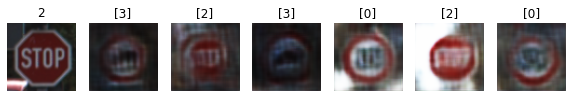

Epoch 36410 g_loss= 2.5377069 d_loss= 0.16362363 real_acc= 0.96 fake_acc= 1.0
Epoch 36420 g_loss= 2.227204 d_loss= 0.26645762 real_acc= 0.92 fake_acc= 0.88
Epoch 36430 g_loss= 2.85448 d_loss= 0.25190246 real_acc= 0.84 fake_acc= 1.0
Epoch 36440 g_loss= 2.4961197 d_loss= 0.27056494 real_acc= 0.84 fake_acc= 0.98
Epoch 36450 g_loss= 2.5387814 d_loss= 0.17774068 real_acc= 0.96 fake_acc= 1.0
Epoch 36460 g_loss= 2.1237907 d_loss= 0.19409606 real_acc= 0.96 fake_acc= 0.92
Epoch 36470 g_loss= 2.2575693 d_loss= 0.16697654 real_acc= 0.98 fake_acc= 1.0
Epoch 36480 g_loss= 2.3607442 d_loss= 0.18183497 real_acc= 0.94 fake_acc= 0.96
Epoch 36490 g_loss= 2.4531386 d_loss= 0.18724334 real_acc= 0.92 fake_acc= 1.0
Epoch 36500 g_loss= 2.3388262 d_loss= 0.20782812 real_acc= 0.9 fake_acc= 0.96


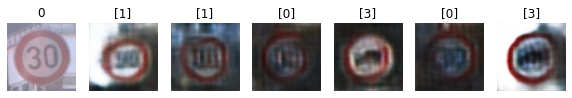

Epoch 36510 g_loss= 2.2911973 d_loss= 0.22436568 real_acc= 0.9 fake_acc= 0.94
Epoch 36520 g_loss= 2.1225188 d_loss= 0.24573287 real_acc= 0.9 fake_acc= 0.92
Epoch 36530 g_loss= 1.4413491 d_loss= 0.28041717 real_acc= 0.98 fake_acc= 0.86
Epoch 36540 g_loss= 2.218637 d_loss= 0.2375491 real_acc= 0.86 fake_acc= 0.96
Epoch 36550 g_loss= 3.1517193 d_loss= 0.2448573 real_acc= 0.74 fake_acc= 1.0
Epoch 36560 g_loss= 2.4426742 d_loss= 0.25813103 real_acc= 0.88 fake_acc= 0.98
Epoch 36570 g_loss= 2.5274084 d_loss= 0.12862693 real_acc= 0.96 fake_acc= 1.0
Epoch 36580 g_loss= 2.1332905 d_loss= 0.2444396 real_acc= 0.92 fake_acc= 0.92
Epoch 36590 g_loss= 1.8740817 d_loss= 0.24402262 real_acc= 0.94 fake_acc= 0.96
Epoch 36600 g_loss= 2.1927185 d_loss= 0.22970498 real_acc= 0.92 fake_acc= 0.94


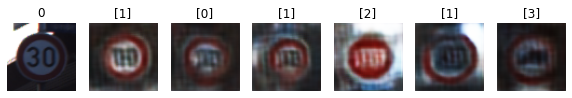

Epoch 36610 g_loss= 2.2322288 d_loss= 0.19067034 real_acc= 0.94 fake_acc= 0.96
Epoch 36620 g_loss= 2.0616736 d_loss= 0.23475492 real_acc= 0.92 fake_acc= 0.96
Epoch 36630 g_loss= 1.9895082 d_loss= 0.19999802 real_acc= 1.0 fake_acc= 0.9
Epoch 36640 g_loss= 2.7405524 d_loss= 0.19439566 real_acc= 0.92 fake_acc= 0.98
Epoch 36650 g_loss= 2.8073664 d_loss= 0.24866426 real_acc= 0.86 fake_acc= 0.98
Epoch 36660 g_loss= 2.264179 d_loss= 0.18860538 real_acc= 0.94 fake_acc= 0.94
Epoch 36670 g_loss= 1.882316 d_loss= 0.24377415 real_acc= 0.94 fake_acc= 0.88
Epoch 36680 g_loss= 2.192185 d_loss= 0.181731 real_acc= 0.96 fake_acc= 0.96
Epoch 36690 g_loss= 2.5024679 d_loss= 0.20682552 real_acc= 0.9 fake_acc= 0.94
Epoch 36700 g_loss= 2.8144588 d_loss= 0.240168 real_acc= 0.84 fake_acc= 0.98


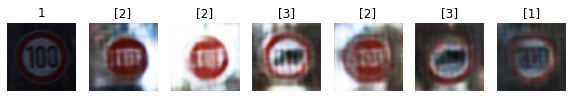

Epoch 36710 g_loss= 2.4992678 d_loss= 0.1774647 real_acc= 0.96 fake_acc= 0.94
Epoch 36720 g_loss= 2.3815954 d_loss= 0.27595007 real_acc= 0.88 fake_acc= 0.94
Epoch 36730 g_loss= 2.1237087 d_loss= 0.24839324 real_acc= 0.92 fake_acc= 0.9
Epoch 36740 g_loss= 2.17785 d_loss= 0.2897879 real_acc= 0.84 fake_acc= 0.94
Epoch 36750 g_loss= 1.6910936 d_loss= 0.2831006 real_acc= 0.94 fake_acc= 0.86
Epoch 36760 g_loss= 1.6020731 d_loss= 0.24467279 real_acc= 0.98 fake_acc= 0.9
Epoch 36770 g_loss= 2.4666934 d_loss= 0.2331451 real_acc= 0.86 fake_acc= 0.94
Epoch 36780 g_loss= 2.732568 d_loss= 0.32481015 real_acc= 0.78 fake_acc= 1.0
Epoch 36790 g_loss= 2.9014957 d_loss= 0.25561392 real_acc= 0.78 fake_acc= 1.0
Epoch 36800 g_loss= 2.1104014 d_loss= 0.27509153 real_acc= 0.9 fake_acc= 0.92


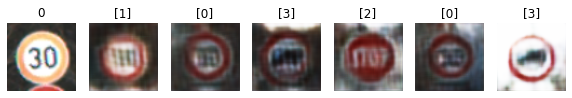

Epoch 36810 g_loss= 1.6592793 d_loss= 0.28092867 real_acc= 0.92 fake_acc= 0.78
Epoch 36820 g_loss= 2.2068284 d_loss= 0.19473296 real_acc= 0.94 fake_acc= 0.96
Epoch 36830 g_loss= 2.1802816 d_loss= 0.17659244 real_acc= 0.96 fake_acc= 1.0
Epoch 36840 g_loss= 2.6737494 d_loss= 0.23711549 real_acc= 0.82 fake_acc= 0.98
Epoch 36850 g_loss= 2.276084 d_loss= 0.1993581 real_acc= 0.9 fake_acc= 0.98
Epoch 36860 g_loss= 2.346207 d_loss= 0.23030418 real_acc= 0.88 fake_acc= 0.94
Epoch 36870 g_loss= 1.9351274 d_loss= 0.24552575 real_acc= 0.94 fake_acc= 0.88
Epoch 36880 g_loss= 2.1753814 d_loss= 0.19924806 real_acc= 0.92 fake_acc= 0.94
Epoch 36890 g_loss= 2.360122 d_loss= 0.2118293 real_acc= 0.92 fake_acc= 0.98
Epoch 36900 g_loss= 2.4373558 d_loss= 0.23338878 real_acc= 0.82 fake_acc= 0.96


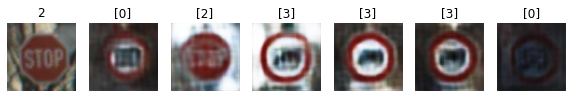

Epoch 36910 g_loss= 1.9460311 d_loss= 0.2955542 real_acc= 0.86 fake_acc= 0.92
Epoch 36920 g_loss= 2.134116 d_loss= 0.1978102 real_acc= 0.96 fake_acc= 0.92
Epoch 36930 g_loss= 2.2823641 d_loss= 0.24470118 real_acc= 0.88 fake_acc= 0.98
Epoch 36940 g_loss= 1.8841053 d_loss= 0.2278749 real_acc= 0.96 fake_acc= 0.9
Epoch 36950 g_loss= 1.849957 d_loss= 0.2045407 real_acc= 1.0 fake_acc= 0.86
Epoch 36960 g_loss= 2.650896 d_loss= 0.2437318 real_acc= 0.78 fake_acc= 0.98
Epoch 36970 g_loss= 2.5705483 d_loss= 0.31246054 real_acc= 0.8 fake_acc= 1.0
Epoch 36980 g_loss= 2.7072973 d_loss= 0.18885192 real_acc= 0.9 fake_acc= 0.96
Epoch 36990 g_loss= 2.120567 d_loss= 0.20278862 real_acc= 0.96 fake_acc= 0.92
Epoch 37000 g_loss= 1.8686819 d_loss= 0.2671095 real_acc= 0.98 fake_acc= 0.88


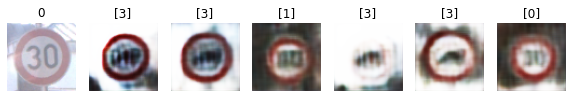

Epoch 37010 g_loss= 2.012367 d_loss= 0.18825248 real_acc= 0.98 fake_acc= 0.92
Epoch 37020 g_loss= 2.4500933 d_loss= 0.16085416 real_acc= 0.96 fake_acc= 0.94
Epoch 37030 g_loss= 2.90013 d_loss= 0.20803252 real_acc= 0.88 fake_acc= 1.0
Epoch 37040 g_loss= 2.6684647 d_loss= 0.2520938 real_acc= 0.8 fake_acc= 1.0
Epoch 37050 g_loss= 2.8099525 d_loss= 0.16184989 real_acc= 0.94 fake_acc= 0.98
Epoch 37060 g_loss= 2.0978367 d_loss= 0.25872493 real_acc= 0.98 fake_acc= 0.88
Epoch 37070 g_loss= 2.0392523 d_loss= 0.22833401 real_acc= 0.94 fake_acc= 0.9
Epoch 37080 g_loss= 2.1820304 d_loss= 0.21543705 real_acc= 0.9 fake_acc= 0.98
Epoch 37090 g_loss= 2.7583847 d_loss= 0.2027825 real_acc= 0.88 fake_acc= 1.0
Epoch 37100 g_loss= 2.3431945 d_loss= 0.21927193 real_acc= 0.9 fake_acc= 0.92


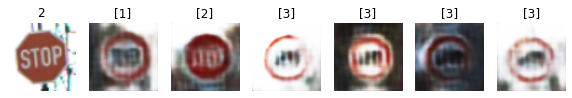

Epoch 37110 g_loss= 2.1238375 d_loss= 0.22046316 real_acc= 0.96 fake_acc= 0.88
Epoch 37120 g_loss= 2.397586 d_loss= 0.27879468 real_acc= 0.84 fake_acc= 0.94
Epoch 37130 g_loss= 2.0332956 d_loss= 0.19822441 real_acc= 0.9 fake_acc= 0.98
Epoch 37140 g_loss= 2.102594 d_loss= 0.23067039 real_acc= 0.92 fake_acc= 0.98
Epoch 37150 g_loss= 2.331954 d_loss= 0.24185596 real_acc= 0.86 fake_acc= 0.94
Epoch 37160 g_loss= 2.480076 d_loss= 0.20691198 real_acc= 0.9 fake_acc= 1.0
Epoch 37170 g_loss= 2.3048055 d_loss= 0.19698063 real_acc= 0.96 fake_acc= 0.92
Epoch 37180 g_loss= 2.1227303 d_loss= 0.1903867 real_acc= 0.98 fake_acc= 0.88
Epoch 37190 g_loss= 2.641931 d_loss= 0.19763392 real_acc= 0.88 fake_acc= 1.0
Epoch 37200 g_loss= 2.5050368 d_loss= 0.22241886 real_acc= 0.9 fake_acc= 0.98


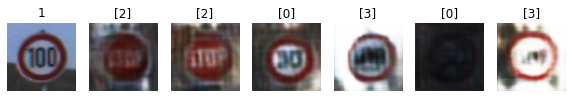

Epoch 37210 g_loss= 2.0507154 d_loss= 0.23696925 real_acc= 1.0 fake_acc= 0.88
Epoch 37220 g_loss= 2.125846 d_loss= 0.26201764 real_acc= 0.88 fake_acc= 0.96
Epoch 37230 g_loss= 2.5247533 d_loss= 0.16458264 real_acc= 0.96 fake_acc= 0.98
Epoch 37240 g_loss= 2.6685097 d_loss= 0.22095646 real_acc= 0.84 fake_acc= 1.0
Epoch 37250 g_loss= 2.6401694 d_loss= 0.20377316 real_acc= 0.96 fake_acc= 0.96
Epoch 37260 g_loss= 2.162591 d_loss= 0.23748693 real_acc= 0.94 fake_acc= 0.96
Epoch 37270 g_loss= 2.0333877 d_loss= 0.22970378 real_acc= 0.94 fake_acc= 0.94
Epoch 37280 g_loss= 2.417819 d_loss= 0.24928707 real_acc= 0.84 fake_acc= 0.98
Epoch 37290 g_loss= 1.8819028 d_loss= 0.25002003 real_acc= 0.94 fake_acc= 0.9
Epoch 37300 g_loss= 2.551893 d_loss= 0.1757744 real_acc= 0.96 fake_acc= 0.98


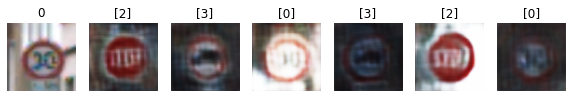

Epoch 37310 g_loss= 2.5868206 d_loss= 0.1870462 real_acc= 0.92 fake_acc= 0.98
Epoch 37320 g_loss= 2.2880418 d_loss= 0.1728206 real_acc= 0.96 fake_acc= 1.0
Epoch 37330 g_loss= 2.0258462 d_loss= 0.24500492 real_acc= 0.9 fake_acc= 0.96
Epoch 37340 g_loss= 2.53864 d_loss= 0.24107473 real_acc= 0.88 fake_acc= 0.98
Epoch 37350 g_loss= 2.7172778 d_loss= 0.24780047 real_acc= 0.92 fake_acc= 0.92
Epoch 37360 g_loss= 2.0394511 d_loss= 0.18078777 real_acc= 0.94 fake_acc= 0.96
Epoch 37370 g_loss= 2.1862981 d_loss= 0.211079 real_acc= 0.9 fake_acc= 0.94
Epoch 37380 g_loss= 2.3597233 d_loss= 0.23526026 real_acc= 0.9 fake_acc= 0.96
Epoch 37390 g_loss= 2.0319614 d_loss= 0.26777273 real_acc= 0.92 fake_acc= 0.86
Epoch 37400 g_loss= 2.1104805 d_loss= 0.25302035 real_acc= 0.88 fake_acc= 0.96


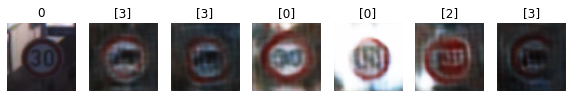

Epoch 37410 g_loss= 1.921598 d_loss= 0.21388072 real_acc= 0.94 fake_acc= 0.96
Epoch 37420 g_loss= 2.3777425 d_loss= 0.17321135 real_acc= 0.98 fake_acc= 0.9
Epoch 37430 g_loss= 2.2696548 d_loss= 0.2616873 real_acc= 0.84 fake_acc= 0.98
Epoch 37440 g_loss= 2.246378 d_loss= 0.23431638 real_acc= 0.9 fake_acc= 0.94
Epoch 37450 g_loss= 1.5415835 d_loss= 0.25589675 real_acc= 0.94 fake_acc= 0.94
Epoch 37460 g_loss= 1.7980925 d_loss= 0.2672332 real_acc= 0.88 fake_acc= 0.84
Epoch 37470 g_loss= 2.6770415 d_loss= 0.20968637 real_acc= 0.9 fake_acc= 0.94
Epoch 37480 g_loss= 2.8629763 d_loss= 0.20797655 real_acc= 0.86 fake_acc= 1.0
Epoch 37490 g_loss= 2.0943608 d_loss= 0.22760166 real_acc= 0.9 fake_acc= 0.94
Epoch 37500 g_loss= 2.129678 d_loss= 0.2515565 real_acc= 0.9 fake_acc= 0.9


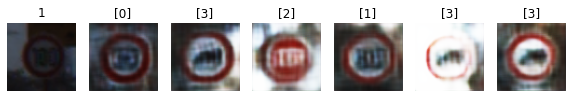

Epoch 37510 g_loss= 2.7100935 d_loss= 0.28533804 real_acc= 0.82 fake_acc= 0.98
Epoch 37520 g_loss= 1.8386284 d_loss= 0.317621 real_acc= 0.86 fake_acc= 0.84
Epoch 37530 g_loss= 2.309554 d_loss= 0.23891144 real_acc= 0.92 fake_acc= 0.94
Epoch 37540 g_loss= 2.85649 d_loss= 0.15844955 real_acc= 0.98 fake_acc= 1.0
Epoch 37550 g_loss= 3.107074 d_loss= 0.18517841 real_acc= 0.9 fake_acc= 1.0
Epoch 37560 g_loss= 2.530038 d_loss= 0.2694066 real_acc= 0.88 fake_acc= 0.94
Epoch 37570 g_loss= 1.697664 d_loss= 0.2586292 real_acc= 0.98 fake_acc= 0.86
Epoch 37580 g_loss= 2.0507412 d_loss= 0.24399668 real_acc= 0.92 fake_acc= 0.88
Epoch 37590 g_loss= 2.2174973 d_loss= 0.21410443 real_acc= 0.96 fake_acc= 0.96
Epoch 37600 g_loss= 2.6386328 d_loss= 0.18668959 real_acc= 0.92 fake_acc= 1.0


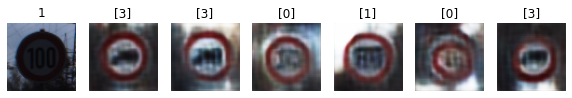

Epoch 37610 g_loss= 2.4683113 d_loss= 0.21675782 real_acc= 0.9 fake_acc= 0.98
Epoch 37620 g_loss= 1.6744378 d_loss= 0.2617007 real_acc= 0.96 fake_acc= 0.84
Epoch 37630 g_loss= 2.0040083 d_loss= 0.21672748 real_acc= 0.98 fake_acc= 0.88
Epoch 37640 g_loss= 2.5714319 d_loss= 0.20463058 real_acc= 0.94 fake_acc= 0.98
Epoch 37650 g_loss= 2.6345375 d_loss= 0.31118703 real_acc= 0.84 fake_acc= 0.96
Epoch 37660 g_loss= 2.727037 d_loss= 0.13402906 real_acc= 1.0 fake_acc= 1.0
Epoch 37670 g_loss= 2.3144343 d_loss= 0.22223723 real_acc= 0.9 fake_acc= 0.92
Epoch 37680 g_loss= 2.7614486 d_loss= 0.18104537 real_acc= 0.96 fake_acc= 0.98
Epoch 37690 g_loss= 2.6657782 d_loss= 0.20511267 real_acc= 0.9 fake_acc= 1.0
Epoch 37700 g_loss= 2.2726374 d_loss= 0.25723496 real_acc= 0.94 fake_acc= 0.94


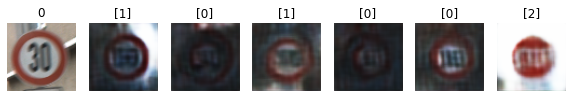

Epoch 37710 g_loss= 2.2095535 d_loss= 0.18585992 real_acc= 0.92 fake_acc= 0.96
Epoch 37720 g_loss= 2.3626266 d_loss= 0.19898799 real_acc= 0.9 fake_acc= 0.98
Epoch 37730 g_loss= 2.198376 d_loss= 0.18012387 real_acc= 0.96 fake_acc= 0.94
Epoch 37740 g_loss= 2.5630674 d_loss= 0.2027085 real_acc= 0.88 fake_acc= 0.94
Epoch 37750 g_loss= 2.4264328 d_loss= 0.22461945 real_acc= 0.86 fake_acc= 0.96
Epoch 37760 g_loss= 2.1502242 d_loss= 0.18256274 real_acc= 0.92 fake_acc= 0.98
Epoch 37770 g_loss= 2.1883302 d_loss= 0.19327906 real_acc= 0.94 fake_acc= 0.94
Epoch 37780 g_loss= 2.9850395 d_loss= 0.2353056 real_acc= 0.84 fake_acc= 0.98
Epoch 37790 g_loss= 2.0146587 d_loss= 0.185389 real_acc= 1.0 fake_acc= 0.9
Epoch 37800 g_loss= 2.0090046 d_loss= 0.19866416 real_acc= 0.96 fake_acc= 0.96


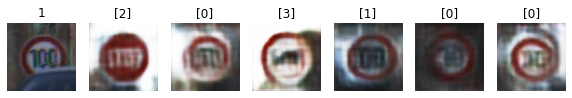

Epoch 37810 g_loss= 2.109611 d_loss= 0.25090563 real_acc= 0.92 fake_acc= 0.9
Epoch 37820 g_loss= 2.1333554 d_loss= 0.2776219 real_acc= 0.82 fake_acc= 0.92
Epoch 37830 g_loss= 2.143178 d_loss= 0.2299928 real_acc= 0.94 fake_acc= 0.94
Epoch 37840 g_loss= 2.184072 d_loss= 0.21444651 real_acc= 0.9 fake_acc= 0.96
Epoch 37850 g_loss= 2.3397021 d_loss= 0.22070657 real_acc= 0.88 fake_acc= 0.96
Epoch 37860 g_loss= 2.555577 d_loss= 0.27340746 real_acc= 0.86 fake_acc= 0.96
Epoch 37870 g_loss= 2.3404424 d_loss= 0.26031208 real_acc= 0.9 fake_acc= 0.96
Epoch 37880 g_loss= 2.355365 d_loss= 0.26290357 real_acc= 0.88 fake_acc= 0.92
Epoch 37890 g_loss= 2.3244634 d_loss= 0.17444924 real_acc= 0.98 fake_acc= 0.96
Epoch 37900 g_loss= 2.712423 d_loss= 0.25288653 real_acc= 0.84 fake_acc= 0.96


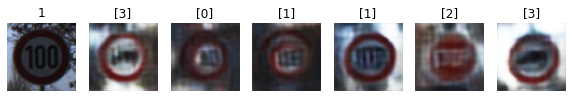

Epoch 37910 g_loss= 2.4818585 d_loss= 0.30398643 real_acc= 0.78 fake_acc= 0.96
Epoch 37920 g_loss= 2.1830382 d_loss= 0.19608861 real_acc= 0.92 fake_acc= 1.0
Epoch 37930 g_loss= 1.7198352 d_loss= 0.24684441 real_acc= 1.0 fake_acc= 0.82
Epoch 37940 g_loss= 2.315044 d_loss= 0.16973059 real_acc= 0.98 fake_acc= 1.0
Epoch 37950 g_loss= 2.066693 d_loss= 0.22184755 real_acc= 0.94 fake_acc= 0.9
Epoch 37960 g_loss= 2.4012725 d_loss= 0.19863391 real_acc= 0.94 fake_acc= 0.98
Epoch 37970 g_loss= 1.9510133 d_loss= 0.22975829 real_acc= 0.94 fake_acc= 0.92
Epoch 37980 g_loss= 2.0526252 d_loss= 0.20936751 real_acc= 0.96 fake_acc= 0.94
Epoch 37990 g_loss= 1.9918829 d_loss= 0.2530616 real_acc= 0.96 fake_acc= 0.88
Epoch 38000 g_loss= 2.3527172 d_loss= 0.21407834 real_acc= 0.88 fake_acc= 0.98


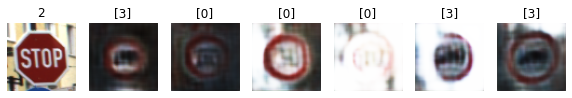

Epoch 38010 g_loss= 2.7007418 d_loss= 0.2001847 real_acc= 0.88 fake_acc= 0.98
Epoch 38020 g_loss= 1.7574657 d_loss= 0.21388933 real_acc= 1.0 fake_acc= 0.94
Epoch 38030 g_loss= 2.3231041 d_loss= 0.21720682 real_acc= 0.86 fake_acc= 0.98
Epoch 38040 g_loss= 2.5644445 d_loss= 0.24066144 real_acc= 0.92 fake_acc= 0.96
Epoch 38050 g_loss= 2.4657502 d_loss= 0.20159802 real_acc= 0.94 fake_acc= 0.94
Epoch 38060 g_loss= 2.1501918 d_loss= 0.20975229 real_acc= 0.96 fake_acc= 0.96
Epoch 38070 g_loss= 1.7541847 d_loss= 0.2413513 real_acc= 0.92 fake_acc= 0.98
Epoch 38080 g_loss= 2.770773 d_loss= 0.22902505 real_acc= 0.86 fake_acc= 1.0
Epoch 38090 g_loss= 2.4340248 d_loss= 0.20494401 real_acc= 0.92 fake_acc= 0.96
Epoch 38100 g_loss= 2.3141687 d_loss= 0.16882464 real_acc= 0.98 fake_acc= 0.96


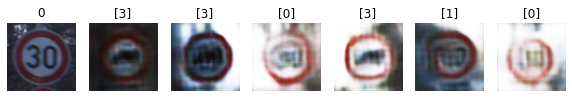

Epoch 38110 g_loss= 2.6578836 d_loss= 0.24480839 real_acc= 0.9 fake_acc= 0.98
Epoch 38120 g_loss= 2.7386422 d_loss= 0.28102323 real_acc= 0.86 fake_acc= 0.94
Epoch 38130 g_loss= 2.1034217 d_loss= 0.25190037 real_acc= 0.92 fake_acc= 0.94
Epoch 38140 g_loss= 1.9691674 d_loss= 0.22622347 real_acc= 0.94 fake_acc= 0.92
Epoch 38150 g_loss= 2.9740741 d_loss= 0.21925206 real_acc= 0.9 fake_acc= 0.98
Epoch 38160 g_loss= 2.2526627 d_loss= 0.25639108 real_acc= 0.92 fake_acc= 0.94
Epoch 38170 g_loss= 2.0491304 d_loss= 0.24150306 real_acc= 0.9 fake_acc= 0.96
Epoch 38180 g_loss= 2.6930845 d_loss= 0.21538442 real_acc= 0.9 fake_acc= 0.94
Epoch 38190 g_loss= 2.7779875 d_loss= 0.24560466 real_acc= 0.86 fake_acc= 1.0
Epoch 38200 g_loss= 2.260513 d_loss= 0.26257786 real_acc= 0.84 fake_acc= 0.98


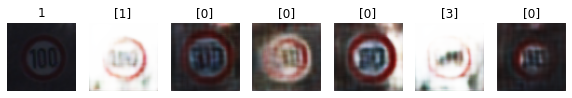

Epoch 38210 g_loss= 2.2126114 d_loss= 0.18359369 real_acc= 0.96 fake_acc= 0.98
Epoch 38220 g_loss= 2.2528796 d_loss= 0.20933184 real_acc= 0.94 fake_acc= 0.96
Epoch 38230 g_loss= 2.0055625 d_loss= 0.2503427 real_acc= 0.94 fake_acc= 0.86
Epoch 38240 g_loss= 1.8298409 d_loss= 0.2488516 real_acc= 0.96 fake_acc= 0.9
Epoch 38250 g_loss= 1.7570058 d_loss= 0.26553577 real_acc= 0.96 fake_acc= 0.86
Epoch 38260 g_loss= 2.3593934 d_loss= 0.20087379 real_acc= 0.9 fake_acc= 0.98
Epoch 38270 g_loss= 2.4151533 d_loss= 0.2386751 real_acc= 0.84 fake_acc= 0.94
Epoch 38280 g_loss= 2.090555 d_loss= 0.25466704 real_acc= 0.92 fake_acc= 0.94
Epoch 38290 g_loss= 2.363114 d_loss= 0.2206828 real_acc= 0.92 fake_acc= 0.96
Epoch 38300 g_loss= 2.5272634 d_loss= 0.26231408 real_acc= 0.86 fake_acc= 0.98


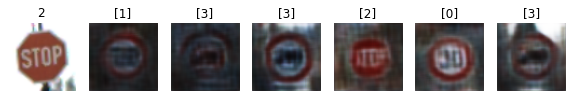

Epoch 38310 g_loss= 2.0799813 d_loss= 0.21342036 real_acc= 0.96 fake_acc= 0.92
Epoch 38320 g_loss= 1.9468726 d_loss= 0.23855834 real_acc= 0.94 fake_acc= 0.94
Epoch 38330 g_loss= 2.8731039 d_loss= 0.2307263 real_acc= 0.8 fake_acc= 0.96
Epoch 38340 g_loss= 2.4703274 d_loss= 0.26758036 real_acc= 0.82 fake_acc= 0.98
Epoch 38350 g_loss= 1.8264701 d_loss= 0.22699133 real_acc= 0.96 fake_acc= 0.9
Epoch 38360 g_loss= 1.925952 d_loss= 0.31372654 real_acc= 0.88 fake_acc= 0.9
Epoch 38370 g_loss= 2.5068212 d_loss= 0.2450757 real_acc= 0.94 fake_acc= 0.88
Epoch 38380 g_loss= 2.6747308 d_loss= 0.22332634 real_acc= 0.86 fake_acc= 0.98
Epoch 38390 g_loss= 2.5868697 d_loss= 0.18903445 real_acc= 0.9 fake_acc= 0.96
Epoch 38400 g_loss= 2.3946187 d_loss= 0.19121534 real_acc= 0.92 fake_acc= 0.98


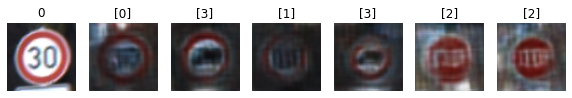

Epoch 38410 g_loss= 2.0696425 d_loss= 0.21528234 real_acc= 0.96 fake_acc= 0.84
Epoch 38420 g_loss= 2.4738462 d_loss= 0.20574212 real_acc= 0.94 fake_acc= 1.0
Epoch 38430 g_loss= 2.443449 d_loss= 0.19253288 real_acc= 0.94 fake_acc= 1.0
Epoch 38440 g_loss= 2.3661265 d_loss= 0.1926691 real_acc= 0.9 fake_acc= 1.0
Epoch 38450 g_loss= 2.5457315 d_loss= 0.22703446 real_acc= 0.88 fake_acc= 0.94
Epoch 38460 g_loss= 2.4177008 d_loss= 0.26145425 real_acc= 0.88 fake_acc= 0.94
Epoch 38470 g_loss= 2.4790964 d_loss= 0.22063704 real_acc= 0.88 fake_acc= 0.98
Epoch 38480 g_loss= 2.1785576 d_loss= 0.25619406 real_acc= 0.9 fake_acc= 0.96
Epoch 38490 g_loss= 2.3556867 d_loss= 0.18582198 real_acc= 0.98 fake_acc= 0.96
Epoch 38500 g_loss= 2.1746264 d_loss= 0.21193942 real_acc= 0.92 fake_acc= 1.0


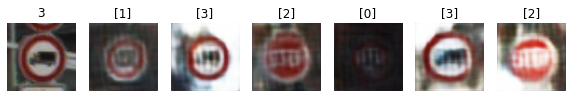

Epoch 38510 g_loss= 3.2237139 d_loss= 0.19234066 real_acc= 0.88 fake_acc= 1.0
Epoch 38520 g_loss= 2.2068462 d_loss= 0.20281501 real_acc= 0.96 fake_acc= 0.92
Epoch 38530 g_loss= 1.5596383 d_loss= 0.25514898 real_acc= 0.96 fake_acc= 0.8
Epoch 38540 g_loss= 1.9432617 d_loss= 0.2747012 real_acc= 0.94 fake_acc= 0.92
Epoch 38550 g_loss= 2.2935476 d_loss= 0.23895366 real_acc= 0.88 fake_acc= 0.98
Epoch 38560 g_loss= 2.844369 d_loss= 0.24023142 real_acc= 0.82 fake_acc= 1.0
Epoch 38570 g_loss= 2.091579 d_loss= 0.2723027 real_acc= 0.88 fake_acc= 0.92
Epoch 38580 g_loss= 2.6917257 d_loss= 0.21291217 real_acc= 0.94 fake_acc= 0.96
Epoch 38590 g_loss= 2.4365962 d_loss= 0.29017848 real_acc= 0.82 fake_acc= 0.96
Epoch 38600 g_loss= 2.4283402 d_loss= 0.23972192 real_acc= 0.9 fake_acc= 0.96


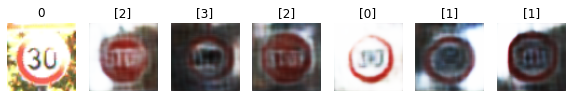

Epoch 38610 g_loss= 1.9383409 d_loss= 0.2781163 real_acc= 0.9 fake_acc= 0.9
Epoch 38620 g_loss= 2.059547 d_loss= 0.203964 real_acc= 0.98 fake_acc= 0.9
Epoch 38630 g_loss= 1.8733956 d_loss= 0.23303032 real_acc= 0.92 fake_acc= 0.88
Epoch 38640 g_loss= 2.8505204 d_loss= 0.21078381 real_acc= 0.88 fake_acc= 1.0
Epoch 38650 g_loss= 2.7572298 d_loss= 0.22242722 real_acc= 0.92 fake_acc= 0.98
Epoch 38660 g_loss= 2.450225 d_loss= 0.21524471 real_acc= 0.92 fake_acc= 0.94
Epoch 38670 g_loss= 2.0194733 d_loss= 0.20782235 real_acc= 0.96 fake_acc= 0.94
Epoch 38680 g_loss= 2.2573805 d_loss= 0.2885212 real_acc= 0.74 fake_acc= 1.0
Epoch 38690 g_loss= 1.6308538 d_loss= 0.26495242 real_acc= 0.96 fake_acc= 0.8
Epoch 38700 g_loss= 2.2040093 d_loss= 0.2291975 real_acc= 0.92 fake_acc= 0.96


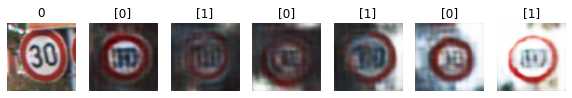

Epoch 38710 g_loss= 2.0411189 d_loss= 0.21320173 real_acc= 0.94 fake_acc= 0.9
Epoch 38720 g_loss= 2.5458257 d_loss= 0.23688707 real_acc= 0.88 fake_acc= 0.98
Epoch 38730 g_loss= 2.1413474 d_loss= 0.23363364 real_acc= 0.9 fake_acc= 0.94
Epoch 38740 g_loss= 2.2529876 d_loss= 0.21547917 real_acc= 0.88 fake_acc= 0.98
Epoch 38750 g_loss= 2.382363 d_loss= 0.21881539 real_acc= 0.94 fake_acc= 0.94
Epoch 38760 g_loss= 2.2763352 d_loss= 0.16287313 real_acc= 0.92 fake_acc= 0.98
Epoch 38770 g_loss= 1.876892 d_loss= 0.20366386 real_acc= 0.94 fake_acc= 0.96
Epoch 38780 g_loss= 2.2589335 d_loss= 0.17082873 real_acc= 0.98 fake_acc= 0.92
Epoch 38790 g_loss= 2.952238 d_loss= 0.21862878 real_acc= 0.86 fake_acc= 1.0
Epoch 38800 g_loss= 2.4854128 d_loss= 0.21117298 real_acc= 0.92 fake_acc= 0.98


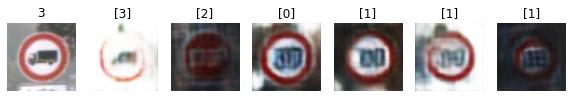

Epoch 38810 g_loss= 2.1126833 d_loss= 0.25828418 real_acc= 0.84 fake_acc= 0.92
Epoch 38820 g_loss= 1.6355513 d_loss= 0.28234604 real_acc= 0.96 fake_acc= 0.82
Epoch 38830 g_loss= 2.456859 d_loss= 0.16013294 real_acc= 1.0 fake_acc= 0.96
Epoch 38840 g_loss= 2.6074984 d_loss= 0.26739794 real_acc= 0.78 fake_acc= 0.98
Epoch 38850 g_loss= 2.0099247 d_loss= 0.28631794 real_acc= 0.9 fake_acc= 0.94
Epoch 38860 g_loss= 2.042078 d_loss= 0.21730348 real_acc= 0.92 fake_acc= 0.92
Epoch 38870 g_loss= 2.220943 d_loss= 0.25532436 real_acc= 0.9 fake_acc= 0.92
Epoch 38880 g_loss= 2.4942667 d_loss= 0.26415026 real_acc= 0.88 fake_acc= 0.96
Epoch 38890 g_loss= 2.1804748 d_loss= 0.20807424 real_acc= 0.94 fake_acc= 0.92
Epoch 38900 g_loss= 2.6137764 d_loss= 0.19621831 real_acc= 0.88 fake_acc= 0.98


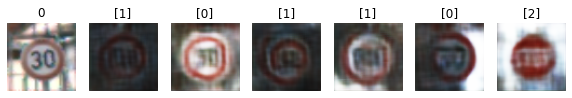

Epoch 38910 g_loss= 2.6313848 d_loss= 0.21757503 real_acc= 0.86 fake_acc= 0.98
Epoch 38920 g_loss= 2.3213272 d_loss= 0.22450535 real_acc= 0.9 fake_acc= 0.9
Epoch 38930 g_loss= 2.2899427 d_loss= 0.19051062 real_acc= 0.96 fake_acc= 0.92
Epoch 38940 g_loss= 2.039197 d_loss= 0.1955086 real_acc= 0.96 fake_acc= 0.94
Epoch 38950 g_loss= 2.283763 d_loss= 0.22956407 real_acc= 0.92 fake_acc= 0.9
Epoch 38960 g_loss= 2.351917 d_loss= 0.23784848 real_acc= 0.92 fake_acc= 0.96
Epoch 38970 g_loss= 2.3497393 d_loss= 0.2067758 real_acc= 0.9 fake_acc= 0.98
Epoch 38980 g_loss= 2.2052746 d_loss= 0.25393054 real_acc= 0.84 fake_acc= 0.98
Epoch 38990 g_loss= 2.5995862 d_loss= 0.2639925 real_acc= 0.86 fake_acc= 1.0
Epoch 39000 g_loss= 2.0420663 d_loss= 0.3179527 real_acc= 0.82 fake_acc= 0.96


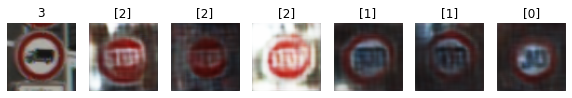

Epoch 39010 g_loss= 2.2531056 d_loss= 0.19991559 real_acc= 0.92 fake_acc= 0.92
Epoch 39020 g_loss= 2.3174436 d_loss= 0.27735463 real_acc= 0.8 fake_acc= 0.98
Epoch 39030 g_loss= 2.3513317 d_loss= 0.1689048 real_acc= 0.96 fake_acc= 0.94
Epoch 39040 g_loss= 2.5538728 d_loss= 0.18526983 real_acc= 0.94 fake_acc= 0.96
Epoch 39050 g_loss= 2.809436 d_loss= 0.18278512 real_acc= 0.9 fake_acc= 0.98
Epoch 39060 g_loss= 2.1242888 d_loss= 0.20520008 real_acc= 0.94 fake_acc= 0.86
Epoch 39070 g_loss= 2.2195482 d_loss= 0.23523775 real_acc= 0.9 fake_acc= 0.96
Epoch 39080 g_loss= 2.1646645 d_loss= 0.23438016 real_acc= 0.9 fake_acc= 0.92
Epoch 39090 g_loss= 1.9055829 d_loss= 0.21091014 real_acc= 0.96 fake_acc= 0.96
Epoch 39100 g_loss= 2.467473 d_loss= 0.21380404 real_acc= 0.9 fake_acc= 0.94


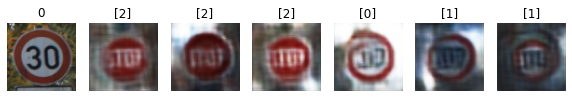

Epoch 39110 g_loss= 2.803545 d_loss= 0.29248127 real_acc= 0.82 fake_acc= 1.0
Epoch 39120 g_loss= 2.86073 d_loss= 0.1542548 real_acc= 0.92 fake_acc= 1.0
Epoch 39130 g_loss= 1.8178519 d_loss= 0.29059243 real_acc= 0.92 fake_acc= 0.88
Epoch 39140 g_loss= 1.7487956 d_loss= 0.2662422 real_acc= 0.94 fake_acc= 0.84
Epoch 39150 g_loss= 2.641701 d_loss= 0.22023138 real_acc= 0.92 fake_acc= 0.98
Epoch 39160 g_loss= 2.0929482 d_loss= 0.25876138 real_acc= 0.88 fake_acc= 0.92
Epoch 39170 g_loss= 2.467402 d_loss= 0.1992428 real_acc= 0.9 fake_acc= 0.96
Epoch 39180 g_loss= 2.2105172 d_loss= 0.19098607 real_acc= 0.94 fake_acc= 0.98
Epoch 39190 g_loss= 2.1916056 d_loss= 0.19154611 real_acc= 0.96 fake_acc= 0.98
Epoch 39200 g_loss= 2.8525927 d_loss= 0.13393077 real_acc= 0.98 fake_acc= 0.98


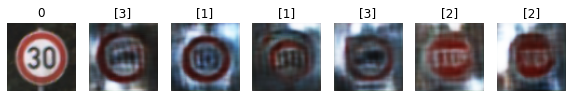

Epoch 39210 g_loss= 2.66729 d_loss= 0.24933046 real_acc= 0.78 fake_acc= 0.96
Epoch 39220 g_loss= 2.3377783 d_loss= 0.21400176 real_acc= 0.88 fake_acc= 0.98
Epoch 39230 g_loss= 1.9475392 d_loss= 0.18286897 real_acc= 0.98 fake_acc= 0.88
Epoch 39240 g_loss= 2.7581925 d_loss= 0.21590129 real_acc= 0.88 fake_acc= 1.0
Epoch 39250 g_loss= 2.1767578 d_loss= 0.19589895 real_acc= 0.96 fake_acc= 0.9
Epoch 39260 g_loss= 2.0497763 d_loss= 0.2293662 real_acc= 0.9 fake_acc= 0.94
Epoch 39270 g_loss= 1.9684024 d_loss= 0.1919123 real_acc= 0.98 fake_acc= 0.96
Epoch 39280 g_loss= 2.67206 d_loss= 0.19616768 real_acc= 0.9 fake_acc= 0.96
Epoch 39290 g_loss= 2.239012 d_loss= 0.28215224 real_acc= 0.88 fake_acc= 0.92
Epoch 39300 g_loss= 2.2775428 d_loss= 0.22337298 real_acc= 0.92 fake_acc= 0.96


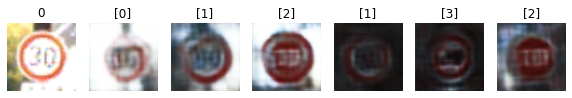

Epoch 39310 g_loss= 2.0024767 d_loss= 0.20562482 real_acc= 0.94 fake_acc= 0.94
Epoch 39320 g_loss= 2.2454636 d_loss= 0.23733324 real_acc= 0.9 fake_acc= 0.96
Epoch 39330 g_loss= 2.2982416 d_loss= 0.2301858 real_acc= 0.94 fake_acc= 0.98
Epoch 39340 g_loss= 1.8776547 d_loss= 0.26396263 real_acc= 0.88 fake_acc= 0.86
Epoch 39350 g_loss= 2.171365 d_loss= 0.27202436 real_acc= 0.86 fake_acc= 0.92
Epoch 39360 g_loss= 2.6495762 d_loss= 0.24395543 real_acc= 0.84 fake_acc= 0.98
Epoch 39370 g_loss= 2.309055 d_loss= 0.20840666 real_acc= 0.84 fake_acc= 0.94
Epoch 39380 g_loss= 1.9639077 d_loss= 0.22790007 real_acc= 0.94 fake_acc= 0.94
Epoch 39390 g_loss= 1.770936 d_loss= 0.24803638 real_acc= 0.96 fake_acc= 0.86
Epoch 39400 g_loss= 2.7563012 d_loss= 0.21089368 real_acc= 0.86 fake_acc= 0.98


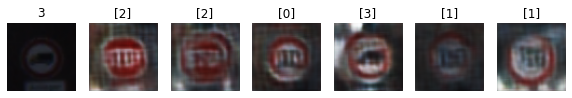

Epoch 39410 g_loss= 1.9446673 d_loss= 0.24328807 real_acc= 0.92 fake_acc= 0.9
Epoch 39420 g_loss= 2.2217934 d_loss= 0.21351859 real_acc= 0.92 fake_acc= 0.96
Epoch 39430 g_loss= 2.2696235 d_loss= 0.21201283 real_acc= 0.9 fake_acc= 0.94
Epoch 39440 g_loss= 1.9385315 d_loss= 0.23445836 real_acc= 0.94 fake_acc= 0.96
Epoch 39450 g_loss= 3.0223114 d_loss= 0.27758396 real_acc= 0.84 fake_acc= 0.98
Epoch 39460 g_loss= 2.239766 d_loss= 0.2464323 real_acc= 0.9 fake_acc= 0.94
Epoch 39470 g_loss= 2.4992461 d_loss= 0.17619517 real_acc= 0.98 fake_acc= 0.98
Epoch 39480 g_loss= 2.609913 d_loss= 0.20140177 real_acc= 0.82 fake_acc= 0.98
Epoch 39490 g_loss= 2.2157013 d_loss= 0.24007866 real_acc= 0.9 fake_acc= 0.92
Epoch 39500 g_loss= 2.3152833 d_loss= 0.17549276 real_acc= 0.98 fake_acc= 0.98


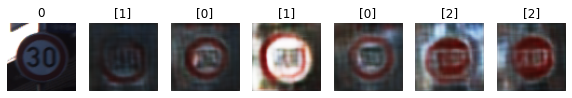

Epoch 39510 g_loss= 3.031096 d_loss= 0.14380342 real_acc= 0.96 fake_acc= 1.0
Epoch 39520 g_loss= 2.5984266 d_loss= 0.26551145 real_acc= 0.84 fake_acc= 0.98
Epoch 39530 g_loss= 2.5869355 d_loss= 0.15187323 real_acc= 0.94 fake_acc= 0.94
Epoch 39540 g_loss= 2.2478504 d_loss= 0.21961415 real_acc= 0.92 fake_acc= 0.96
Epoch 39550 g_loss= 2.227716 d_loss= 0.1926058 real_acc= 0.96 fake_acc= 0.92
Epoch 39560 g_loss= 1.96837 d_loss= 0.24218039 real_acc= 0.92 fake_acc= 0.9
Epoch 39570 g_loss= 2.4527504 d_loss= 0.17957881 real_acc= 0.92 fake_acc= 1.0
Epoch 39580 g_loss= 2.348256 d_loss= 0.2717251 real_acc= 0.88 fake_acc= 1.0
Epoch 39590 g_loss= 2.2865865 d_loss= 0.18390515 real_acc= 0.94 fake_acc= 0.96
Epoch 39600 g_loss= 2.5321102 d_loss= 0.18135816 real_acc= 0.94 fake_acc= 0.98


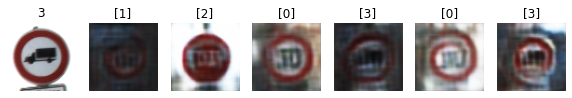

Epoch 39610 g_loss= 1.947699 d_loss= 0.21509185 real_acc= 0.96 fake_acc= 0.86
Epoch 39620 g_loss= 2.120421 d_loss= 0.22909853 real_acc= 0.94 fake_acc= 0.9
Epoch 39630 g_loss= 2.6914153 d_loss= 0.22152196 real_acc= 0.86 fake_acc= 0.98
Epoch 39640 g_loss= 2.2791128 d_loss= 0.3147023 real_acc= 0.82 fake_acc= 0.92
Epoch 39650 g_loss= 2.8354118 d_loss= 0.27176127 real_acc= 0.78 fake_acc= 0.98
Epoch 39660 g_loss= 2.6746993 d_loss= 0.24174012 real_acc= 0.84 fake_acc= 0.92
Epoch 39670 g_loss= 2.5803332 d_loss= 0.2555576 real_acc= 0.84 fake_acc= 0.96
Epoch 39680 g_loss= 2.359683 d_loss= 0.21887282 real_acc= 0.9 fake_acc= 0.96
Epoch 39690 g_loss= 2.1921923 d_loss= 0.22269349 real_acc= 0.92 fake_acc= 0.94
Epoch 39700 g_loss= 2.296245 d_loss= 0.234095 real_acc= 0.9 fake_acc= 0.96


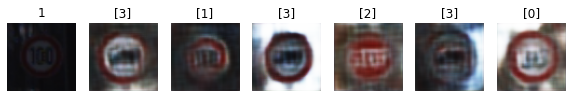

Epoch 39710 g_loss= 2.5428278 d_loss= 0.19885498 real_acc= 0.92 fake_acc= 0.98
Epoch 39720 g_loss= 2.789545 d_loss= 0.2847669 real_acc= 0.88 fake_acc= 0.98
Epoch 39730 g_loss= 2.4756386 d_loss= 0.23807889 real_acc= 0.86 fake_acc= 0.98
Epoch 39740 g_loss= 1.851698 d_loss= 0.25943166 real_acc= 0.94 fake_acc= 0.88
Epoch 39750 g_loss= 2.5256903 d_loss= 0.23541135 real_acc= 0.86 fake_acc= 1.0
Epoch 39760 g_loss= 2.744121 d_loss= 0.26039705 real_acc= 0.86 fake_acc= 0.98
Epoch 39770 g_loss= 2.000885 d_loss= 0.24125479 real_acc= 0.9 fake_acc= 0.96
Epoch 39780 g_loss= 2.234352 d_loss= 0.23980531 real_acc= 0.92 fake_acc= 0.96
Epoch 39790 g_loss= 2.3793771 d_loss= 0.23689783 real_acc= 0.92 fake_acc= 0.94
Epoch 39800 g_loss= 1.9042523 d_loss= 0.25701123 real_acc= 0.88 fake_acc= 0.9


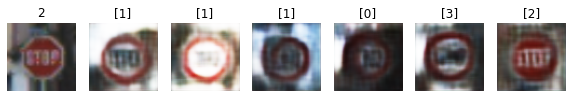

Epoch 39810 g_loss= 1.8286989 d_loss= 0.21550071 real_acc= 0.98 fake_acc= 0.88
Epoch 39820 g_loss= 2.5216198 d_loss= 0.18181682 real_acc= 0.92 fake_acc= 0.98
Epoch 39830 g_loss= 2.8452978 d_loss= 0.17567769 real_acc= 0.92 fake_acc= 0.96
Epoch 39840 g_loss= 2.3873272 d_loss= 0.20391423 real_acc= 0.96 fake_acc= 0.96
Epoch 39850 g_loss= 3.0431962 d_loss= 0.20571071 real_acc= 0.88 fake_acc= 1.0
Epoch 39860 g_loss= 2.1683805 d_loss= 0.16332701 real_acc= 1.0 fake_acc= 0.96
Epoch 39870 g_loss= 2.6089382 d_loss= 0.13495931 real_acc= 1.0 fake_acc= 0.98
Epoch 39880 g_loss= 2.8464901 d_loss= 0.24193655 real_acc= 0.88 fake_acc= 0.96
Epoch 39890 g_loss= 2.3216047 d_loss= 0.21818632 real_acc= 0.94 fake_acc= 0.94
Epoch 39900 g_loss= 2.0890281 d_loss= 0.20074932 real_acc= 0.98 fake_acc= 0.92


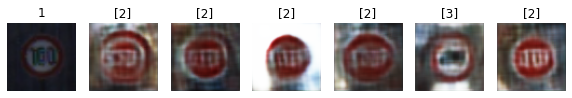

Epoch 39910 g_loss= 2.4037013 d_loss= 0.26192537 real_acc= 0.86 fake_acc= 0.98
Epoch 39920 g_loss= 2.4898527 d_loss= 0.20724761 real_acc= 0.9 fake_acc= 0.96
Epoch 39930 g_loss= 2.2943318 d_loss= 0.24143639 real_acc= 0.9 fake_acc= 0.9
Epoch 39940 g_loss= 2.3547459 d_loss= 0.19052675 real_acc= 0.9 fake_acc= 1.0
Epoch 39950 g_loss= 2.5125022 d_loss= 0.19763517 real_acc= 0.96 fake_acc= 0.94
Epoch 39960 g_loss= 2.5144994 d_loss= 0.19216508 real_acc= 0.94 fake_acc= 0.98
Epoch 39970 g_loss= 2.1488295 d_loss= 0.22286384 real_acc= 0.96 fake_acc= 0.94
Epoch 39980 g_loss= 3.0034678 d_loss= 0.24247888 real_acc= 0.82 fake_acc= 0.94
Epoch 39990 g_loss= 2.5541306 d_loss= 0.20637825 real_acc= 0.88 fake_acc= 0.98
Done


In [59]:
epochs = 40000
for epoch in range(epochs):
    # take some random samples
    new_samples,new_labels = sample_from_dataset(50,samples)
    #print(new_samples.shape)
    # perform one training step (epoch)
    do_step(new_samples, new_labels)
    
    if epoch % 100 == 0:
        # show one real image and some fake images generated by generator using noise seed
        #display.clear_output(wait=True)
        num_examples_to_generate = 6
        seed = tf.random.normal([num_examples_to_generate, noise_dim])
        random_labels = np.random.randint(4, size=num_examples_to_generate)
        random_labels = np.expand_dims(random_labels,axis=1)
        predictions = generator([seed,random_labels], training=False)
        fig = plt.figure(figsize=(10,10))
        r = random.randrange(len(samples))
        plt.subplot(1, num_examples_to_generate+1, 1)
        plt.imshow(samples[r, :, :, :])
        plt.title(labels[r])
        plt.axis('off')
        for i in range(predictions.shape[0]):
            plt.subplot(1, num_examples_to_generate+1, i+2)
            #plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
            plt.imshow(predictions[i, :, :, :])
            plt.title("{}".format(random_labels[i]))
            plt.axis('off')
        plt.show()    
print("Done")

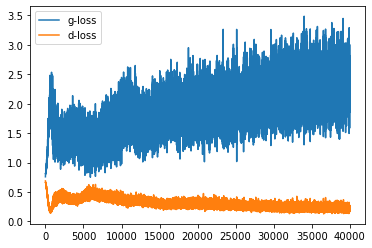

In [67]:
nph = np.array(history)

plt.plot(nph[:,0], label='g-loss')
plt.plot(nph[:,1], label='d-loss')
#plt.ylim([0,2])
plt.legend()
plt.show()

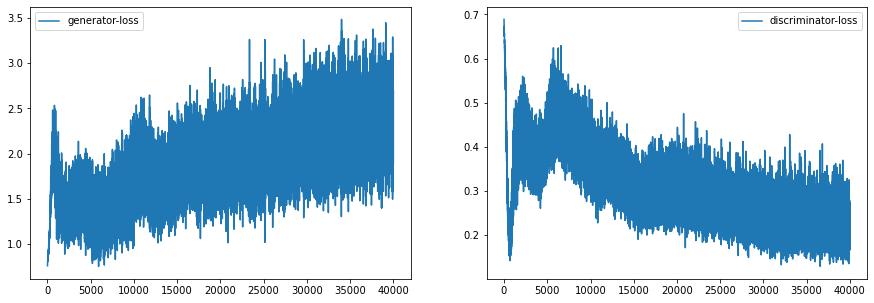

In [68]:
nph = np.array(history)
plt.figure(figsize=(15, 5))
ax = plt.subplot(1, 2, 1)
#plt.ylim([0,2])
plt.plot(nph[:,0], label='generator-loss')
plt.legend()
ax = plt.subplot(1, 2, 2)
plt.plot(nph[:,1], label='discriminator-loss')
#plt.ylim([0,2])
plt.legend()
plt.show()

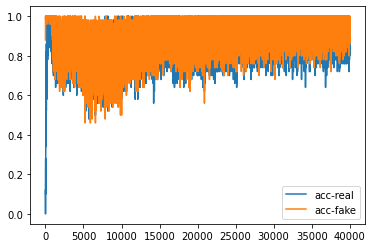

In [69]:
nph = np.array(history)

plt.plot(nph[:,2], label='acc-real')
plt.plot(nph[:,3], label='acc-fake')
plt.legend()
plt.show()

In [64]:
generator.save_weights('generator_color_4c_40k_weights.h5')

In [62]:
generator.save('generator_color_4c_40k')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: generator_color_4c_40k\assets


In [65]:
discriminator.save_weights('discriminator_4c_80k_weights.h5')

In [66]:
discriminator.save('discriminator_4c_40k.h5')

(36, 100)
(36, 1)


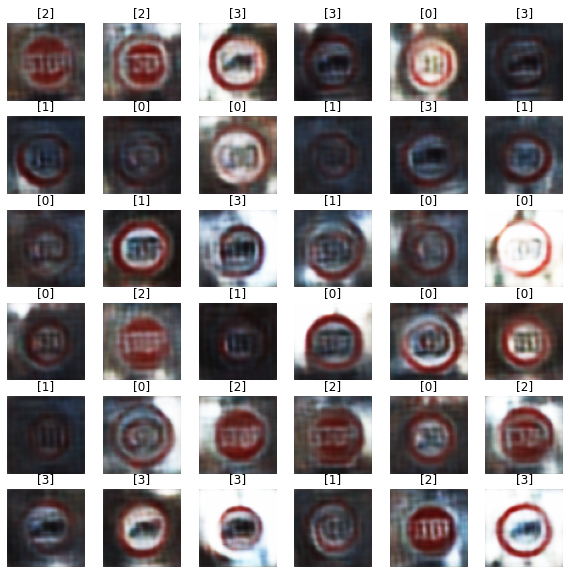

In [71]:
noise_dim = 100
num_examples_to_generate = 36
seed = tf.random.normal([num_examples_to_generate, noise_dim])
random_labels = np.random.randint(4, size=num_examples_to_generate)
random_labels = np.expand_dims(random_labels,axis=1)

print(seed.shape)
print(random_labels.shape)
predictions = generator([seed,random_labels])
fig = plt.figure(figsize=(10,10))
# r = random.randrange(len(samples))
# plt.subplot(1, num_examples_to_generate+1, 1)
#plt.imshow(samples[r, :, :, 0] * 127.5 + 127.5, cmap='gray')
#plt.axis('off')
for i in range(predictions.shape[0]):
    plt.subplot(6, 6, i+1)
    #plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.imshow(predictions[i, :, :, :])
    plt.title("{}".format(random_labels[i]))
    plt.axis('off')
plt.show()    